In [453]:
import numpy as np
import pandas as pd
import cv2
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib.pyplot import imread
import glob
from scipy.misc import imsave

In [934]:
from basic_lane_lines import weighted_img, find_lane3

# Load Images from Video

In [3]:
def display_images(X, start_idx=0, end_idx=None,  step_val=1, 
                   columns = 5, use_gray=False, 
                   apply_fnc=None, figsize=(32,18)):
    """
    Display a set of images
    Parameters
    ----------
    X: numpy array of images
         Images to be displayed
    start_idx: int
         Start index for images
    end_idx: int
         End index for images
    step_val: int
        step value
    columns: int
         Number of columns of images
    use_gray: bool
         True for RGB images.  False for grayscale images.
    apply_fnc: function
         An function to apply to each image before displaying.
    figsize: tuple of int
         Display height and width of images.
    """
    if end_idx is None:
        end_idx = X.shape[0]
        
    if apply_fnc is None:
        apply_fnc = lambda image: image
        
    plt.figure(figsize=figsize)

    num_of_images = end_idx - start_idx
    rows = num_of_images / columns + 1
    
    cnt = 0
    for i in range(start_idx, end_idx, step_val):
        cnt += 1
        image = X[i]
        
        plt.subplot(rows, columns, cnt)
        
        if use_gray:
            plt.imshow(apply_fnc(image), cmap="gray")
        else:
            plt.imshow(apply_fnc(image)) 
            
    plt.tight_layout()
            
    plt.show()

In [4]:
def read_imgs(file_names):
    """
    Read list of images from disk.
    Parameters
    ----------
    file_names: list of str
         List of image file names.
    Returns
    -------
    numpy array of images:
         Images from disk.
    """
    img_arr = []
    
    for file_name in file_names:
        img = imread(file_name)
        img_arr.append(img)
        
    return np.stack(img_arr)

In [5]:
def pad_zeros(val, num_of_zeros=7):
    pad_str = '{:0>%d}' % num_of_zeros
    return pad_str.format(val)

In [6]:
def extract_video_imgs(video, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    
    vidcap = cv2.VideoCapture(video)
    length = int(vidcap.get(cv2.CAP_PROP_FRAME_COUNT))
    
    success,image = vidcap.read()
    for i in tqdm(range(length)):
        if success:
            success, image = vidcap.read()
        
            if success:
                frame_file = "%s/frame_%s.jpg" % (output_dir, pad_zeros(i))
                cv2.imwrite(frame_file, image)     # save frame as JPEG file
        else:
            print("WARNING: frame #%d could not be read. Stopping.")
            break

In [7]:
data_dir = 'data'

In [8]:
video = 'project_video.mp4'
output_dir = '%s/project_video' % data_dir
extract_video_imgs(video, output_dir)

100%|██████████| 1260/1260 [01:24<00:00, 14.89it/s]

In [10]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))
len(video_image_files)

1259

In [11]:
[video_image_files[i] for i in range(0, len(video_image_files), 126)]

['data/project_video/frame_0000000.jpg',
 'data/project_video/frame_0000126.jpg',
 'data/project_video/frame_0000252.jpg',
 'data/project_video/frame_0000378.jpg',
 'data/project_video/frame_0000504.jpg',
 'data/project_video/frame_0000630.jpg',
 'data/project_video/frame_0000756.jpg',
 'data/project_video/frame_0000882.jpg',
 'data/project_video/frame_0001008.jpg',
 'data/project_video/frame_0001134.jpg']

In [12]:
sample_video_imgs_np = read_imgs([video_image_files[i] for i in range(0, len(video_image_files), 126)])

In [13]:
sample_video_imgs_np.shape

(10, 720, 1280, 3)

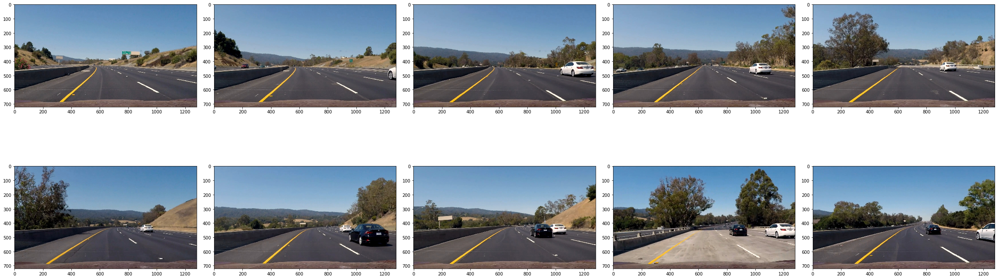

In [15]:
display_images(sample_video_imgs_np, start_idx=0, columns=5, figsize=(32,16))

# Calibrate Camera

In [16]:
camera_cal_dir = 'camera_cal'

In [17]:
def load_camera_cal_images(camera_cal_dir):
    img_files = glob.glob('%s/*.jpg' % camera_cal_dir)
    return [imread(img_file) for img_file in img_files], img_files

In [18]:
camera_cal_img_arr, camera_cal_img_files = load_camera_cal_images(camera_cal_dir)

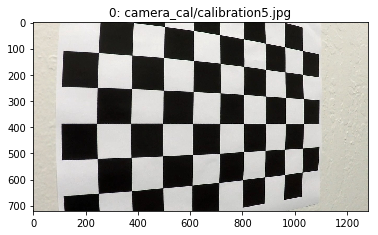

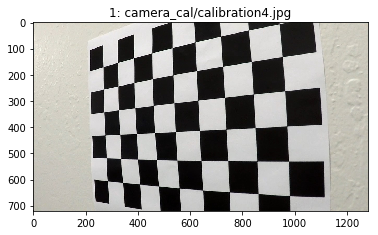

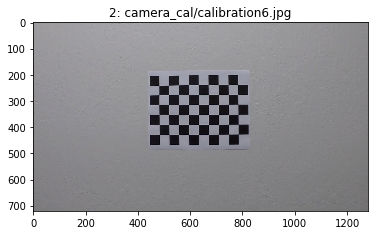

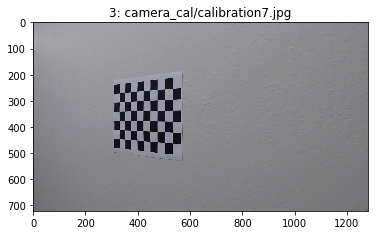

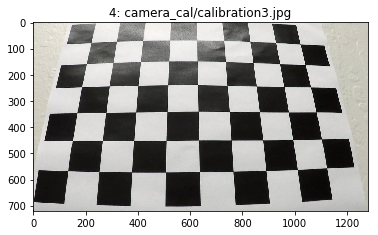

...

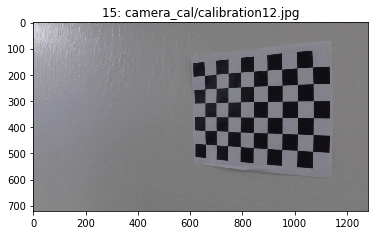

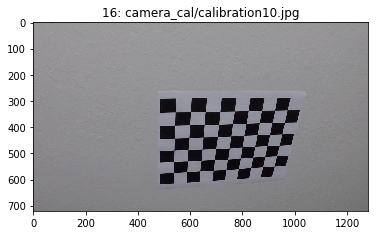

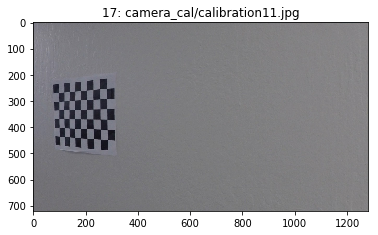

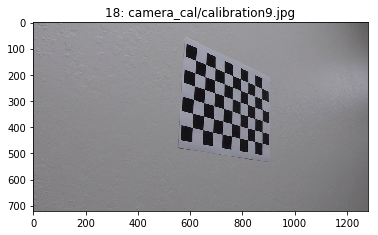

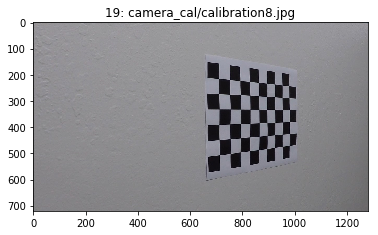

In [19]:
for i, camera_cal_img in enumerate(camera_cal_img_arr):
    plt.title('%d: %s' % (i, camera_cal_img_files[i]))
    plt.imshow(camera_cal_img)
    plt.show()

In [20]:
test_img = camera_cal_img_arr[6]
camera_cal_img_arr = [camera_cal_img_arr[i] for i in range(len(camera_cal_img_arr)) if i != 6]
camera_cal_img_files = [camera_cal_img_files [i] for i in range(len(camera_cal_img_files)) if i != 6]

In [21]:
objpoints = []
imgpoints = []

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
    
for img in tqdm(camera_cal_img_arr):
    x_cnt = 9
    y_cnt = 6

    objp = np.zeros((y_cnt*x_cnt,3), np.float32)
    objp[:,:2] = np.mgrid[0:x_cnt,0:y_cnt].T.reshape(-1,2)

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    ret, corners = cv2.findChessboardCorners(gray, (y_cnt, x_cnt), None)

    if ret:
        objpoints.append(objp)
        cv2.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)   
        
        """
        _img = img.copy()
        _img = cv2.drawChessboardCorners(_img, (y_cnt, x_cnt), corners, True)
        
        print(i)
        plt.imshow(img)
        plt.show()
        plt.imshow(_img)
        plt.show()
        """
        
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

"""
print("Ret:",ret)
print("Mtx:", mtx.shape, "\n", mtx)
print("Dist:",dist.shape, "\n", dist)
print("rvecs:",rvecs[0].shape, "\n", rvecs)
print("tvecs:",tvecs[0].shape, "\n", tvecs)
"""

100%|██████████| 19/19 [00:05<00:00,  2.77it/s]


'\nprint("Ret:",ret)\nprint("Mtx:", mtx.shape, "\n", mtx)\nprint("Dist:",dist.shape, "\n", dist)\nprint("rvecs:",rvecs[0].shape, "\n", rvecs)\nprint("tvecs:",tvecs[0].shape, "\n", tvecs)\n'

In [22]:
def cal_undistort(img, objpoints, imgpoints):    
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, 
                                                        gray.shape[::-1], 
                                                        None, None)
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)

    return undist

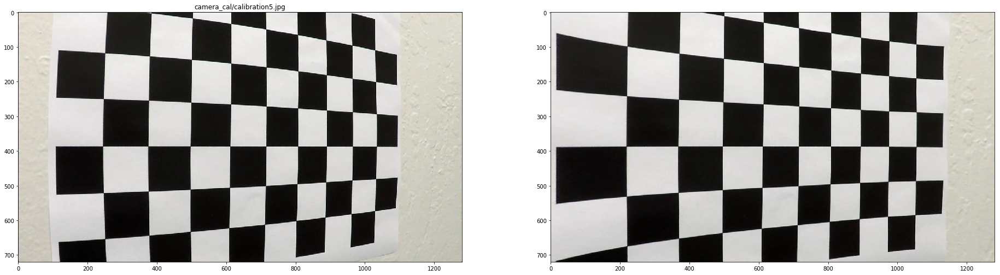

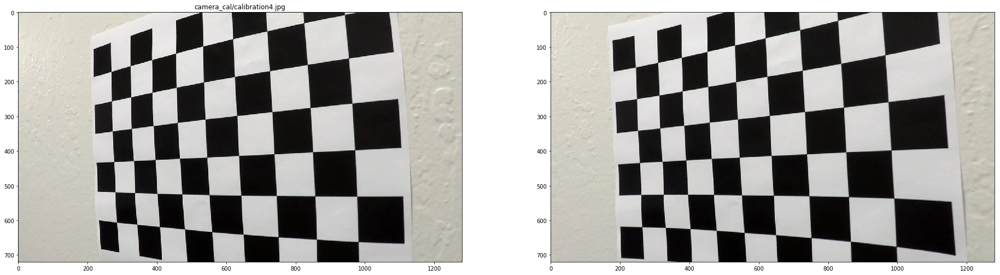

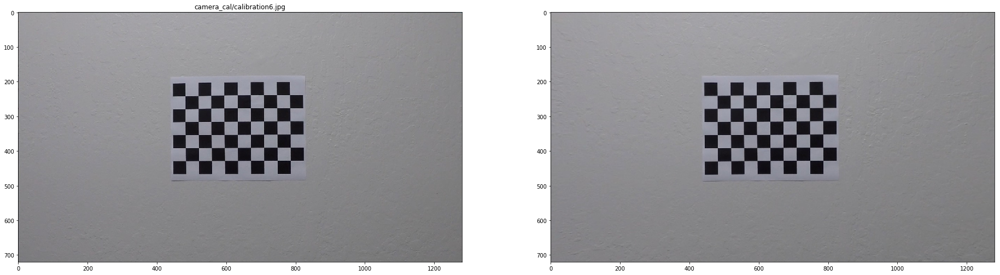

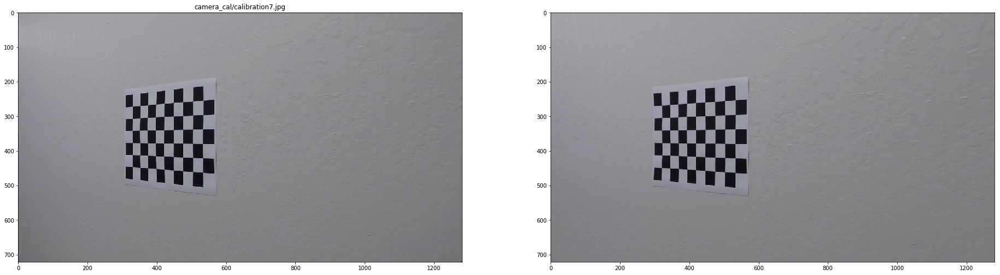

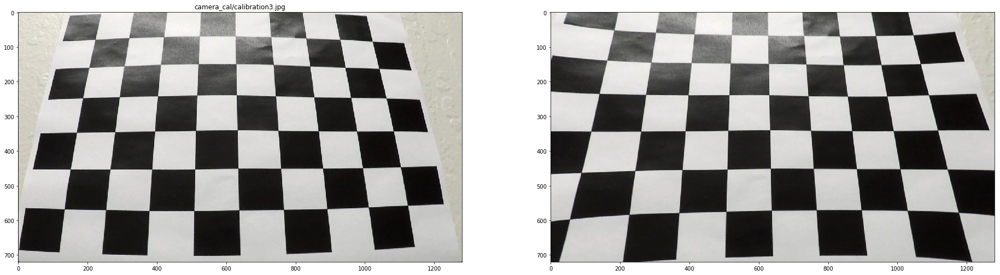

...

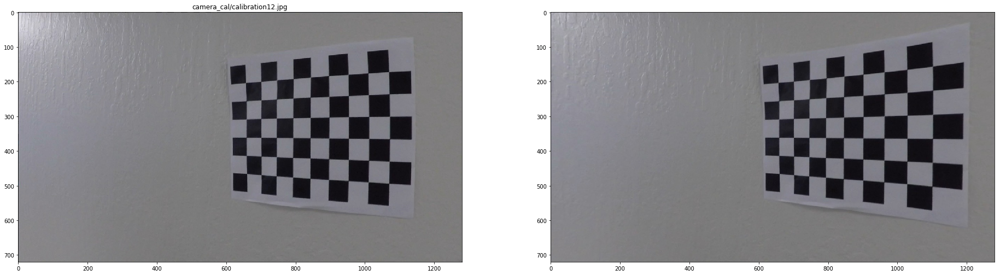

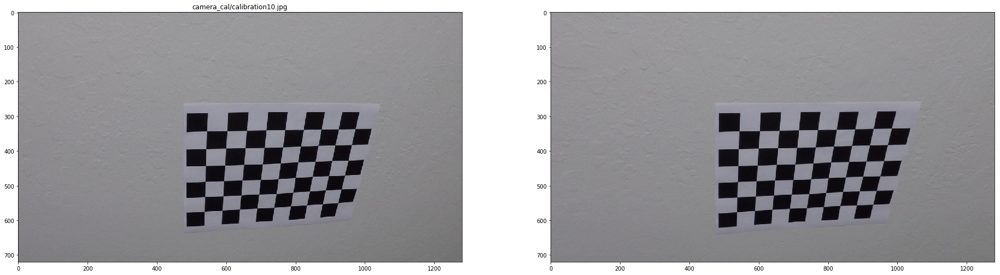

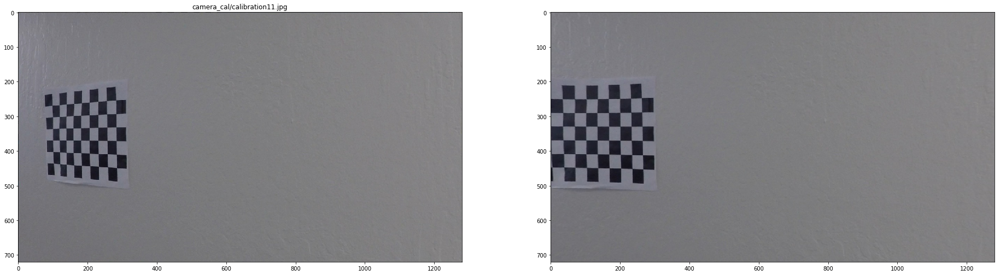

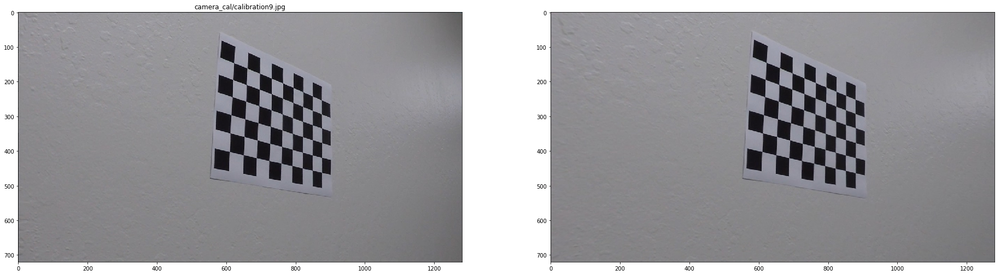

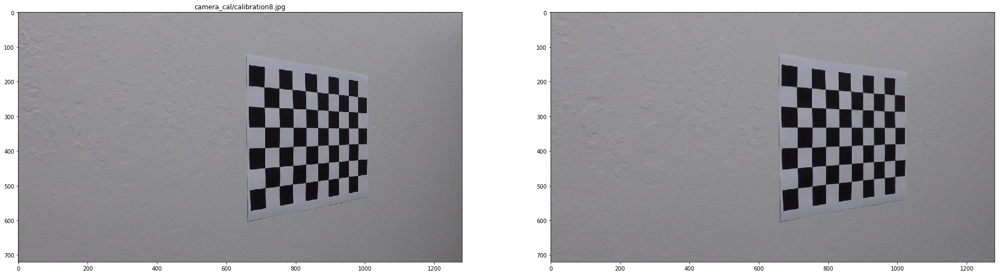

In [23]:
for i, img in enumerate(camera_cal_img_arr):
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    plt.figure(figsize=(32,32))

    plt.subplot(1,2,1)
    plt.title(camera_cal_img_files[i])
    plt.imshow(img)
    plt.subplot(1,2,2)
    plt.imshow(undistorted_img)
    plt.show()

In [24]:
type(objpoints[0])

numpy.ndarray

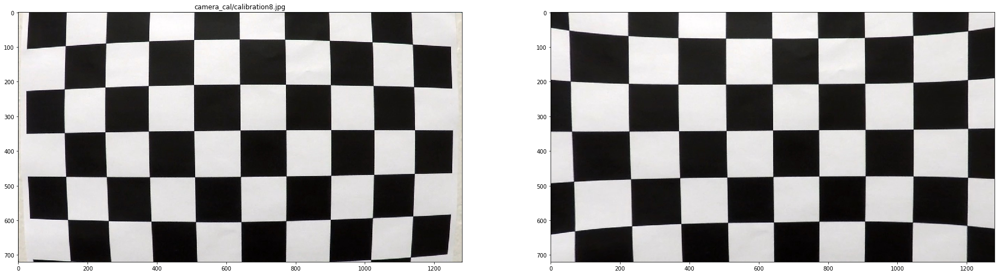

In [25]:
undistorted_img = cal_undistort(test_img, objpoints, imgpoints)
    
plt.figure(figsize=(32,32))

plt.subplot(1,2,1)
plt.title(camera_cal_img_files[i])
plt.imshow(test_img)
plt.subplot(1,2,2)
plt.imshow(undistorted_img)
plt.show()

# Pipeline

In [26]:
def load_test_images(test_img_dir):
    img_files = glob.glob('%s/*.jpg' % test_img_dir)
    return [imread(img_file) for img_file in img_files], img_files

In [27]:
test_image_arr, test_img_files = load_test_images('test_images')

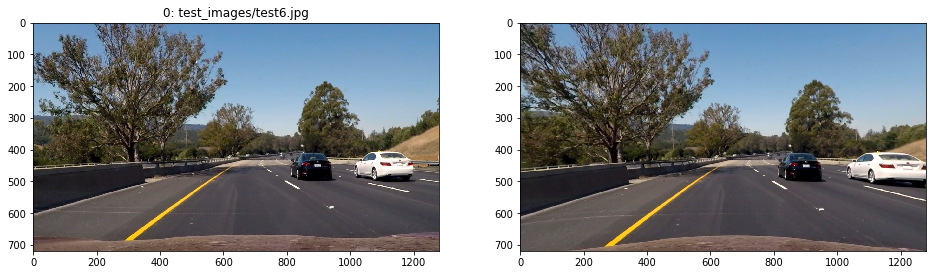

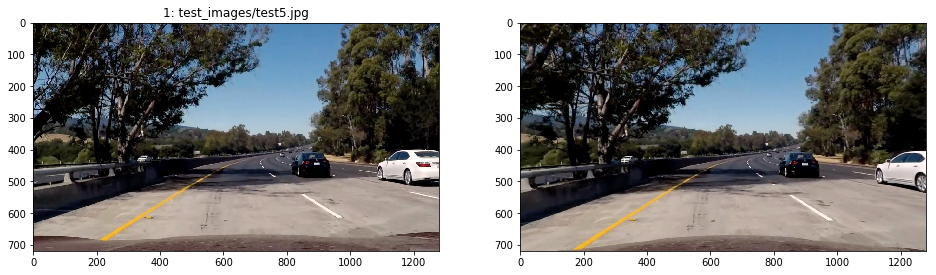

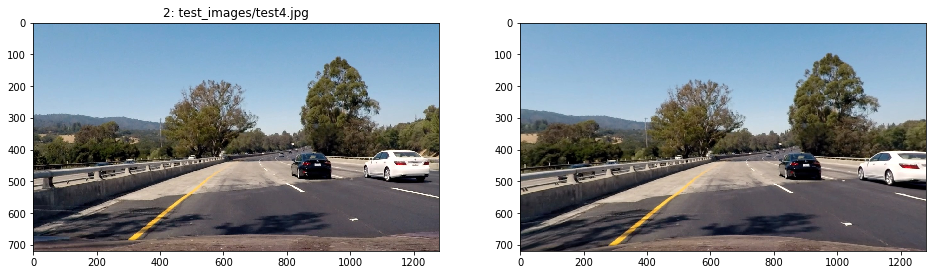

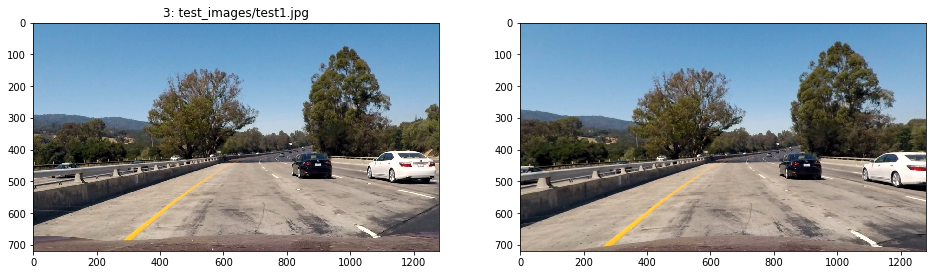

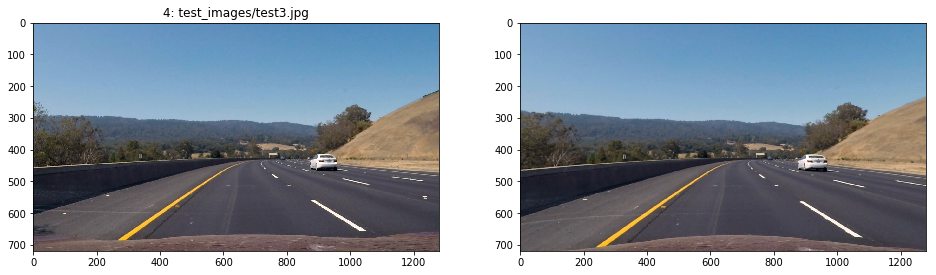

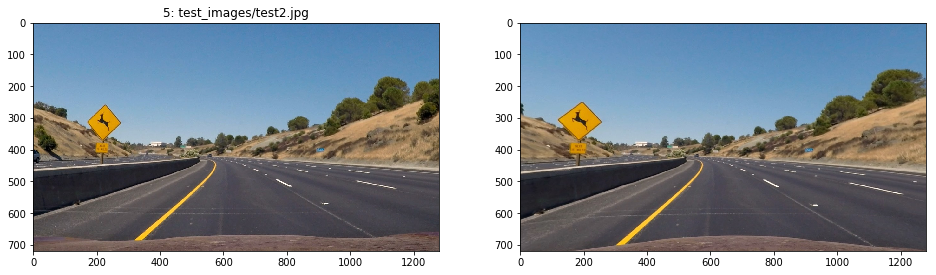

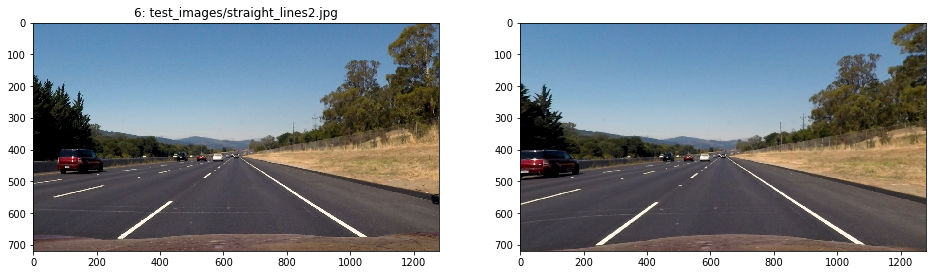

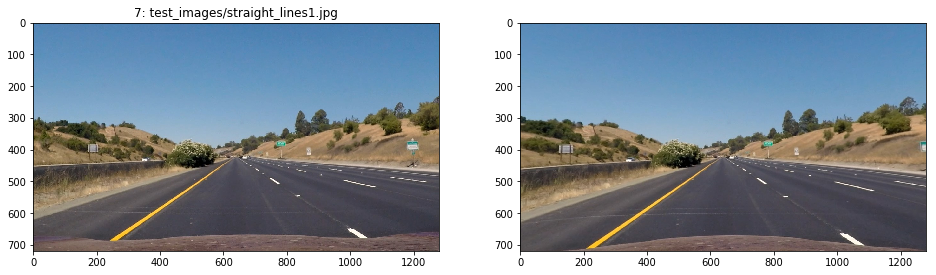

In [28]:
for i,img in enumerate(test_image_arr):
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    plt.figure(figsize=(16,16))
    
    plt.subplot(1,2,1)
    plt.title("%d: %s" % (i, test_img_files[i]))
    plt.imshow(img)
    plt.subplot(1,2,2)
    plt.imshow(undistorted_img)
    plt.show()

## Has the distortion correction been correcctly applied to each image?

In [29]:
test_road_img = test_image_arr[2]
undistorted_road_img = cal_undistort(test_road_img, objpoints, imgpoints)

In [30]:
gray_test_road_img = cv2.cvtColor(test_road_img, cv2.COLOR_RGB2GRAY)
gray_undistorted_road_img = cv2.cvtColor(undistorted_road_img, cv2.COLOR_RGB2GRAY)

height, width = gray_undistorted_road_img.shape
overlayed_test_img = np.zeros((height, width, 3))

overlayed_test_img[:,:,0] = gray_test_road_img
overlayed_test_img[:,:,1] = gray_undistorted_road_img

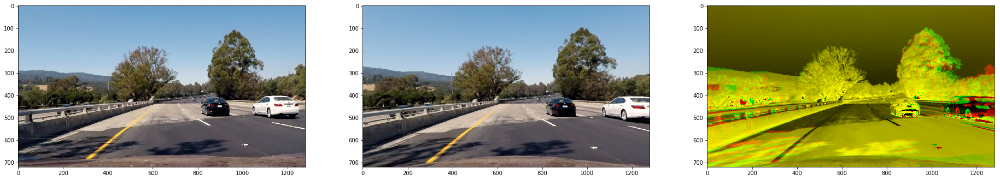

In [31]:
undistorted_road_img = cal_undistort(test_road_img, objpoints, imgpoints)
    
plt.figure(figsize=(32,32))
    
plt.subplot(1,3,1)
plt.imshow(test_road_img)
plt.subplot(1,3,2)
plt.imshow(undistorted_road_img)
plt.subplot(1,3,3)
plt.imshow(overlayed_test_img)
plt.show()

## 2. Has a binary image been created using color transforms, gradients or other methods?

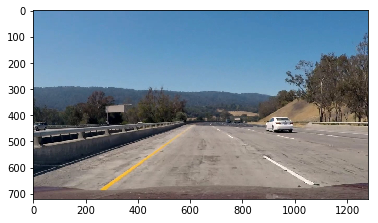

In [1067]:
#sample_video_img = sample_video_imgs_np[0]
#sample_video_img = imread('data/project_video/frame_0000546.jpg')
sample_video_img = imread('data/project_video/frame_0000571.jpg')

plt.imshow(sample_video_img)
plt.show()

In [1068]:
undistorted_sample_video_img = cal_undistort(sample_video_img, objpoints, imgpoints)

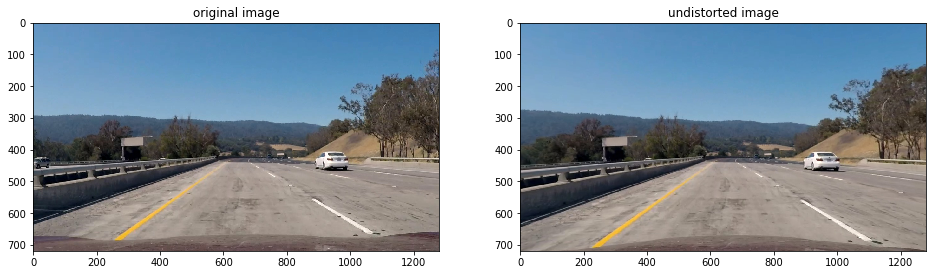

In [1069]:
plt.figure(figsize=(16,16))
plt.subplot(1,2,1)
plt.title('original image')
plt.imshow(sample_video_img)
plt.subplot(1,2,2)
plt.title('undistorted image')
plt.imshow(undistorted_sample_video_img)
plt.show()

In [1070]:
lane_line_sample_video_img = weighted_img(find_lane3(undistorted_sample_video_img), undistorted_sample_video_img)

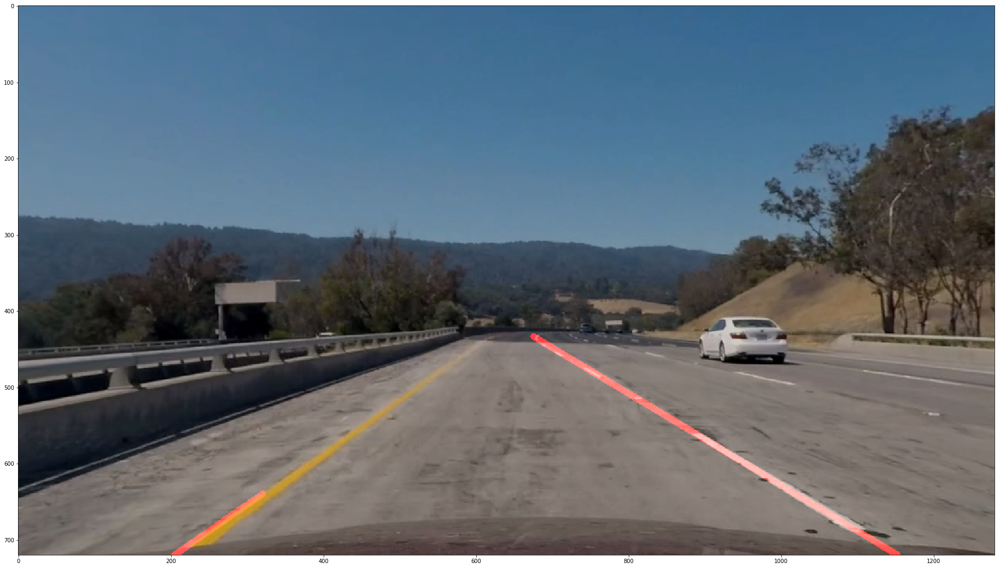

In [1071]:
plt.figure(figsize=(32,32))
plt.imshow(lane_line_sample_video_img)
plt.show()

## 3. Has a perspective transform been applied to rectify the image?

In [1072]:
def warp(img, src, dst):
    M = cv2.getPerspectiveTransform(src, dst)
        
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    return warped, Minv

In [1073]:
img_size = (lane_line_sample_video_img.shape[1], lane_line_sample_video_img.shape[0])

src = np.float32(
     [[(img_size[0] / 2) - 60, img_size[1] / 2 + 120],
     [((img_size[0] / 6) + 50), img_size[1]],
     [(img_size[0] * 5 / 6) + 75, img_size[1]],
     [(img_size[0] / 2 + 115), img_size[1] / 2 + 120]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])    

In [1074]:
warped_lane_line_sample_video_img, Minv = warp(lane_line_sample_video_img, src, dst)

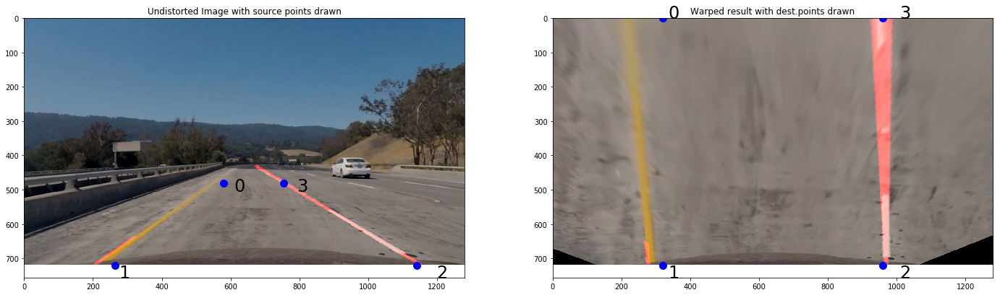

In [1075]:
plt.figure(figsize=(24,32))

plt.subplot(1,2,1)
plt.title('Undistorted Image with source points drawn')
plt.imshow(lane_line_sample_video_img)
for i in range(src.shape[0]):
    x,y = src[i]
    plt.plot(x,y, 'bo', markersize=10)
    plt.text(x * (1.05), y * (1.05) , i, fontsize=24)
    
plt.subplot(1,2,2)
plt.title('Warped result with dest.points drawn')
plt.imshow(warped_lane_line_sample_video_img)
for i in range(dst.shape[0]):
    x,y = dst[i]
    plt.plot(x,y, 'bo', markersize=10)
    plt.text(x * (1.05), y * (1.05) , i, fontsize=24)

plt.show()

## 4. Have lane line pixels been identified in the rectified image and fit with a polynomial?

In [1076]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

In [1077]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

In [1078]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

In [1079]:
def hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

In [1080]:
warped_sample_video_img, Minv = warp(lane_line_sample_video_img, src, dst)

In [1081]:
abs_sobel_thresh_x_sample_video_img = abs_sobel_thresh(warped_sample_video_img, 
                                                     orient='x', thresh_min=20, thresh_max=100)
abs_sobel_thresh_y_sample_video_img = abs_sobel_thresh(warped_sample_video_img, 
                                                     orient='y', thresh_min=20, thresh_max=100)
mag_thresh_sample_video_img = mag_thresh(warped_sample_video_img, mag_thresh=(30, 100))
dir_threshold_sample_video_img = dir_threshold(warped_sample_video_img,
                                               sobel_kernel=15, thresh=(0.7, 1.3))
hls_binary_sample_video_img = hls_select(warped_sample_video_img, thresh=(90, 255))

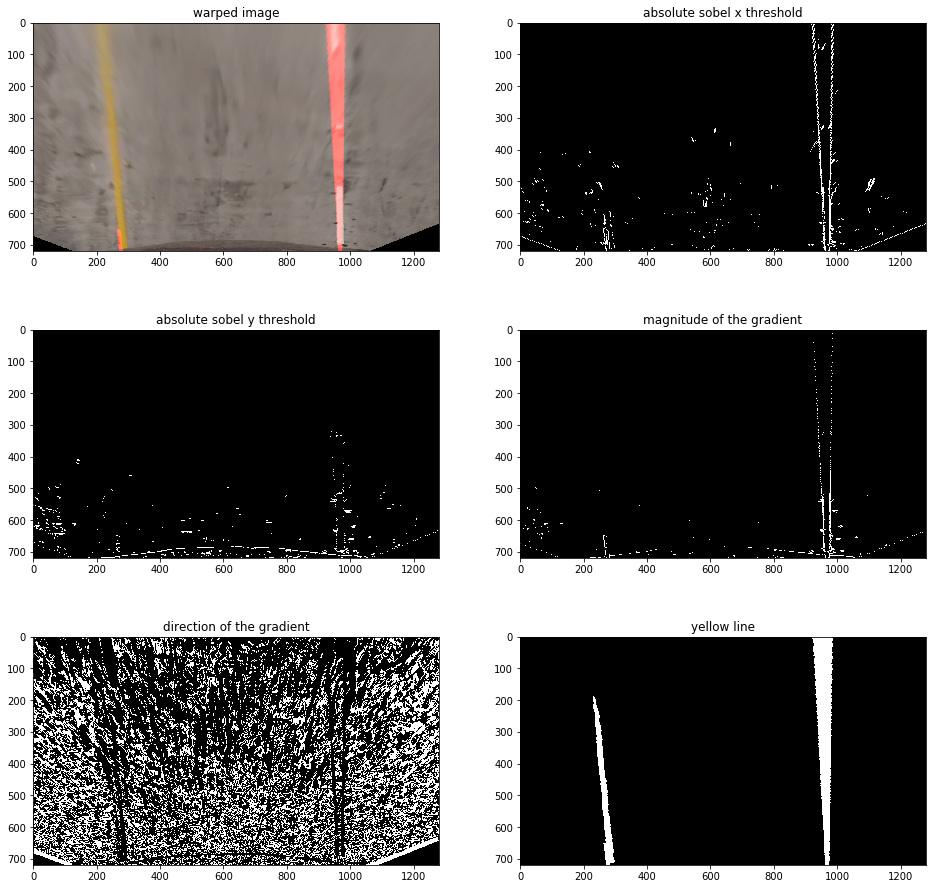

In [1082]:
i = 1
cols = 2
rows = 3

plt.figure(figsize=(16,16))

plt.subplot(rows,cols,i)
plt.title('warped image')
plt.imshow(warped_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('absolute sobel x threshold')
plt.imshow(abs_sobel_thresh_x_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('absolute sobel y threshold')
plt.imshow(abs_sobel_thresh_y_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('magnitude of the gradient')
plt.imshow(mag_thresh_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('direction of the gradient')
plt.imshow(dir_threshold_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('yellow line')
plt.imshow(hls_binary_sample_video_img, cmap='gray')
plt.show()

In [1083]:
def combine_thresholds(abs_sobel_x_thresh_img, abs_sobel_y_thresh_img, 
                      mag_thresh_img, dir_threshold_img,
                      hls_binary_img):    
    combined_thresholds_img = np.logical_or(abs_sobel_x_thresh_img, abs_sobel_y_thresh_img)
    combined_thresholds_img = np.logical_or(combined_thresholds_img, mag_thresh_img)
    combined_thresholds_img = np.logical_or(combined_thresholds_img, hls_binary_img)
    
    return 255*combined_thresholds_img.astype(np.uint8)

In [1084]:
combine_thresholds_sample_video_img = combine_thresholds(abs_sobel_thresh_x_sample_video_img,
                                                        abs_sobel_thresh_y_sample_video_img,
                                                        mag_thresh_sample_video_img, 
                                                        dir_threshold_sample_video_img,
                                                        hls_binary_sample_video_img)

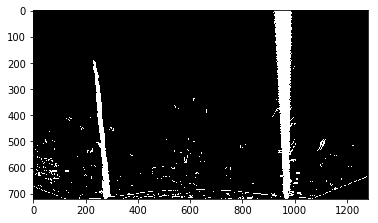

In [1085]:
plt.imshow(combine_thresholds_sample_video_img, cmap='gray')
plt.show()

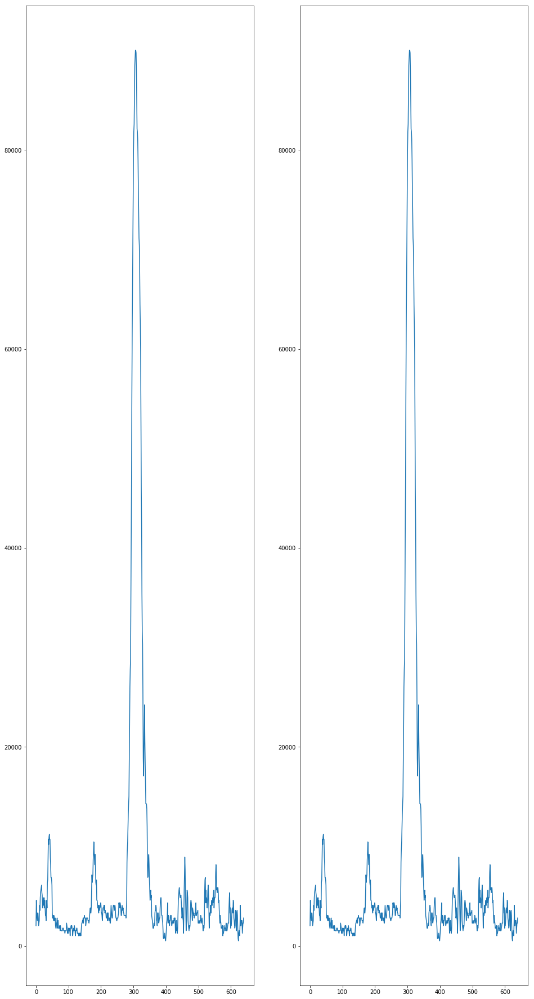

In [706]:
x_midpoint = combine_thresholds_sample_video_img.shape[1] // 2
left_img = combine_thresholds_sample_video_img[:, :x_midpoint]
left_histogram = np.sum(left_img[left_img.shape[0]//2:,:], axis=0)

right_img = combine_thresholds_sample_video_img[:, x_midpoint:]
right_histogram = np.sum(right_img[right_img.shape[0]//2:,:], axis=0)

plt.figure(figsize=(16,32))
plt.subplot(1,2,1)
plt.plot(left_histogram)
plt.subplot(1,2,2)
plt.plot(left_histogram)
plt.show()

In [707]:
binary_warped = np.expand_dims(combine_thresholds_sample_video_img, axis=2)

In [708]:
binary_warped.shape

(720, 1280, 1)

In [709]:
def fit_initial_lanes(img):
    basic_lane_lines_img = get_basic_lane_lines(img)
    
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)

    # Create an output image to draw on and  visualize the result
    out_img = (np.dstack((binary_warped, binary_warped, binary_warped))*255).astype(np.uint8)

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Set the width of the windows +/- margin
    margin = 100

    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
    
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high), (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high), (0,255,0), 2) 
    
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
    
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img

In [953]:
def get_basic_lane_lines(img):
    img_size = (img.shape[1], img.shape[0])

    src = np.float32(
         [[(img_size[0] / 2) - 60, img_size[1] / 2 + 120],
         [((img_size[0] / 6) + 50), img_size[1]],
         [(img_size[0] * 5 / 6) + 75, img_size[1]],
         [(img_size[0] / 2 + 115), img_size[1] / 2 + 120]])
    dst = np.float32(
        [[(img_size[0] / 4), 0],
        [(img_size[0] / 4), img_size[1]],
        [(img_size[0] * 3 / 4), img_size[1]],
        [(img_size[0] * 3 / 4), 0]])      
    
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    undistorted_lane_lines = find_lane3(undistorted_img)
    undistorted_lane_lines[:,:,1] = undistorted_lane_lines[:,:,0]
    undistorted_lane_lines[:,:,2] = undistorted_lane_lines[:,:,0]
    
    return undistorted_lane_lines

In [984]:
def apply_img_pipeline(undistorted_img, objpoints, imgpoints):
    img_size = (undistorted_img.shape[1], undistorted_img.shape[0])

    src = np.float32(
         [[(img_size[0] / 2) - 60, img_size[1] / 2 + 120],
         [((img_size[0] / 6) + 50), img_size[1]],
         [(img_size[0] * 5 / 6) + 75, img_size[1]],
         [(img_size[0] / 2 + 115), img_size[1] / 2 + 120]])
    dst = np.float32(
        [[(img_size[0] / 4), 0],
        [(img_size[0] / 4), img_size[1]],
        [(img_size[0] * 3 / 4), img_size[1]],
        [(img_size[0] * 3 / 4), 0]])      

    """
    plt.subplot(1,3,1)
    plt.imshow(undistorted_img)
    """
    
    warped_img, Minv = warp(undistorted_img, src, dst)

    """
    plt.subplot(1,3,2)
    plt.imshow(warped_img)
    """

    abs_sobel_thresh_x_img = abs_sobel_thresh(warped_img, orient='x', thresh_min=20, thresh_max=100)
    abs_sobel_thresh_y_img = abs_sobel_thresh(warped_img, orient='y', thresh_min=20, thresh_max=100)
    mag_thresh_img = mag_thresh(warped_img, mag_thresh=(30, 100))
    dir_threshold_img = dir_threshold(warped_img, sobel_kernel=15, thresh=(0.7, 1.3))
    hls_binary_img = hls_select(warped_img, thresh=(90, 255))    
    
    combine_thresholds_img = combine_thresholds(abs_sobel_thresh_x_img, abs_sobel_thresh_y_img,
                                                mag_thresh_img, dir_threshold_img,
                                                hls_binary_img)  
    
    """
    plt.subplot(1,3,3)
    plt.imshow(combine_thresholds_img)
    plt.show()
    """

    return combine_thresholds_img, Minv

In [714]:
sample_video_imgs_np = read_imgs(video_image_files[990:1000])
sample_video_imgs_arr = [sample_video_imgs_np[i] for i in range(sample_video_imgs_np.shape[0])]                                 

In [715]:
sample_video_imgs_arr[0].shape

(720, 1280, 3)

In [716]:
binary_warped_img_arr = []
Minv_arr = []

for sample_video_img in tqdm(sample_video_imgs_arr):       
    undistorted_img = cal_undistort(sample_video_img, objpoints, imgpoints)   
    binary_warped_img, Minv = apply_img_pipeline(undistorted_img, objpoints, imgpoints) 
    
    binary_warped_img_arr.append(binary_warped_img)
    Minv_arr.append(Minv)


100%|██████████| 10/10 [00:22<00:00,  2.85s/it]


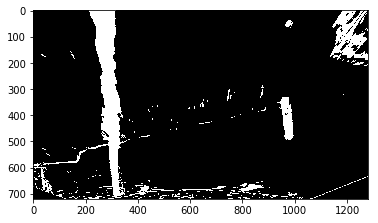

In [717]:
plt.imshow(binary_warped_img_arr[0], cmap='gray')
plt.show()

In [718]:
left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img = fit_initial_lanes(binary_warped_img_arr[0])

In [719]:
def plot_lanes(binary_warped, left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img):
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    
    plt.show()

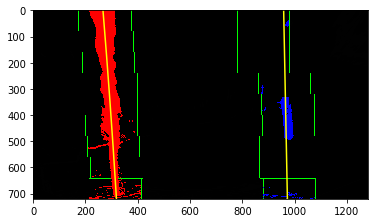

In [720]:
plot_lanes(binary_warped_img_arr[0], left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img)

In [862]:
def fit_lanes(binary_warped, left_fit, right_fit, margin = 100):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Create an output image to draw on and  visualize the result
    out_img = (np.dstack((binary_warped, binary_warped, binary_warped))*255).astype(np.uint8)    

    
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    
    print("###fit_lane - leftx", len(leftx))
    left_min_y = np.min(lefty)
    left_max_y = np.max(lefty)
    print("###fit_lane - left_min_y, left_max_y", left_min_y, left_max_y)  
    
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    print("###fit_lane - rightx", len(rightx))
    right_min_y = np.min(righty)
    right_max_y = np.max(righty)
    print("###fit_lane - right_min_y, right_max_y", right_min_y, right_max_y) 
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img

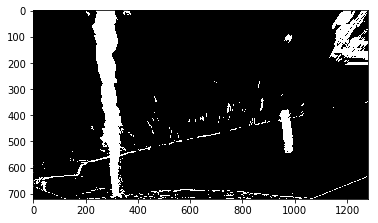

In [725]:
plt.imshow(binary_warped_img_arr[1], cmap='gray')
plt.show()

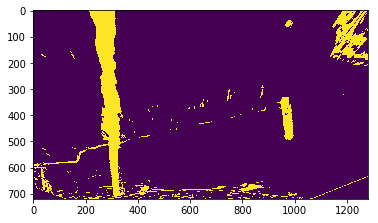

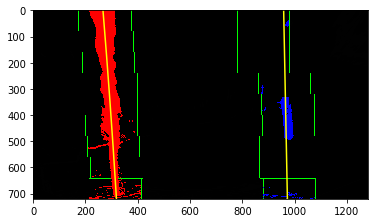

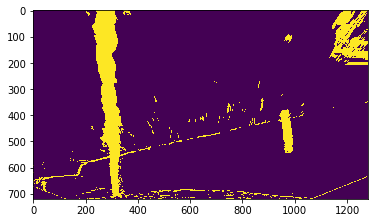

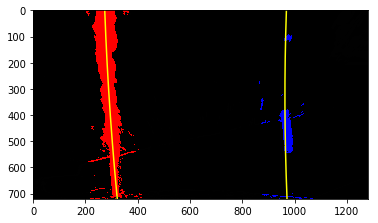

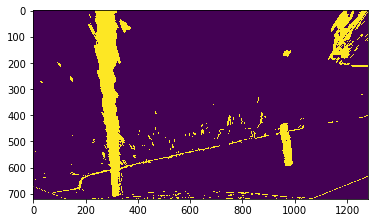

...

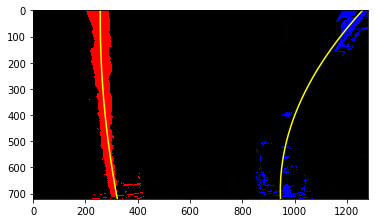

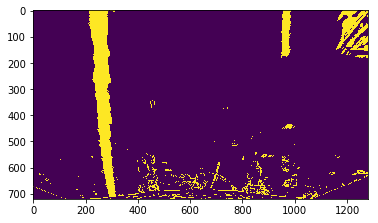

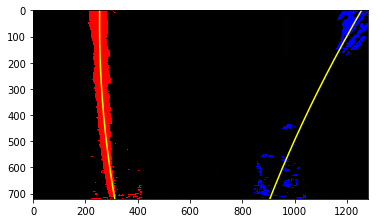

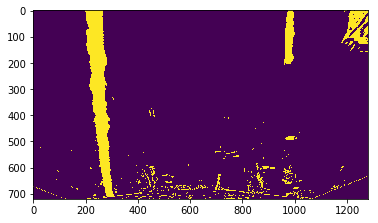

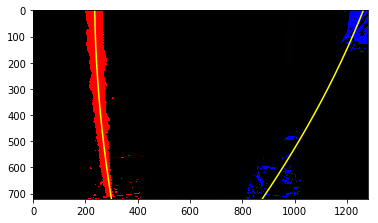

In [723]:
for i in range(0,len(binary_warped_img_arr)):
#for i in range(1):
    if i == 0:
        left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img = \
            fit_initial_lanes(binary_warped_img_arr[i])
    else:
        bottom_left_x = left_fit[0]*binary_warped_img_arr[i].shape[0]**2 \
                                + left_fit[1]*binary_warped_img_arr[i].shape[0] + left_fit[2]
        
        bottom_right_x =  right_fit[0]*binary_warped_img_arr[i].shape[0]**2 \
                                + right_fit[1]*binary_warped_img_arr[i].shape[0] + right_fit[2]
            
        top_left_x = left_fit[2]
        top_right_x = right_fit[2]
            
        left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img = \
            fit_lanes(binary_warped_img_arr[i], left_fit, right_fit,
                      bottom_left_x, bottom_right_x)
        
    plt.imshow(binary_warped_img_arr[i])
    plt.show()
    plot_lanes(binary_warped_img_arr[0], left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img)

# Sliding Window

In [628]:
# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

In [629]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),
           max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

In [630]:
def find_window_centroids(image, window_width = 50, window_height = 80, margin = 100):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

In [631]:
warped = binary_warped_img_arr[0]

In [632]:
warped.min(), warped.max()

(0, 255)

In [633]:
window_centroids = find_window_centroids(warped, window_width = 50, window_height = 80, margin = 100)

In [634]:
window_centroids

[(282.0, 956.0),
 (280.0, 957.0),
 (284.0, 953.0),
 (269.0, 948.0),
 (265.0, 848.0),
 (256.0, 816.0),
 (250.0, 766.0),
 (245.0, 796.0),
 (231.0, 895.0)]

In [635]:
def convert_window_centroids_to_polyfit(binary_warped, window_centroids):
    leftx_arr = []
    rightx_arr = []
    
    for i in range(len(window_centroids)):
        leftx_arr.append(window_centroids[i][0])
        rightx_arr.append(window_centroids[i][1])
        
    y_spacing = binary_warped.shape[0]/(len(window_centroids)-1)
    y_arr = [y_spacing * i for i in range(len(window_centroids))]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(y_arr, leftx_arr, 2)
    right_fit = np.polyfit(y_arr, rightx_arr, 2)
                                          
    return left_fit, right_fit

In [975]:
def get_window_centroid_fit(warped, window_width = 50, window_height = 80, margin = 100):
    window_centroids = find_window_centroids(warped, window_width = 50, window_height = 80, margin = 100)
    
    """
    plt.imshow(get_output_from_centroids(warped, window_centroids))
    plt.show()
    """
    
    return convert_window_centroids_to_polyfit(warped, window_centroids)

In [637]:
left_fit, right_fit = convert_window_centroids_to_polyfit(warped, window_centroids)

In [638]:
def get_output_from_centroids(warped, window_centroids):
    # If we found any window centers
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows 
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage= (np.dstack((warped, warped, warped))*255).astype(np.uint8) # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
 
    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)
        
    return output

In [639]:
output = get_output_from_centroids(warped, window_centroids)

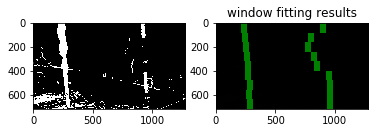

In [640]:
# Display the final results
plt.subplot(1,2,1)
plt.imshow(warped, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(output)
plt.title('window fitting results')
plt.show()

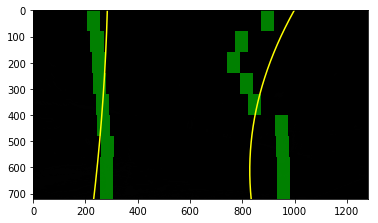

In [641]:
plt.imshow(output)

ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

plt.show()

# Measure curvature

In [760]:
def get_curvature(height, fit):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension      
    
    ploty = np.linspace(0, height-1, num=height)
    y_eval = np.max(ploty)
    
    x_vals = fit[0]*ploty**2 + fit[1]*ploty + fit[2]    
    
    curverad = ((1 + (2*fit[0]*y_eval*ym_per_pix + fit[1])**2)**1.5) / np.absolute(2*fit[0])
    
    return curverad

In [761]:
def get_left_right_curvature(binary_warped, left_fit, right_fit):
    # Calculate the new radii of curvature
    left_curverad = get_curvature(binary_warped.shape[0], left_fit)
    right_curverad = get_curvature(binary_warped.shape[0], right_fit)
    
    return left_curverad, right_curverad

In [762]:
get_left_right_curvature(warped, left_fit, right_fit)

(4924.9299124737199, 3233.0236136320327)

# Draw lanes on road

In [1033]:
def draw_lanes_and_annotations(image, warped, Minv, ploty, left_fitx, right_fitx,
                                  curverad, offset, lane_width, frame_id=0):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0]))  
    
    # Combine the result with the original image
    #result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    output_img = cv2.addWeighted(image, 1, newwarp, 0.3, 0)

    frame_id_txt = 'Frame #%d' % frame_id
    curvature_txt = 'Curvature: %.2f' % curverad
    offset_txt = 'Offset: %.2f' % offset
    lane_width_txt = 'Lane Width: %.2f' % lane_width
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    text_color = (12, 12, 12)
    cv2.putText(output_img, frame_id_txt, (10,60), font, 2, text_color,2,cv2.LINE_AA)
    cv2.putText(output_img, curvature_txt, (10,120), font, 2, text_color,2,cv2.LINE_AA)
    cv2.putText(output_img, offset_txt, (10,180), font, 2, text_color,2,cv2.LINE_AA)
    cv2.putText(output_img, lane_width_txt, (10,240), font, 2, text_color,2,cv2.LINE_AA)

    return output_img

In [645]:
image = sample_video_imgs_arr[0]
undistorted_img = cal_undistort(image, objpoints, imgpoints) 
warped, Minv = apply_img_pipeline(undistorted_img, objpoints, imgpoints) 

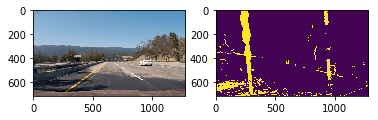

In [646]:
plt.subplot(1,2,1)
plt.imshow(image)
plt.subplot(1,2,2)
plt.imshow(warped)
plt.show()

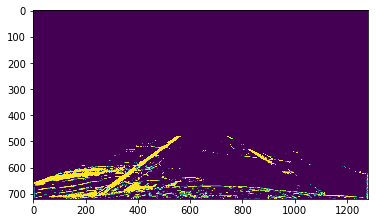

In [647]:
plt.imshow(cv2.warpPerspective(warped, Minv, (warped.shape[1], warped.shape[0])))

In [648]:
left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img = fit_initial_lanes(warped)

In [649]:
left_fit, right_fit

(array([ -1.72265007e-05,   9.78741833e-02,   2.32053356e+02]),
 array([ -9.48564019e-05,   1.22618603e-01,   9.09064831e+02]))

In [650]:
def plot_to_points(warped_img, left_fit, right_fit):
    ploty = np.linspace(0, warped_img.shape[0]-1, warped_img.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return ploty, left_fitx, right_fitx 

In [651]:
ploty, left_fitx, right_fitx = plot_to_points(warped, left_fit, right_fit)

In [652]:
left_curverad, right_curverad = get_curvature(warped, left_fit, right_fit)
left_curverad, right_curverad

(9534.6068763699186, 1731.3273191601093)

In [653]:
curverad = (left_curverad + right_curverad)/2.0

In [654]:
offset = (image.shape[1]/2.0)-(left_fitx[-1]+right_fitx[-1])/2.0

In [655]:
road_with_lanes = draw_lanes_and_annotations(image, warped, Minv, ploty, left_fitx, right_fitx,
                                             curverad, offset)

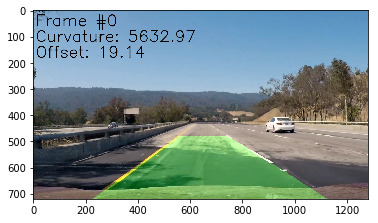

In [656]:
plt.imshow(road_with_lanes)
plt.show()

In [657]:
def process_road_imgs(img_files):
    road_with_lanes_arr = []

    for i, img_file in enumerate(tqdm(img_files)):
        img = imread(img_file)
        undistorted_img = cal_undistort(img, objpoints, imgpoints) 
        warped, Minv = apply_img_pipeline(undistorted_img, objpoints, imgpoints) 
    
        if i == 0:
            left_fit, right_fit, _, _, _, _, _ = fit_initial_lanes(warped)
        else:
            left_fit, right_fit, _, _, _, _, _ = fit_lanes(warped, left_fit, right_fit)
        
        ploty, left_fitx, right_fitx = plot_to_points(warped, left_fit, right_fit)
    
        left_curverad, right_curverad = get_curvature(binary_warped, left_fit, right_fit)
        
        offset = (img.shape[1]/2.0)-(left_fitx[-1]+right_fitx[-1])/2.0
    
        road_with_lanes = draw_lanes_and_annotations(image, warped, Minv, ploty, left_fitx, right_fitx, 
                                                     left_curverad, right_curverad, offset, i)
        road_with_lanes_arr.append(road_with_lanes)    
        
    return road_with_lanes_arr

In [658]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))[0:50]
road_with_lanes_arr = process_road_imgs(video_image_files)

  0%|          | 0/50 [00:00<?, ?it/s]


TypeError: draw_lanes_and_annotations() takes from 8 to 9 positional arguments but 10 were given

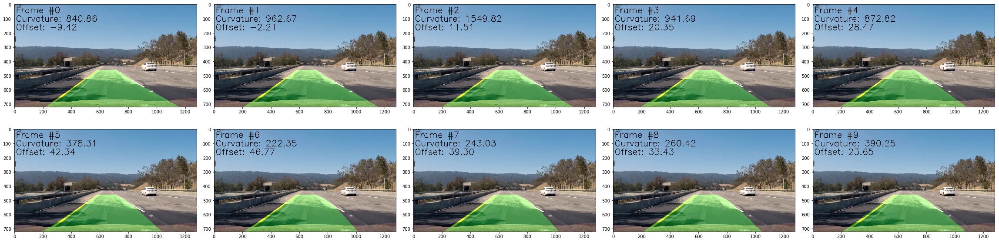

In [659]:
display_images(np.array(road_with_lanes_arr[0:10]), start_idx=0, columns=5, figsize=(32,12))

# Processing Video

## Define a class to receive the characteristics of each line detection

In [874]:
class Line(object):
    def __init__(self, img_height, max_n_fits):
        self.img_height = img_height
        self.max_n_fits = max_n_fits
        
        self.fits = []
        
        self._y_vals = None
        
        self._last_mean_fit = None
        
    @property
    def mean_fit(self):
        if self.fits is None or len(self.fits) == 0:
            return None
        
        # Yah! Side effects! Cache the mean_fit value in last_mean_fit so you don't have to recalc.
        self._last_mean_fit = np.mean(self.fits, axis=0)
        
        return self._last_mean_fit
    
    @property
    def last_mean_fit(self):
        if self._last_mean_fit is None:
            self._last_mean_fit = self.mean_fit
            
        return self._last_mean_fit
    
    @property
    def y_vals(self):
        if self._y_vals is None:
            self._y_vals = np.linspace(0, self.img_height-1, num=self.img_height)
            
        return self._y_vals
    
    @property
    def x_vals(self):
        if self.mean_fit is None:
            return None
        
        return self.mean_fit[0] * self.y_vals**2 + self.mean_fit[1] * self.y_vals + self.mean_fit[2]
    
    @property
    def bottom_x(self):
        if self.mean_fit is None:
            return None
        
        return self.mean_fit[0] * self.img_height**2 + self.mean_fit[1] * self.img_height + self.mean_fit[2]
          
    @property
    def radius_of_curvature(self):
        """
        radius of curvature of the line in meters
        """
        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 30/720 # meters per pixel in y dimension
        xm_per_pix = 3.7/700 # meters per pixel in x dimension    

        fit = np.polyfit(self.y_vals*ym_per_pix, self.x_vals*xm_per_pix, 2)

        # Calculate the new radii of curvature
        radius_of_curvature = ((1 + (2*fit[0]*self.img_height*ym_per_pix + 
                                     fit[1])**2)**1.5) / np.absolute(2*fit[0])

        return radius_of_curvature 
    
    def add_fit(self, fit):
        self.fits.append(fit)
        
        if len(self.fits) > self.max_n_fits:
            self.fits = self.fits[-self.max_n_fits:]
            
    def clear_fits(self):
        self.fits = []
                
    def get_tangent(self, y):
        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 30/720 # meters per pixel in y dimension
        xm_per_pix = 3.7/700 # meters per pixel in x dimension    

        fit = np.polyfit(self.y_vals*ym_per_pix, self.x_vals*xm_per_pix, 2)
        
        return (2*fit[0]*self.img_height*ym_per_pix + fit[1])
    
    def get_tangent_side(self, y):
        if self.get_tangent(y) < 0.0:
            return 'to the left'
        elif self.get_tangent(y)> 0.0:
            return 'to the right'
        else:
            return 'straight'

In [661]:
output_dir = '%s/project_video' % data_dir
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))
len(video_image_files)

1259

In [850]:
def calc_lane_width(img_height, left_fit, right_fit):
    xm_per_pix = 3.7/700
    
    left_bottom_x = left_fit[0] * img_height**2 + left_fit[1] * img_height + left_fit[2]
    right_bottom_x = right_fit[0] * img_height**2 + right_fit[1] * img_height + right_fit[2]
    lane_width = (right_bottom_x - left_bottom_x) * xm_per_pix
    
    return lane_width

In [1040]:
def make_lane_line_frames(img_files, output_dir, 
                          window_width = 50, window_height = 80, margin = 100, 
                          max_n_fits=10, reinit_cnt=40, start_idx=0, min_lane_width=None, max_lane_width=None):
    os.makedirs(output_dir, exist_ok=True)
    
    frame_files = []
    curvatures = []
    
    img_shape = imread(img_files[0]).shape
    img_height = img_shape[0]
    img_width = img_shape[1]
    
    left_line = Line(img_height, max_n_fits)
    right_line = Line(img_height, max_n_fits)
    ploty = left_line.y_vals

    init_fit_lanes = True
    xm_per_pix = 3.7/700
    offset = 0.0
    
    for i, img_file in enumerate(tqdm(img_files)):
        print("###", i)
        img = imread(img_file)
        print("###img min(), max()", img.min(), img.max())
        print("###img", img.shape, img.dtype)
        
        if init_fit_lanes:
            try:
                basic_lane_lines_img = get_basic_lane_lines(img)
                print("###basic_lane_lines_img min(), max()", basic_lane_lines_img.min(), basic_lane_lines_img.max())
                print("###basic_lane_lines_img", basic_lane_lines_img.shape, basic_lane_lines_img.dtype)
                warped, Minv = apply_img_pipeline(basic_lane_lines_img, objpoints, imgpoints) 
                left_fit, right_fit, _, _, _, _, _ = fit_initial_lanes(warped)
                
                lane_width = calc_lane_width(img_height, left_fit, right_fit)
                if ((min_lane_width is not None and lane_width < min_lane_width) or 
                    (max_lane_width is not None and lane_width > max_lane_width)):
                    # If basic lane lines produces an invalid lane_width, revert back to fit_initial_lanes.
                    # (For curvy roads in Harder Challenge video.)
                    undistorted_img = cal_undistort(img, objpoints, imgpoints) 
                    warped, Minv = apply_img_pipeline(undistorted_img, objpoints, imgpoints) 
                    left_fit, right_fit, _, _, _, _, _ = fit_initial_lanes(warped)
            except:
                undistorted_img = cal_undistort(img, objpoints, imgpoints) 
                warped, Minv = apply_img_pipeline(undistorted_img, objpoints, imgpoints) 
                left_fit, right_fit, _, _, _, _, _ = fit_initial_lanes(warped)
                
            init_fit_lanes = False
        else:
            undistorted_img = cal_undistort(img, objpoints, imgpoints) 
            warped, Minv = apply_img_pipeline(undistorted_img, objpoints, imgpoints) 
            left_fit, right_fit, _, _, _, _, _ = fit_lanes(warped, left_line.last_mean_fit, 
                                                           right_line.last_mean_fit, margin = margin)
            
            """
            if max_lane_width is not None:
                lane_width = calc_lane_width(img_height, left_fit, right_fit)
            
                if lane_width > max_lane_width:
                    # if the lane width is too wide, use centroid fit instead
                    print("###lane_width", lane_width)
                    centroid_left_fit, centroid_right_fit = get_window_centroid_fit(warped, window_width, 
                                                                                    window_height, margin)
                    centroid_lane_width = calc_lane_width(img_height, centroid_left_fit, centroid_right_fit)
                
                    if centroid_lane_width < lane_width:
                        # use the fits from the smaller lane width
                        print("using centroid fit")
                        left_fit, right_fit = centroid_left_fit, centroid_right_fit
            """
                
        left_line.add_fit(left_fit)
        right_line.add_fit(right_fit)

        frame_idx = i+start_idx

        offset = (img.shape[1]/2.0)-(left_line.bottom_x+right_line.bottom_x)/2.0
        
        lane_width = (right_line.bottom_x - left_line.bottom_x) * xm_per_pix
        print("###lane_width", lane_width)
        if ((min_lane_width is not None and lane_width < min_lane_width) or 
            (max_lane_width is not None and lane_width > max_lane_width)):
            # if the lane width is still too narrow or too wide, go back to find init lanes
            print(i, lane_width, "resetting find lanes")
            # the width of the lane seems too wide. reinit finding the lanes
            init_fit_lanes = True
        
        curverad = np.min([left_line.radius_of_curvature, right_line.radius_of_curvature])
        curvatures.append(curverad)
            
        road_with_lanes = draw_lanes_and_annotations(img, warped, Minv, ploty, 
                                                     left_line.x_vals, right_line.x_vals, 
                                                     curverad, offset, lane_width, frame_idx)

        """
        plt.imshow(road_with_lanes)
        plt.show()
        """
        
        frame_file = "%s/frame_%s.jpg" % (output_dir, pad_zeros(frame_idx))
        imsave(frame_file, road_with_lanes)
        
        frame_files.append(frame_file)
        
        if i % reinit_cnt == 0:
            # do an init after 10 times the number of cached fits
            init_fit_lanes = True 

    return frame_files, curvatures

In [1036]:
output_dir = '%s/project_video' % data_dir

In [ ]:
video = 'project_video.mp4'
extract_video_imgs(video, output_dir)

In [1037]:
lane_line_dir = '%s/lane_lines' % data_dir

In [1042]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))

frame_files, curvatures = make_lane_line_frames(video_image_files[600:], lane_line_dir, 
                                                max_n_fits=12, reinit_cnt=48, start_idx=600,
                                                min_lane_width=2.6, max_lane_width=3.5)

  0%|          | 0/659 [00:00<?, ?it/s]

### 0
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.

  0%|          | 1/659 [00:04<53:20,  4.86s/it]

###lane_width 3.73317089873
0 3.73317089873 resetting find lanes
### 1
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  0%|          | 2/659 [00:10<54:09,  4.95s/it]

###lane_width 3.74198307821
1 3.74198307821 resetting find lanes
### 2
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  0%|          | 3/659 [00:14<52:45,  4.83s/it]

###lane_width 3.72094786508
2 3.72094786508 resetting find lanes
### 3
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 4/659 [00:18<49:02,  4.49s/it]

###lane_width 3.73078584265
3 3.73078584265 resetting find lanes
### 4
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 5/659 [00:22<47:37,  4.37s/it]

###lane_width 3.72024255364
4 3.72024255364 resetting find lanes
### 5
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 6/659 [00:27<50:16,  4.62s/it]

###lane_width 3.7030834077
5 3.7030834077 resetting find lanes
### 6
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 7/659 [00:31<47:22,  4.36s/it]

###lane_width 3.70554642426
6 3.70554642426 resetting find lanes
### 7
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 8/659 [00:34<44:01,  4.06s/it]

###lane_width 3.7134133142
7 3.7134133142 resetting find lanes
### 8
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|▏         | 9/659 [00:39<45:31,  4.20s/it]

###lane_width 3.71367280004
8 3.71367280004 resetting find lanes
### 9
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 10/659 [00:43<46:44,  4.32s/it]

###lane_width 3.71926468815
9 3.71926468815 resetting find lanes
### 10
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 11/659 [00:48<46:41,  4.32s/it]

###lane_width 3.72376978569
10 3.72376978569 resetting find lanes
### 11
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 12/659 [00:52<48:04,  4.46s/it]

###lane_width 3.73272410393
11 3.73272410393 resetting find lanes
### 12
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 13/659 [00:56<46:51,  4.35s/it]

###lane_width 3.74552550232
12 3.74552550232 resetting find lanes
### 13
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 14/659 [01:00<44:40,  4.16s/it]

###lane_width 3.75966843512
13 3.75966843512 resetting find lanes
### 14
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 15/659 [01:04<44:27,  4.14s/it]

###lane_width 3.75488605473
14 3.75488605473 resetting find lanes
### 15
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 16/659 [01:09<44:59,  4.20s/it]

###lane_width 3.72324870931
15 3.72324870931 resetting find lanes
### 16
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 17/659 [01:13<45:19,  4.24s/it]

###lane_width 3.70558123518
16 3.70558123518 resetting find lanes
### 17
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 18/659 [01:18<46:56,  4.39s/it]

###lane_width 3.69716705986
17 3.69716705986 resetting find lanes
### 18
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 19/659 [01:22<46:16,  4.34s/it]

###lane_width 3.67629672015
18 3.67629672015 resetting find lanes
### 19
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 20/659 [01:26<45:49,  4.30s/it]

###lane_width 3.65233267537
19 3.65233267537 resetting find lanes
### 20
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 21/659 [01:30<44:32,  4.19s/it]

###lane_width 3.63646504846
20 3.63646504846 resetting find lanes
### 21
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.61260236012
21 3.61260236012 resetting find lanes


  3%|▎         | 22/659 [01:35<47:53,  4.51s/it]

### 22
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 23/659 [01:39<45:36,  4.30s/it]

###lane_width 3.5878341674
22 3.5878341674 resetting find lanes
### 23
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▎         | 24/659 [01:43<43:30,  4.11s/it]

###lane_width 3.55791934225
23 3.55791934225 resetting find lanes
### 24
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▍         | 25/659 [01:47<42:48,  4.05s/it]

###lane_width 3.52512006564
24 3.52512006564 resetting find lanes
### 25
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▍         | 26/659 [01:50<40:34,  3.85s/it]

###lane_width 3.48841955382
### 26
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  4%|▍         | 27/659 [01:52<34:15,  3.25s/it]

###fit_lane - leftx 25970
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 6075
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.46807321818
### 27
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  4%|▍         | 28/659 [01:54<29:39,  2.82s/it]

###fit_lane - leftx 28839
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7111
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.46878972058
### 28
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  4%|▍         | 29/659 [01:56<26:53,  2.56s/it]

###fit_lane - leftx 30137
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7211
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.46227230621
### 29
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▍         | 30/659 [01:57<23:56,  2.28s/it]

###fit_lane - leftx 29143
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7528
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.45465812839
### 30
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▍         | 31/659 [01:59<21:46,  2.08s/it]

###fit_lane - leftx 28660
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7180
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.45106532834
### 31
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▍         | 32/659 [02:01<22:29,  2.15s/it]

###fit_lane - leftx 29172
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 6432
###fit_lane - right_min_y, right_max_y 50 719
###lane_width 3.44636050871
### 32
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 33/659 [02:03<21:20,  2.05s/it]

###fit_lane - leftx 31654
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 6357
###fit_lane - right_min_y, right_max_y 118 719
###lane_width 3.4302477604
### 33
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 34/659 [02:05<20:34,  1.98s/it]

###fit_lane - leftx 30957
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 6812
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.42076120295
### 34
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 35/659 [02:07<19:58,  1.92s/it]

###fit_lane - leftx 29147
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8633
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40995029729
### 35
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 36/659 [02:09<20:46,  2.00s/it]

###fit_lane - leftx 27840
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8814
###fit_lane - right_min_y, right_max_y 25 719
###lane_width 3.40213851828
### 36
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 37/659 [02:10<19:32,  1.88s/it]

###fit_lane - leftx 28052
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8161
###fit_lane - right_min_y, right_max_y 66 719
###lane_width 3.39370660726
### 37
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 38/659 [02:12<18:35,  1.80s/it]

###fit_lane - leftx 28828
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7729
###fit_lane - right_min_y, right_max_y 83 719
###lane_width 3.38783300329
### 38
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 39/659 [02:14<18:41,  1.81s/it]

###fit_lane - leftx 29270
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7174
###fit_lane - right_min_y, right_max_y 84 719
###lane_width 3.39160452761
### 39
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 40/659 [02:16<19:33,  1.90s/it]

###fit_lane - leftx 29114
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 6905
###fit_lane - right_min_y, right_max_y 93 719
###lane_width 3.39076637546
### 40
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 41/659 [02:18<19:34,  1.90s/it]

###fit_lane - leftx 31822
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7849
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.38423508013
### 41
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▋         | 42/659 [02:20<19:21,  1.88s/it]

###fit_lane - leftx 31360
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7420
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3746565893
### 42
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 43/659 [02:22<19:25,  1.89s/it]

###fit_lane - leftx 30676
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7427
###fit_lane - right_min_y, right_max_y 27 719
###lane_width 3.36488850323
### 43
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 44/659 [02:23<18:54,  1.84s/it]

###fit_lane - leftx 29982
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 6618
###fit_lane - right_min_y, right_max_y 84 719
###lane_width 3.35756504218
### 44
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 45/659 [02:25<18:06,  1.77s/it]

###fit_lane - leftx 28979
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 6317
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.35840802702
### 45
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 46/659 [02:27<20:09,  1.97s/it]

###fit_lane - leftx 31870
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7565
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35661540257
### 46
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 47/659 [02:30<20:48,  2.04s/it]

###fit_lane - leftx 29627
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8306
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35664514446
### 47
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 48/659 [02:32<20:36,  2.02s/it]

###fit_lane - leftx 28716
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9800
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35208328617
### 48
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 49/659 [02:33<19:53,  1.96s/it]

###fit_lane - leftx 28455
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10229
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35081444159
### 49
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  8%|▊         | 50/659 [02:35<19:35,  1.93s/it]

###lane_width 3.35697785979
### 50
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 51/659 [02:37<19:25,  1.92s/it]

###fit_lane - leftx 29331
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9069
###fit_lane - right_min_y, right_max_y 57 719
###lane_width 3.35322057912
### 51
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 52/659 [02:39<18:36,  1.84s/it]

###fit_lane - leftx 29326
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7612
###fit_lane - right_min_y, right_max_y 106 719
###lane_width 3.35104527779
### 52
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 53/659 [02:41<18:09,  1.80s/it]

###fit_lane - leftx 29487
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7012
###fit_lane - right_min_y, right_max_y 147 719
###lane_width 3.34731526712
### 53
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 54/659 [02:42<17:45,  1.76s/it]

###fit_lane - leftx 29607
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7643
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34321421603
### 54
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 55/659 [02:44<18:36,  1.85s/it]

###fit_lane - leftx 28533
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7671
###fit_lane - right_min_y, right_max_y 34 719
###lane_width 3.34085745247
### 55
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 56/659 [02:46<19:24,  1.93s/it]

###fit_lane - leftx 28024
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7402
###fit_lane - right_min_y, right_max_y 77 719
###lane_width 3.3365210289
### 56
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▊         | 57/659 [02:48<19:01,  1.90s/it]

###fit_lane - leftx 27601
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 6850
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.33127457051
### 57
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 58/659 [02:50<19:03,  1.90s/it]

###fit_lane - leftx 28579
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7136
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3233978401
### 58
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 59/659 [02:52<18:31,  1.85s/it]

###fit_lane - leftx 28680
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7987
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3153901898
### 59
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 60/659 [02:54<18:23,  1.84s/it]

###fit_lane - leftx 27767
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9368
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31284804643
### 60
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 61/659 [02:55<17:42,  1.78s/it]

###fit_lane - leftx 27700
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10320
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30563539304
### 61
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 62/659 [02:57<17:23,  1.75s/it]

###fit_lane - leftx 27261
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10909
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.29227726874
### 62
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|▉         | 63/659 [02:59<17:31,  1.76s/it]

###fit_lane - leftx 27486
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9611
###fit_lane - right_min_y, right_max_y 28 718
###lane_width 3.28876977083
### 63
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|▉         | 64/659 [03:00<17:15,  1.74s/it]

###fit_lane - leftx 28065
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8551
###fit_lane - right_min_y, right_max_y 76 718
###lane_width 3.28630621627
### 64
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|▉         | 65/659 [03:02<17:10,  1.74s/it]

###fit_lane - leftx 27804
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7254
###fit_lane - right_min_y, right_max_y 127 719
###lane_width 3.2886587566
### 65
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|█         | 66/659 [03:04<16:32,  1.67s/it]

###fit_lane - leftx 28993
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7987
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28855297357
### 66
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|█         | 67/659 [03:06<18:27,  1.87s/it]

###fit_lane - leftx 28888
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8331
###fit_lane - right_min_y, right_max_y 3 719
###lane_width 3.2905785687
### 67
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|█         | 68/659 [03:08<19:05,  1.94s/it]

###fit_lane - leftx 29050
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8178
###fit_lane - right_min_y, right_max_y 45 719
###lane_width 3.29544564859
### 68
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|█         | 69/659 [03:10<18:51,  1.92s/it]

###fit_lane - leftx 28508
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7515
###fit_lane - right_min_y, right_max_y 88 719
###lane_width 3.30034306101
### 69
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 11%|█         | 70/659 [03:12<20:01,  2.04s/it]

###fit_lane - leftx 29747
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7864
###fit_lane - right_min_y, right_max_y 128 719
###lane_width 3.30131082722
### 70
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 11%|█         | 71/659 [03:14<20:00,  2.04s/it]

###fit_lane - leftx 29574
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8201
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30237829657
### 71
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 11%|█         | 72/659 [03:17<20:42,  2.12s/it]

###fit_lane - leftx 28870
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8808
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30264390834
### 72
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 11%|█         | 73/659 [03:19<20:33,  2.10s/it]

###fit_lane - leftx 28495
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9699
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30534544489
### 73
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 11%|█         | 74/659 [03:21<21:05,  2.16s/it]

###fit_lane - leftx 28075
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10436
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30865419544
### 74
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 11%|█▏        | 75/659 [03:23<20:21,  2.09s/it]

###fit_lane - leftx 27939
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10115
###fit_lane - right_min_y, right_max_y 16 718
###lane_width 3.31086217039
### 75
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 12%|█▏        | 76/659 [03:25<21:05,  2.17s/it]

###fit_lane - leftx 28114
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9055
###fit_lane - right_min_y, right_max_y 58 719
###lane_width 3.31284808591
### 76
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 12%|█▏        | 77/659 [03:28<22:26,  2.31s/it]

###fit_lane - leftx 27051
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8106
###fit_lane - right_min_y, right_max_y 97 719
###lane_width 3.31739127582
### 77
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 12%|█▏        | 78/659 [03:30<22:07,  2.29s/it]

###fit_lane - leftx 28331
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7642
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31956316299
### 78
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 12%|█▏        | 79/659 [03:33<22:08,  2.29s/it]

###fit_lane - leftx 28096
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7684
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31777313383
### 79
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 12%|█▏        | 80/659 [03:35<22:59,  2.38s/it]

###fit_lane - leftx 27378
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7256
###fit_lane - right_min_y, right_max_y 38 719
###lane_width 3.31219281261
### 80
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 12%|█▏        | 81/659 [03:38<23:10,  2.41s/it]

###fit_lane - leftx 26914
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7028
###fit_lane - right_min_y, right_max_y 82 719
###lane_width 3.30746557185
### 81
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 12%|█▏        | 82/659 [03:40<22:06,  2.30s/it]

###fit_lane - leftx 26335
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 6748
###fit_lane - right_min_y, right_max_y 124 719
###lane_width 3.31060046659
### 82
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 13%|█▎        | 83/659 [03:42<21:51,  2.28s/it]

###fit_lane - leftx 28056
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7760
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30947875796
### 83
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 13%|█▎        | 84/659 [03:45<23:53,  2.49s/it]

###fit_lane - leftx 27789
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8968
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30814418233
### 84
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 13%|█▎        | 85/659 [03:47<22:34,  2.36s/it]

###fit_lane - leftx 26673
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10012
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30554575694
### 85
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 13%|█▎        | 86/659 [03:49<23:11,  2.43s/it]

###fit_lane - leftx 26191
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10790
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3056010436
### 86
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 13%|█▎        | 87/659 [03:53<25:40,  2.69s/it]

###fit_lane - leftx 27085
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11192
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30614929408
### 87
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 13%|█▎        | 88/659 [03:56<27:48,  2.92s/it]

###fit_lane - leftx 27354
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9891
###fit_lane - right_min_y, right_max_y 31 719
###lane_width 3.30998925971
### 88
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27239
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8441
###fit_lane - right_min_y, right_max_y 82 719
###lane_width 3.31191911747


 14%|█▎        | 89/659 [03:59<26:59,  2.84s/it]

### 89
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▎        | 90/659 [04:01<24:59,  2.63s/it]

###fit_lane - leftx 25609
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7675
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.31536080138
### 90
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▍        | 91/659 [04:03<24:00,  2.54s/it]

###fit_lane - leftx 26756
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7793
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31609826932
### 91
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▍        | 92/659 [04:05<21:52,  2.31s/it]

###fit_lane - leftx 27062
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7885
###fit_lane - right_min_y, right_max_y 17 719
###lane_width 3.315408126
### 92
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▍        | 93/659 [04:07<20:00,  2.12s/it]

###fit_lane - leftx 27024
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7452
###fit_lane - right_min_y, right_max_y 59 719
###lane_width 3.3149079132
### 93
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▍        | 94/659 [04:09<18:53,  2.01s/it]

###fit_lane - leftx 26912
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7096
###fit_lane - right_min_y, right_max_y 107 718
###lane_width 3.31312695842
### 94
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▍        | 95/659 [04:11<18:57,  2.02s/it]

###fit_lane - leftx 27376
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7143
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31505965631
### 95
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27643
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8762
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31373939149


 15%|█▍        | 96/659 [04:13<20:09,  2.15s/it]

### 96
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 15%|█▍        | 97/659 [04:17<24:36,  2.63s/it]

###fit_lane - leftx 27373
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9954
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31290446424
### 97
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 15%|█▍        | 98/659 [04:19<24:41,  2.64s/it]

###lane_width 3.3226990371
### 98
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 15%|█▌        | 99/659 [04:22<23:53,  2.56s/it]

###fit_lane - leftx 27091
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11039
###fit_lane - right_min_y, right_max_y 13 719
###lane_width 3.31958178732
### 99
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 15%|█▌        | 100/659 [04:24<23:00,  2.47s/it]

###fit_lane - leftx 27454
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9939
###fit_lane - right_min_y, right_max_y 60 718
###lane_width 3.31467824282
### 100
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 15%|█▌        | 101/659 [04:26<21:19,  2.29s/it]

###fit_lane - leftx 27406
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8782
###fit_lane - right_min_y, right_max_y 95 719
###lane_width 3.31060892407
### 101
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 15%|█▌        | 102/659 [04:28<20:27,  2.20s/it]

###fit_lane - leftx 27606
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7579
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.30903939532
### 102
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 16%|█▌        | 103/659 [04:30<19:22,  2.09s/it]

###fit_lane - leftx 28082
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8319
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30753646213
### 103
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 16%|█▌        | 104/659 [04:32<19:00,  2.06s/it]

###fit_lane - leftx 27840
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8006
###fit_lane - right_min_y, right_max_y 33 719
###lane_width 3.30763257597
### 104
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 16%|█▌        | 105/659 [04:34<18:35,  2.01s/it]

###fit_lane - leftx 27946
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7932
###fit_lane - right_min_y, right_max_y 72 719
###lane_width 3.30919033852
### 105
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 16%|█▌        | 106/659 [04:36<19:13,  2.09s/it]

###fit_lane - leftx 28008
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7527
###fit_lane - right_min_y, right_max_y 112 719
###lane_width 3.31171838116
### 106
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 16%|█▌        | 107/659 [04:38<19:30,  2.12s/it]

###fit_lane - leftx 28066
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7473
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31392172209
### 107
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 16%|█▋        | 108/659 [04:41<20:39,  2.25s/it]

###fit_lane - leftx 28975
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9066
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3171306183
### 108
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 109/659 [04:43<20:59,  2.29s/it]

###fit_lane - leftx 28878
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10312
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32052694863
### 109
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 110/659 [04:45<19:58,  2.18s/it]

###fit_lane - leftx 28537
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11294
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30769044008
### 110
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 111/659 [04:47<19:21,  2.12s/it]

###fit_lane - leftx 28371
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11286
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30947010917
### 111
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 28935
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10162
###fit_lane - right_min_y, right_max_y 31 719
###lane_width 3.30999628643


 17%|█▋        | 112/659 [04:50<20:54,  2.29s/it]

### 112
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 28119
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8435
###fit_lane - right_min_y, right_max_y 84 719
###lane_width 3.31404897412


 17%|█▋        | 113/659 [04:52<20:53,  2.29s/it]

### 113
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 114/659 [04:55<21:54,  2.41s/it]

###fit_lane - leftx 27659
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7453
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.31356636722
### 114
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 115/659 [04:57<22:08,  2.44s/it]

###fit_lane - leftx 27435
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 6650
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31314098628
### 115
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 116/659 [05:00<22:24,  2.48s/it]

###fit_lane - leftx 28312
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 6923
###fit_lane - right_min_y, right_max_y 17 719
###lane_width 3.31274872102
### 116
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 117/659 [05:02<21:31,  2.38s/it]

###fit_lane - leftx 29008
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7775
###fit_lane - right_min_y, right_max_y 48 719
###lane_width 3.31157606452
### 117
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 118/659 [05:04<21:26,  2.38s/it]

###fit_lane - leftx 28742
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7090
###fit_lane - right_min_y, right_max_y 95 719
###lane_width 3.30865669967
### 118
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 119/659 [05:07<22:26,  2.49s/it]

###fit_lane - leftx 28706
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 6839
###fit_lane - right_min_y, right_max_y 136 719
###lane_width 3.3083910462
### 119
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27779
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7390
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30586520132


 18%|█▊        | 120/659 [05:10<22:17,  2.48s/it]

### 120
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 121/659 [05:12<21:28,  2.39s/it]

###fit_lane - leftx 27980
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8908
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30071557668
### 121
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▊        | 122/659 [05:14<20:04,  2.24s/it]

###fit_lane - leftx 27901
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10361
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29893225368
### 122
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▊        | 123/659 [05:17<22:09,  2.48s/it]

###fit_lane - leftx 27852
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11678
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29869379417
### 123
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 124/659 [05:18<19:42,  2.21s/it]

###fit_lane - leftx 27753
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11699
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30143706812
### 124
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 125/659 [05:20<19:14,  2.16s/it]

###fit_lane - leftx 28524
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10356
###fit_lane - right_min_y, right_max_y 39 719
###lane_width 3.30141830493
### 125
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 126/659 [05:22<17:48,  2.00s/it]

###fit_lane - leftx 27729
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8991
###fit_lane - right_min_y, right_max_y 89 719
###lane_width 3.30497770254
### 126
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 127/659 [05:24<17:34,  1.98s/it]

###fit_lane - leftx 27995
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8129
###fit_lane - right_min_y, right_max_y 136 719
###lane_width 3.30267062462
### 127
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 128/659 [05:26<18:00,  2.03s/it]

###fit_lane - leftx 28504
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8186
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29987161235
### 128
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|█▉        | 129/659 [05:28<17:38,  2.00s/it]

###fit_lane - leftx 28172
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8108
###fit_lane - right_min_y, right_max_y 20 719
###lane_width 3.29599538171
### 129
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|█▉        | 130/659 [05:30<18:35,  2.11s/it]

###fit_lane - leftx 27596
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7710
###fit_lane - right_min_y, right_max_y 72 719
###lane_width 3.29249458471
### 130
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|█▉        | 131/659 [05:33<19:06,  2.17s/it]

###fit_lane - leftx 26991
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7175
###fit_lane - right_min_y, right_max_y 128 719
###lane_width 3.28888772849
### 131
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|██        | 132/659 [05:34<18:24,  2.10s/it]

###fit_lane - leftx 27450
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8341
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28294539562
### 132
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|██        | 133/659 [05:37<19:17,  2.20s/it]

###fit_lane - leftx 27401
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9574
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28033035657
### 133
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|██        | 134/659 [05:39<19:13,  2.20s/it]

###fit_lane - leftx 27499
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10821
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27624381966
### 134
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|██        | 135/659 [05:42<20:30,  2.35s/it]

###fit_lane - leftx 27787
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11860
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27129602422
### 135
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 21%|██        | 136/659 [05:44<20:48,  2.39s/it]

###fit_lane - leftx 28283
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11301
###fit_lane - right_min_y, right_max_y 16 719
###lane_width 3.26435936647
### 136
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 21%|██        | 137/659 [05:47<21:59,  2.53s/it]

###fit_lane - leftx 28520
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9664
###fit_lane - right_min_y, right_max_y 65 719
###lane_width 3.25722963523
### 137
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 21%|██        | 138/659 [05:49<20:38,  2.38s/it]

###fit_lane - leftx 28497
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8836
###fit_lane - right_min_y, right_max_y 103 719
###lane_width 3.24895835044
### 138
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 21%|██        | 139/659 [05:51<20:22,  2.35s/it]

###fit_lane - leftx 28595
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8289
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24243580457
### 139
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 21%|██        | 140/659 [05:54<20:22,  2.36s/it]

###fit_lane - leftx 28543
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8554
###fit_lane - right_min_y, right_max_y 3 719
###lane_width 3.23795620142
### 140
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 21%|██▏       | 141/659 [05:57<21:17,  2.47s/it]

###fit_lane - leftx 27873
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8428
###fit_lane - right_min_y, right_max_y 51 719
###lane_width 3.23450053732
### 141
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 142/659 [05:59<20:28,  2.38s/it]

###fit_lane - leftx 27316
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7710
###fit_lane - right_min_y, right_max_y 101 719
###lane_width 3.23094851097
### 142
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 143/659 [06:01<19:13,  2.23s/it]

###fit_lane - leftx 27337
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7467
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2257282107
### 143
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 144/659 [06:02<18:01,  2.10s/it]

###fit_lane - leftx 28306
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9211
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22359313232
### 144
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 145/659 [06:04<17:19,  2.02s/it]

###fit_lane - leftx 28598
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10509
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22097740696
### 145
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 22%|██▏       | 146/659 [06:06<16:58,  1.99s/it]

###lane_width 3.22881500199
### 146
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 147/659 [06:08<16:10,  1.90s/it]

###fit_lane - leftx 27641
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11954
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22793323777
### 147
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 148/659 [06:10<16:27,  1.93s/it]

###fit_lane - leftx 27628
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11095
###fit_lane - right_min_y, right_max_y 9 719
###lane_width 3.2275054449
### 148
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 149/659 [06:12<15:50,  1.86s/it]

###fit_lane - leftx 27769
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9803
###fit_lane - right_min_y, right_max_y 57 719
###lane_width 3.22740800294
### 149
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 150/659 [06:13<15:56,  1.88s/it]

###fit_lane - leftx 26572
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8771
###fit_lane - right_min_y, right_max_y 97 719
###lane_width 3.22692032978
### 150
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 151/659 [06:15<15:27,  1.83s/it]

###fit_lane - leftx 27074
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8222
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.22733865255
### 151
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 152/659 [06:17<15:15,  1.81s/it]

###fit_lane - leftx 27448
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8664
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22521683442
### 152
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 153/659 [06:19<14:50,  1.76s/it]

###fit_lane - leftx 26987
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7936
###fit_lane - right_min_y, right_max_y 40 719
###lane_width 3.22064904115
### 153
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 154/659 [06:20<14:42,  1.75s/it]

###fit_lane - leftx 26634
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7501
###fit_lane - right_min_y, right_max_y 89 719
###lane_width 3.21665624731
### 154
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▎       | 155/659 [06:22<14:40,  1.75s/it]

###fit_lane - leftx 27585
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7344
###fit_lane - right_min_y, right_max_y 126 719
###lane_width 3.21639333937
### 155
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▎       | 156/659 [06:24<14:14,  1.70s/it]

###fit_lane - leftx 28191
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8014
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21347251191
### 156
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 157/659 [06:25<14:27,  1.73s/it]

###fit_lane - leftx 28468
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9270
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21030675794
### 157
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 158/659 [06:27<14:05,  1.69s/it]

###fit_lane - leftx 28211
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10407
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.19508471311
### 158
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 159/659 [06:29<14:05,  1.69s/it]

###fit_lane - leftx 28073
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10913
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.19106014751
### 159
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 160/659 [06:31<14:46,  1.78s/it]

###fit_lane - leftx 28250
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10963
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.18715883516
### 160
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 161/659 [06:32<14:11,  1.71s/it]

###fit_lane - leftx 28983
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9815
###fit_lane - right_min_y, right_max_y 39 719
###lane_width 3.18369043645
### 161
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▍       | 162/659 [06:34<14:23,  1.74s/it]

###fit_lane - leftx 28691
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8891
###fit_lane - right_min_y, right_max_y 88 719
###lane_width 3.18198953215
### 162
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▍       | 163/659 [06:36<14:38,  1.77s/it]

###fit_lane - leftx 29561
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8542
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.17670366926
### 163
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▍       | 164/659 [06:38<14:36,  1.77s/it]

###fit_lane - leftx 29231
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8611
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.17294140684
### 164
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 165/659 [06:40<15:17,  1.86s/it]

###fit_lane - leftx 28801
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8302
###fit_lane - right_min_y, right_max_y 28 719
###lane_width 3.17039782871
### 165
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 166/659 [06:42<15:14,  1.86s/it]

###fit_lane - leftx 28747
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7712
###fit_lane - right_min_y, right_max_y 74 719
###lane_width 3.16815397921
### 166
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 167/659 [06:44<15:29,  1.89s/it]

###fit_lane - leftx 28986
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7126
###fit_lane - right_min_y, right_max_y 125 719
###lane_width 3.16102141997
### 167
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 168/659 [06:46<16:00,  1.96s/it]

###fit_lane - leftx 29697
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8234
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.1552410868
### 168
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29781
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9528
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.14863480953


 26%|██▌       | 169/659 [06:48<16:59,  2.08s/it]

### 169
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 170/659 [06:50<16:57,  2.08s/it]

###fit_lane - leftx 29853
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10582
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.14531388014
### 170
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 171/659 [06:52<17:31,  2.15s/it]

###fit_lane - leftx 29618
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11598
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.14362232298
### 171
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 172/659 [06:54<16:23,  2.02s/it]

###fit_lane - leftx 29937
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11511
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.14489814918
### 172
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▋       | 173/659 [06:56<16:57,  2.09s/it]

###fit_lane - leftx 30194
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10285
###fit_lane - right_min_y, right_max_y 44 719
###lane_width 3.14539859497
### 173
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29816
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8992
###fit_lane - right_min_y, right_max_y 91 719
###lane_width 3.14698977916


 26%|██▋       | 174/659 [06:59<17:11,  2.13s/it]

### 174
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 175/659 [07:01<16:49,  2.08s/it]

###fit_lane - leftx 30233
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8511
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.14965669342
### 175
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 176/659 [07:03<16:21,  2.03s/it]

###fit_lane - leftx 30295
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8904
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.15348294058
### 176
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 177/659 [07:04<15:34,  1.94s/it]

###fit_lane - leftx 29453
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8109
###fit_lane - right_min_y, right_max_y 51 719
###lane_width 3.1557081223
### 177
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 178/659 [07:06<15:21,  1.92s/it]

###fit_lane - leftx 28725
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7552
###fit_lane - right_min_y, right_max_y 93 719
###lane_width 3.1578090342
### 178
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 179/659 [07:08<15:18,  1.91s/it]

###fit_lane - leftx 29296
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7576
###fit_lane - right_min_y, right_max_y 134 719
###lane_width 3.16042346656
### 179
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 180/659 [07:10<14:57,  1.87s/it]

###fit_lane - leftx 29118
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8319
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.16459395928
### 180
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 181/659 [07:12<15:30,  1.95s/it]

###fit_lane - leftx 29875
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9371
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.16919052408
### 181
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 182/659 [07:14<14:40,  1.85s/it]

###fit_lane - leftx 29618
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10832
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.17691856224
### 182
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 183/659 [07:15<14:14,  1.80s/it]

###fit_lane - leftx 29055
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11636
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.18321983134
### 183
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 184/659 [07:17<14:13,  1.80s/it]

###fit_lane - leftx 29267
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11571
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.18897556504
### 184
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 185/659 [07:19<13:39,  1.73s/it]

###fit_lane - leftx 29112
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9830
###fit_lane - right_min_y, right_max_y 51 719
###lane_width 3.19458640645
### 185
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 186/659 [07:21<14:12,  1.80s/it]

###fit_lane - leftx 28879
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8913
###fit_lane - right_min_y, right_max_y 97 719
###lane_width 3.19908037101
### 186
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 187/659 [07:23<15:40,  1.99s/it]

###fit_lane - leftx 29372
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8002
###fit_lane - right_min_y, right_max_y 147 719
###lane_width 3.19775959418
### 187
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▊       | 188/659 [07:26<18:23,  2.34s/it]

###fit_lane - leftx 29303
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8724
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.19623944108
### 188
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▊       | 189/659 [07:28<16:57,  2.17s/it]

###fit_lane - leftx 28819
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7926
###fit_lane - right_min_y, right_max_y 48 719
###lane_width 3.19703305444
### 189
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 190/659 [07:30<17:14,  2.20s/it]

###fit_lane - leftx 28061
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7378
###fit_lane - right_min_y, right_max_y 92 719
###lane_width 3.19979842646
### 190
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 191/659 [07:32<16:04,  2.06s/it]

###fit_lane - leftx 28903
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7842
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.19999851425
### 191
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 192/659 [07:34<16:46,  2.15s/it]

###fit_lane - leftx 28637
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8346
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2021636647
### 192
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 193/659 [07:37<18:09,  2.34s/it]

###fit_lane - leftx 28883
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9720
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20426958736
### 193
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.2115638699


 29%|██▉       | 194/659 [07:43<25:47,  3.33s/it]

### 194
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 195/659 [07:45<23:12,  3.00s/it]

###fit_lane - leftx 27573
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11879
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21031532616
### 195
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 196/659 [07:48<22:23,  2.90s/it]

###fit_lane - leftx 28085
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11033
###fit_lane - right_min_y, right_max_y 37 719
###lane_width 3.20664292643
### 196
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 197/659 [07:50<21:16,  2.76s/it]

###fit_lane - leftx 27884
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9971
###fit_lane - right_min_y, right_max_y 83 719
###lane_width 3.20380909062
### 197
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|███       | 198/659 [07:52<20:06,  2.62s/it]

###fit_lane - leftx 27454
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8934
###fit_lane - right_min_y, right_max_y 118 719
###lane_width 3.2015615371
### 198
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27870
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8794
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2071038503


 30%|███       | 199/659 [07:55<20:41,  2.70s/it]

### 199
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|███       | 200/659 [07:58<20:04,  2.63s/it]

###fit_lane - leftx 27652
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9057
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21220674174
### 200
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 31%|███       | 201/659 [08:01<20:39,  2.71s/it]

###fit_lane - leftx 27683
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8973
###fit_lane - right_min_y, right_max_y 31 719
###lane_width 3.21859559224
### 201
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27485
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8250
###fit_lane - right_min_y, right_max_y 81 719
###lane_width 3.22377645516


 31%|███       | 202/659 [08:03<19:53,  2.61s/it]

### 202
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 31%|███       | 203/659 [08:05<18:54,  2.49s/it]

###fit_lane - leftx 28404
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8306
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2274208639
### 203
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 31%|███       | 204/659 [08:07<18:16,  2.41s/it]

###fit_lane - leftx 27726
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9571
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22871739299
### 204
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 31%|███       | 205/659 [08:10<19:07,  2.53s/it]

###fit_lane - leftx 27391
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11151
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23006363092
### 205
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27845
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12160
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22493947417


 31%|███▏      | 206/659 [08:13<20:47,  2.75s/it]

### 206
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 31%|███▏      | 207/659 [08:16<19:30,  2.59s/it]

###fit_lane - leftx 26825
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12616
###fit_lane - right_min_y, right_max_y 2 719
###lane_width 3.22679526805
### 207
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 208/659 [08:18<19:11,  2.55s/it]

###fit_lane - leftx 26921
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11211
###fit_lane - right_min_y, right_max_y 35 719
###lane_width 3.22831138035
### 208
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 209/659 [08:21<18:44,  2.50s/it]

###fit_lane - leftx 27089
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9891
###fit_lane - right_min_y, right_max_y 73 719
###lane_width 3.22967631301
### 209
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 26123
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8657
###fit_lane - right_min_y, right_max_y 116 719
###lane_width 3.2288149899


 32%|███▏      | 210/659 [08:23<17:52,  2.39s/it]

### 210
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 211/659 [08:25<18:03,  2.42s/it]

###fit_lane - leftx 28001
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8887
###fit_lane - right_min_y, right_max_y 150 719
###lane_width 3.22495139927
### 211
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 212/659 [08:27<16:36,  2.23s/it]

###fit_lane - leftx 28232
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9120
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22287218731
### 212
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 213/659 [08:28<15:01,  2.02s/it]

###fit_lane - leftx 28554
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8824
###fit_lane - right_min_y, right_max_y 22 719
###lane_width 3.22250542268
### 213
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 214/659 [08:31<15:21,  2.07s/it]

###fit_lane - leftx 28509
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8155
###fit_lane - right_min_y, right_max_y 77 719
###lane_width 3.22305184244
### 214
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 215/659 [08:33<16:00,  2.16s/it]

###fit_lane - leftx 29758
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8401
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2226211711
### 215
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 216/659 [08:35<15:32,  2.10s/it]

###fit_lane - leftx 29036
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10037
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22514385307
### 216
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 217/659 [08:37<15:04,  2.05s/it]

###fit_lane - leftx 28659
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10949
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23044710659
### 217
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 28435
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11733
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23487774215


 33%|███▎      | 218/659 [08:39<14:49,  2.02s/it]

### 218
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 219/659 [08:41<14:04,  1.92s/it]

###fit_lane - leftx 28751
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 12313
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23690961114
### 219
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 220/659 [08:43<14:39,  2.00s/it]

###fit_lane - leftx 29536
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 11310
###fit_lane - right_min_y, right_max_y 23 719
###lane_width 3.24046865131
### 220
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▎      | 221/659 [08:45<14:10,  1.94s/it]

###fit_lane - leftx 29402
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10434
###fit_lane - right_min_y, right_max_y 58 719
###lane_width 3.24388424553
### 221
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▎      | 222/659 [08:46<14:00,  1.92s/it]

###fit_lane - leftx 30031
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9755
###fit_lane - right_min_y, right_max_y 107 719
###lane_width 3.24567740561
### 222
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 223/659 [08:48<13:36,  1.87s/it]

###fit_lane - leftx 31023
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9832
###fit_lane - right_min_y, right_max_y 157 719
###lane_width 3.25317791877
### 223
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 224/659 [08:50<12:53,  1.78s/it]

###fit_lane - leftx 30601
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9944
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26233975923
### 224
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29948
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9049
###fit_lane - right_min_y, right_max_y 51 719
###lane_width 3.26828983655


 34%|███▍      | 225/659 [08:52<14:07,  1.95s/it]

### 225
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 226/659 [08:55<17:09,  2.38s/it]

###fit_lane - leftx 29064
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7942
###fit_lane - right_min_y, right_max_y 105 719
###lane_width 3.27516200142
### 226
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 227/659 [09:00<20:50,  2.90s/it]

###fit_lane - leftx 31635
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8616
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28093283538
### 227
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▍      | 228/659 [09:02<20:04,  2.79s/it]

###fit_lane - leftx 30886
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9296
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28696660675
### 228
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▍      | 229/659 [09:05<19:19,  2.70s/it]

###fit_lane - leftx 30389
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10705
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29051723231
### 229
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▍      | 230/659 [09:07<18:20,  2.57s/it]

###fit_lane - leftx 29895
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11866
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.292699299
### 230
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▌      | 231/659 [09:09<17:04,  2.39s/it]

###fit_lane - leftx 29785
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12265
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29260253519
### 231
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▌      | 232/659 [09:12<17:50,  2.51s/it]

###fit_lane - leftx 29616
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11013
###fit_lane - right_min_y, right_max_y 31 719
###lane_width 3.29112402755
### 232
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30465
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9949
###fit_lane - right_min_y, right_max_y 70 719
###lane_width 3.28861231825


 35%|███▌      | 233/659 [09:14<17:35,  2.48s/it]

### 233
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 36%|███▌      | 234/659 [09:16<16:36,  2.35s/it]

###fit_lane - leftx 31758
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9644
###fit_lane - right_min_y, right_max_y 118 719
###lane_width 3.28511082016
### 234
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 36%|███▌      | 235/659 [09:18<16:31,  2.34s/it]

###fit_lane - leftx 30990
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9234
###fit_lane - right_min_y, right_max_y 161 719
###lane_width 3.28540506858
### 235
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 36%|███▌      | 236/659 [09:20<15:26,  2.19s/it]

###fit_lane - leftx 30557
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9214
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28461870954
### 236
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 36%|███▌      | 237/659 [09:22<15:22,  2.18s/it]

###fit_lane - leftx 29905
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8617
###fit_lane - right_min_y, right_max_y 42 719
###lane_width 3.2847375475
### 237
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 36%|███▌      | 238/659 [09:24<14:32,  2.07s/it]

###fit_lane - leftx 29270
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7722
###fit_lane - right_min_y, right_max_y 101 719
###lane_width 3.28366140017
### 238
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 36%|███▋      | 239/659 [09:26<14:25,  2.06s/it]

###fit_lane - leftx 30767
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8349
###fit_lane - right_min_y, right_max_y 150 719
###lane_width 3.28278258512
### 239
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 36%|███▋      | 240/659 [09:29<14:54,  2.13s/it]

###fit_lane - leftx 29970
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8551
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28293435141
### 240
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 241/659 [09:30<13:56,  2.00s/it]

###fit_lane - leftx 29903
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9515
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2853185527
### 241
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 37%|███▋      | 242/659 [09:34<17:49,  2.56s/it]

###lane_width 3.29341162992
### 242
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29828
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11815
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29619496345


 37%|███▋      | 243/659 [09:36<16:33,  2.39s/it]

### 243
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 244/659 [09:38<16:02,  2.32s/it]

###fit_lane - leftx 30051
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11723
###fit_lane - right_min_y, right_max_y 1 719
###lane_width 3.29939881626
### 244
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 245/659 [09:40<15:35,  2.26s/it]

###fit_lane - leftx 29698
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9965
###fit_lane - right_min_y, right_max_y 63 719
###lane_width 3.30212282069
### 245
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 246/659 [09:42<14:26,  2.10s/it]

###fit_lane - leftx 30851
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9716
###fit_lane - right_min_y, right_max_y 114 719
###lane_width 3.30655388825
### 246
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 247/659 [09:44<13:49,  2.01s/it]

###fit_lane - leftx 30498
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8969
###fit_lane - right_min_y, right_max_y 161 719
###lane_width 3.31270939861
### 247
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 248/659 [09:46<13:29,  1.97s/it]

###fit_lane - leftx 30676
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9054
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31744501471
### 248
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 249/659 [09:48<13:52,  2.03s/it]

###fit_lane - leftx 30104
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8586
###fit_lane - right_min_y, right_max_y 35 719
###lane_width 3.32365726635
### 249
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 250/659 [09:50<13:43,  2.01s/it]

###fit_lane - leftx 31901
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9005
###fit_lane - right_min_y, right_max_y 83 719
###lane_width 3.32268171487
### 250
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 251/659 [09:52<13:02,  1.92s/it]

###fit_lane - leftx 31793
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8121
###fit_lane - right_min_y, right_max_y 140 719
###lane_width 3.329616739
### 251
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 252/659 [09:53<12:53,  1.90s/it]

###fit_lane - leftx 32270
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8376
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33508489845
### 252
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 253/659 [09:55<12:45,  1.89s/it]

###fit_lane - leftx 30965
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8899
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.3411957654
### 253
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 39%|███▊      | 254/659 [09:57<12:12,  1.81s/it]

###fit_lane - leftx 31387
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10926
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.33955214619
### 254
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 39%|███▊      | 255/659 [09:59<13:00,  1.93s/it]

###fit_lane - leftx 30871
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11417
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.34582354699
### 255
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 39%|███▉      | 256/659 [10:01<12:35,  1.87s/it]

###fit_lane - leftx 30907
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11116
###fit_lane - right_min_y, right_max_y 3 718
###lane_width 3.35272410468
### 256
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 39%|███▉      | 257/659 [10:03<12:11,  1.82s/it]

###fit_lane - leftx 29544
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9346
###fit_lane - right_min_y, right_max_y 70 718
###lane_width 3.3583967709
### 257
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 39%|███▉      | 258/659 [10:05<12:32,  1.88s/it]

###fit_lane - leftx 30822
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9320
###fit_lane - right_min_y, right_max_y 127 719
###lane_width 3.36237060788
### 258
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 39%|███▉      | 259/659 [10:06<12:14,  1.84s/it]

###fit_lane - leftx 30319
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8672
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36607742665
### 259
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 39%|███▉      | 260/659 [10:09<12:55,  1.94s/it]

###fit_lane - leftx 29541
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8584
###fit_lane - right_min_y, right_max_y 16 719
###lane_width 3.36967679831
### 260
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 40%|███▉      | 261/659 [10:11<13:03,  1.97s/it]

###fit_lane - leftx 28603
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7983
###fit_lane - right_min_y, right_max_y 67 719
###lane_width 3.37131056246
### 261
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 40%|███▉      | 262/659 [10:12<12:46,  1.93s/it]

###fit_lane - leftx 31531
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8351
###fit_lane - right_min_y, right_max_y 115 719
###lane_width 3.37306583961
### 262
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 40%|███▉      | 263/659 [10:14<12:56,  1.96s/it]

###fit_lane - leftx 29833
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7770
###fit_lane - right_min_y, right_max_y 161 719
###lane_width 3.37483489817
### 263
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 40%|████      | 264/659 [10:16<12:58,  1.97s/it]

###fit_lane - leftx 29661
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8308
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37676727075
### 264
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 40%|████      | 265/659 [10:19<13:12,  2.01s/it]

###fit_lane - leftx 29229
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9736
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37810901933
### 265
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 40%|████      | 266/659 [10:21<13:37,  2.08s/it]

###fit_lane - leftx 29567
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10558
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.38111528619
### 266
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 41%|████      | 267/659 [10:23<14:25,  2.21s/it]

###fit_lane - leftx 30220
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11317
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.38296637434
### 267
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 41%|████      | 268/659 [10:26<14:39,  2.25s/it]

###fit_lane - leftx 30008
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10319
###fit_lane - right_min_y, right_max_y 30 719
###lane_width 3.38253191277
### 268
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 41%|████      | 269/659 [10:28<14:35,  2.24s/it]

###fit_lane - leftx 29598
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9321
###fit_lane - right_min_y, right_max_y 80 718
###lane_width 3.38030462977
### 269
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 41%|████      | 270/659 [10:30<14:59,  2.31s/it]

###fit_lane - leftx 29910
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9152
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.37873928212
### 270
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30228
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8697
###fit_lane - right_min_y, right_max_y 181 719
###lane_width 3.37761144417


 41%|████      | 271/659 [10:33<14:47,  2.29s/it]

### 271
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 41%|████▏     | 272/659 [10:35<14:19,  2.22s/it]

###fit_lane - leftx 30202
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8579
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37744281545
### 272
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30530
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8188
###fit_lane - right_min_y, right_max_y 40 718
###lane_width 3.37905107668


 41%|████▏     | 273/659 [10:38<15:55,  2.48s/it]

### 273
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32497
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8720
###fit_lane - right_min_y, right_max_y 95 719
###lane_width 3.37930132699


 42%|████▏     | 274/659 [10:42<19:42,  3.07s/it]

### 274
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 42%|████▏     | 275/659 [10:45<18:23,  2.87s/it]

###fit_lane - leftx 31434
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7701
###fit_lane - right_min_y, right_max_y 161 719
###lane_width 3.3793279045
### 275
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31237
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7726
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38191820028


 42%|████▏     | 276/659 [10:47<18:18,  2.87s/it]

### 276
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 42%|████▏     | 277/659 [10:49<16:03,  2.52s/it]

###fit_lane - leftx 30730
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8906
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38455030811
### 277
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 42%|████▏     | 278/659 [10:51<15:14,  2.40s/it]

###fit_lane - leftx 30913
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10518
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38533100925
### 278
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 42%|████▏     | 279/659 [10:53<14:00,  2.21s/it]

###fit_lane - leftx 30963
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11173
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38539627001
### 279
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 42%|████▏     | 280/659 [10:55<13:46,  2.18s/it]

###fit_lane - leftx 31546
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10519
###fit_lane - right_min_y, right_max_y 20 719
###lane_width 3.38589028587
### 280
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 43%|████▎     | 281/659 [10:58<14:07,  2.24s/it]

###fit_lane - leftx 33432
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11083
###fit_lane - right_min_y, right_max_y 57 719
###lane_width 3.38355082505
### 281
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 43%|████▎     | 282/659 [11:00<14:28,  2.30s/it]

###fit_lane - leftx 32952
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10033
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.38733200214
### 282
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 43%|████▎     | 283/659 [11:02<14:24,  2.30s/it]

###fit_lane - leftx 32109
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8652
###fit_lane - right_min_y, right_max_y 190 719
###lane_width 3.38948823216
### 283
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 43%|████▎     | 284/659 [11:04<14:11,  2.27s/it]

###fit_lane - leftx 32457
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8874
###fit_lane - right_min_y, right_max_y 11 719
###lane_width 3.39138325689
### 284
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 43%|████▎     | 285/659 [11:07<15:11,  2.44s/it]

###fit_lane - leftx 31338
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7750
###fit_lane - right_min_y, right_max_y 83 719
###lane_width 3.39017328436
### 285
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32940
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8120
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.39069127699


 43%|████▎     | 286/659 [11:10<14:44,  2.37s/it]

### 286
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 44%|████▎     | 287/659 [11:12<15:27,  2.49s/it]

###fit_lane - leftx 31855
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7819
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.39211466835
### 287
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 44%|████▎     | 288/659 [11:14<14:17,  2.31s/it]

###fit_lane - leftx 31271
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9115
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.39211510808
### 288
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 44%|████▍     | 289/659 [11:17<14:20,  2.32s/it]

###fit_lane - leftx 30827
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9782
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.39386589166
### 289
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 44%|████▍     | 290/659 [11:20<16:24,  2.67s/it]

###lane_width 3.40020572843
### 290
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 44%|████▍     | 291/659 [11:23<16:12,  2.64s/it]

###fit_lane - leftx 31453
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11100
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40168403532
### 291
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31114
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9514
###fit_lane - right_min_y, right_max_y 44 719
###lane_width 3.40282971167


 44%|████▍     | 292/659 [11:25<15:19,  2.51s/it]

### 292
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 44%|████▍     | 293/659 [11:27<15:07,  2.48s/it]

###fit_lane - leftx 32128
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9321
###fit_lane - right_min_y, right_max_y 96 719
###lane_width 3.40146763688
### 293
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 45%|████▍     | 294/659 [11:29<14:33,  2.39s/it]

###fit_lane - leftx 31492
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8593
###fit_lane - right_min_y, right_max_y 161 719
###lane_width 3.39922364323
### 294
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 45%|████▍     | 295/659 [11:31<13:42,  2.26s/it]

###fit_lane - leftx 30373
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8514
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3971458453
### 295
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 45%|████▍     | 296/659 [11:33<13:09,  2.18s/it]

###fit_lane - leftx 30353
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8464
###fit_lane - right_min_y, right_max_y 23 719
###lane_width 3.39412674062
### 296
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 45%|████▌     | 297/659 [11:36<13:57,  2.31s/it]

###fit_lane - leftx 31256
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8562
###fit_lane - right_min_y, right_max_y 77 719
###lane_width 3.3867623278
### 297
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31424
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8435
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.38271459256


 45%|████▌     | 298/659 [11:38<13:25,  2.23s/it]

### 298
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 45%|████▌     | 299/659 [11:40<13:30,  2.25s/it]

###fit_lane - leftx 30462
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7600
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38031507673
### 299
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 46%|████▌     | 300/659 [11:42<12:35,  2.10s/it]

###fit_lane - leftx 28964
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9117
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37729646376
### 300
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 46%|████▌     | 301/659 [11:44<12:20,  2.07s/it]

###fit_lane - leftx 29057
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10256
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37367009212
### 301
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 46%|████▌     | 302/659 [11:46<11:59,  2.02s/it]

###fit_lane - leftx 30553
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10917
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36322954299
### 302
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30228
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11071
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3582965941


 46%|████▌     | 303/659 [11:48<11:52,  2.00s/it]

### 303
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30728
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10076
###fit_lane - right_min_y, right_max_y 44 719
###lane_width 3.35041507951


 46%|████▌     | 304/659 [11:50<11:34,  1.96s/it]

### 304
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 46%|████▋     | 305/659 [11:52<12:42,  2.15s/it]

###fit_lane - leftx 31060
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9695
###fit_lane - right_min_y, right_max_y 96 719
###lane_width 3.34235568801
### 305
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30326
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8758
###fit_lane - right_min_y, right_max_y 151 719
###lane_width 3.33597348851


 46%|████▋     | 306/659 [11:55<12:58,  2.21s/it]

### 306
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 47%|████▋     | 307/659 [11:56<12:04,  2.06s/it]

###fit_lane - leftx 29918
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8989
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33116354683
### 307
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 47%|████▋     | 308/659 [11:58<11:46,  2.01s/it]

###fit_lane - leftx 29425
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8321
###fit_lane - right_min_y, right_max_y 40 719
###lane_width 3.32836788374
### 308
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 47%|████▋     | 309/659 [12:00<11:37,  1.99s/it]

###fit_lane - leftx 30953
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8409
###fit_lane - right_min_y, right_max_y 96 719
###lane_width 3.32381819906
### 309
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 47%|████▋     | 310/659 [12:02<11:12,  1.93s/it]

###fit_lane - leftx 30562
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7994
###fit_lane - right_min_y, right_max_y 151 719
###lane_width 3.32014101549
### 310
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 47%|████▋     | 311/659 [12:04<10:35,  1.83s/it]

###fit_lane - leftx 30354
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8393
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31714251441
### 311
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 47%|████▋     | 312/659 [12:05<10:27,  1.81s/it]

###fit_lane - leftx 29842
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9576
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31761285344
### 312
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 47%|████▋     | 313/659 [12:08<10:59,  1.91s/it]

###fit_lane - leftx 30086
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11243
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31468132828
### 313
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 314/659 [12:10<11:21,  1.98s/it]

###fit_lane - leftx 30706
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11614
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31270801824
### 314
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 315/659 [12:12<11:32,  2.01s/it]

###fit_lane - leftx 30624
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10793
###fit_lane - right_min_y, right_max_y 30 719
###lane_width 3.30945218154
### 315
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 316/659 [12:14<11:46,  2.06s/it]

###fit_lane - leftx 30488
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9279
###fit_lane - right_min_y, right_max_y 71 719
###lane_width 3.30758243773
### 316
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 317/659 [12:16<11:25,  2.00s/it]

###fit_lane - leftx 31984
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9040
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.30853071924
### 317
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 318/659 [12:18<11:16,  1.98s/it]

###fit_lane - leftx 31813
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8509
###fit_lane - right_min_y, right_max_y 173 719
###lane_width 3.31028156192
### 318
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 319/659 [12:20<11:22,  2.01s/it]

###fit_lane - leftx 31700
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8599
###fit_lane - right_min_y, right_max_y 10 719
###lane_width 3.31219976691
### 319
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31311
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8089
###fit_lane - right_min_y, right_max_y 69 719
###lane_width 3.31275516437


 49%|████▊     | 320/659 [12:22<11:38,  2.06s/it]

### 320
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 49%|████▊     | 321/659 [12:24<11:47,  2.09s/it]

###fit_lane - leftx 33809
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8301
###fit_lane - right_min_y, right_max_y 117 719
###lane_width 3.3136378259
### 321
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 49%|████▉     | 322/659 [12:26<11:42,  2.09s/it]

###fit_lane - leftx 33522
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7851
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3182637487
### 322
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 49%|████▉     | 323/659 [12:28<10:57,  1.96s/it]

###fit_lane - leftx 32900
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9084
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32193981205
### 323
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 49%|████▉     | 324/659 [12:30<11:06,  1.99s/it]

###fit_lane - leftx 32230
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10721
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32271776739
### 324
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32548
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11828
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32329748283


 49%|████▉     | 325/659 [12:32<10:53,  1.96s/it]

### 325
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32716
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11804
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32541896378


 49%|████▉     | 326/659 [12:34<11:38,  2.10s/it]

### 326
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 50%|████▉     | 327/659 [12:37<12:01,  2.17s/it]

###fit_lane - leftx 32734
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10499
###fit_lane - right_min_y, right_max_y 51 719
###lane_width 3.3294457508
### 327
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 50%|████▉     | 328/659 [12:39<11:49,  2.14s/it]

###fit_lane - leftx 32803
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9368
###fit_lane - right_min_y, right_max_y 96 719
###lane_width 3.33290323442
### 328
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 33218
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9077
###fit_lane - right_min_y, right_max_y 151 719
###lane_width 3.33925802674


 50%|████▉     | 329/659 [12:41<11:27,  2.08s/it]

### 329
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 50%|█████     | 330/659 [12:42<10:59,  2.01s/it]

###fit_lane - leftx 31087
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8905
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34578764883
### 330
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 50%|█████     | 331/659 [12:44<10:28,  1.92s/it]

###fit_lane - leftx 31224
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8627
###fit_lane - right_min_y, right_max_y 28 719
###lane_width 3.35230773252
### 331
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 50%|█████     | 332/659 [12:46<10:29,  1.93s/it]

###fit_lane - leftx 30632
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7716
###fit_lane - right_min_y, right_max_y 86 719
###lane_width 3.35949238996
### 332
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 333/659 [12:49<11:56,  2.20s/it]

###fit_lane - leftx 33023
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7880
###fit_lane - right_min_y, right_max_y 128 719
###lane_width 3.36510135803
### 333
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 334/659 [12:51<11:34,  2.14s/it]

###fit_lane - leftx 32353
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8105
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36924278716
### 334
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 335/659 [12:53<10:54,  2.02s/it]

###fit_lane - leftx 31359
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9365
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37320788148
### 335
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 336/659 [12:55<10:36,  1.97s/it]

###fit_lane - leftx 31430
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10683
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37883901055
### 336
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 337/659 [12:56<10:18,  1.92s/it]

###fit_lane - leftx 31440
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11905
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38410850423
### 337
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 51%|█████▏    | 338/659 [13:01<14:36,  2.73s/it]

###lane_width 3.39288502715
### 338
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████▏    | 339/659 [13:03<12:59,  2.44s/it]

###fit_lane - leftx 31712
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9727
###fit_lane - right_min_y, right_max_y 70 719
###lane_width 3.39479746552
### 339
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 340/659 [13:04<11:54,  2.24s/it]

###fit_lane - leftx 32979
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9369
###fit_lane - right_min_y, right_max_y 118 719
###lane_width 3.39166101658
### 340
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 341/659 [13:06<10:56,  2.07s/it]

###fit_lane - leftx 33040
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8575
###fit_lane - right_min_y, right_max_y 168 719
###lane_width 3.39306569264
### 341
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 342/659 [13:08<10:50,  2.05s/it]

###fit_lane - leftx 32776
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8835
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.39149252476
### 342
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 343/659 [13:11<11:46,  2.23s/it]

###fit_lane - leftx 32582
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8410
###fit_lane - right_min_y, right_max_y 34 719
###lane_width 3.38997115413
### 343
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 344/659 [13:13<11:13,  2.14s/it]

###fit_lane - leftx 31554
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7514
###fit_lane - right_min_y, right_max_y 97 719
###lane_width 3.3878853797
### 344
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 345/659 [13:14<10:25,  1.99s/it]

###fit_lane - leftx 32899
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8310
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.38555425048
### 345
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 346/659 [13:16<10:11,  1.95s/it]

###fit_lane - leftx 32858
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9063
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38246858568
### 346
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 347/659 [13:18<10:22,  2.00s/it]

###fit_lane - leftx 32058
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10806
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37484574805
### 347
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 348/659 [13:21<10:37,  2.05s/it]

###fit_lane - leftx 31797
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11241
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37016977371
### 348
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 349/659 [13:23<10:42,  2.07s/it]

###fit_lane - leftx 32005
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11841
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36774982325
### 349
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 350/659 [13:25<10:23,  2.02s/it]

###fit_lane - leftx 32401
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11224
###fit_lane - right_min_y, right_max_y 10 719
###lane_width 3.36123239763
### 350
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 33291
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10072
###fit_lane - right_min_y, right_max_y 50 719
###lane_width 3.35936258697


 53%|█████▎    | 351/659 [13:27<11:29,  2.24s/it]

### 351
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 34407
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9718
###fit_lane - right_min_y, right_max_y 115 719
###lane_width 3.35668491917


 53%|█████▎    | 352/659 [13:30<12:08,  2.37s/it]

### 352
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▎    | 353/659 [13:33<13:23,  2.62s/it]

###fit_lane - leftx 34177
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9145
###fit_lane - right_min_y, right_max_y 158 719
###lane_width 3.3572871612
### 353
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▎    | 354/659 [13:37<15:01,  2.96s/it]

###fit_lane - leftx 33796
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9096
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35883588108
### 354
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32657
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8257
###fit_lane - right_min_y, right_max_y 51 719
###lane_width 3.35805017815


 54%|█████▍    | 355/659 [13:40<15:18,  3.02s/it]

### 355
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 356/659 [13:43<14:38,  2.90s/it]

###fit_lane - leftx 33859
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8241
###fit_lane - right_min_y, right_max_y 95 719
###lane_width 3.35202949929
### 356
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 33792
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7468
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35147561044


 54%|█████▍    | 357/659 [13:45<13:46,  2.74s/it]

### 357
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 358/659 [13:47<13:06,  2.61s/it]

###fit_lane - leftx 32729
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8053
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35576763806
### 358
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 359/659 [13:50<12:19,  2.46s/it]

###fit_lane - leftx 32084
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10358
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36533216318
### 359
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▍    | 360/659 [13:51<11:28,  2.30s/it]

###fit_lane - leftx 30553
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11907
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36836846632
### 360
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▍    | 361/659 [13:53<10:38,  2.14s/it]

###fit_lane - leftx 31114
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11953
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37016845578
### 361
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31729
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10759
###fit_lane - right_min_y, right_max_y 40 719
###lane_width 3.37010392615


 55%|█████▍    | 362/659 [13:56<10:51,  2.19s/it]

### 362
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▌    | 363/659 [13:57<10:17,  2.09s/it]

###fit_lane - leftx 31197
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9272
###fit_lane - right_min_y, right_max_y 83 719
###lane_width 3.36818233223
### 363
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▌    | 364/659 [13:59<09:47,  1.99s/it]

###fit_lane - leftx 31749
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9159
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.36681303198
### 364
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▌    | 365/659 [14:01<09:16,  1.89s/it]

###fit_lane - leftx 30691
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8978
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3633169988
### 365
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▌    | 366/659 [14:03<09:02,  1.85s/it]

###fit_lane - leftx 31307
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8670
###fit_lane - right_min_y, right_max_y 34 719
###lane_width 3.36111953589
### 366
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▌    | 367/659 [14:05<09:54,  2.04s/it]

###fit_lane - leftx 31422
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8184
###fit_lane - right_min_y, right_max_y 90 719
###lane_width 3.35972959348
### 367
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▌    | 368/659 [14:07<10:08,  2.09s/it]

###fit_lane - leftx 33493
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8206
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.35488481916
### 368
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▌    | 369/659 [14:09<09:52,  2.04s/it]

###fit_lane - leftx 33476
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8406
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35504793715
### 369
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▌    | 370/659 [14:11<09:50,  2.04s/it]

###fit_lane - leftx 32254
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9544
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35283074471
### 370
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▋    | 371/659 [14:13<09:36,  2.00s/it]

###fit_lane - leftx 31876
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10571
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3530800237
### 371
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▋    | 372/659 [14:15<09:00,  1.88s/it]

###fit_lane - leftx 32916
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11601
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35453733793
### 372
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 373/659 [14:17<08:54,  1.87s/it]

###fit_lane - leftx 33129
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11676
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3553129215
### 373
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 374/659 [14:18<08:37,  1.82s/it]

###fit_lane - leftx 33553
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10767
###fit_lane - right_min_y, right_max_y 11 719
###lane_width 3.35557508289
### 374
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 375/659 [14:20<08:40,  1.83s/it]

###fit_lane - leftx 33598
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9428
###fit_lane - right_min_y, right_max_y 67 719
###lane_width 3.35221354053
### 375
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 376/659 [14:22<08:53,  1.88s/it]

###fit_lane - leftx 36913
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9800
###fit_lane - right_min_y, right_max_y 114 719
###lane_width 3.35141887596
### 376
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 377/659 [14:24<09:12,  1.96s/it]

###fit_lane - leftx 36121
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8910
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35243039372
### 377
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 378/659 [14:26<09:15,  1.98s/it]

###fit_lane - leftx 36144
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8923
###fit_lane - right_min_y, right_max_y 7 719
###lane_width 3.35824538873
### 378
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 379/659 [14:28<08:59,  1.93s/it]

###fit_lane - leftx 34986
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8489
###fit_lane - right_min_y, right_max_y 56 719
###lane_width 3.36468131526
### 379
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 42787
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8783
###fit_lane - right_min_y, right_max_y 97 719
###lane_width 3.37322091169


 58%|█████▊    | 380/659 [14:30<08:53,  1.91s/it]

### 380
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 381/659 [14:32<09:00,  1.94s/it]

###fit_lane - leftx 45836
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7995
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.3800326535
### 381
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 382/659 [14:34<09:07,  1.98s/it]

###fit_lane - leftx 42870
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8503
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38615724694
### 382
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 383/659 [14:36<09:06,  1.98s/it]

###fit_lane - leftx 39053
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9300
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.39412391787
### 383
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 384/659 [14:38<09:06,  1.99s/it]

###fit_lane - leftx 39361
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10668
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.39708758173
### 384
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 385/659 [14:41<10:04,  2.21s/it]

###fit_lane - leftx 42645
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11400
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.39436749173
### 385
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 59%|█████▊    | 386/659 [14:45<12:41,  2.79s/it]

###lane_width 3.39527981939
### 386
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▊    | 387/659 [14:47<11:40,  2.58s/it]

###fit_lane - leftx 43071
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9173
###fit_lane - right_min_y, right_max_y 80 719
###lane_width 3.38713650043
### 387
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 388/659 [14:49<10:43,  2.38s/it]

###fit_lane - leftx 49994
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12752
###fit_lane - right_min_y, right_max_y 109 719
###lane_width 3.38506739426
### 388
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 389/659 [14:51<10:15,  2.28s/it]

###fit_lane - leftx 47854
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11224
###fit_lane - right_min_y, right_max_y 140 719
###lane_width 3.38925186071
### 389
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 390/659 [14:53<09:43,  2.17s/it]

###fit_lane - leftx 43571
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8204
###fit_lane - right_min_y, right_max_y 187 719
###lane_width 3.37747689758
### 390
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 391/659 [14:55<09:23,  2.10s/it]

###fit_lane - leftx 43051
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7641
###fit_lane - right_min_y, right_max_y 224 719
###lane_width 3.37164642617
### 391
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 392/659 [14:57<09:26,  2.12s/it]

###fit_lane - leftx 43231
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7520
###fit_lane - right_min_y, right_max_y 37 719
###lane_width 3.36776636314
### 392
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 393/659 [14:59<09:42,  2.19s/it]

###fit_lane - leftx 45094
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7302
###fit_lane - right_min_y, right_max_y 93 719
###lane_width 3.36449903632
### 393
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 394/659 [15:01<08:50,  2.00s/it]

###fit_lane - leftx 44011
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7078
###fit_lane - right_min_y, right_max_y 153 719
###lane_width 3.35825943591
### 394
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 395/659 [15:03<09:07,  2.08s/it]

###fit_lane - leftx 43704
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 6528
###fit_lane - right_min_y, right_max_y 203 719
###lane_width 3.36321740217
### 395
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 43744
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7657
###fit_lane - right_min_y, right_max_y 243 719
###lane_width 3.35415444525


 60%|██████    | 396/659 [15:06<09:50,  2.25s/it]

### 396
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 42765
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8082
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34814940173


 60%|██████    | 397/659 [15:08<09:53,  2.26s/it]

### 397
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|██████    | 398/659 [15:10<09:52,  2.27s/it]

###fit_lane - leftx 39688
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8519
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33858843035
### 398
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 38542
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9557
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34628029671


 61%|██████    | 399/659 [15:13<09:52,  2.28s/it]

### 399
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 400/659 [15:14<09:02,  2.09s/it]

###fit_lane - leftx 36851
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9880
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35190140546
### 400
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 401/659 [15:16<08:37,  2.00s/it]

###fit_lane - leftx 37459
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9973
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35550935146
### 401
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 402/659 [15:18<08:08,  1.90s/it]

###fit_lane - leftx 38058
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9894
###fit_lane - right_min_y, right_max_y 24 719
###lane_width 3.36920917971
### 402
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 403/659 [15:20<08:17,  1.95s/it]

###fit_lane - leftx 39452
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9557
###fit_lane - right_min_y, right_max_y 49 719
###lane_width 3.38040230335
### 403
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████▏   | 404/659 [15:22<08:39,  2.04s/it]

###fit_lane - leftx 39610
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9328
###fit_lane - right_min_y, right_max_y 113 719
###lane_width 3.39598378149
### 404
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████▏   | 405/659 [15:24<08:27,  2.00s/it]

###fit_lane - leftx 35872
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7406
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.41314397395
### 405
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 406/659 [15:26<08:01,  1.90s/it]

###fit_lane - leftx 35634
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8584
###fit_lane - right_min_y, right_max_y 21 719
###lane_width 3.42102088443
### 406
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 407/659 [15:27<07:47,  1.85s/it]

###fit_lane - leftx 35486
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7321
###fit_lane - right_min_y, right_max_y 124 719
###lane_width 3.41571818267
### 407
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 408/659 [15:29<07:51,  1.88s/it]

###fit_lane - leftx 34009
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7844
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.42898402795
### 408
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 409/659 [15:31<07:56,  1.90s/it]

###fit_lane - leftx 35241
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8778
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.44421991252
### 409
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 410/659 [15:33<07:47,  1.88s/it]

###fit_lane - leftx 35453
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10440
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.46315608577
### 410
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 411/659 [15:35<07:55,  1.92s/it]

###fit_lane - leftx 35282
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10064
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.4832191701
### 411
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 412/659 [15:37<08:15,  2.00s/it]

###fit_lane - leftx 33673
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10708
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.50702348882
411 3.50702348882 resetting find lanes
### 412
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 63%|██████▎   | 413/659 [15:41<10:11,  2.49s/it]

###lane_width 3.5293379721
412 3.5293379721 resetting find lanes
### 413
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.55389112958
413 3.55389112958 resetting find lanes


 63%|██████▎   | 414/659 [15:46<13:15,  3.25s/it]

### 414
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 63%|██████▎   | 415/659 [15:50<14:14,  3.50s/it]

###lane_width 3.56506564353
414 3.56506564353 resetting find lanes
### 415
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 63%|██████▎   | 416/659 [15:54<14:31,  3.59s/it]

###lane_width 3.56964005453
415 3.56964005453 resetting find lanes
### 416
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.57751784557
416 3.57751784557 resetting find lanes


 63%|██████▎   | 417/659 [15:58<15:46,  3.91s/it]

### 417
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 63%|██████▎   | 418/659 [16:02<15:27,  3.85s/it]

###lane_width 3.5976136093
417 3.5976136093 resetting find lanes
### 418
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 64%|██████▎   | 419/659 [16:07<16:05,  4.02s/it]

###lane_width 3.6116293019
418 3.6116293019 resetting find lanes
### 419
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 64%|██████▎   | 420/659 [16:11<16:09,  4.06s/it]

###lane_width 3.62873358467
419 3.62873358467 resetting find lanes
### 420
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 64%|██████▍   | 421/659 [16:15<16:10,  4.08s/it]

###lane_width 3.64135637031
420 3.64135637031 resetting find lanes
### 421
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 64%|██████▍   | 422/659 [16:19<15:38,  3.96s/it]

###lane_width 3.6511223473
421 3.6511223473 resetting find lanes
### 422
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 64%|██████▍   | 423/659 [16:23<16:07,  4.10s/it]

###lane_width 3.66186346434
422 3.66186346434 resetting find lanes
### 423
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.67531424778
423 3.67531424778 resetting find lanes


 64%|██████▍   | 424/659 [16:27<16:29,  4.21s/it]

### 424
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 64%|██████▍   | 425/659 [16:31<15:37,  4.00s/it]

###lane_width 3.68333937474
424 3.68333937474 resetting find lanes
### 425
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 65%|██████▍   | 426/659 [16:34<14:47,  3.81s/it]

###lane_width 3.69545245946
425 3.69545245946 resetting find lanes
### 426
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 65%|██████▍   | 427/659 [16:38<14:32,  3.76s/it]

###lane_width 3.7115084531
426 3.7115084531 resetting find lanes
### 427
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 65%|██████▍   | 428/659 [16:42<14:33,  3.78s/it]

###lane_width 3.72491010899
427 3.72491010899 resetting find lanes
### 428
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 65%|██████▌   | 429/659 [16:46<15:08,  3.95s/it]

###lane_width 3.73207132953
428 3.73207132953 resetting find lanes
### 429
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 65%|██████▌   | 430/659 [16:50<15:17,  4.00s/it]

###lane_width 3.72590192555
429 3.72590192555 resetting find lanes
### 430
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 65%|██████▌   | 431/659 [16:54<14:47,  3.89s/it]

###lane_width 3.72828476894
430 3.72828476894 resetting find lanes
### 431
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 66%|██████▌   | 432/659 [16:57<14:20,  3.79s/it]

###lane_width 3.72495890906
431 3.72495890906 resetting find lanes
### 432
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 66%|██████▌   | 433/659 [17:02<14:49,  3.93s/it]

###lane_width 3.71900684318
432 3.71900684318 resetting find lanes
### 433
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 66%|██████▌   | 434/659 [17:06<14:39,  3.91s/it]

###lane_width 3.72291766154
433 3.72291766154 resetting find lanes
### 434
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.72057499209
434 3.72057499209 resetting find lanes


 66%|██████▌   | 435/659 [17:10<15:29,  4.15s/it]

### 435
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 66%|██████▌   | 436/659 [17:15<16:27,  4.43s/it]

###lane_width 3.58008186739
435 3.58008186739 resetting find lanes
### 436
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 66%|██████▋   | 437/659 [17:20<16:33,  4.48s/it]

###lane_width 3.43532352834
### 437
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▋   | 438/659 [17:23<14:48,  4.02s/it]

###fit_lane - leftx 66668
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 55129
###fit_lane - right_min_y, right_max_y 1 719
###lane_width 3.38817544168
### 438
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 64723
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 59931
###fit_lane - right_min_y, right_max_y 23 719
###lane_width 3.34239562158


 67%|██████▋   | 439/659 [17:26<13:09,  3.59s/it]

### 439
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 68031
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 63679
###fit_lane - right_min_y, right_max_y 57 719
###lane_width 3.30894852068


 67%|██████▋   | 440/659 [17:28<12:08,  3.33s/it]

### 440
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 441/659 [17:31<11:12,  3.09s/it]

###fit_lane - leftx 69500
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 62865
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26565757585
### 441
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 442/659 [17:34<10:56,  3.03s/it]

###fit_lane - leftx 67063
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 61073
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26627858015
### 442
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 67039
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 63209
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25059703584


 67%|██████▋   | 443/659 [17:36<10:29,  2.91s/it]

### 443
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 66483
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 67155
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.22870534068


 67%|██████▋   | 444/659 [17:39<10:29,  2.93s/it]

### 444
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 61125
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 62547
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20950787488


 68%|██████▊   | 445/659 [17:42<10:32,  2.96s/it]

### 445
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 446/659 [17:45<09:52,  2.78s/it]

###fit_lane - leftx 66596
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 60191
###fit_lane - right_min_y, right_max_y 22 719
###lane_width 3.17363595584
### 446
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 61199
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 50950
###fit_lane - right_min_y, right_max_y 48 719
###lane_width 3.13293729869


 68%|██████▊   | 447/659 [17:47<09:26,  2.67s/it]

### 447
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 448/659 [17:50<09:32,  2.71s/it]

###fit_lane - leftx 61431
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 44347
###fit_lane - right_min_y, right_max_y 91 719
###lane_width 3.21821766283
### 448
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 449/659 [17:53<09:57,  2.85s/it]

###fit_lane - leftx 56158
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 39950
###fit_lane - right_min_y, right_max_y 133 719
###lane_width 3.32015378683
### 449
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 48116
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 27144
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31687710499


 68%|██████▊   | 450/659 [17:56<10:32,  3.03s/it]

### 450
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 43411
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 19701
###fit_lane - right_min_y, right_max_y 30 719
###lane_width 3.31600882348


 68%|██████▊   | 451/659 [18:00<10:52,  3.14s/it]

### 451
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 41595
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12951
###fit_lane - right_min_y, right_max_y 71 719
###lane_width 3.28977628095


 69%|██████▊   | 452/659 [18:03<10:45,  3.12s/it]

### 452
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▊   | 453/659 [18:06<10:10,  2.96s/it]

###fit_lane - leftx 38438
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8079
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27971733473
### 453
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 34246
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8209
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25547588314


 69%|██████▉   | 454/659 [18:09<11:05,  3.25s/it]

### 454
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32923
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9609
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24936660033


 69%|██████▉   | 455/659 [18:13<11:09,  3.28s/it]

### 455
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32419
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10854
###fit_lane - right_min_y, right_max_y 9 719
###lane_width 3.25315512342


 69%|██████▉   | 456/659 [18:18<12:32,  3.71s/it]

### 456
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 457/659 [18:21<12:10,  3.62s/it]

###fit_lane - leftx 31580
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9630
###fit_lane - right_min_y, right_max_y 57 719
###lane_width 3.25541639959
### 457
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 458/659 [18:25<12:18,  3.68s/it]

###fit_lane - leftx 30934
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7697
###fit_lane - right_min_y, right_max_y 124 719
###lane_width 3.26016405185
### 458
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|██████▉   | 459/659 [18:28<12:17,  3.69s/it]

###fit_lane - leftx 30604
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8623
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25764119024
### 459
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|██████▉   | 460/659 [18:32<12:10,  3.67s/it]

###fit_lane - leftx 29546
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7677
###fit_lane - right_min_y, right_max_y 57 719
###lane_width 3.25905294951
### 460
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 28863
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7191
###fit_lane - right_min_y, right_max_y 94 719
###lane_width 3.24563832181


 70%|██████▉   | 461/659 [18:35<11:35,  3.51s/it]

### 461
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 462/659 [18:38<10:47,  3.29s/it]

###fit_lane - leftx 29030
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7400
###fit_lane - right_min_y, right_max_y 95 719
###lane_width 3.23547694859
### 462
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29843
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7261
###fit_lane - right_min_y, right_max_y 119 719
###lane_width 3.22729111796


 70%|███████   | 463/659 [18:41<10:16,  3.14s/it]

### 463
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 464/659 [18:44<10:16,  3.16s/it]

###fit_lane - leftx 31711
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7982
###fit_lane - right_min_y, right_max_y 140 719
###lane_width 3.23162230202
### 464
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 465/659 [18:47<09:46,  3.02s/it]

###fit_lane - leftx 31098
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7442
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23357587893
### 465
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30937
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8779
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22807448803


 71%|███████   | 466/659 [18:50<09:30,  2.96s/it]

### 466
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31138
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9411
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22284878179


 71%|███████   | 467/659 [18:52<09:12,  2.88s/it]

### 467
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 468/659 [18:55<08:59,  2.82s/it]

###fit_lane - leftx 30931
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10585
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21534599657
### 468
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 469/659 [18:58<08:58,  2.83s/it]

###fit_lane - leftx 30541
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10250
###fit_lane - right_min_y, right_max_y 15 719
###lane_width 3.21082132274
### 469
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30869
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9008
###fit_lane - right_min_y, right_max_y 57 719
###lane_width 3.20756065782


 71%|███████▏  | 470/659 [19:00<08:49,  2.80s/it]

### 470
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32085
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9335
###fit_lane - right_min_y, right_max_y 118 719
###lane_width 3.2050301464


 71%|███████▏  | 471/659 [19:03<08:53,  2.84s/it]

### 471
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31141
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9043
###fit_lane - right_min_y, right_max_y 160 719
###lane_width 3.20482537461


 72%|███████▏  | 472/659 [19:06<08:46,  2.82s/it]

### 472
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 473/659 [19:10<09:38,  3.11s/it]

###fit_lane - leftx 30919
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9156
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2126619467
### 473
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 474/659 [19:14<10:01,  3.25s/it]

###fit_lane - leftx 30960
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8398
###fit_lane - right_min_y, right_max_y 50 719
###lane_width 3.22133685958
### 474
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 33287
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8840
###fit_lane - right_min_y, right_max_y 95 719
###lane_width 3.21935358239


 72%|███████▏  | 475/659 [19:16<09:36,  3.13s/it]

### 475
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 476/659 [19:19<08:58,  2.94s/it]

###fit_lane - leftx 31538
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8091
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22697857886
### 476
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30867
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9402
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23624279407


 72%|███████▏  | 477/659 [19:22<09:04,  2.99s/it]

### 477
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 478/659 [19:25<09:09,  3.04s/it]

###fit_lane - leftx 31121
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9970
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24017548248
### 478
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30406
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10628
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23742405204


 73%|███████▎  | 479/659 [19:29<09:31,  3.17s/it]

### 479
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 28942
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11280
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23584603006


 73%|███████▎  | 480/659 [19:32<09:42,  3.26s/it]

### 480
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29100
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10379
###fit_lane - right_min_y, right_max_y 20 719
###lane_width 3.23439899918


 73%|███████▎  | 481/659 [19:35<09:35,  3.23s/it]

### 481
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 73%|███████▎  | 482/659 [19:41<11:46,  3.99s/it]

###lane_width 3.24431356268
### 482
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30579
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9206
###fit_lane - right_min_y, right_max_y 120 719
###lane_width 3.24624460824


 73%|███████▎  | 483/659 [19:45<11:43,  4.00s/it]

### 483
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29913
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8520
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25016485135


 73%|███████▎  | 484/659 [19:49<11:26,  3.92s/it]

### 484
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29875
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8783
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25461558863


 74%|███████▎  | 485/659 [19:52<11:06,  3.83s/it]

### 485
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30181
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8188
###fit_lane - right_min_y, right_max_y 64 719
###lane_width 3.26173554599


 74%|███████▎  | 486/659 [19:56<10:55,  3.79s/it]

### 486
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31124
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8267
###fit_lane - right_min_y, right_max_y 119 719
###lane_width 3.26524637614


 74%|███████▍  | 487/659 [19:59<09:58,  3.48s/it]

### 487
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31008
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7639
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27235443785


 74%|███████▍  | 488/659 [20:02<09:17,  3.26s/it]

### 488
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 74%|███████▍  | 489/659 [20:05<09:20,  3.30s/it]

###fit_lane - leftx 30394
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9093
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27977321588
### 489
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30103
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9977
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.28786613044


 74%|███████▍  | 490/659 [20:09<09:41,  3.44s/it]

### 490
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30162
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10424
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.2925749201


 75%|███████▍  | 491/659 [20:12<09:34,  3.42s/it]

### 491
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30355
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10182
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29420913016


 75%|███████▍  | 492/659 [20:15<09:04,  3.26s/it]

### 492
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 75%|███████▍  | 493/659 [20:18<09:03,  3.28s/it]

###fit_lane - leftx 30720
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8985
###fit_lane - right_min_y, right_max_y 44 719
###lane_width 3.29554683125
### 493
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 75%|███████▍  | 494/659 [20:21<08:06,  2.95s/it]

###fit_lane - leftx 31087
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8891
###fit_lane - right_min_y, right_max_y 112 719
###lane_width 3.27830401196
### 494
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 75%|███████▌  | 495/659 [20:24<08:20,  3.05s/it]

###fit_lane - leftx 30766
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8210
###fit_lane - right_min_y, right_max_y 175 719
###lane_width 3.28142550751
### 495
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31113
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8623
###fit_lane - right_min_y, right_max_y 8 719
###lane_width 3.28669973754


 75%|███████▌  | 496/659 [20:26<07:41,  2.83s/it]

### 496
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30364
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7949
###fit_lane - right_min_y, right_max_y 67 719
###lane_width 3.2882663067


 75%|███████▌  | 497/659 [20:29<07:30,  2.78s/it]

### 497
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 76%|███████▌  | 498/659 [20:31<07:08,  2.66s/it]

###fit_lane - leftx 32507
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8699
###fit_lane - right_min_y, right_max_y 107 719
###lane_width 3.27701386177
### 498
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 76%|███████▌  | 499/659 [20:35<07:41,  2.88s/it]

###fit_lane - leftx 31552
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8030
###fit_lane - right_min_y, right_max_y 170 719
###lane_width 3.27862784833
### 499
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31051
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8416
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28148828122


 76%|███████▌  | 500/659 [20:37<07:35,  2.86s/it]

### 500
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31016
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9162
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28513218734


 76%|███████▌  | 501/659 [20:40<07:31,  2.85s/it]

### 501
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 76%|███████▌  | 502/659 [20:43<07:22,  2.82s/it]

###fit_lane - leftx 31536
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10489
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28364868607
### 502
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 76%|███████▋  | 503/659 [20:46<07:28,  2.88s/it]

###fit_lane - leftx 30990
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11065
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28076350097
### 503
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31152
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10888
###fit_lane - right_min_y, right_max_y 3 719
###lane_width 3.27746296154


 76%|███████▋  | 504/659 [20:50<07:59,  3.09s/it]

### 504
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31092
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8865
###fit_lane - right_min_y, right_max_y 83 719
###lane_width 3.26823934626


 77%|███████▋  | 505/659 [20:52<07:42,  3.00s/it]

### 505
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 506/659 [20:55<07:16,  2.85s/it]

###fit_lane - leftx 32659
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9722
###fit_lane - right_min_y, right_max_y 118 719
###lane_width 3.26514299384
### 506
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30931
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8495
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26446994844


 77%|███████▋  | 507/659 [20:58<07:20,  2.90s/it]

### 507
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 508/659 [21:01<07:16,  2.89s/it]

###fit_lane - leftx 31008
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9009
###fit_lane - right_min_y, right_max_y 2 719
###lane_width 3.26360822753
### 508
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 509/659 [21:03<06:55,  2.77s/it]

###fit_lane - leftx 30779
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8267
###fit_lane - right_min_y, right_max_y 67 719
###lane_width 3.26271686091
### 509
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 510/659 [21:06<06:33,  2.64s/it]

###fit_lane - leftx 30310
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8259
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.25704505666
### 510
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30110
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8110
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25706891916


 78%|███████▊  | 511/659 [21:09<07:01,  2.85s/it]

### 511
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30526
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10194
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25669105599


 78%|███████▊  | 512/659 [21:12<06:48,  2.78s/it]

### 512
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 513/659 [21:14<06:36,  2.71s/it]

###fit_lane - leftx 31078
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11828
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25686426912
### 513
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 514/659 [21:17<06:40,  2.76s/it]

###fit_lane - leftx 31808
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12141
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25605437782
### 514
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 515/659 [21:20<07:05,  2.96s/it]

###fit_lane - leftx 30925
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11125
###fit_lane - right_min_y, right_max_y 30 719
###lane_width 3.25426582659
### 515
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 516/659 [21:24<07:38,  3.21s/it]

###fit_lane - leftx 31124
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9357
###fit_lane - right_min_y, right_max_y 94 719
###lane_width 3.24992898848
### 516
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31695
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8762
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.24500296505


 78%|███████▊  | 517/659 [21:29<08:53,  3.76s/it]

### 517
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31670
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8598
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24607174449


 79%|███████▊  | 518/659 [21:35<10:10,  4.33s/it]

### 518
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31464
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8892
###fit_lane - right_min_y, right_max_y 2 719
###lane_width 3.24954480794


 79%|███████▉  | 519/659 [21:40<10:46,  4.62s/it]

### 519
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31694
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8250
###fit_lane - right_min_y, right_max_y 44 719
###lane_width 3.25227212335


 79%|███████▉  | 520/659 [21:45<10:30,  4.54s/it]

### 520
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32428
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9091
###fit_lane - right_min_y, right_max_y 83 719
###lane_width 3.24677962933


 79%|███████▉  | 521/659 [21:47<09:18,  4.05s/it]

### 521
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 522/659 [21:51<08:48,  3.86s/it]

###fit_lane - leftx 32023
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8736
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.25443183515
### 522
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 523/659 [21:56<09:21,  4.13s/it]

###fit_lane - leftx 31207
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8067
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26028283842
### 523
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|███████▉  | 524/659 [22:00<09:09,  4.07s/it]

###fit_lane - leftx 31716
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9387
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2647187003
### 524
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|███████▉  | 525/659 [22:03<08:55,  4.00s/it]

###fit_lane - leftx 31691
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10868
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26536250941
### 525
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|███████▉  | 526/659 [22:06<08:04,  3.64s/it]

###fit_lane - leftx 31290
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11681
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26294436215
### 526
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31383
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11297
###fit_lane - right_min_y, right_max_y 9 719
###lane_width 3.26189202074


 80%|███████▉  | 527/659 [22:09<07:43,  3.51s/it]

### 527
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31484
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9900
###fit_lane - right_min_y, right_max_y 88 719
###lane_width 3.25730750975


 80%|████████  | 528/659 [22:12<07:02,  3.22s/it]

### 528
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|████████  | 529/659 [22:15<06:56,  3.20s/it]

###fit_lane - leftx 32096
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9579
###fit_lane - right_min_y, right_max_y 151 719
###lane_width 3.26054316516
### 529
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 80%|████████  | 530/659 [22:19<07:03,  3.28s/it]

###lane_width 3.28131827618
### 530
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31773
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8430
###fit_lane - right_min_y, right_max_y 50 719
###lane_width 3.28151190761


 81%|████████  | 531/659 [22:22<06:57,  3.26s/it]

### 531
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32236
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8531
###fit_lane - right_min_y, right_max_y 84 719
###lane_width 3.2808351292


 81%|████████  | 532/659 [22:25<06:47,  3.21s/it]

### 532
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 533/659 [22:28<06:47,  3.23s/it]

###fit_lane - leftx 32765
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7868
###fit_lane - right_min_y, right_max_y 147 719
###lane_width 3.28221864719
### 533
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 534/659 [22:31<06:27,  3.10s/it]

###fit_lane - leftx 32323
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8235
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28558649124
### 534
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 535/659 [22:35<07:04,  3.43s/it]

###fit_lane - leftx 31953
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9523
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28992669863
### 535
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████▏ | 536/659 [22:39<07:00,  3.42s/it]

###fit_lane - leftx 32511
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11654
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29281214691
### 536
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████▏ | 537/659 [22:42<06:57,  3.42s/it]

###fit_lane - leftx 32902
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11944
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2941605065
### 537
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 82%|████████▏ | 538/659 [22:44<06:13,  3.09s/it]

###fit_lane - leftx 32149
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10401
###fit_lane - right_min_y, right_max_y 44 719
###lane_width 3.29814956031
### 538
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 82%|████████▏ | 539/659 [22:46<05:20,  2.67s/it]

###fit_lane - leftx 32164
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8844
###fit_lane - right_min_y, right_max_y 105 719
###lane_width 3.29688901472
### 539
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 82%|████████▏ | 540/659 [22:48<04:57,  2.50s/it]

###fit_lane - leftx 32730
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9307
###fit_lane - right_min_y, right_max_y 140 719
###lane_width 3.29923821994
### 540
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 82%|████████▏ | 541/659 [22:50<04:33,  2.32s/it]

###fit_lane - leftx 32313
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9048
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30296575235
### 541
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32403
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8733
###fit_lane - right_min_y, right_max_y 24 719
###lane_width 3.28885306772


 82%|████████▏ | 542/659 [22:52<04:17,  2.20s/it]

### 542
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 82%|████████▏ | 543/659 [22:55<04:40,  2.42s/it]

###fit_lane - leftx 31988
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8115
###fit_lane - right_min_y, right_max_y 80 719
###lane_width 3.29327131411
### 543
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 544/659 [22:58<04:48,  2.51s/it]

###fit_lane - leftx 32863
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7937
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.28839347639
### 544
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 545/659 [23:00<04:46,  2.51s/it]

###fit_lane - leftx 33051
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8284
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29000856424
### 545
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32562
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9319
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29442635442


 83%|████████▎ | 546/659 [23:02<04:40,  2.48s/it]

### 546
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 547/659 [23:05<04:30,  2.41s/it]

###fit_lane - leftx 32361
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11045
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.29867642352
### 547
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32867
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11202
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30270297174


 83%|████████▎ | 548/659 [23:07<04:22,  2.37s/it]

### 548
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 549/659 [23:10<04:27,  2.43s/it]

###fit_lane - leftx 31632
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11023
###fit_lane - right_min_y, right_max_y 3 719
###lane_width 3.30241992817
### 549
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 550/659 [23:11<04:02,  2.22s/it]

###fit_lane - leftx 31571
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9375
###fit_lane - right_min_y, right_max_y 61 719
###lane_width 3.29727294961
### 550
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▎ | 551/659 [23:14<04:17,  2.38s/it]

###fit_lane - leftx 32689
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9093
###fit_lane - right_min_y, right_max_y 117 719
###lane_width 3.28889832563
### 551
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 552/659 [23:16<04:03,  2.27s/it]

###fit_lane - leftx 32918
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8379
###fit_lane - right_min_y, right_max_y 172 718
###lane_width 3.28377730196
### 552
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 553/659 [23:18<03:44,  2.12s/it]

###fit_lane - leftx 33150
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8868
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28158186278
### 553
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 554/659 [23:20<03:36,  2.06s/it]

###fit_lane - leftx 32298
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8340
###fit_lane - right_min_y, right_max_y 37 719
###lane_width 3.27973629121
### 554
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 555/659 [23:22<03:34,  2.06s/it]

###fit_lane - leftx 33255
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8385
###fit_lane - right_min_y, right_max_y 83 719
###lane_width 3.27228799127
### 555
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 556/659 [23:24<03:23,  1.98s/it]

###fit_lane - leftx 32455
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7864
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.27474149896
### 556
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▍ | 557/659 [23:26<03:30,  2.06s/it]

###fit_lane - leftx 32185
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7775
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27773872968
### 557
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▍ | 558/659 [23:28<03:42,  2.21s/it]

###fit_lane - leftx 32092
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9067
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28108900178
### 558
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▍ | 559/659 [23:31<03:42,  2.22s/it]

###fit_lane - leftx 32450
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10759
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28345366226
### 559
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▍ | 560/659 [23:34<04:01,  2.44s/it]

###fit_lane - leftx 31521
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11616
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28274072988
### 560
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 561/659 [23:36<03:50,  2.36s/it]

###fit_lane - leftx 31468
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10370
###fit_lane - right_min_y, right_max_y 31 719
###lane_width 3.28206081724
### 561
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 562/659 [23:38<03:33,  2.20s/it]

###fit_lane - leftx 31508
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8691
###fit_lane - right_min_y, right_max_y 103 719
###lane_width 3.27725910536
### 562
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 563/659 [23:39<03:20,  2.09s/it]

###fit_lane - leftx 31895
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8566
###fit_lane - right_min_y, right_max_y 160 719
###lane_width 3.27863082411
### 563
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 564/659 [23:42<03:33,  2.25s/it]

###fit_lane - leftx 31852
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8660
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28395168179
### 564
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 565/659 [23:45<03:42,  2.37s/it]

###fit_lane - leftx 31446
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8890
###fit_lane - right_min_y, right_max_y 27 719
###lane_width 3.2885548793
### 565
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31167
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8031
###fit_lane - right_min_y, right_max_y 80 719
###lane_width 3.29156624963


 86%|████████▌ | 566/659 [23:47<03:45,  2.43s/it]

### 566
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32555
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8334
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.29397369144


 86%|████████▌ | 567/659 [23:50<03:44,  2.44s/it]

### 567
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 568/659 [23:52<03:38,  2.40s/it]

###fit_lane - leftx 31527
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7993
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29881286117
### 568
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 86%|████████▋ | 569/659 [23:54<03:30,  2.34s/it]

###fit_lane - leftx 31481
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9541
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30492910623
### 569
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 86%|████████▋ | 570/659 [23:56<03:17,  2.22s/it]

###fit_lane - leftx 30544
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11218
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30657531615
### 570
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 571/659 [23:59<03:19,  2.27s/it]

###fit_lane - leftx 30942
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11596
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.30587141314
### 571
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 572/659 [24:00<03:08,  2.17s/it]

###fit_lane - leftx 31139
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10223
###fit_lane - right_min_y, right_max_y 31 719
###lane_width 3.3045703272
### 572
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31117
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8506
###fit_lane - right_min_y, right_max_y 104 719
###lane_width 3.30049780388


 87%|████████▋ | 573/659 [24:03<03:05,  2.15s/it]

### 573
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 574/659 [24:05<03:07,  2.21s/it]

###fit_lane - leftx 32691
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8739
###fit_lane - right_min_y, right_max_y 150 719
###lane_width 3.2984790643
### 574
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 575/659 [24:07<03:04,  2.19s/it]

###fit_lane - leftx 32196
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8148
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30157090879
### 575
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 576/659 [24:10<03:15,  2.35s/it]

###fit_lane - leftx 31416
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8243
###fit_lane - right_min_y, right_max_y 26 719
###lane_width 3.30156606399
### 576
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31076
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 7668
###fit_lane - right_min_y, right_max_y 71 718
###lane_width 3.30331841932


 88%|████████▊ | 577/659 [24:12<03:11,  2.33s/it]

### 577
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.31736822389


 88%|████████▊ | 578/659 [24:14<03:01,  2.24s/it]

### 578
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 579/659 [24:16<02:50,  2.13s/it]

###fit_lane - leftx 31424
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7754
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31957243567
### 579
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 580/659 [24:18<02:37,  1.99s/it]

###fit_lane - leftx 31702
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9040
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32142583888
### 580
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 581/659 [24:20<02:50,  2.18s/it]

###fit_lane - leftx 31042
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10525
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.32400535794
### 581
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 582/659 [24:23<02:54,  2.27s/it]

###fit_lane - leftx 32098
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11485
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32445388183
### 582
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31225
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10623
###fit_lane - right_min_y, right_max_y 20 719
###lane_width 3.32241083125


 88%|████████▊ | 583/659 [24:25<02:53,  2.28s/it]

### 583
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 89%|████████▊ | 584/659 [24:27<02:45,  2.20s/it]

###fit_lane - leftx 31485
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8814
###fit_lane - right_min_y, right_max_y 93 718
###lane_width 3.31623127397
### 584
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 89%|████████▉ | 585/659 [24:30<02:51,  2.32s/it]

###fit_lane - leftx 32230
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9046
###fit_lane - right_min_y, right_max_y 134 719
###lane_width 3.30790365516
### 585
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 89%|████████▉ | 586/659 [24:32<02:49,  2.32s/it]

###fit_lane - leftx 32047
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8655
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30680025247
### 586
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31664
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8753
###fit_lane - right_min_y, right_max_y 16 719
###lane_width 3.30303015564


 89%|████████▉ | 587/659 [24:34<02:40,  2.23s/it]

### 587
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31920
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8319
###fit_lane - right_min_y, right_max_y 62 719
###lane_width 3.30271868198


 89%|████████▉ | 588/659 [24:37<02:43,  2.30s/it]

### 588
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 89%|████████▉ | 589/659 [24:39<02:39,  2.28s/it]

###fit_lane - leftx 32746
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8478
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.29209678342
### 589
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 90%|████████▉ | 590/659 [24:41<02:34,  2.23s/it]

###fit_lane - leftx 32612
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8253
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27158025886
### 590
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 90%|████████▉ | 591/659 [24:43<02:22,  2.09s/it]

###fit_lane - leftx 31746
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9684
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27134126852
### 591
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 90%|████████▉ | 592/659 [24:44<02:12,  1.97s/it]

###fit_lane - leftx 30739
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11362
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27136348822
### 592
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 90%|████████▉ | 593/659 [24:46<02:03,  1.87s/it]

###fit_lane - leftx 31278
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11817
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26856726775
### 593
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 90%|█████████ | 594/659 [24:48<02:00,  1.85s/it]

###fit_lane - leftx 30429
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10263
###fit_lane - right_min_y, right_max_y 35 719
###lane_width 3.26457850287
### 594
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 90%|█████████ | 595/659 [24:49<01:52,  1.76s/it]

###fit_lane - leftx 30158
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8885
###fit_lane - right_min_y, right_max_y 96 718
###lane_width 3.25600165509
### 595
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 90%|█████████ | 596/659 [24:51<01:52,  1.79s/it]

###fit_lane - leftx 31742
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8899
###fit_lane - right_min_y, right_max_y 136 719
###lane_width 3.24626786533
### 596
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 91%|█████████ | 597/659 [24:53<01:58,  1.92s/it]

###fit_lane - leftx 31519
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8476
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24328792908
### 597
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 91%|█████████ | 598/659 [24:55<01:55,  1.90s/it]

###fit_lane - leftx 31528
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8754
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.241464668
### 598
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 91%|█████████ | 599/659 [24:57<01:55,  1.92s/it]

###fit_lane - leftx 31551
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9000
###fit_lane - right_min_y, right_max_y 3 719
###lane_width 3.24243084889
### 599
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 91%|█████████ | 600/659 [24:59<01:51,  1.89s/it]

###fit_lane - leftx 31566
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9460
###fit_lane - right_min_y, right_max_y 70 719
###lane_width 3.23897190929
### 600
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 91%|█████████ | 601/659 [25:01<01:45,  1.83s/it]

###fit_lane - leftx 31755
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8621
###fit_lane - right_min_y, right_max_y 129 719
###lane_width 3.23979502087
### 601
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 91%|█████████▏| 602/659 [25:03<01:44,  1.84s/it]

###fit_lane - leftx 31347
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8017
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23972784892
### 602
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 92%|█████████▏| 603/659 [25:04<01:43,  1.84s/it]

###fit_lane - leftx 30771
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9808
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24534101724
### 603
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 92%|█████████▏| 604/659 [25:06<01:40,  1.84s/it]

###fit_lane - leftx 30175
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10997
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25191381223
### 604
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 92%|█████████▏| 605/659 [25:08<01:39,  1.84s/it]

###fit_lane - leftx 29781
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11332
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2567810562
### 605
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 92%|█████████▏| 606/659 [25:10<01:36,  1.82s/it]

###fit_lane - leftx 28877
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9506
###fit_lane - right_min_y, right_max_y 65 718
###lane_width 3.25637732394
### 606
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 92%|█████████▏| 607/659 [25:12<01:41,  1.95s/it]

###fit_lane - leftx 30792
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9597
###fit_lane - right_min_y, right_max_y 101 719
###lane_width 3.25311109376
### 607
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 92%|█████████▏| 608/659 [25:14<01:43,  2.04s/it]

###fit_lane - leftx 30028
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8521
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25191893371
### 608
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 92%|█████████▏| 609/659 [25:17<01:48,  2.17s/it]

###fit_lane - leftx 29391
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8656
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25064538377
### 609
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 93%|█████████▎| 610/659 [25:19<01:44,  2.14s/it]

###fit_lane - leftx 29367
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8049
###fit_lane - right_min_y, right_max_y 58 719
###lane_width 3.24771624029
### 610
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 93%|█████████▎| 611/659 [25:21<01:48,  2.26s/it]

###fit_lane - leftx 30437
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8120
###fit_lane - right_min_y, right_max_y 106 719
###lane_width 3.23908465196
### 611
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30576
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7736
###fit_lane - right_min_y, right_max_y 141 719
###lane_width 3.23313757371


 93%|█████████▎| 612/659 [25:24<01:49,  2.33s/it]

### 612
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 93%|█████████▎| 613/659 [25:26<01:42,  2.23s/it]

###fit_lane - leftx 30078
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8055
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23151918298
### 613
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 93%|█████████▎| 614/659 [25:28<01:43,  2.30s/it]

###fit_lane - leftx 29922
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9739
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.23280337498
### 614
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 93%|█████████▎| 615/659 [25:30<01:38,  2.24s/it]

###fit_lane - leftx 29998
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10848
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23247504527
### 615
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29336
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11341
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.22898894955


 93%|█████████▎| 616/659 [25:33<01:38,  2.28s/it]

### 616
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▎| 617/659 [25:35<01:39,  2.37s/it]

###fit_lane - leftx 29645
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10337
###fit_lane - right_min_y, right_max_y 37 719
###lane_width 3.2213545201
### 617
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 618/659 [25:38<01:37,  2.37s/it]

###fit_lane - leftx 29559
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8788
###fit_lane - right_min_y, right_max_y 90 719
###lane_width 3.21436045909
### 618
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 619/659 [25:40<01:35,  2.38s/it]

###fit_lane - leftx 31309
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8378
###fit_lane - right_min_y, right_max_y 152 719
###lane_width 3.20554156849
### 619
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 620/659 [25:42<01:27,  2.26s/it]

###fit_lane - leftx 31268
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8598
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2012365688
### 620
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 621/659 [25:45<01:28,  2.34s/it]

###fit_lane - leftx 29986
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8108
###fit_lane - right_min_y, right_max_y 32 719
###lane_width 3.20078812448
### 621
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 622/659 [25:47<01:30,  2.44s/it]

###fit_lane - leftx 29873
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7520
###fit_lane - right_min_y, right_max_y 104 719
###lane_width 3.20199633177
### 622
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▍| 623/659 [25:50<01:24,  2.36s/it]

###fit_lane - leftx 31204
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7622
###fit_lane - right_min_y, right_max_y 151 719
###lane_width 3.19935074431
### 623
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▍| 624/659 [25:52<01:20,  2.29s/it]

###fit_lane - leftx 29827
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8630
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.19991468999
### 624
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▍| 625/659 [25:54<01:17,  2.27s/it]

###fit_lane - leftx 30074
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9901
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20190980378
### 625
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 95%|█████████▍| 626/659 [25:58<01:33,  2.82s/it]

###lane_width 3.21793945988
### 626
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▌| 627/659 [26:00<01:23,  2.62s/it]

###fit_lane - leftx 30817
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11440
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.21801227738
### 627
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▌| 628/659 [26:02<01:16,  2.48s/it]

###fit_lane - leftx 30746
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11206
###fit_lane - right_min_y, right_max_y 3 718
###lane_width 3.21543584476
### 628
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▌| 629/659 [26:04<01:11,  2.39s/it]

###fit_lane - leftx 31066
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9954
###fit_lane - right_min_y, right_max_y 65 718
###lane_width 3.21100259039
### 629
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 630/659 [26:07<01:11,  2.47s/it]

###fit_lane - leftx 31514
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9684
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.2032401922
### 630
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 631/659 [26:09<01:06,  2.37s/it]

###fit_lane - leftx 31596
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9177
###fit_lane - right_min_y, right_max_y 190 719
###lane_width 3.20440110555
### 631
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 632/659 [26:11<01:01,  2.27s/it]

###fit_lane - leftx 30875
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8768
###fit_lane - right_min_y, right_max_y 21 719
###lane_width 3.2088474638
### 632
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 633/659 [26:14<01:02,  2.40s/it]

###fit_lane - leftx 30599
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8061
###fit_lane - right_min_y, right_max_y 77 719
###lane_width 3.2130375702
### 633
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 634/659 [26:16<00:59,  2.39s/it]

###fit_lane - leftx 32087
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8550
###fit_lane - right_min_y, right_max_y 119 719
###lane_width 3.20678821967
### 634
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▋| 635/659 [26:19<00:55,  2.31s/it]

###fit_lane - leftx 31208
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8123
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20907204702
### 635
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 636/659 [26:21<00:54,  2.35s/it]

###fit_lane - leftx 30939
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8968
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21388304201
### 636
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 637/659 [26:23<00:50,  2.31s/it]

###fit_lane - leftx 30680
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10467
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22343016602
### 637
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 638/659 [26:25<00:44,  2.14s/it]

###fit_lane - leftx 30776
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11734
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21733979765
### 638
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 639/659 [26:27<00:39,  1.97s/it]

###fit_lane - leftx 30237
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11261
###fit_lane - right_min_y, right_max_y 8 719
###lane_width 3.2181307495
### 639
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 640/659 [26:29<00:39,  2.10s/it]

###fit_lane - leftx 30046
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9487
###fit_lane - right_min_y, right_max_y 74 719
###lane_width 3.21620353909
### 640
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 641/659 [26:31<00:38,  2.12s/it]

###fit_lane - leftx 31455
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9128
###fit_lane - right_min_y, right_max_y 130 719
###lane_width 3.20742441385
### 641
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30747
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8864
###fit_lane - right_min_y, right_max_y 173 719
###lane_width 3.20758745195


 97%|█████████▋| 642/659 [26:34<00:39,  2.35s/it]

### 642
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 643/659 [26:37<00:41,  2.58s/it]

###fit_lane - leftx 30344
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9261
###fit_lane - right_min_y, right_max_y 10 719
###lane_width 3.21201707266
### 643
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 644/659 [26:40<00:40,  2.67s/it]

###fit_lane - leftx 29890
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8512
###fit_lane - right_min_y, right_max_y 58 719
###lane_width 3.21738737381
### 644
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30960
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8683
###fit_lane - right_min_y, right_max_y 107 719
###lane_width 3.21018958567


 98%|█████████▊| 645/659 [26:43<00:39,  2.85s/it]

### 645
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 646/659 [26:46<00:35,  2.75s/it]

###fit_lane - leftx 30235
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8657
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21146047588
### 646
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 647/659 [26:48<00:31,  2.60s/it]

###fit_lane - leftx 29645
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9832
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21913947649
### 647
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 648/659 [26:51<00:28,  2.58s/it]

###fit_lane - leftx 29224
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11195
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22647138362
### 648
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29448
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12164
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22902609785


 98%|█████████▊| 649/659 [26:55<00:30,  3.06s/it]

### 649
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▊| 650/659 [26:57<00:25,  2.84s/it]

###fit_lane - leftx 29091
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11544
###fit_lane - right_min_y, right_max_y 13 719
###lane_width 3.2296383028
### 650
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 651/659 [26:59<00:20,  2.62s/it]

###fit_lane - leftx 29210
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9967
###fit_lane - right_min_y, right_max_y 70 719
###lane_width 3.22840226091
### 651
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 652/659 [27:01<00:16,  2.39s/it]

###fit_lane - leftx 30673
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9823
###fit_lane - right_min_y, right_max_y 119 719
###lane_width 3.21992809571
### 652
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 653/659 [27:03<00:13,  2.21s/it]

###fit_lane - leftx 30693
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9303
###fit_lane - right_min_y, right_max_y 170 719
###lane_width 3.22324917114
### 653
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 654/659 [27:05<00:10,  2.12s/it]

###fit_lane - leftx 29890
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9084
###fit_lane - right_min_y, right_max_y 5 719
###lane_width 3.22786046892
### 654
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 655/659 [27:06<00:07,  1.99s/it]

###fit_lane - leftx 29813
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8021
###fit_lane - right_min_y, right_max_y 62 719
###lane_width 3.2335153628
### 655
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30470
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 8287
###fit_lane - right_min_y, right_max_y 118 719
###lane_width 3.22689356305


100%|█████████▉| 656/659 [27:09<00:06,  2.14s/it]

### 656
###img min(), max() 0 255
###img (720, 1280, 3) uint8


100%|█████████▉| 657/659 [27:11<00:04,  2.15s/it]

###fit_lane - leftx 29883
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 7985
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23214530051
### 657
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29461
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9169
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24220517904


100%|█████████▉| 658/659 [27:13<00:02,  2.18s/it]

### 658
###img min(), max() 0 255
###img (720, 1280, 3) uint8


100%|██████████| 659/659 [27:16<00:00,  2.46s/it]

###fit_lane - leftx 28932
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10723
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25309158026


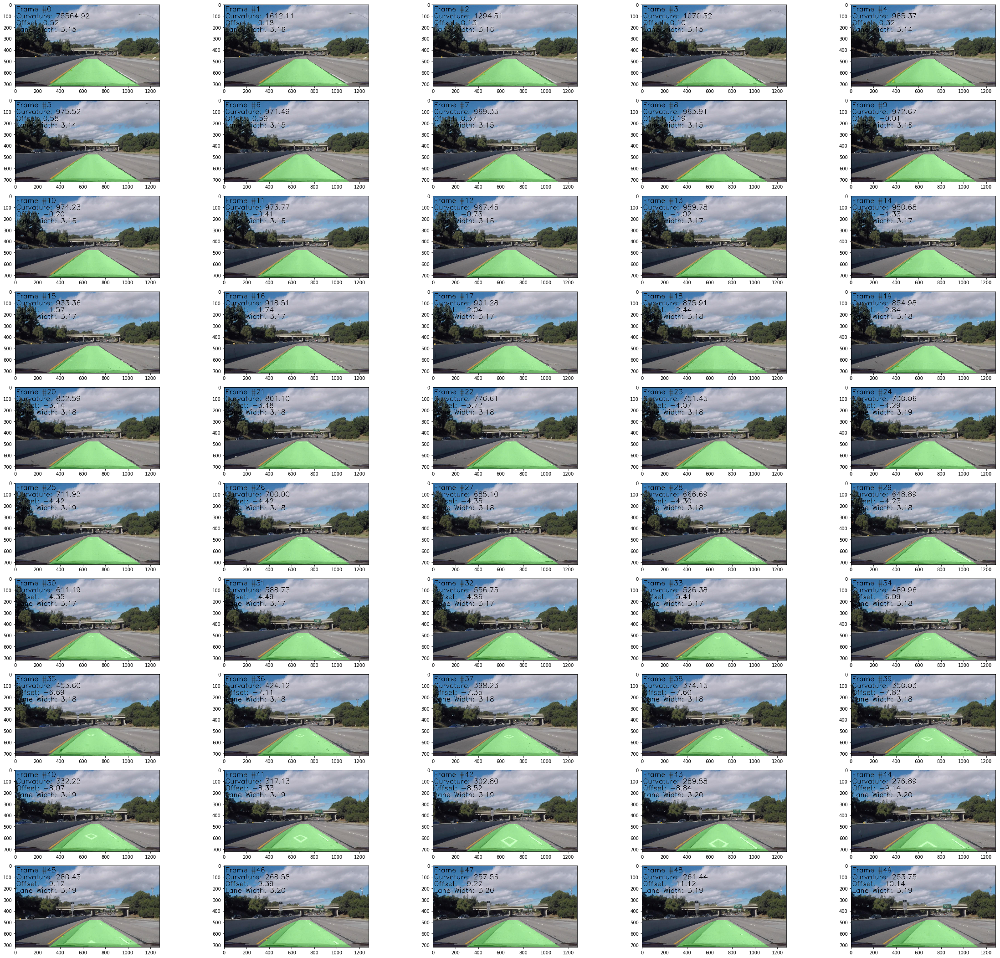

In [1005]:
lane_line_image_files = sorted(glob.glob('%s/*.jpg' % lane_line_dir))
lane_line_images = read_imgs(lane_line_image_files)
figsize=(32,32)
display_images(lane_line_images, start_idx=0, end_idx=50, columns=5, figsize=figsize)

## Harder Challenge Video

In [1006]:
video = 'harder_challenge_video.mp4'
output_dir = '%s/harder_challenge_video' % data_dir
extract_video_imgs(video, output_dir)

100%|██████████| 1199/1199 [02:12<00:00, 11.30it/s]

In [1007]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))
len(video_image_files)

1198

In [1008]:
lane_line_dir = '%s/lane_lines_harder_challenge_video' % data_dir

In [1013]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))

frame_files, curvatures = make_lane_line_frames(video_image_files, lane_line_dir, 
                                                max_n_fits=8, start_idx=0, margin=50,
                                                min_lane_width=2.6, max_lane_width=3.4)


  0%|          | 0/1198 [00:00<?, ?it/s]

### 0
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.37781479421



  0%|          | 1/1198 [00:01<36:50,  1.85s/it]

### 1
###img min(), max() 0 255
###img (720, 1280, 3) uint8



  0%|          | 2/1198 [00:04<39:33,  1.98s/it]

###fit_lane - leftx 42028
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23659
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3790973286
### 2
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  0%|          | 3/1198 [00:06<39:22,  1.98s/it]

###fit_lane - leftx 42849
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23215
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37674899882
### 3
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  0%|          | 4/1198 [00:07<38:06,  1.92s/it]

###fit_lane - leftx 43962
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 24422
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37063578135
### 4
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  0%|          | 5/1198 [00:09<37:18,  1.88s/it]

###fit_lane - leftx 43053
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 24661
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35660683069
### 5
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 6/1198 [00:11<35:37,  1.79s/it]

###fit_lane - leftx 40533
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23411
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32635851214
### 6
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 7/1198 [00:13<35:34,  1.79s/it]

###fit_lane - leftx 37508
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 21870
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28189500691
### 7
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 8/1198 [00:14<35:17,  1.78s/it]

###fit_lane - leftx 36015
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 22176
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2340177038
### 8
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 9/1198 [00:16<34:28,  1.74s/it]

###fit_lane - leftx 36343
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 22109
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20426915676
### 9
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 10/1198 [00:18<34:59,  1.77s/it]

###fit_lane - leftx 35361
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 21483
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.1961856389
### 10
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 11/1198 [00:19<34:12,  1.73s/it]

###fit_lane - leftx 36551
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23090
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20173785768
### 11
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 12/1198 [00:21<35:20,  1.79s/it]

###fit_lane - leftx 35778
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 22529
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20644312669
### 12
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 13/1198 [00:23<36:45,  1.86s/it]

###fit_lane - leftx 36272
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23125
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2107614797
### 13
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|          | 14/1198 [00:25<36:20,  1.84s/it]

###fit_lane - leftx 36996
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 24040
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21466363083
### 14
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|▏         | 15/1198 [00:27<35:21,  1.79s/it]

###fit_lane - leftx 33943
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 21499
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21976037993
### 15
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|▏         | 16/1198 [00:29<35:35,  1.81s/it]

###fit_lane - leftx 34892
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23663
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.230443238
### 16
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  1%|▏         | 17/1198 [00:30<35:16,  1.79s/it]

###fit_lane - leftx 34547
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23431
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24462005786
### 17
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 18/1198 [00:32<35:40,  1.81s/it]

###fit_lane - leftx 35003
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 24049
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26947258114
### 18
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 19/1198 [00:34<34:34,  1.76s/it]

###fit_lane - leftx 35229
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 25447
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29577452289
### 19
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 20/1198 [00:36<34:01,  1.73s/it]

###fit_lane - leftx 34962
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 25705
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32188998683
### 20
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 21/1198 [00:37<33:35,  1.71s/it]

###fit_lane - leftx 34765
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 25629
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34641566373
### 21
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 22/1198 [00:39<34:55,  1.78s/it]

###fit_lane - leftx 34627
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 25712
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36497986454
### 22
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 23/1198 [00:41<33:38,  1.72s/it]

###fit_lane - leftx 34219
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 25894
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37807936451
### 23
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 24/1198 [00:43<33:30,  1.71s/it]

###fit_lane - leftx 33695
###fit_lane - left_min_y, left_max_y 11 719
###fit_lane - rightx 25162
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38268648849
### 24
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 25/1198 [00:44<32:46,  1.68s/it]

###fit_lane - leftx 32706
###fit_lane - left_min_y, left_max_y 22 719
###fit_lane - rightx 23950
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3785749951
### 25
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 26/1198 [00:46<34:15,  1.75s/it]

###fit_lane - leftx 32526
###fit_lane - left_min_y, left_max_y 31 719
###fit_lane - rightx 23862
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37310088122
### 26
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 27/1198 [00:48<34:11,  1.75s/it]

###fit_lane - leftx 31466
###fit_lane - left_min_y, left_max_y 32 719
###fit_lane - rightx 23429
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36862373389
### 27
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 28/1198 [00:49<33:19,  1.71s/it]

###fit_lane - leftx 30169
###fit_lane - left_min_y, left_max_y 39 719
###fit_lane - rightx 22974
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37418152281
### 28
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  2%|▏         | 29/1198 [00:51<33:50,  1.74s/it]

###fit_lane - leftx 29398
###fit_lane - left_min_y, left_max_y 41 719
###fit_lane - rightx 22913
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38658425132
### 29
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  3%|▎         | 30/1198 [00:53<34:37,  1.78s/it]

###fit_lane - leftx 31683
###fit_lane - left_min_y, left_max_y 43 719
###fit_lane - rightx 24664
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40353318798
29 3.40353318798 resetting find lanes
### 30
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.42987574999
30 3.42987574999 resetting find lanes


  3%|▎         | 31/1198 [00:55<34:20,  1.77s/it]

### 31
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.46344920163
31 3.46344920163 resetting find lanes


  3%|▎         | 32/1198 [00:57<34:19,  1.77s/it]

### 32
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 33/1198 [00:58<33:46,  1.74s/it]

###lane_width 3.48258065192
32 3.48258065192 resetting find lanes
### 33
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.48973913182
33 3.48973913182 resetting find lanes


  3%|▎         | 34/1198 [01:00<33:16,  1.72s/it]

### 34
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.46492254748
34 3.46492254748 resetting find lanes


  3%|▎         | 35/1198 [01:02<33:03,  1.71s/it]

### 35
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.44169328353
35 3.44169328353 resetting find lanes


  3%|▎         | 36/1198 [01:03<32:39,  1.69s/it]

### 36
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 37/1198 [01:05<33:40,  1.74s/it]

###lane_width 3.4132782996
36 3.4132782996 resetting find lanes
### 37
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.39891380168


  3%|▎         | 38/1198 [01:07<33:29,  1.73s/it]

### 38
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  3%|▎         | 39/1198 [01:08<32:30,  1.68s/it]

###fit_lane - leftx 23019
###fit_lane - left_min_y, left_max_y 183 719
###fit_lane - rightx 21603
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.41458826327
38 3.41458826327 resetting find lanes
### 39
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.41791850592
39 3.41791850592 resetting find lanes


  3%|▎         | 40/1198 [01:10<32:44,  1.70s/it]

### 40
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 41/1198 [01:12<33:14,  1.72s/it]

###lane_width 3.42674459866
40 3.42674459866 resetting find lanes
### 41
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.39491107805


  4%|▎         | 42/1198 [01:14<33:27,  1.74s/it]

### 42
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  4%|▎         | 43/1198 [01:15<33:49,  1.76s/it]

###fit_lane - leftx 18984
###fit_lane - left_min_y, left_max_y 254 719
###fit_lane - rightx 30571
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40961046687
42 3.40961046687 resetting find lanes
### 43
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▎         | 44/1198 [01:18<37:21,  1.94s/it]

###lane_width 3.39044060953
### 44
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 20644
###fit_lane - left_min_y, left_max_y 238 719
###fit_lane - rightx 32542
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.42245412669
44 3.42245412669 resetting find lanes


  4%|▍         | 45/1198 [01:20<41:24,  2.16s/it]

### 45
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.38564066721


  4%|▍         | 46/1198 [01:22<40:20,  2.10s/it]

### 46
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  4%|▍         | 47/1198 [01:24<37:54,  1.98s/it]

###fit_lane - leftx 19978
###fit_lane - left_min_y, left_max_y 241 719
###fit_lane - rightx 32542
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.41633982153
46 3.41633982153 resetting find lanes
### 47
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.39025520038


  4%|▍         | 48/1198 [01:26<35:33,  1.86s/it]

### 48
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  4%|▍         | 49/1198 [01:27<34:34,  1.81s/it]

###fit_lane - leftx 20042
###fit_lane - left_min_y, left_max_y 256 719
###fit_lane - rightx 34675
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.42417679415
48 3.42417679415 resetting find lanes
### 49
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.39730148848


  4%|▍         | 50/1198 [01:29<33:42,  1.76s/it]

### 50
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  4%|▍         | 51/1198 [01:31<33:45,  1.77s/it]

###fit_lane - leftx 19478
###fit_lane - left_min_y, left_max_y 260 719
###fit_lane - rightx 34969
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40944017362
50 3.40944017362 resetting find lanes
### 51
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.38808817569


  4%|▍         | 52/1198 [01:33<33:58,  1.78s/it]

### 52
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  4%|▍         | 53/1198 [01:34<33:33,  1.76s/it]

###fit_lane - leftx 19559
###fit_lane - left_min_y, left_max_y 269 719
###fit_lane - rightx 39298
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.3870678267
### 53
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▍         | 54/1198 [01:37<37:31,  1.97s/it]

###fit_lane - leftx 21561
###fit_lane - left_min_y, left_max_y 237 719
###fit_lane - rightx 39489
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.37338713742
### 54
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▍         | 55/1198 [01:39<36:20,  1.91s/it]

###fit_lane - leftx 21441
###fit_lane - left_min_y, left_max_y 236 719
###fit_lane - rightx 38397
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.37452449903
### 55
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 26761
###fit_lane - left_min_y, left_max_y 189 719
###fit_lane - rightx 40105
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.39744915099


  5%|▍         | 56/1198 [01:41<37:58,  2.00s/it]

### 56
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▍         | 57/1198 [01:43<38:29,  2.02s/it]

###fit_lane - leftx 26810
###fit_lane - left_min_y, left_max_y 189 719
###fit_lane - rightx 39132
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.42329179182
56 3.42329179182 resetting find lanes
### 57
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  5%|▍         | 58/1198 [01:45<41:24,  2.18s/it]

###lane_width 3.39818236927
### 58
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▍         | 59/1198 [01:47<39:30,  2.08s/it]

###fit_lane - leftx 22118
###fit_lane - left_min_y, left_max_y 211 719
###fit_lane - rightx 27752
###fit_lane - right_min_y, right_max_y 0 712
###lane_width 3.39750603457
### 59
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 60/1198 [01:49<38:51,  2.05s/it]

###fit_lane - leftx 21486
###fit_lane - left_min_y, left_max_y 222 718
###fit_lane - rightx 27687
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.38342703273
### 60
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 61/1198 [01:52<40:31,  2.14s/it]

###fit_lane - leftx 21024
###fit_lane - left_min_y, left_max_y 234 718
###fit_lane - rightx 25819
###fit_lane - right_min_y, right_max_y 0 712
###lane_width 3.41284982413
60 3.41284982413 resetting find lanes
### 61
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.3421910973


  5%|▌         | 62/1198 [01:54<40:26,  2.14s/it]

### 62
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 63/1198 [01:56<38:47,  2.05s/it]

###fit_lane - leftx 20435
###fit_lane - left_min_y, left_max_y 259 718
###fit_lane - rightx 23840
###fit_lane - right_min_y, right_max_y 28 716
###lane_width 3.34008022621
### 63
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 64/1198 [01:57<37:04,  1.96s/it]

###fit_lane - leftx 19720
###fit_lane - left_min_y, left_max_y 268 718
###fit_lane - rightx 22743
###fit_lane - right_min_y, right_max_y 55 713
###lane_width 3.33545093538
### 64
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  5%|▌         | 65/1198 [01:59<35:32,  1.88s/it]

###fit_lane - leftx 19647
###fit_lane - left_min_y, left_max_y 269 718
###fit_lane - rightx 21977
###fit_lane - right_min_y, right_max_y 85 714
###lane_width 3.39024716548
### 65
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 66/1198 [02:01<34:16,  1.82s/it]

###fit_lane - leftx 23481
###fit_lane - left_min_y, left_max_y 230 718
###fit_lane - rightx 21479
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.39540761235
### 66
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 67/1198 [02:02<34:04,  1.81s/it]

###fit_lane - leftx 23932
###fit_lane - left_min_y, left_max_y 235 718
###fit_lane - rightx 20564
###fit_lane - right_min_y, right_max_y 21 714
###lane_width 3.40789276956
66 3.40789276956 resetting find lanes
### 67
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.32982797118


  6%|▌         | 68/1198 [02:04<32:52,  1.75s/it]

### 68
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 69/1198 [02:06<33:32,  1.78s/it]

###fit_lane - leftx 20250
###fit_lane - left_min_y, left_max_y 241 719
###fit_lane - rightx 18873
###fit_lane - right_min_y, right_max_y 4 713
###lane_width 3.31672545587
### 69
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 70/1198 [02:08<33:43,  1.79s/it]

###fit_lane - leftx 19922
###fit_lane - left_min_y, left_max_y 245 719
###fit_lane - rightx 19821
###fit_lane - right_min_y, right_max_y 11 713
###lane_width 3.30065409748
### 70
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 71/1198 [02:10<33:43,  1.80s/it]

###fit_lane - leftx 18703
###fit_lane - left_min_y, left_max_y 251 718
###fit_lane - rightx 19835
###fit_lane - right_min_y, right_max_y 11 714
###lane_width 3.38178069552
### 71
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 72/1198 [02:11<32:52,  1.75s/it]

###fit_lane - leftx 21948
###fit_lane - left_min_y, left_max_y 248 718
###fit_lane - rightx 19848
###fit_lane - right_min_y, right_max_y 108 713
###lane_width 3.39329326918
### 72
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▌         | 73/1198 [02:13<32:55,  1.76s/it]

###fit_lane - leftx 21928
###fit_lane - left_min_y, left_max_y 250 718
###fit_lane - rightx 20443
###fit_lane - right_min_y, right_max_y 123 717
###lane_width 3.41144066885
72 3.41144066885 resetting find lanes
### 73
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.36402755604


  6%|▌         | 74/1198 [02:15<32:32,  1.74s/it]

### 74
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▋         | 75/1198 [02:16<32:21,  1.73s/it]

###fit_lane - leftx 18454
###fit_lane - left_min_y, left_max_y 255 717
###fit_lane - rightx 18634
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.36388282436
### 75
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▋         | 76/1198 [02:18<32:12,  1.72s/it]

###fit_lane - leftx 17749
###fit_lane - left_min_y, left_max_y 260 716
###fit_lane - rightx 17852
###fit_lane - right_min_y, right_max_y 36 719
###lane_width 3.34063999784
### 76
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  6%|▋         | 77/1198 [02:20<31:38,  1.69s/it]

###fit_lane - leftx 17209
###fit_lane - left_min_y, left_max_y 266 716
###fit_lane - rightx 16609
###fit_lane - right_min_y, right_max_y 82 718
###lane_width 3.35907588048
### 77
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 78/1198 [02:22<32:53,  1.76s/it]

###fit_lane - leftx 21484
###fit_lane - left_min_y, left_max_y 264 716
###fit_lane - rightx 17904
###fit_lane - right_min_y, right_max_y 108 718
###lane_width 3.32463517265
### 78
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 79/1198 [02:23<32:04,  1.72s/it]

###fit_lane - leftx 21239
###fit_lane - left_min_y, left_max_y 264 715
###fit_lane - rightx 18256
###fit_lane - right_min_y, right_max_y 54 718
###lane_width 3.29911986706
### 79
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 80/1198 [02:25<31:52,  1.71s/it]

###fit_lane - leftx 20946
###fit_lane - left_min_y, left_max_y 264 715
###fit_lane - rightx 19987
###fit_lane - right_min_y, right_max_y 58 718
###lane_width 3.29431602144
### 80
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 81/1198 [02:27<33:00,  1.77s/it]

###fit_lane - leftx 21496
###fit_lane - left_min_y, left_max_y 264 715
###fit_lane - rightx 20470
###fit_lane - right_min_y, right_max_y 60 717
###lane_width 3.29070275143
### 81
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 82/1198 [02:28<32:10,  1.73s/it]

###fit_lane - leftx 21184
###fit_lane - left_min_y, left_max_y 264 714
###fit_lane - rightx 19484
###fit_lane - right_min_y, right_max_y 78 717
###lane_width 3.28313871227
### 82
###img min(), max() 1 255
###img (720, 1280, 3) uint8


  7%|▋         | 83/1198 [02:30<31:31,  1.70s/it]

###fit_lane - leftx 20352
###fit_lane - left_min_y, left_max_y 267 714
###fit_lane - rightx 18087
###fit_lane - right_min_y, right_max_y 99 718
###lane_width 3.2681935752
### 83
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 84/1198 [02:32<31:51,  1.72s/it]

###fit_lane - leftx 20129
###fit_lane - left_min_y, left_max_y 269 714
###fit_lane - rightx 17515
###fit_lane - right_min_y, right_max_y 132 718
###lane_width 3.24089796042
### 84
###img min(), max() 2 255
###img (720, 1280, 3) uint8


  7%|▋         | 85/1198 [02:34<31:55,  1.72s/it]

###fit_lane - leftx 20904
###fit_lane - left_min_y, left_max_y 271 714
###fit_lane - rightx 16084
###fit_lane - right_min_y, right_max_y 238 716
###lane_width 3.21040054005
### 85
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 86/1198 [02:36<33:04,  1.78s/it]

###fit_lane - leftx 20206
###fit_lane - left_min_y, left_max_y 274 714
###fit_lane - rightx 15645
###fit_lane - right_min_y, right_max_y 193 716
###lane_width 3.18465069881
### 86
###img min(), max() 1 255
###img (720, 1280, 3) uint8


  7%|▋         | 87/1198 [02:37<31:34,  1.71s/it]

###fit_lane - leftx 17032
###fit_lane - left_min_y, left_max_y 274 714
###fit_lane - rightx 15001
###fit_lane - right_min_y, right_max_y 239 713
###lane_width 3.16485447715
### 87
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 88/1198 [02:39<32:29,  1.76s/it]

###fit_lane - leftx 16859
###fit_lane - left_min_y, left_max_y 276 714
###fit_lane - rightx 15828
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.16985260247
### 88
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  7%|▋         | 89/1198 [02:41<33:11,  1.80s/it]

###fit_lane - leftx 14982
###fit_lane - left_min_y, left_max_y 279 714
###fit_lane - rightx 19051
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.18930566225
### 89
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 90/1198 [02:42<32:29,  1.76s/it]

###fit_lane - leftx 14290
###fit_lane - left_min_y, left_max_y 261 714
###fit_lane - rightx 19389
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.22242691853
### 90
###img min(), max() 1 255
###img (720, 1280, 3) uint8


  8%|▊         | 91/1198 [02:44<32:28,  1.76s/it]

###fit_lane - leftx 15622
###fit_lane - left_min_y, left_max_y 239 714
###fit_lane - rightx 22295
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.26708703305
### 91
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 92/1198 [02:46<31:53,  1.73s/it]

###fit_lane - leftx 15983
###fit_lane - left_min_y, left_max_y 217 714
###fit_lane - rightx 21847
###fit_lane - right_min_y, right_max_y 5 718
###lane_width 3.29478531961
### 92
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 93/1198 [02:48<31:43,  1.72s/it]

###fit_lane - leftx 16837
###fit_lane - left_min_y, left_max_y 198 714
###fit_lane - rightx 20568
###fit_lane - right_min_y, right_max_y 16 718
###lane_width 3.31065243613
### 93
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 94/1198 [02:49<31:39,  1.72s/it]

###fit_lane - leftx 18264
###fit_lane - left_min_y, left_max_y 177 715
###fit_lane - rightx 22621
###fit_lane - right_min_y, right_max_y 19 719
###lane_width 3.31150605984
### 94
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 95/1198 [02:51<31:50,  1.73s/it]

###fit_lane - leftx 19812
###fit_lane - left_min_y, left_max_y 153 715
###fit_lane - rightx 22776
###fit_lane - right_min_y, right_max_y 17 719
###lane_width 3.31602731546
### 95
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 96/1198 [02:53<31:28,  1.71s/it]

###fit_lane - leftx 21411
###fit_lane - left_min_y, left_max_y 129 714
###fit_lane - rightx 22203
###fit_lane - right_min_y, right_max_y 17 719
###lane_width 3.31861608427
### 96
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 97/1198 [02:54<31:09,  1.70s/it]

###fit_lane - leftx 23471
###fit_lane - left_min_y, left_max_y 92 714
###fit_lane - rightx 24873
###fit_lane - right_min_y, right_max_y 13 719
###lane_width 3.32131264635
### 97
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 98/1198 [02:56<30:40,  1.67s/it]

###fit_lane - leftx 23615
###fit_lane - left_min_y, left_max_y 59 714
###fit_lane - rightx 23869
###fit_lane - right_min_y, right_max_y 12 719
###lane_width 3.31871913711
### 98
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 99/1198 [02:58<31:11,  1.70s/it]

###fit_lane - leftx 23895
###fit_lane - left_min_y, left_max_y 30 714
###fit_lane - rightx 23333
###fit_lane - right_min_y, right_max_y 15 719
###lane_width 3.31549153395
### 99
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 100/1198 [02:59<30:48,  1.68s/it]

###fit_lane - leftx 24225
###fit_lane - left_min_y, left_max_y 0 714
###fit_lane - rightx 23818
###fit_lane - right_min_y, right_max_y 23 719
###lane_width 3.30125352093
### 100
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  8%|▊         | 101/1198 [03:01<31:21,  1.72s/it]

###fit_lane - leftx 24069
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 22536
###fit_lane - right_min_y, right_max_y 31 719
###lane_width 3.28074464922
### 101
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▊         | 102/1198 [03:03<32:35,  1.78s/it]

###fit_lane - leftx 23680
###fit_lane - left_min_y, left_max_y 0 714
###fit_lane - rightx 21587
###fit_lane - right_min_y, right_max_y 38 719
###lane_width 3.25798815702
### 102
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 23431
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 21222
###fit_lane - right_min_y, right_max_y 46 719
###lane_width 3.23966346205


  9%|▊         | 103/1198 [03:05<32:19,  1.77s/it]

### 103
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▊         | 104/1198 [03:07<32:40,  1.79s/it]

###fit_lane - leftx 22995
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 20721
###fit_lane - right_min_y, right_max_y 53 719
###lane_width 3.23022438913
### 104
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 105/1198 [03:09<32:35,  1.79s/it]

###fit_lane - leftx 23416
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 20880
###fit_lane - right_min_y, right_max_y 63 719
###lane_width 3.23032679922
### 105
###img min(), max() 4 255
###img (720, 1280, 3) uint8


  9%|▉         | 106/1198 [03:10<31:12,  1.72s/it]

###fit_lane - leftx 22870
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 20362
###fit_lane - right_min_y, right_max_y 70 718
###lane_width 3.22975724316
### 106
###img min(), max() 2 255
###img (720, 1280, 3) uint8


  9%|▉         | 107/1198 [03:12<31:22,  1.73s/it]

###fit_lane - leftx 22036
###fit_lane - left_min_y, left_max_y 0 714
###fit_lane - rightx 19645
###fit_lane - right_min_y, right_max_y 78 718
###lane_width 3.22484760999
### 107
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 108/1198 [03:14<31:28,  1.73s/it]

###fit_lane - leftx 21278
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 17948
###fit_lane - right_min_y, right_max_y 92 718
###lane_width 3.21012446841
### 108
###img min(), max() 10 255
###img (720, 1280, 3) uint8


  9%|▉         | 109/1198 [03:15<31:00,  1.71s/it]

###fit_lane - leftx 22140
###fit_lane - left_min_y, left_max_y 205 719
###fit_lane - rightx 18334
###fit_lane - right_min_y, right_max_y 102 719
###lane_width 3.23484250132
### 109
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 110/1198 [03:17<31:39,  1.75s/it]

###fit_lane - leftx 23258
###fit_lane - left_min_y, left_max_y 185 719
###fit_lane - rightx 17354
###fit_lane - right_min_y, right_max_y 113 719
###lane_width 3.26166083246
### 110
###img min(), max() 4 255
###img (720, 1280, 3) uint8


  9%|▉         | 111/1198 [03:19<32:10,  1.78s/it]

###fit_lane - leftx 23196
###fit_lane - left_min_y, left_max_y 158 719
###fit_lane - rightx 15297
###fit_lane - right_min_y, right_max_y 128 717
###lane_width 3.28287937813
### 111
###img min(), max() 0 255
###img (720, 1280, 3) uint8


  9%|▉         | 112/1198 [03:21<31:57,  1.77s/it]

###fit_lane - leftx 23110
###fit_lane - left_min_y, left_max_y 137 719
###fit_lane - rightx 14484
###fit_lane - right_min_y, right_max_y 140 718
###lane_width 3.25513655834
### 112
###img min(), max() 9 255
###img (720, 1280, 3) uint8


  9%|▉         | 113/1198 [03:22<31:44,  1.76s/it]

###fit_lane - leftx 26946
###fit_lane - left_min_y, left_max_y 110 719
###fit_lane - rightx 15100
###fit_lane - right_min_y, right_max_y 153 718
###lane_width 3.23076160229
### 113
###img min(), max() 5 255
###img (720, 1280, 3) uint8


 10%|▉         | 114/1198 [03:24<31:20,  1.74s/it]

###fit_lane - leftx 27555
###fit_lane - left_min_y, left_max_y 71 719
###fit_lane - rightx 13625
###fit_lane - right_min_y, right_max_y 170 718
###lane_width 3.20996816503
### 114
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 10%|▉         | 115/1198 [03:26<32:02,  1.78s/it]

###fit_lane - leftx 30956
###fit_lane - left_min_y, left_max_y 23 719
###fit_lane - rightx 13126
###fit_lane - right_min_y, right_max_y 180 719
###lane_width 3.20139303345
### 115
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 10%|▉         | 116/1198 [03:28<31:04,  1.72s/it]

###fit_lane - leftx 32899
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12509
###fit_lane - right_min_y, right_max_y 191 719
###lane_width 3.19032758492
### 116
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|▉         | 117/1198 [03:29<30:13,  1.68s/it]

###fit_lane - leftx 32959
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11813
###fit_lane - right_min_y, right_max_y 206 718
###lane_width 3.19028647087
### 117
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|▉         | 118/1198 [03:31<31:02,  1.72s/it]

###fit_lane - leftx 31512
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 11728
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.16815397044
### 118
###img min(), max() 3 255
###img (720, 1280, 3) uint8


 10%|▉         | 119/1198 [03:33<30:50,  1.71s/it]

###fit_lane - leftx 28812
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 11586
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.15191585033
### 119
###img min(), max() 6 255
###img (720, 1280, 3) uint8


 10%|█         | 120/1198 [03:34<30:41,  1.71s/it]

###fit_lane - leftx 25298
###fit_lane - left_min_y, left_max_y 42 717
###fit_lane - rightx 10823
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.13629169307
### 120
###img min(), max() 15 255
###img (720, 1280, 3) uint8


 10%|█         | 121/1198 [03:36<31:20,  1.75s/it]

###fit_lane - leftx 25233
###fit_lane - left_min_y, left_max_y 70 717
###fit_lane - rightx 10584
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.11905449642
### 121
###img min(), max() 14 255
###img (720, 1280, 3) uint8


 10%|█         | 122/1198 [03:38<31:00,  1.73s/it]

###fit_lane - leftx 25217
###fit_lane - left_min_y, left_max_y 89 717
###fit_lane - rightx 11220
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.10746987748
### 122
###img min(), max() 16 255
###img (720, 1280, 3) uint8


 10%|█         | 123/1198 [03:40<30:59,  1.73s/it]

###fit_lane - leftx 25201
###fit_lane - left_min_y, left_max_y 105 717
###fit_lane - rightx 10876
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.10361498285
### 123
###img min(), max() 9 255
###img (720, 1280, 3) uint8


 10%|█         | 124/1198 [03:41<30:01,  1.68s/it]

###fit_lane - leftx 25330
###fit_lane - left_min_y, left_max_y 112 717
###fit_lane - rightx 8757
###fit_lane - right_min_y, right_max_y 124 718
###lane_width 3.10787260539
### 124
###img min(), max() 14 255
###img (720, 1280, 3) uint8


 10%|█         | 125/1198 [03:43<29:58,  1.68s/it]

###fit_lane - leftx 24946
###fit_lane - left_min_y, left_max_y 105 717
###fit_lane - rightx 7854
###fit_lane - right_min_y, right_max_y 160 718
###lane_width 3.10521298636
### 125
###img min(), max() 18 255
###img (720, 1280, 3) uint8


 11%|█         | 126/1198 [03:45<29:59,  1.68s/it]

###fit_lane - leftx 27739
###fit_lane - left_min_y, left_max_y 109 718
###fit_lane - rightx 7488
###fit_lane - right_min_y, right_max_y 190 718
###lane_width 3.09801473613
### 126
###img min(), max() 21 255
###img (720, 1280, 3) uint8


 11%|█         | 127/1198 [03:46<29:38,  1.66s/it]

###fit_lane - leftx 27265
###fit_lane - left_min_y, left_max_y 111 718
###fit_lane - rightx 7166
###fit_lane - right_min_y, right_max_y 371 718
###lane_width 3.11838764221
### 127
###img min(), max() 22 255
###img (720, 1280, 3) uint8


 11%|█         | 128/1198 [03:48<30:06,  1.69s/it]

###fit_lane - leftx 28339
###fit_lane - left_min_y, left_max_y 112 718
###fit_lane - rightx 7367
###fit_lane - right_min_y, right_max_y 157 718
###lane_width 3.1210919829
### 128
###img min(), max() 24 255
###img (720, 1280, 3) uint8


 11%|█         | 129/1198 [03:50<30:15,  1.70s/it]

###fit_lane - leftx 27353
###fit_lane - left_min_y, left_max_y 131 718
###fit_lane - rightx 7020
###fit_lane - right_min_y, right_max_y 136 718
###lane_width 3.11752876645
### 129
###img min(), max() 25 255
###img (720, 1280, 3) uint8


 11%|█         | 130/1198 [03:51<30:08,  1.69s/it]

###fit_lane - leftx 27547
###fit_lane - left_min_y, left_max_y 138 718
###fit_lane - rightx 7435
###fit_lane - right_min_y, right_max_y 105 718
###lane_width 3.09715955419
### 130
###img min(), max() 28 255
###img (720, 1280, 3) uint8


 11%|█         | 131/1198 [03:53<30:16,  1.70s/it]

###fit_lane - leftx 27808
###fit_lane - left_min_y, left_max_y 148 718
###fit_lane - rightx 6534
###fit_lane - right_min_y, right_max_y 367 718
###lane_width 3.10711539928
### 131
###img min(), max() 28 255
###img (720, 1280, 3) uint8


 11%|█         | 132/1198 [03:55<30:38,  1.72s/it]

###fit_lane - leftx 27161
###fit_lane - left_min_y, left_max_y 167 718
###fit_lane - rightx 8769
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.09626716593
### 132
###img min(), max() 25 255
###img (720, 1280, 3) uint8


 11%|█         | 133/1198 [03:57<30:32,  1.72s/it]

###fit_lane - leftx 26927
###fit_lane - left_min_y, left_max_y 155 717
###fit_lane - rightx 8295
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.08218465209
### 133
###img min(), max() 22 255
###img (720, 1280, 3) uint8


 11%|█         | 134/1198 [03:58<30:44,  1.73s/it]

###fit_lane - leftx 27316
###fit_lane - left_min_y, left_max_y 134 716
###fit_lane - rightx 8060
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.05002279055
### 134
###img min(), max() 23 255
###img (720, 1280, 3) uint8


 11%|█▏        | 135/1198 [04:00<30:36,  1.73s/it]

###fit_lane - leftx 29486
###fit_lane - left_min_y, left_max_y 98 716
###fit_lane - rightx 6775
###fit_lane - right_min_y, right_max_y 370 718
###lane_width 3.06321338146
### 135
###img min(), max() 21 255
###img (720, 1280, 3) uint8


 11%|█▏        | 136/1198 [04:02<30:18,  1.71s/it]

###fit_lane - leftx 30293
###fit_lane - left_min_y, left_max_y 98 715
###fit_lane - rightx 8182
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.05808504343
### 136
###img min(), max() 22 255
###img (720, 1280, 3) uint8


 11%|█▏        | 137/1198 [04:03<30:33,  1.73s/it]

###fit_lane - leftx 30451
###fit_lane - left_min_y, left_max_y 61 715
###fit_lane - rightx 7941
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.05778096483
### 137
###img min(), max() 21 255
###img (720, 1280, 3) uint8


 12%|█▏        | 138/1198 [04:05<30:38,  1.73s/it]

###fit_lane - leftx 31954
###fit_lane - left_min_y, left_max_y 39 716
###fit_lane - rightx 7354
###fit_lane - right_min_y, right_max_y 26 718
###lane_width 3.03620655995
### 138
###img min(), max() 22 255
###img (720, 1280, 3) uint8


 12%|█▏        | 139/1198 [04:07<31:20,  1.78s/it]

###fit_lane - leftx 32132
###fit_lane - left_min_y, left_max_y 27 716
###fit_lane - rightx 6821
###fit_lane - right_min_y, right_max_y 369 718
###lane_width 3.06873124799
### 139
###img min(), max() 24 255
###img (720, 1280, 3) uint8


 12%|█▏        | 140/1198 [04:09<30:40,  1.74s/it]

###fit_lane - leftx 33260
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 7297
###fit_lane - right_min_y, right_max_y 351 718
###lane_width 3.10730405971
### 140
###img min(), max() 23 255
###img (720, 1280, 3) uint8


 12%|█▏        | 141/1198 [04:10<29:54,  1.70s/it]

###fit_lane - leftx 33482
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 7571
###fit_lane - right_min_y, right_max_y 321 718
###lane_width 3.14928012343
### 141
###img min(), max() 21 255
###img (720, 1280, 3) uint8


 12%|█▏        | 142/1198 [04:12<29:51,  1.70s/it]

###fit_lane - leftx 35452
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9841
###fit_lane - right_min_y, right_max_y 241 718
###lane_width 3.16789598205
### 142
###img min(), max() 16 255
###img (720, 1280, 3) uint8


 12%|█▏        | 143/1198 [04:14<29:37,  1.69s/it]

###fit_lane - leftx 37579
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10231
###fit_lane - right_min_y, right_max_y 253 718
###lane_width 3.18539771676
### 143
###img min(), max() 24 255
###img (720, 1280, 3) uint8


 12%|█▏        | 144/1198 [04:15<29:48,  1.70s/it]

###fit_lane - leftx 41287
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10608
###fit_lane - right_min_y, right_max_y 262 718
###lane_width 3.20801927127
### 144
###img min(), max() 18 255
###img (720, 1280, 3) uint8


 12%|█▏        | 145/1198 [04:17<30:22,  1.73s/it]

###fit_lane - leftx 42876
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10400
###fit_lane - right_min_y, right_max_y 274 718
###lane_width 3.23491137974
### 145
###img min(), max() 22 255
###img (720, 1280, 3) uint8


 12%|█▏        | 146/1198 [04:19<30:11,  1.72s/it]

###fit_lane - leftx 43740
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10580
###fit_lane - right_min_y, right_max_y 285 718
###lane_width 3.26654229945
### 146
###img min(), max() 15 255
###img (720, 1280, 3) uint8


 12%|█▏        | 147/1198 [04:21<30:46,  1.76s/it]

###fit_lane - leftx 45263
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10179
###fit_lane - right_min_y, right_max_y 295 713
###lane_width 3.29830630091
### 147
###img min(), max() 16 255
###img (720, 1280, 3) uint8


 12%|█▏        | 148/1198 [04:22<30:34,  1.75s/it]

###fit_lane - leftx 45760
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9588
###fit_lane - right_min_y, right_max_y 306 713
###lane_width 3.33078774922
### 148
###img min(), max() 18 255
###img (720, 1280, 3) uint8


 12%|█▏        | 149/1198 [04:24<30:31,  1.75s/it]

###fit_lane - leftx 47516
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9586
###fit_lane - right_min_y, right_max_y 316 718
###lane_width 3.36184801301
### 149
###img min(), max() 17 255
###img (720, 1280, 3) uint8


 13%|█▎        | 150/1198 [04:26<30:24,  1.74s/it]

###fit_lane - leftx 47371
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9797
###fit_lane - right_min_y, right_max_y 326 719
###lane_width 3.39102582125
### 150
###img min(), max() 10 255
###img (720, 1280, 3) uint8


 13%|█▎        | 151/1198 [04:28<30:19,  1.74s/it]

###fit_lane - leftx 47018
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9262
###fit_lane - right_min_y, right_max_y 336 718
###lane_width 3.41881691889
150 3.41881691889 resetting find lanes
### 151
###img min(), max() 15 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.45670589873
151 3.45670589873 resetting find lanes


 13%|█▎        | 152/1198 [04:29<30:13,  1.73s/it]

### 152
###img min(), max() 13 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.46328707706
152 3.46328707706 resetting find lanes


 13%|█▎        | 153/1198 [04:31<30:36,  1.76s/it]

### 153
###img min(), max() 8 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.4583566566
153 3.4583566566 resetting find lanes


 13%|█▎        | 154/1198 [04:33<29:39,  1.70s/it]

### 154
###img min(), max() 8 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.45338954834
154 3.45338954834 resetting find lanes


 13%|█▎        | 155/1198 [04:35<30:25,  1.75s/it]

### 155
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.46077711884
155 3.46077711884 resetting find lanes


 13%|█▎        | 156/1198 [04:37<31:25,  1.81s/it]

### 156
###img min(), max() 1 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.810917701757
156 0.810917701757 resetting find lanes


 13%|█▎        | 157/1198 [04:39<32:53,  1.90s/it]

### 157
###img min(), max() 4 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.412835208216
157 0.412835208216 resetting find lanes


 13%|█▎        | 158/1198 [04:41<35:47,  2.06s/it]

### 158
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.424391964955
158 0.424391964955 resetting find lanes


 13%|█▎        | 159/1198 [04:43<34:26,  1.99s/it]

### 159
###img min(), max() 7 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 6.55588265397
159 6.55588265397 resetting find lanes


 13%|█▎        | 160/1198 [04:45<33:28,  1.94s/it]

### 160
###img min(), max() 9 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 13%|█▎        | 161/1198 [04:47<33:27,  1.94s/it]

###lane_width 6.98685632187
160 6.98685632187 resetting find lanes
### 161
###img min(), max() 6 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 6.01177418408
161 6.01177418408 resetting find lanes


 14%|█▎        | 162/1198 [04:49<34:49,  2.02s/it]

### 162
###img min(), max() 1 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 14%|█▎        | 163/1198 [04:52<42:32,  2.47s/it]

###lane_width 3.08349772882
### 163
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 22039
###fit_lane - left_min_y, left_max_y 289 718
###fit_lane - rightx 408
###fit_lane - right_min_y, right_max_y 473 719
###lane_width 2.93813996027


 14%|█▎        | 164/1198 [04:55<42:19,  2.46s/it]

### 164
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▍        | 165/1198 [04:57<41:52,  2.43s/it]

###fit_lane - leftx 25331
###fit_lane - left_min_y, left_max_y 255 718
###fit_lane - rightx 494
###fit_lane - right_min_y, right_max_y 442 719
###lane_width 3.77160966054
164 3.77160966054 resetting find lanes
### 165
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 14%|█▍        | 166/1198 [05:02<55:17,  3.21s/it]

###lane_width 3.30164964748
### 166
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 28443
###fit_lane - left_min_y, left_max_y 199 718
###fit_lane - rightx 458
###fit_lane - right_min_y, right_max_y 696 719
###lane_width 3.24423314262


 14%|█▍        | 167/1198 [05:05<53:48,  3.13s/it]

### 167
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▍        | 168/1198 [05:07<49:24,  2.88s/it]

###fit_lane - leftx 26454
###fit_lane - left_min_y, left_max_y 150 718
###fit_lane - rightx 841
###fit_lane - right_min_y, right_max_y 648 719
###lane_width 3.35391644455
### 168
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 14%|█▍        | 169/1198 [05:10<46:00,  2.68s/it]

###fit_lane - leftx 24256
###fit_lane - left_min_y, left_max_y 240 718
###fit_lane - rightx 767
###fit_lane - right_min_y, right_max_y 654 719
###lane_width 3.31444976497
### 169
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 14%|█▍        | 170/1198 [05:12<41:50,  2.44s/it]

###fit_lane - leftx 22041
###fit_lane - left_min_y, left_max_y 292 719
###fit_lane - rightx 1094
###fit_lane - right_min_y, right_max_y 663 719
###lane_width 3.43532792239
169 3.43532792239 resetting find lanes
### 170
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 14%|█▍        | 171/1198 [05:15<46:51,  2.74s/it]

###lane_width 3.98850670697
170 3.98850670697 resetting find lanes
### 171
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 14%|█▍        | 172/1198 [05:20<57:12,  3.35s/it]

###lane_width 4.46329917706
171 4.46329917706 resetting find lanes
### 172
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 14%|█▍        | 173/1198 [05:25<1:06:14,  3.88s/it]

###lane_width 5.03239154966
172 5.03239154966 resetting find lanes
### 173
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 15%|█▍        | 174/1198 [05:28<1:00:56,  3.57s/it]

###lane_width 3.77782563833
173 3.77782563833 resetting find lanes
### 174
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.44831973092
174 3.44831973092 resetting find lanes


 15%|█▍        | 175/1198 [05:30<55:10,  3.24s/it]  

### 175
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 15%|█▍        | 176/1198 [05:35<1:02:14,  3.65s/it]

###lane_width 3.33260683164
### 176
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 12245
###fit_lane - left_min_y, left_max_y 364 718
###fit_lane - rightx 877
###fit_lane - right_min_y, right_max_y 439 718
###lane_width 4.00975291234
176 4.00975291234 resetting find lanes


 15%|█▍        | 177/1198 [05:38<58:26,  3.43s/it]  

### 177
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.13974382706


 15%|█▍        | 178/1198 [05:41<55:16,  3.25s/it]

### 178
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 15%|█▍        | 179/1198 [05:43<53:04,  3.12s/it]

###fit_lane - leftx 12640
###fit_lane - left_min_y, left_max_y 336 718
###fit_lane - rightx 1692
###fit_lane - right_min_y, right_max_y 387 719
###lane_width 2.61692465592
### 179
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 15%|█▌        | 180/1198 [05:46<50:07,  2.95s/it]

###fit_lane - leftx 10605
###fit_lane - left_min_y, left_max_y 357 718
###fit_lane - rightx 1558
###fit_lane - right_min_y, right_max_y 380 719
###lane_width 2.37491916949
179 2.37491916949 resetting find lanes
### 180
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 15%|█▌        | 181/1198 [05:48<45:23,  2.68s/it]

###lane_width 2.30129958221
180 2.30129958221 resetting find lanes
### 181
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.68254539691
181 1.68254539691 resetting find lanes


 15%|█▌        | 182/1198 [05:50<42:30,  2.51s/it]

### 182
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.70646268277
182 1.70646268277 resetting find lanes


 15%|█▌        | 183/1198 [05:52<41:18,  2.44s/it]

### 183
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.96463440179
183 1.96463440179 resetting find lanes


 15%|█▌        | 184/1198 [05:58<55:45,  3.30s/it]

### 184
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 15%|█▌        | 185/1198 [06:00<52:27,  3.11s/it]

###lane_width 1.71190721862
184 1.71190721862 resetting find lanes
### 185
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.20046577964
185 1.20046577964 resetting find lanes


 16%|█▌        | 186/1198 [06:02<46:42,  2.77s/it]

### 186
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 16%|█▌        | 187/1198 [06:04<42:45,  2.54s/it]

###lane_width 0.763106512892
186 0.763106512892 resetting find lanes
### 187
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 16%|█▌        | 188/1198 [06:08<47:05,  2.80s/it]

###lane_width 1.27946647439
187 1.27946647439 resetting find lanes
### 188
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 16%|█▌        | 189/1198 [06:11<49:48,  2.96s/it]

###lane_width 1.58753006784
188 1.58753006784 resetting find lanes
### 189
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 16%|█▌        | 190/1198 [06:17<1:02:43,  3.73s/it]

###lane_width 2.06430596804
189 2.06430596804 resetting find lanes
### 190
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 16%|█▌        | 191/1198 [06:21<1:04:03,  3.82s/it]

###lane_width 2.00531654318
190 2.00531654318 resetting find lanes
### 191
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 16%|█▌        | 192/1198 [06:24<1:00:44,  3.62s/it]

###lane_width 1.94246168181
191 1.94246168181 resetting find lanes
### 192
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 16%|█▌        | 193/1198 [06:26<53:03,  3.17s/it]  

###lane_width 1.28166050933
192 1.28166050933 resetting find lanes
### 193
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.13437728233
193 1.13437728233 resetting find lanes


 16%|█▌        | 194/1198 [06:28<46:47,  2.80s/it]

### 194
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 16%|█▋        | 195/1198 [06:31<50:15,  3.01s/it]

###lane_width 0.902739452017
194 0.902739452017 resetting find lanes
### 195
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.28975777893
195 1.28975777893 resetting find lanes


 16%|█▋        | 196/1198 [06:34<49:33,  2.97s/it]

### 196
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.75530605368
196 1.75530605368 resetting find lanes


 16%|█▋        | 197/1198 [06:37<48:54,  2.93s/it]

### 197
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 2.51312156317
197 2.51312156317 resetting find lanes


 17%|█▋        | 198/1198 [06:41<52:27,  3.15s/it]

### 198
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.24409926217


 17%|█▋        | 199/1198 [06:43<45:53,  2.76s/it]

### 199
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 200/1198 [06:44<40:04,  2.41s/it]

###fit_lane - leftx 21775
###fit_lane - left_min_y, left_max_y 31 718
###fit_lane - rightx 4738
###fit_lane - right_min_y, right_max_y 30 719
###lane_width 3.36958397463
### 200
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 201/1198 [06:46<38:59,  2.35s/it]

###fit_lane - leftx 16370
###fit_lane - left_min_y, left_max_y 81 718
###fit_lane - rightx 2117
###fit_lane - right_min_y, right_max_y 76 715
###lane_width 3.3323977852
### 201
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 202/1198 [06:48<36:07,  2.18s/it]

###fit_lane - leftx 16106
###fit_lane - left_min_y, left_max_y 119 718
###fit_lane - rightx 1555
###fit_lane - right_min_y, right_max_y 119 719
###lane_width 3.28739952942
### 202
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 203/1198 [06:50<33:01,  1.99s/it]

###fit_lane - leftx 15857
###fit_lane - left_min_y, left_max_y 148 718
###fit_lane - rightx 1266
###fit_lane - right_min_y, right_max_y 153 717
###lane_width 3.29128979382
### 203
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 204/1198 [06:52<32:17,  1.95s/it]

###fit_lane - leftx 12747
###fit_lane - left_min_y, left_max_y 174 718
###fit_lane - rightx 752
###fit_lane - right_min_y, right_max_y 184 713
###lane_width 3.26808526428
### 204
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 205/1198 [06:53<30:26,  1.84s/it]

###fit_lane - leftx 12970
###fit_lane - left_min_y, left_max_y 198 718
###fit_lane - rightx 595
###fit_lane - right_min_y, right_max_y 215 718
###lane_width 3.2393640697
### 205
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 206/1198 [06:55<30:22,  1.84s/it]

###fit_lane - leftx 13962
###fit_lane - left_min_y, left_max_y 219 718
###fit_lane - rightx 682
###fit_lane - right_min_y, right_max_y 495 718
###lane_width 3.23954122599
### 206
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 207/1198 [06:57<30:18,  1.83s/it]

###fit_lane - leftx 14777
###fit_lane - left_min_y, left_max_y 236 718
###fit_lane - rightx 8346
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.18175817359
### 207
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 208/1198 [06:58<28:45,  1.74s/it]

###fit_lane - leftx 14356
###fit_lane - left_min_y, left_max_y 252 718
###fit_lane - rightx 10763
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.11777044628
### 208
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 17%|█▋        | 209/1198 [07:00<28:21,  1.72s/it]

###fit_lane - leftx 14349
###fit_lane - left_min_y, left_max_y 266 716
###fit_lane - rightx 18839
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.05833227898
### 209
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 210/1198 [07:02<29:52,  1.81s/it]

###fit_lane - leftx 13724
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 13523
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.00798119138
### 210
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 211/1198 [07:04<32:26,  1.97s/it]

###fit_lane - leftx 14455
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 13661
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.96778922023
### 211
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 212/1198 [07:07<36:18,  2.21s/it]

###fit_lane - leftx 16480
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 14644
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.92352583567
### 212
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 213/1198 [07:09<34:38,  2.11s/it]

###fit_lane - leftx 19720
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 15037
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.89421789624
### 213
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 21683
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 16066
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.89526817248


 18%|█▊        | 214/1198 [07:11<34:55,  2.13s/it]

### 214
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 215/1198 [07:13<35:27,  2.16s/it]

###fit_lane - leftx 22717
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 16943
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.86569195538
### 215
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 216/1198 [07:16<35:49,  2.19s/it]

###fit_lane - leftx 23115
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15904
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.84578477887
### 216
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 217/1198 [07:18<37:45,  2.31s/it]

###fit_lane - leftx 23495
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 16874
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.84403068532
### 217
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 218/1198 [07:21<39:42,  2.43s/it]

###fit_lane - leftx 23167
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 17783
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.85548987263
### 218
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 22259
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 16485
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.88628925306


 18%|█▊        | 219/1198 [07:23<40:05,  2.46s/it]

### 219
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 220/1198 [07:26<39:23,  2.42s/it]

###fit_lane - leftx 21838
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 17165
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.89145054155
### 220
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 18%|█▊        | 221/1198 [07:28<39:19,  2.41s/it]

###fit_lane - leftx 22515
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 18092
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.8993989431
### 221
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 23410
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 19867
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.88987342749


 19%|█▊        | 222/1198 [07:31<40:15,  2.47s/it]

### 222
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▊        | 223/1198 [07:33<39:04,  2.40s/it]

###fit_lane - leftx 24025
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 20488
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.8695377678
### 223
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▊        | 224/1198 [07:36<41:20,  2.55s/it]

###fit_lane - leftx 24731
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23222
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.84876320192
### 224
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 225/1198 [07:39<43:03,  2.66s/it]

###fit_lane - leftx 25136
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 25035
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.84439958242
### 225
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 226/1198 [07:42<42:53,  2.65s/it]

###fit_lane - leftx 26814
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 27364
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.84828504115
### 226
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 227/1198 [07:44<42:19,  2.62s/it]

###fit_lane - leftx 26436
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 27812
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.86124025359
### 227
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 228/1198 [07:46<38:06,  2.36s/it]

###fit_lane - leftx 27942
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 34418
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.86161373798
### 228
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 229/1198 [07:48<35:09,  2.18s/it]

###fit_lane - leftx 27755
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 34614
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.87245475602
### 229
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 230/1198 [07:49<32:24,  2.01s/it]

###fit_lane - leftx 26945
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 34639
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.92737285242
### 230
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 231/1198 [07:51<31:22,  1.95s/it]

###fit_lane - leftx 25585
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 33897
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.03952414704
### 231
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 232/1198 [07:53<29:56,  1.86s/it]

###fit_lane - leftx 23256
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 35159
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.14768296497
### 232
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 19%|█▉        | 233/1198 [07:54<28:25,  1.77s/it]

###fit_lane - leftx 22825
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 36615
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.23463143992
### 233
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|█▉        | 234/1198 [07:56<28:24,  1.77s/it]

###fit_lane - leftx 21467
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 37895
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.30664826952
### 234
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|█▉        | 235/1198 [07:58<27:55,  1.74s/it]

###fit_lane - leftx 21187
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 38905
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.37172188829
### 235
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|█▉        | 236/1198 [07:59<27:29,  1.71s/it]

###fit_lane - leftx 20924
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 39545
###fit_lane - right_min_y, right_max_y 33 718
###lane_width 3.41853404226
235 3.41853404226 resetting find lanes
### 236
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.36771753159


 20%|█▉        | 237/1198 [08:01<27:40,  1.73s/it]

### 237
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|█▉        | 238/1198 [08:03<26:47,  1.67s/it]

###fit_lane - leftx 14249
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 50426
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.3774460013
### 238
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 14060
###fit_lane - left_min_y, left_max_y 400 718
###fit_lane - rightx 55031
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.41339460956
238 3.41339460956 resetting find lanes


 20%|█▉        | 239/1198 [08:05<28:47,  1.80s/it]

### 239
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.42544605541
239 3.42544605541 resetting find lanes


 20%|██        | 240/1198 [08:07<31:37,  1.98s/it]

### 240
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 20%|██        | 241/1198 [08:10<33:53,  2.12s/it]

###lane_width 3.41229502645
240 3.41229502645 resetting find lanes
### 241
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 20%|██        | 242/1198 [08:12<35:19,  2.22s/it]

###lane_width 3.32899751959
### 242
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|██        | 243/1198 [08:14<33:42,  2.12s/it]

###fit_lane - leftx 14413
###fit_lane - left_min_y, left_max_y 360 719
###fit_lane - rightx 64125
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36844282734
### 243
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|██        | 244/1198 [08:16<34:24,  2.16s/it]

###fit_lane - leftx 16803
###fit_lane - left_min_y, left_max_y 303 718
###fit_lane - rightx 65879
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.37953539913
### 244
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|██        | 245/1198 [08:19<35:53,  2.26s/it]

###fit_lane - leftx 19500
###fit_lane - left_min_y, left_max_y 290 718
###fit_lane - rightx 63441
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.43384466568
244 3.43384466568 resetting find lanes
### 245
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 21%|██        | 246/1198 [08:21<35:46,  2.25s/it]

###lane_width 3.42662816315
245 3.42662816315 resetting find lanes
### 246
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 21%|██        | 247/1198 [08:23<36:20,  2.29s/it]

###lane_width 3.39785346301
### 247
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 21%|██        | 248/1198 [08:26<38:34,  2.44s/it]

###fit_lane - leftx 19627
###fit_lane - left_min_y, left_max_y 290 718
###fit_lane - rightx 62377
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.39600286229
### 248
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 19656
###fit_lane - left_min_y, left_max_y 291 718
###fit_lane - rightx 62607
###fit_lane - right_min_y, right_max_y 0 716
###lane_width 3.41708540086
248 3.41708540086 resetting find lanes


 21%|██        | 249/1198 [08:28<38:12,  2.42s/it]

### 249
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.41143715927
249 3.41143715927 resetting find lanes


 21%|██        | 250/1198 [08:31<38:54,  2.46s/it]

### 250
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 21%|██        | 251/1198 [08:34<40:20,  2.56s/it]

###lane_width 3.43973134597
250 3.43973134597 resetting find lanes
### 251
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 21%|██        | 252/1198 [08:37<41:24,  2.63s/it]

###lane_width 3.40348284397
251 3.40348284397 resetting find lanes
### 252
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 21%|██        | 253/1198 [08:39<40:49,  2.59s/it]

###lane_width 3.47763096991
252 3.47763096991 resetting find lanes
### 253
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.41474066753
253 3.41474066753 resetting find lanes


 21%|██        | 254/1198 [08:42<43:00,  2.73s/it]

### 254
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.44045062633
254 3.44045062633 resetting find lanes


 21%|██▏       | 255/1198 [08:45<41:43,  2.65s/it]

### 255
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.38613664878


 21%|██▏       | 256/1198 [08:47<40:01,  2.55s/it]

### 256
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 21%|██▏       | 257/1198 [08:49<39:37,  2.53s/it]

###fit_lane - leftx 20717
###fit_lane - left_min_y, left_max_y 282 719
###fit_lane - rightx 56468
###fit_lane - right_min_y, right_max_y 97 718
###lane_width 3.41551964628
256 3.41551964628 resetting find lanes
### 257
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.43762288161
257 3.43762288161 resetting find lanes


 22%|██▏       | 258/1198 [08:52<38:14,  2.44s/it]

### 258
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 22%|██▏       | 259/1198 [08:54<36:55,  2.36s/it]

###lane_width 3.59066105454
258 3.59066105454 resetting find lanes
### 259
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 22%|██▏       | 260/1198 [08:56<37:07,  2.37s/it]

###lane_width 3.55799954322
259 3.55799954322 resetting find lanes
### 260
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 22%|██▏       | 261/1198 [08:59<37:40,  2.41s/it]

###lane_width 3.56100962303
260 3.56100962303 resetting find lanes
### 261
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 22%|██▏       | 262/1198 [09:01<37:35,  2.41s/it]

###lane_width 3.33809100106
### 262
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 16182
###fit_lane - left_min_y, left_max_y 243 718
###fit_lane - rightx 37506
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.31601751275


 22%|██▏       | 263/1198 [09:04<39:11,  2.52s/it]

### 263
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 264/1198 [09:07<40:53,  2.63s/it]

###fit_lane - leftx 15786
###fit_lane - left_min_y, left_max_y 237 718
###fit_lane - rightx 40472
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.24248918706
### 264
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 265/1198 [09:09<40:20,  2.59s/it]

###fit_lane - leftx 15682
###fit_lane - left_min_y, left_max_y 245 719
###fit_lane - rightx 42283
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.27393920631
### 265
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 266/1198 [09:11<37:54,  2.44s/it]

###fit_lane - leftx 16506
###fit_lane - left_min_y, left_max_y 257 719
###fit_lane - rightx 45286
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.27848233774
### 266
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 267/1198 [09:14<38:47,  2.50s/it]

###fit_lane - leftx 14881
###fit_lane - left_min_y, left_max_y 204 719
###fit_lane - rightx 46795
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.28424547539
### 267
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 268/1198 [09:17<40:38,  2.62s/it]

###fit_lane - leftx 15016
###fit_lane - left_min_y, left_max_y 191 718
###fit_lane - rightx 47725
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.2910752894
### 268
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 22%|██▏       | 269/1198 [09:19<40:16,  2.60s/it]

###fit_lane - leftx 16041
###fit_lane - left_min_y, left_max_y 180 718
###fit_lane - rightx 49303
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.31242538274
### 269
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 270/1198 [09:21<36:58,  2.39s/it]

###fit_lane - leftx 18050
###fit_lane - left_min_y, left_max_y 164 718
###fit_lane - rightx 48266
###fit_lane - right_min_y, right_max_y 0 716
###lane_width 3.34296282866
### 270
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 271/1198 [09:23<35:57,  2.33s/it]

###fit_lane - leftx 16937
###fit_lane - left_min_y, left_max_y 145 719
###fit_lane - rightx 44469
###fit_lane - right_min_y, right_max_y 27 718
###lane_width 3.37873327792
### 271
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 272/1198 [09:26<36:30,  2.37s/it]

###fit_lane - leftx 13018
###fit_lane - left_min_y, left_max_y 130 719
###fit_lane - rightx 39890
###fit_lane - right_min_y, right_max_y 14 719
###lane_width 3.40375340472
271 3.40375340472 resetting find lanes
### 272
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 23%|██▎       | 273/1198 [09:28<35:41,  2.32s/it]

###lane_width 3.28268016293
### 273
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 274/1198 [09:30<35:32,  2.31s/it]

###fit_lane - leftx 10970
###fit_lane - left_min_y, left_max_y 160 719
###fit_lane - rightx 35456
###fit_lane - right_min_y, right_max_y 118 718
###lane_width 3.2679771188
### 274
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 275/1198 [09:33<36:15,  2.36s/it]

###fit_lane - leftx 11725
###fit_lane - left_min_y, left_max_y 181 719
###fit_lane - rightx 32935
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.23971484707
### 275
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 12111
###fit_lane - left_min_y, left_max_y 207 719
###fit_lane - rightx 30451
###fit_lane - right_min_y, right_max_y 27 718
###lane_width 3.32938889426


 23%|██▎       | 276/1198 [09:35<36:57,  2.40s/it]

### 276
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 277/1198 [09:38<36:34,  2.38s/it]

###fit_lane - leftx 15241
###fit_lane - left_min_y, left_max_y 221 719
###fit_lane - rightx 28188
###fit_lane - right_min_y, right_max_y 55 718
###lane_width 3.31656903523
### 277
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 278/1198 [09:40<36:15,  2.36s/it]

###fit_lane - leftx 16233
###fit_lane - left_min_y, left_max_y 228 719
###fit_lane - rightx 26236
###fit_lane - right_min_y, right_max_y 82 719
###lane_width 3.29660059241
### 278
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 23%|██▎       | 279/1198 [09:43<36:57,  2.41s/it]

###fit_lane - leftx 16954
###fit_lane - left_min_y, left_max_y 235 719
###fit_lane - rightx 25313
###fit_lane - right_min_y, right_max_y 102 719
###lane_width 3.2839579254
### 279
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 20042
###fit_lane - left_min_y, left_max_y 233 719
###fit_lane - rightx 25809
###fit_lane - right_min_y, right_max_y 106 719
###lane_width 3.25895107446


 23%|██▎       | 280/1198 [09:46<39:31,  2.58s/it]

### 280
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 19718
###fit_lane - left_min_y, left_max_y 229 719
###fit_lane - rightx 24292
###fit_lane - right_min_y, right_max_y 103 719
###lane_width 3.2463586739


 23%|██▎       | 281/1198 [09:48<39:24,  2.58s/it]

### 281
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▎       | 282/1198 [09:51<38:44,  2.54s/it]

###fit_lane - leftx 20254
###fit_lane - left_min_y, left_max_y 222 719
###fit_lane - rightx 23857
###fit_lane - right_min_y, right_max_y 102 719
###lane_width 3.24697873213
### 282
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▎       | 283/1198 [09:53<38:39,  2.53s/it]

###fit_lane - leftx 17426
###fit_lane - left_min_y, left_max_y 227 719
###fit_lane - rightx 21577
###fit_lane - right_min_y, right_max_y 117 719
###lane_width 3.24427438781
### 283
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▎       | 284/1198 [09:55<37:17,  2.45s/it]

###fit_lane - leftx 14570
###fit_lane - left_min_y, left_max_y 229 719
###fit_lane - rightx 19868
###fit_lane - right_min_y, right_max_y 131 719
###lane_width 3.2507156129
### 284
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 285/1198 [09:58<36:46,  2.42s/it]

###fit_lane - leftx 18085
###fit_lane - left_min_y, left_max_y 253 719
###fit_lane - rightx 21577
###fit_lane - right_min_y, right_max_y 168 719
###lane_width 3.25173147382
### 285
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 286/1198 [10:00<35:50,  2.36s/it]

###fit_lane - leftx 19873
###fit_lane - left_min_y, left_max_y 256 719
###fit_lane - rightx 22471
###fit_lane - right_min_y, right_max_y 210 719
###lane_width 3.24908471567
### 286
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 287/1198 [10:02<34:36,  2.28s/it]

###fit_lane - leftx 14264
###fit_lane - left_min_y, left_max_y 181 719
###fit_lane - rightx 22465
###fit_lane - right_min_y, right_max_y 232 717
###lane_width 3.24756408214
### 287
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 288/1198 [10:05<35:52,  2.36s/it]

###fit_lane - leftx 15383
###fit_lane - left_min_y, left_max_y 294 716
###fit_lane - rightx 21264
###fit_lane - right_min_y, right_max_y 242 715
###lane_width 3.26024401931
### 288
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 289/1198 [10:07<35:58,  2.37s/it]

###fit_lane - leftx 20205
###fit_lane - left_min_y, left_max_y 191 718
###fit_lane - rightx 23204
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.28272228356
### 289
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 290/1198 [10:09<35:41,  2.36s/it]

###fit_lane - leftx 23045
###fit_lane - left_min_y, left_max_y 136 715
###fit_lane - rightx 20833
###fit_lane - right_min_y, right_max_y 0 716
###lane_width 3.30498663383
### 290
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 291/1198 [10:11<34:44,  2.30s/it]

###fit_lane - leftx 23546
###fit_lane - left_min_y, left_max_y 111 717
###fit_lane - rightx 18970
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.32874407351
### 291
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 292/1198 [10:14<34:36,  2.29s/it]

###fit_lane - leftx 24816
###fit_lane - left_min_y, left_max_y 75 718
###fit_lane - rightx 18310
###fit_lane - right_min_y, right_max_y 135 715
###lane_width 3.35133079463
### 292
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 24%|██▍       | 293/1198 [10:16<36:04,  2.39s/it]

###fit_lane - leftx 25919
###fit_lane - left_min_y, left_max_y 50 716
###fit_lane - rightx 21536
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.37344577953
### 293
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 24923
###fit_lane - left_min_y, left_max_y 42 716
###fit_lane - rightx 23239
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.37993910773


 25%|██▍       | 294/1198 [10:19<35:50,  2.38s/it]

### 294
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▍       | 295/1198 [10:21<34:00,  2.26s/it]

###fit_lane - leftx 24596
###fit_lane - left_min_y, left_max_y 38 716
###fit_lane - rightx 24235
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.38174868392
### 295
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▍       | 296/1198 [10:23<35:57,  2.39s/it]

###fit_lane - leftx 25338
###fit_lane - left_min_y, left_max_y 102 716
###fit_lane - rightx 24098
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.38038384518
### 296
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▍       | 297/1198 [10:26<36:57,  2.46s/it]

###fit_lane - leftx 24448
###fit_lane - left_min_y, left_max_y 57 716
###fit_lane - rightx 22039
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.38758658203
### 297
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 24436
###fit_lane - left_min_y, left_max_y 51 716
###fit_lane - rightx 21591
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40983801312
297 3.40983801312 resetting find lanes


 25%|██▍       | 298/1198 [10:28<36:42,  2.45s/it]

### 298
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 25%|██▍       | 299/1198 [10:32<41:10,  2.75s/it]

###lane_width 3.25585820569
### 299
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 26808
###fit_lane - left_min_y, left_max_y 41 716
###fit_lane - rightx 14658
###fit_lane - right_min_y, right_max_y 202 714
###lane_width 3.20433310764


 25%|██▌       | 300/1198 [10:35<43:12,  2.89s/it]

### 300
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 301/1198 [10:38<41:48,  2.80s/it]

###fit_lane - leftx 21535
###fit_lane - left_min_y, left_max_y 91 718
###fit_lane - rightx 14878
###fit_lane - right_min_y, right_max_y 50 714
###lane_width 3.12367267778
### 301
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 302/1198 [10:40<40:39,  2.72s/it]

###fit_lane - leftx 21792
###fit_lane - left_min_y, left_max_y 112 716
###fit_lane - rightx 15839
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.1970878197
### 302
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 22751
###fit_lane - left_min_y, left_max_y 27 716
###fit_lane - rightx 16039
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.17655114943


 25%|██▌       | 303/1198 [10:43<40:27,  2.71s/it]

### 303
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 304/1198 [10:46<40:21,  2.71s/it]

###fit_lane - leftx 21407
###fit_lane - left_min_y, left_max_y 67 715
###fit_lane - rightx 14335
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.16043907236
### 304
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 305/1198 [10:49<41:06,  2.76s/it]

###fit_lane - leftx 22957
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 16254
###fit_lane - right_min_y, right_max_y 0 713
###lane_width 3.16293741789
### 305
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 22448
###fit_lane - left_min_y, left_max_y 47 715
###fit_lane - rightx 17275
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.14677614166


 26%|██▌       | 306/1198 [10:51<40:43,  2.74s/it]

### 306
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 22096
###fit_lane - left_min_y, left_max_y 80 717
###fit_lane - rightx 18214
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.14622133785


 26%|██▌       | 307/1198 [10:54<39:14,  2.64s/it]

### 307
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 308/1198 [10:56<37:36,  2.54s/it]

###fit_lane - leftx 20200
###fit_lane - left_min_y, left_max_y 100 718
###fit_lane - rightx 16833
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.13539144023
### 308
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 309/1198 [10:58<36:53,  2.49s/it]

###fit_lane - leftx 21440
###fit_lane - left_min_y, left_max_y 126 717
###fit_lane - rightx 17471
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.12575607962
### 309
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 310/1198 [11:01<36:27,  2.46s/it]

###fit_lane - leftx 20375
###fit_lane - left_min_y, left_max_y 139 719
###fit_lane - rightx 14875
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.10222219703
### 310
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 311/1198 [11:03<36:52,  2.49s/it]

###fit_lane - leftx 21348
###fit_lane - left_min_y, left_max_y 158 719
###fit_lane - rightx 15819
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.07512697212
### 311
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 312/1198 [11:07<40:50,  2.77s/it]

###fit_lane - leftx 18840
###fit_lane - left_min_y, left_max_y 90 719
###fit_lane - rightx 16358
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.03875616096
### 312
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 313/1198 [11:10<44:23,  3.01s/it]

###fit_lane - leftx 17551
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15380
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.01231698642
### 313
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▌       | 314/1198 [11:14<49:21,  3.35s/it]

###fit_lane - leftx 14857
###fit_lane - left_min_y, left_max_y 27 718
###fit_lane - rightx 15175
###fit_lane - right_min_y, right_max_y 0 716
###lane_width 2.99552743888
### 314
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 26%|██▋       | 315/1198 [11:18<49:51,  3.39s/it]

###fit_lane - leftx 11194
###fit_lane - left_min_y, left_max_y 26 714
###fit_lane - rightx 13598
###fit_lane - right_min_y, right_max_y 0 705
###lane_width 2.9912160753
### 315
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13090
###fit_lane - left_min_y, left_max_y 87 713
###fit_lane - rightx 13712
###fit_lane - right_min_y, right_max_y 0 707
###lane_width 3.00064977852


 26%|██▋       | 316/1198 [11:21<47:49,  3.25s/it]

### 316
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 12604
###fit_lane - left_min_y, left_max_y 133 713
###fit_lane - rightx 13067
###fit_lane - right_min_y, right_max_y 0 709
###lane_width 3.0061961451


 26%|██▋       | 317/1198 [11:24<46:35,  3.17s/it]

### 317
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 318/1198 [11:27<45:49,  3.12s/it]

###fit_lane - leftx 13328
###fit_lane - left_min_y, left_max_y 130 714
###fit_lane - rightx 13262
###fit_lane - right_min_y, right_max_y 0 707
###lane_width 3.00260383886
### 318
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 319/1198 [11:29<42:31,  2.90s/it]

###fit_lane - leftx 17238
###fit_lane - left_min_y, left_max_y 155 712
###fit_lane - rightx 15050
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.98560586907
### 319
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 320/1198 [11:32<40:25,  2.76s/it]

###fit_lane - leftx 17302
###fit_lane - left_min_y, left_max_y 181 717
###fit_lane - rightx 14897
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.96083973344
### 320
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 321/1198 [11:34<38:36,  2.64s/it]

###fit_lane - leftx 16482
###fit_lane - left_min_y, left_max_y 117 718
###fit_lane - rightx 15148
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.94404341798
### 321
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 322/1198 [11:37<38:33,  2.64s/it]

###fit_lane - leftx 15435
###fit_lane - left_min_y, left_max_y 88 718
###fit_lane - rightx 14281
###fit_lane - right_min_y, right_max_y 0 716
###lane_width 2.9120551675
### 322
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 323/1198 [11:39<36:36,  2.51s/it]

###fit_lane - leftx 15656
###fit_lane - left_min_y, left_max_y 114 719
###fit_lane - rightx 16061
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.87340552501
### 323
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 16554
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 17184
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.82414385333


 27%|██▋       | 324/1198 [11:41<35:49,  2.46s/it]

### 324
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 325/1198 [11:44<35:35,  2.45s/it]

###fit_lane - leftx 15637
###fit_lane - left_min_y, left_max_y 149 719
###fit_lane - rightx 18345
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.76371722182
### 325
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13920
###fit_lane - left_min_y, left_max_y 103 719
###fit_lane - rightx 19611
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.72486901617


 27%|██▋       | 326/1198 [11:46<34:27,  2.37s/it]

### 326
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 327/1198 [11:48<33:30,  2.31s/it]

###fit_lane - leftx 13436
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 20389
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.68349473033
### 327
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 328/1198 [11:50<33:41,  2.32s/it]

###fit_lane - leftx 13380
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 20742
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.65115111521
### 328
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 27%|██▋       | 329/1198 [11:53<34:02,  2.35s/it]

###fit_lane - leftx 14129
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9359
###fit_lane - right_min_y, right_max_y 150 719
###lane_width 2.64498043156
### 329
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 330/1198 [11:55<35:38,  2.46s/it]

###fit_lane - leftx 16813
###fit_lane - left_min_y, left_max_y 0 712
###fit_lane - rightx 10707
###fit_lane - right_min_y, right_max_y 170 719
###lane_width 2.6381560555
### 330
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 331/1198 [11:57<33:47,  2.34s/it]

###fit_lane - leftx 17195
###fit_lane - left_min_y, left_max_y 0 713
###fit_lane - rightx 9816
###fit_lane - right_min_y, right_max_y 180 719
###lane_width 2.66121851022
### 331
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 332/1198 [12:00<33:30,  2.32s/it]

###fit_lane - leftx 17528
###fit_lane - left_min_y, left_max_y 0 712
###fit_lane - rightx 10584
###fit_lane - right_min_y, right_max_y 116 719
###lane_width 2.66165234957
### 332
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 333/1198 [12:02<34:06,  2.37s/it]

###fit_lane - leftx 24965
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 13346
###fit_lane - right_min_y, right_max_y 112 719
###lane_width 2.6628539742
### 333
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 24305
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 13994
###fit_lane - right_min_y, right_max_y 118 719
###lane_width 2.66232483772


 28%|██▊       | 334/1198 [12:05<35:51,  2.49s/it]

### 334
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 335/1198 [12:08<36:28,  2.54s/it]

###fit_lane - leftx 30214
###fit_lane - left_min_y, left_max_y 0 713
###fit_lane - rightx 15182
###fit_lane - right_min_y, right_max_y 137 719
###lane_width 2.66170749759
### 335
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 336/1198 [12:10<36:53,  2.57s/it]

###fit_lane - leftx 27013
###fit_lane - left_min_y, left_max_y 0 712
###fit_lane - rightx 15310
###fit_lane - right_min_y, right_max_y 143 719
###lane_width 2.68095336589
### 336
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 337/1198 [12:13<38:10,  2.66s/it]

###fit_lane - leftx 28405
###fit_lane - left_min_y, left_max_y 0 711
###fit_lane - rightx 16443
###fit_lane - right_min_y, right_max_y 153 719
###lane_width 2.69533723012
### 337
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 338/1198 [12:15<34:11,  2.39s/it]

###fit_lane - leftx 27255
###fit_lane - left_min_y, left_max_y 16 713
###fit_lane - rightx 15811
###fit_lane - right_min_y, right_max_y 161 719
###lane_width 2.7142667987
### 338
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 339/1198 [12:17<31:14,  2.18s/it]

###fit_lane - leftx 27757
###fit_lane - left_min_y, left_max_y 40 713
###fit_lane - rightx 16211
###fit_lane - right_min_y, right_max_y 172 719
###lane_width 2.73658082758
### 339
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 28%|██▊       | 340/1198 [12:19<31:43,  2.22s/it]

###fit_lane - leftx 27432
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 15937
###fit_lane - right_min_y, right_max_y 181 719
###lane_width 2.7570947732
### 340
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27668
###fit_lane - left_min_y, left_max_y 4 718
###fit_lane - rightx 16243
###fit_lane - right_min_y, right_max_y 189 719
###lane_width 2.78076418806


 28%|██▊       | 341/1198 [12:21<32:59,  2.31s/it]

### 341
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▊       | 342/1198 [12:24<32:24,  2.27s/it]

###fit_lane - leftx 24631
###fit_lane - left_min_y, left_max_y 108 715
###fit_lane - rightx 15968
###fit_lane - right_min_y, right_max_y 198 719
###lane_width 2.8095814228
### 342
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▊       | 343/1198 [12:25<30:06,  2.11s/it]

###fit_lane - leftx 22345
###fit_lane - left_min_y, left_max_y 76 719
###fit_lane - rightx 14795
###fit_lane - right_min_y, right_max_y 214 719
###lane_width 2.85481242171
### 343
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▊       | 344/1198 [12:28<31:58,  2.25s/it]

###fit_lane - leftx 21418
###fit_lane - left_min_y, left_max_y 105 718
###fit_lane - rightx 13828
###fit_lane - right_min_y, right_max_y 223 719
###lane_width 2.91209786821
### 344
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 17897
###fit_lane - left_min_y, left_max_y 139 719
###fit_lane - rightx 12775
###fit_lane - right_min_y, right_max_y 231 719
###lane_width 2.97124932466


 29%|██▉       | 345/1198 [12:31<34:57,  2.46s/it]

### 345
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 346/1198 [12:33<33:35,  2.37s/it]

###fit_lane - leftx 17124
###fit_lane - left_min_y, left_max_y 140 714
###fit_lane - rightx 11729
###fit_lane - right_min_y, right_max_y 238 719
###lane_width 3.02805812974
### 346
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 16874
###fit_lane - left_min_y, left_max_y 53 717
###fit_lane - rightx 11909
###fit_lane - right_min_y, right_max_y 245 719
###lane_width 3.0812187528


 29%|██▉       | 347/1198 [12:36<35:12,  2.48s/it]

### 347
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 348/1198 [12:38<34:43,  2.45s/it]

###fit_lane - leftx 15925
###fit_lane - left_min_y, left_max_y 107 718
###fit_lane - rightx 11673
###fit_lane - right_min_y, right_max_y 250 719
###lane_width 3.12320501252
### 348
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 349/1198 [12:41<34:39,  2.45s/it]

###fit_lane - leftx 15660
###fit_lane - left_min_y, left_max_y 30 719
###fit_lane - rightx 11868
###fit_lane - right_min_y, right_max_y 255 719
###lane_width 3.16200249609
### 349
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 350/1198 [12:43<32:40,  2.31s/it]

###fit_lane - leftx 13416
###fit_lane - left_min_y, left_max_y 81 717
###fit_lane - rightx 11716
###fit_lane - right_min_y, right_max_y 260 719
###lane_width 3.19975189527
### 350
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 351/1198 [12:45<33:24,  2.37s/it]

###fit_lane - leftx 13367
###fit_lane - left_min_y, left_max_y 118 718
###fit_lane - rightx 11034
###fit_lane - right_min_y, right_max_y 266 719
###lane_width 3.2517444182
### 351
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 352/1198 [12:48<33:41,  2.39s/it]

###fit_lane - leftx 12547
###fit_lane - left_min_y, left_max_y 159 718
###fit_lane - rightx 11442
###fit_lane - right_min_y, right_max_y 268 719
###lane_width 3.29569489086
### 352
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 29%|██▉       | 353/1198 [12:50<33:07,  2.35s/it]

###fit_lane - leftx 12391
###fit_lane - left_min_y, left_max_y 183 717
###fit_lane - rightx 10861
###fit_lane - right_min_y, right_max_y 271 719
###lane_width 3.3274955708
### 353
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 354/1198 [12:52<31:51,  2.26s/it]

###fit_lane - leftx 11791
###fit_lane - left_min_y, left_max_y 208 716
###fit_lane - rightx 10639
###fit_lane - right_min_y, right_max_y 271 719
###lane_width 3.34417593223
### 354
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 355/1198 [12:54<32:36,  2.32s/it]

###fit_lane - leftx 11472
###fit_lane - left_min_y, left_max_y 177 716
###fit_lane - rightx 10298
###fit_lane - right_min_y, right_max_y 273 719
###lane_width 3.35712512349
### 355
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 356/1198 [12:57<32:30,  2.32s/it]

###fit_lane - leftx 11195
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11046
###fit_lane - right_min_y, right_max_y 234 719
###lane_width 3.37035997011
### 356
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 357/1198 [12:59<32:33,  2.32s/it]

###fit_lane - leftx 13773
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 12837
###fit_lane - right_min_y, right_max_y 239 718
###lane_width 3.37678004191
### 357
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 358/1198 [13:01<32:34,  2.33s/it]

###fit_lane - leftx 17294
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 14341
###fit_lane - right_min_y, right_max_y 218 718
###lane_width 3.37580442971
### 358
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|██▉       | 359/1198 [13:03<32:01,  2.29s/it]

###fit_lane - leftx 22663
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 15494
###fit_lane - right_min_y, right_max_y 208 719
###lane_width 3.36314810995
### 359
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 23995
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 16912
###fit_lane - right_min_y, right_max_y 229 719
###lane_width 3.34681752802


 30%|███       | 360/1198 [13:06<32:01,  2.29s/it]

### 360
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|███       | 361/1198 [13:08<32:02,  2.30s/it]

###fit_lane - leftx 25748
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 17346
###fit_lane - right_min_y, right_max_y 212 719
###lane_width 3.35583207561
### 361
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|███       | 362/1198 [13:10<31:23,  2.25s/it]

###fit_lane - leftx 23855
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 16751
###fit_lane - right_min_y, right_max_y 209 718
###lane_width 3.36999147036
### 362
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|███       | 363/1198 [13:12<31:14,  2.25s/it]

###fit_lane - leftx 27640
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 18743
###fit_lane - right_min_y, right_max_y 191 719
###lane_width 3.3927948663
### 363
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29515
###fit_lane - left_min_y, left_max_y 25 719
###fit_lane - rightx 20569
###fit_lane - right_min_y, right_max_y 66 719
###lane_width 3.39987129538


 30%|███       | 364/1198 [13:15<31:03,  2.23s/it]

### 364
###img min(), max() 19 255
###img (720, 1280, 3) uint8


 30%|███       | 365/1198 [13:17<31:22,  2.26s/it]

###fit_lane - leftx 26573
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 20867
###fit_lane - right_min_y, right_max_y 152 719
###lane_width 3.42008978762
364 3.42008978762 resetting find lanes
### 365
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 31%|███       | 366/1198 [13:21<39:10,  2.82s/it]

###lane_width 3.65552510307
365 3.65552510307 resetting find lanes
### 366
###img min(), max() 28 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 31%|███       | 367/1198 [13:25<43:48,  3.16s/it]

###lane_width 3.92570846299
366 3.92570846299 resetting find lanes
### 367
###img min(), max() 21 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 31%|███       | 368/1198 [13:27<40:11,  2.91s/it]

###lane_width 3.92017955168
367 3.92017955168 resetting find lanes
### 368
###img min(), max() 11 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.68515873261
368 3.68515873261 resetting find lanes


 31%|███       | 369/1198 [13:30<38:53,  2.82s/it]

### 369
###img min(), max() 19 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 31%|███       | 370/1198 [13:33<37:30,  2.72s/it]

###lane_width 3.40119839033
369 3.40119839033 resetting find lanes
### 370
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 31%|███       | 371/1198 [13:37<44:17,  3.21s/it]

###lane_width 3.75230906557
370 3.75230906557 resetting find lanes
### 371
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 31%|███       | 372/1198 [13:39<40:38,  2.95s/it]

###lane_width 3.73698031263
371 3.73698031263 resetting find lanes
### 372
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 31%|███       | 373/1198 [13:42<37:57,  2.76s/it]

###lane_width 3.72851181536
372 3.72851181536 resetting find lanes
### 373
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.34560136061


 31%|███       | 374/1198 [13:44<35:04,  2.55s/it]

### 374
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 31%|███▏      | 375/1198 [13:46<34:06,  2.49s/it]

###fit_lane - leftx 24026
###fit_lane - left_min_y, left_max_y 80 718
###fit_lane - rightx 23670
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.34795429831
### 375
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 31%|███▏      | 376/1198 [13:48<32:34,  2.38s/it]

###fit_lane - leftx 21213
###fit_lane - left_min_y, left_max_y 103 717
###fit_lane - rightx 25229
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.35335347475
### 376
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 31%|███▏      | 377/1198 [13:50<31:12,  2.28s/it]

###fit_lane - leftx 20541
###fit_lane - left_min_y, left_max_y 115 718
###fit_lane - rightx 25857
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3491207692
### 377
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 378/1198 [13:53<31:49,  2.33s/it]

###fit_lane - leftx 20906
###fit_lane - left_min_y, left_max_y 126 719
###fit_lane - rightx 28156
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33873332187
### 378
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 379/1198 [13:55<33:04,  2.42s/it]

###fit_lane - leftx 20792
###fit_lane - left_min_y, left_max_y 169 719
###fit_lane - rightx 30126
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32509847768
### 379
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 380/1198 [13:57<32:18,  2.37s/it]

###fit_lane - leftx 21056
###fit_lane - left_min_y, left_max_y 168 718
###fit_lane - rightx 30456
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32664119949
### 380
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 381/1198 [14:00<31:21,  2.30s/it]

###fit_lane - leftx 22173
###fit_lane - left_min_y, left_max_y 46 718
###fit_lane - rightx 29970
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33942664688
### 381
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 382/1198 [14:02<31:04,  2.28s/it]

###fit_lane - leftx 24715
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 30619
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34969524979
### 382
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 383/1198 [14:04<32:03,  2.36s/it]

###fit_lane - leftx 26760
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 31474
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3586766041
### 383
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 384/1198 [14:07<31:07,  2.29s/it]

###fit_lane - leftx 28321
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 33390
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35773863463
### 384
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 385/1198 [14:09<30:08,  2.22s/it]

###fit_lane - leftx 24366
###fit_lane - left_min_y, left_max_y 39 719
###fit_lane - rightx 28894
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3342006483
### 385
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 32%|███▏      | 386/1198 [14:11<30:44,  2.27s/it]

###fit_lane - leftx 19502
###fit_lane - left_min_y, left_max_y 80 719
###fit_lane - rightx 26096
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29313251443
### 386
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 387/1198 [14:13<29:33,  2.19s/it]

###fit_lane - leftx 14495
###fit_lane - left_min_y, left_max_y 151 719
###fit_lane - rightx 29647
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.24430262533
### 387
###img min(), max() 3 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13259
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 40465
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2127141601


 32%|███▏      | 388/1198 [14:15<30:50,  2.28s/it]

### 388
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 32%|███▏      | 389/1198 [14:18<32:18,  2.40s/it]

###fit_lane - leftx 16738
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 49094
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.16581817754
### 389
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 390/1198 [14:20<31:29,  2.34s/it]

###fit_lane - leftx 18871
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 51087
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.11206628246
### 390
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 20780
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 48948
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.06707171986


 33%|███▎      | 391/1198 [14:22<30:10,  2.24s/it]

### 391
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 392/1198 [14:25<31:22,  2.34s/it]

###fit_lane - leftx 21792
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 45951
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.05386303541
### 392
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 393/1198 [14:27<30:56,  2.31s/it]

###fit_lane - leftx 22696
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 42981
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.04216247133
### 393
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 23153
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 43004
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.03845234248


 33%|███▎      | 394/1198 [14:30<31:41,  2.36s/it]

### 394
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 23132
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 44886
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.04276598948


 33%|███▎      | 395/1198 [14:32<32:15,  2.41s/it]

### 395
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 396/1198 [14:35<32:08,  2.40s/it]

###fit_lane - leftx 21166
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 45115
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.07648746425
### 396
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 397/1198 [14:37<32:54,  2.46s/it]

###fit_lane - leftx 19730
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 47278
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.12327375432
### 397
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 398/1198 [14:39<30:37,  2.30s/it]

###fit_lane - leftx 17172
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 48398
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.16553618906
### 398
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 399/1198 [14:41<29:50,  2.24s/it]

###fit_lane - leftx 15921
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 51463
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20427365402
### 399
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 400/1198 [14:44<30:19,  2.28s/it]

###fit_lane - leftx 15466
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 51642
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2270731122
### 400
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 33%|███▎      | 401/1198 [14:46<30:13,  2.27s/it]

###fit_lane - leftx 14688
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 52169
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25578788347
### 401
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 14424
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 52515
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26438476014


 34%|███▎      | 402/1198 [14:48<29:48,  2.25s/it]

### 402
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▎      | 403/1198 [14:50<30:45,  2.32s/it]

###fit_lane - leftx 15282
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 52786
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25884167234
### 403
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▎      | 404/1198 [14:53<30:55,  2.34s/it]

###fit_lane - leftx 15709
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 52934
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23226015169
### 404
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 16278
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 52965
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20265694458


 34%|███▍      | 405/1198 [14:55<30:07,  2.28s/it]

### 405
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 406/1198 [14:57<29:01,  2.20s/it]

###fit_lane - leftx 16581
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 53010
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.1846204684
### 406
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 407/1198 [14:59<29:24,  2.23s/it]

###fit_lane - leftx 16810
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 54177
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.18408788083
### 407
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 16908
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 55266
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20082085903


 34%|███▍      | 408/1198 [15:02<31:48,  2.42s/it]

### 408
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 409/1198 [15:04<30:39,  2.33s/it]

###fit_lane - leftx 16434
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 56128
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22669363426
### 409
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 410/1198 [15:07<32:36,  2.48s/it]

###fit_lane - leftx 16302
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 57004
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.25866909389
### 410
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 411/1198 [15:09<31:23,  2.39s/it]

###fit_lane - leftx 15607
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 56968
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29582842315
### 411
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 412/1198 [15:12<31:41,  2.42s/it]

###fit_lane - leftx 15012
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 58581
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31977230845
### 412
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 34%|███▍      | 413/1198 [15:14<30:54,  2.36s/it]

###fit_lane - leftx 14770
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 60354
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32946262624
### 413
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▍      | 414/1198 [15:17<32:14,  2.47s/it]

###fit_lane - leftx 13798
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 61077
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32045008552
### 414
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▍      | 415/1198 [15:19<31:24,  2.41s/it]

###fit_lane - leftx 13460
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 61813
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32658638832
### 415
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▍      | 416/1198 [15:21<29:57,  2.30s/it]

###fit_lane - leftx 14369
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 62228
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34430640047
### 416
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▍      | 417/1198 [15:23<30:21,  2.33s/it]

###fit_lane - leftx 14440
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 62832
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.37715094382
### 417
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▍      | 418/1198 [15:26<29:44,  2.29s/it]

###fit_lane - leftx 14074
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 63162
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40883944663
417 3.40883944663 resetting find lanes
### 418
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.49212857452
418 3.49212857452 resetting find lanes


 35%|███▍      | 419/1198 [15:28<30:22,  2.34s/it]

### 419
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.54358194283
419 3.54358194283 resetting find lanes


 35%|███▌      | 420/1198 [15:30<29:59,  2.31s/it]

### 420
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.57408438811
420 3.57408438811 resetting find lanes


 35%|███▌      | 421/1198 [15:33<30:54,  2.39s/it]

### 421
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.55223363915
421 3.55223363915 resetting find lanes


 35%|███▌      | 422/1198 [15:36<32:01,  2.48s/it]

### 422
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 35%|███▌      | 423/1198 [15:38<31:53,  2.47s/it]

###lane_width 3.56059718121
422 3.56059718121 resetting find lanes
### 423
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.53509351451
423 3.53509351451 resetting find lanes


 35%|███▌      | 424/1198 [15:40<29:39,  2.30s/it]

### 424
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.47299521193
424 3.47299521193 resetting find lanes


 35%|███▌      | 425/1198 [15:43<30:48,  2.39s/it]

### 425
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 36%|███▌      | 426/1198 [15:45<29:56,  2.33s/it]

###lane_width 3.40916798808
425 3.40916798808 resetting find lanes
### 426
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 36%|███▌      | 427/1198 [15:47<29:27,  2.29s/it]

###lane_width 3.42191541676
426 3.42191541676 resetting find lanes
### 427
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.44214489247
427 3.44214489247 resetting find lanes


 36%|███▌      | 428/1198 [15:50<33:46,  2.63s/it]

### 428
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 36%|███▌      | 429/1198 [15:55<40:17,  3.14s/it]

###lane_width 3.46076288693
428 3.46076288693 resetting find lanes
### 429
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 36%|███▌      | 430/1198 [15:59<43:21,  3.39s/it]

###lane_width 3.44626547183
429 3.44626547183 resetting find lanes
### 430
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.44114639566
430 3.44114639566 resetting find lanes


 36%|███▌      | 431/1198 [16:02<42:43,  3.34s/it]

### 431
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.43116976077
431 3.43116976077 resetting find lanes


 36%|███▌      | 432/1198 [16:05<41:30,  3.25s/it]

### 432
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.4246484428
432 3.4246484428 resetting find lanes


 36%|███▌      | 433/1198 [16:07<35:39,  2.80s/it]

### 433
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.41370887087
433 3.41370887087 resetting find lanes


 36%|███▌      | 434/1198 [16:09<32:35,  2.56s/it]

### 434
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 36%|███▋      | 435/1198 [16:11<30:58,  2.44s/it]

###lane_width 3.40016505321
434 3.40016505321 resetting find lanes
### 435
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.39267028714


 36%|███▋      | 436/1198 [16:13<28:26,  2.24s/it]

### 436
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 36%|███▋      | 437/1198 [16:15<28:41,  2.26s/it]

###fit_lane - leftx 13886
###fit_lane - left_min_y, left_max_y 388 719
###fit_lane - rightx 10933
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40737594127
436 3.40737594127 resetting find lanes
### 437
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.37806113893


 37%|███▋      | 438/1198 [16:17<28:00,  2.21s/it]

### 438
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 439/1198 [16:19<26:27,  2.09s/it]

###fit_lane - leftx 14328
###fit_lane - left_min_y, left_max_y 386 719
###fit_lane - rightx 17203
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.36877914104
### 439
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 440/1198 [16:21<25:27,  2.02s/it]

###fit_lane - leftx 15320
###fit_lane - left_min_y, left_max_y 391 719
###fit_lane - rightx 17373
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.34819208224
### 440
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 441/1198 [16:23<24:54,  1.97s/it]

###fit_lane - leftx 15400
###fit_lane - left_min_y, left_max_y 394 719
###fit_lane - rightx 18791
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.37174345479
### 441
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 442/1198 [16:25<25:09,  2.00s/it]

###fit_lane - leftx 15520
###fit_lane - left_min_y, left_max_y 397 719
###fit_lane - rightx 20039
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.36173379847
### 442
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 15139
###fit_lane - left_min_y, left_max_y 400 719
###fit_lane - rightx 20444
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.36462321242


 37%|███▋      | 443/1198 [16:28<28:48,  2.29s/it]

### 443
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 444/1198 [16:30<30:08,  2.40s/it]

###fit_lane - leftx 14755
###fit_lane - left_min_y, left_max_y 404 719
###fit_lane - rightx 16065
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.38626687249
### 444
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 445/1198 [16:33<31:02,  2.47s/it]

###fit_lane - leftx 14518
###fit_lane - left_min_y, left_max_y 407 719
###fit_lane - rightx 12101
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.42445646266
444 3.42445646266 resetting find lanes
### 445
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.39007664432


 37%|███▋      | 446/1198 [16:34<27:50,  2.22s/it]

### 446
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 447/1198 [16:36<26:13,  2.10s/it]

###fit_lane - leftx 14134
###fit_lane - left_min_y, left_max_y 412 719
###fit_lane - rightx 7504
###fit_lane - right_min_y, right_max_y 395 716
###lane_width 3.35790154298
### 447
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 448/1198 [16:38<25:09,  2.01s/it]

###fit_lane - leftx 13998
###fit_lane - left_min_y, left_max_y 413 719
###fit_lane - rightx 7706
###fit_lane - right_min_y, right_max_y 380 716
###lane_width 3.311068632
### 448
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 37%|███▋      | 449/1198 [16:40<24:22,  1.95s/it]

###fit_lane - leftx 13826
###fit_lane - left_min_y, left_max_y 414 718
###fit_lane - rightx 7713
###fit_lane - right_min_y, right_max_y 328 719
###lane_width 3.3180207586
### 449
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13813
###fit_lane - left_min_y, left_max_y 416 718
###fit_lane - rightx 10140
###fit_lane - right_min_y, right_max_y 150 718
###lane_width 3.30843633259


 38%|███▊      | 450/1198 [16:43<27:04,  2.17s/it]

### 450
###img min(), max() 5 255
###img (720, 1280, 3) uint8


 38%|███▊      | 451/1198 [16:45<27:24,  2.20s/it]

###fit_lane - leftx 13768
###fit_lane - left_min_y, left_max_y 419 719
###fit_lane - rightx 12127
###fit_lane - right_min_y, right_max_y 14 718
###lane_width 3.30681502245
### 451
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 452/1198 [16:47<27:27,  2.21s/it]

###fit_lane - leftx 13797
###fit_lane - left_min_y, left_max_y 420 719
###fit_lane - rightx 13055
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.31645202646
### 452
###img min(), max() 3 255
###img (720, 1280, 3) uint8


 38%|███▊      | 453/1198 [16:49<27:38,  2.23s/it]

###fit_lane - leftx 13732
###fit_lane - left_min_y, left_max_y 420 718
###fit_lane - rightx 13488
###fit_lane - right_min_y, right_max_y 4 719
###lane_width 3.32716043047
### 453
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 454/1198 [16:51<26:00,  2.10s/it]

###fit_lane - leftx 13323
###fit_lane - left_min_y, left_max_y 421 718
###fit_lane - rightx 11501
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.33410099127
### 454
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 455/1198 [16:54<27:18,  2.21s/it]

###fit_lane - leftx 13541
###fit_lane - left_min_y, left_max_y 421 718
###fit_lane - rightx 13481
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.33947282912
### 455
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 456/1198 [16:56<26:54,  2.18s/it]

###fit_lane - leftx 13862
###fit_lane - left_min_y, left_max_y 421 718
###fit_lane - rightx 15437
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34243812606
### 456
###img min(), max() 5 255
###img (720, 1280, 3) uint8


 38%|███▊      | 457/1198 [16:58<27:56,  2.26s/it]

###fit_lane - leftx 13814
###fit_lane - left_min_y, left_max_y 420 718
###fit_lane - rightx 15223
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34386326479
### 457
###img min(), max() 11 255
###img (720, 1280, 3) uint8


 38%|███▊      | 458/1198 [17:01<28:24,  2.30s/it]

###fit_lane - leftx 13757
###fit_lane - left_min_y, left_max_y 420 718
###fit_lane - rightx 16089
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34479321815
### 458
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 38%|███▊      | 459/1198 [17:03<28:58,  2.35s/it]

###fit_lane - leftx 13714
###fit_lane - left_min_y, left_max_y 419 718
###fit_lane - rightx 16247
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.34143418576
### 459
###img min(), max() 8 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13858
###fit_lane - left_min_y, left_max_y 418 718
###fit_lane - rightx 16896
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.33415375799


 38%|███▊      | 460/1198 [17:06<30:15,  2.46s/it]

### 460
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 38%|███▊      | 461/1198 [17:08<30:06,  2.45s/it]

###fit_lane - leftx 13983
###fit_lane - left_min_y, left_max_y 417 718
###fit_lane - rightx 17161
###fit_lane - right_min_y, right_max_y 8 718
###lane_width 3.32514677199
### 461
###img min(), max() 13 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 14073
###fit_lane - left_min_y, left_max_y 416 718
###fit_lane - rightx 17176
###fit_lane - right_min_y, right_max_y 11 718
###lane_width 3.31757036296


 39%|███▊      | 462/1198 [17:11<29:31,  2.41s/it]

### 462
###img min(), max() 10 255
###img (720, 1280, 3) uint8


 39%|███▊      | 463/1198 [17:13<28:38,  2.34s/it]

###fit_lane - leftx 14101
###fit_lane - left_min_y, left_max_y 415 718
###fit_lane - rightx 17925
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.31205830477
### 463
###img min(), max() 9 255
###img (720, 1280, 3) uint8


 39%|███▊      | 464/1198 [17:15<27:17,  2.23s/it]

###fit_lane - leftx 14190
###fit_lane - left_min_y, left_max_y 415 718
###fit_lane - rightx 18534
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.30656122477
### 464
###img min(), max() 16 255
###img (720, 1280, 3) uint8


 39%|███▉      | 465/1198 [17:17<26:41,  2.19s/it]

###fit_lane - leftx 14286
###fit_lane - left_min_y, left_max_y 413 718
###fit_lane - rightx 18573
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.30032961614
### 465
###img min(), max() 3 255
###img (720, 1280, 3) uint8


 39%|███▉      | 466/1198 [17:19<25:55,  2.13s/it]

###fit_lane - leftx 14349
###fit_lane - left_min_y, left_max_y 414 719
###fit_lane - rightx 18922
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.29445968227
### 466
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 39%|███▉      | 467/1198 [17:21<26:04,  2.14s/it]

###fit_lane - leftx 14515
###fit_lane - left_min_y, left_max_y 412 719
###fit_lane - rightx 18980
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.28619286876
### 467
###img min(), max() 5 255
###img (720, 1280, 3) uint8


 39%|███▉      | 468/1198 [17:23<25:45,  2.12s/it]

###fit_lane - leftx 14509
###fit_lane - left_min_y, left_max_y 413 719
###fit_lane - rightx 19038
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27980036725
### 468
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 39%|███▉      | 469/1198 [17:26<28:11,  2.32s/it]

###fit_lane - leftx 14578
###fit_lane - left_min_y, left_max_y 413 719
###fit_lane - rightx 19425
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27509148163
### 469
###img min(), max() 1 255
###img (720, 1280, 3) uint8


 39%|███▉      | 470/1198 [17:28<29:17,  2.41s/it]

###fit_lane - leftx 14691
###fit_lane - left_min_y, left_max_y 414 719
###fit_lane - rightx 19797
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27601510475
### 470
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 39%|███▉      | 471/1198 [17:31<28:13,  2.33s/it]

###fit_lane - leftx 14695
###fit_lane - left_min_y, left_max_y 415 719
###fit_lane - rightx 19655
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2816478357
### 471
###img min(), max() 10 255
###img (720, 1280, 3) uint8


 39%|███▉      | 472/1198 [17:34<30:59,  2.56s/it]

###fit_lane - leftx 14832
###fit_lane - left_min_y, left_max_y 416 719
###fit_lane - rightx 20266
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29122863681
### 472
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 39%|███▉      | 473/1198 [17:36<31:05,  2.57s/it]

###fit_lane - leftx 14805
###fit_lane - left_min_y, left_max_y 417 719
###fit_lane - rightx 21019
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2997020181
### 473
###img min(), max() 10 255
###img (720, 1280, 3) uint8


 40%|███▉      | 474/1198 [17:38<29:14,  2.42s/it]

###fit_lane - leftx 14795
###fit_lane - left_min_y, left_max_y 418 719
###fit_lane - rightx 21250
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30711258287
### 474
###img min(), max() 15 255
###img (720, 1280, 3) uint8


 40%|███▉      | 475/1198 [17:40<27:22,  2.27s/it]

###fit_lane - leftx 14647
###fit_lane - left_min_y, left_max_y 418 719
###fit_lane - rightx 22344
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31350473314
### 475
###img min(), max() 12 255
###img (720, 1280, 3) uint8


 40%|███▉      | 476/1198 [17:42<26:59,  2.24s/it]

###fit_lane - leftx 14616
###fit_lane - left_min_y, left_max_y 417 719
###fit_lane - rightx 22455
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32249706141
### 476
###img min(), max() 14 255
###img (720, 1280, 3) uint8


 40%|███▉      | 477/1198 [17:45<26:40,  2.22s/it]

###fit_lane - leftx 14681
###fit_lane - left_min_y, left_max_y 418 719
###fit_lane - rightx 22149
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33075073049
### 477
###img min(), max() 13 255
###img (720, 1280, 3) uint8


 40%|███▉      | 478/1198 [17:46<25:29,  2.12s/it]

###fit_lane - leftx 14895
###fit_lane - left_min_y, left_max_y 419 719
###fit_lane - rightx 22115
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34046395555
### 478
###img min(), max() 12 255
###img (720, 1280, 3) uint8


 40%|███▉      | 479/1198 [17:49<28:01,  2.34s/it]

###fit_lane - leftx 14903
###fit_lane - left_min_y, left_max_y 421 719
###fit_lane - rightx 19845
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3517099911
### 479
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 40%|████      | 480/1198 [17:52<28:25,  2.38s/it]

###fit_lane - leftx 14938
###fit_lane - left_min_y, left_max_y 423 719
###fit_lane - rightx 19837
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.36540900519
### 480
###img min(), max() 16 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 14958
###fit_lane - left_min_y, left_max_y 421 719
###fit_lane - rightx 20441
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3804009231


 40%|████      | 481/1198 [17:54<27:01,  2.26s/it]

### 481
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 40%|████      | 482/1198 [17:56<26:29,  2.22s/it]

###fit_lane - leftx 15041
###fit_lane - left_min_y, left_max_y 422 719
###fit_lane - rightx 19818
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3950347332
### 482
###img min(), max() 10 255
###img (720, 1280, 3) uint8


 40%|████      | 483/1198 [17:58<25:54,  2.17s/it]

###fit_lane - leftx 15111
###fit_lane - left_min_y, left_max_y 423 719
###fit_lane - rightx 20709
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.40978787945
482 3.40978787945 resetting find lanes
### 483
###img min(), max() 6 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.3922440876


 40%|████      | 484/1198 [18:00<25:31,  2.15s/it]

### 484
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 40%|████      | 485/1198 [18:02<24:49,  2.09s/it]

###fit_lane - leftx 15194
###fit_lane - left_min_y, left_max_y 423 719
###fit_lane - rightx 17812
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.41019974217
484 3.41019974217 resetting find lanes
### 485
###img min(), max() 3 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.4035335361
485 3.4035335361 resetting find lanes


 41%|████      | 486/1198 [18:04<25:26,  2.14s/it]

### 486
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.63243394362
486 3.63243394362 resetting find lanes


 41%|████      | 487/1198 [18:06<24:43,  2.09s/it]

### 487
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.81372015788
487 3.81372015788 resetting find lanes


 41%|████      | 488/1198 [18:08<23:21,  1.97s/it]

### 488
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.8048866774
488 3.8048866774 resetting find lanes


 41%|████      | 489/1198 [18:10<23:36,  2.00s/it]

### 489
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 41%|████      | 490/1198 [18:12<23:44,  2.01s/it]

###lane_width 3.59653657284
489 3.59653657284 resetting find lanes
### 490
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 41%|████      | 491/1198 [18:14<23:21,  1.98s/it]

###lane_width 3.39139056087
### 491
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 41%|████      | 492/1198 [18:16<24:18,  2.07s/it]

###fit_lane - leftx 13284
###fit_lane - left_min_y, left_max_y 459 719
###fit_lane - rightx 12955
###fit_lane - right_min_y, right_max_y 110 718
###lane_width 3.43527813949
491 3.43527813949 resetting find lanes
### 492
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.64366342617
492 3.64366342617 resetting find lanes


 41%|████      | 493/1198 [18:18<24:22,  2.07s/it]

### 493
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.65287436267
493 3.65287436267 resetting find lanes


 41%|████      | 494/1198 [18:20<22:59,  1.96s/it]

### 494
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.62095523763
494 3.62095523763 resetting find lanes


 41%|████▏     | 495/1198 [18:22<23:21,  1.99s/it]

### 495
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.5947441723
495 3.5947441723 resetting find lanes


 41%|████▏     | 496/1198 [18:24<23:11,  1.98s/it]

### 496
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.78214553593
496 3.78214553593 resetting find lanes


 41%|████▏     | 497/1198 [18:26<24:19,  2.08s/it]

### 497
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.96155303679
497 3.96155303679 resetting find lanes


 42%|████▏     | 498/1198 [18:28<24:19,  2.09s/it]

### 498
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.75112037165
498 3.75112037165 resetting find lanes


 42%|████▏     | 499/1198 [18:31<25:15,  2.17s/it]

### 499
###img min(), max() 31 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 42%|████▏     | 500/1198 [18:33<24:55,  2.14s/it]

###lane_width 3.73109870612
499 3.73109870612 resetting find lanes
### 500
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.52532296755
500 3.52532296755 resetting find lanes


 42%|████▏     | 501/1198 [18:35<23:47,  2.05s/it]

### 501
###img min(), max() 28 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.71845861033
501 3.71845861033 resetting find lanes


 42%|████▏     | 502/1198 [18:37<25:12,  2.17s/it]

### 502
###img min(), max() 30 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.70832352776
502 3.70832352776 resetting find lanes


 42%|████▏     | 503/1198 [18:39<24:59,  2.16s/it]

### 503
###img min(), max() 26 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 42%|████▏     | 504/1198 [18:41<24:03,  2.08s/it]

###lane_width 3.88477906736
503 3.88477906736 resetting find lanes
### 504
###img min(), max() 28 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.88041910968
504 3.88041910968 resetting find lanes


 42%|████▏     | 505/1198 [18:43<22:47,  1.97s/it]

### 505
###img min(), max() 26 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.86883280019
505 3.86883280019 resetting find lanes


 42%|████▏     | 506/1198 [18:45<22:27,  1.95s/it]

### 506
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.86792874693
506 3.86792874693 resetting find lanes


 42%|████▏     | 507/1198 [18:47<21:41,  1.88s/it]

### 507
###img min(), max() 24 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 42%|████▏     | 508/1198 [18:49<22:33,  1.96s/it]

###lane_width 3.84584895438
507 3.84584895438 resetting find lanes
### 508
###img min(), max() 19 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 42%|████▏     | 509/1198 [18:51<23:08,  2.02s/it]

###lane_width 3.8319976225
508 3.8319976225 resetting find lanes
### 509
###img min(), max() 20 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.82452980472
509 3.82452980472 resetting find lanes


 43%|████▎     | 510/1198 [18:53<22:20,  1.95s/it]

### 510
###img min(), max() 20 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.82536991964
510 3.82536991964 resetting find lanes


 43%|████▎     | 511/1198 [18:55<22:22,  1.95s/it]

### 511
###img min(), max() 17 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 43%|████▎     | 512/1198 [18:57<22:25,  1.96s/it]

###lane_width 3.8542561817
511 3.8542561817 resetting find lanes
### 512
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.86295275606
512 3.86295275606 resetting find lanes


 43%|████▎     | 513/1198 [18:59<22:42,  1.99s/it]

### 513
###img min(), max() 28 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 43%|████▎     | 514/1198 [19:02<27:01,  2.37s/it]

###lane_width 3.87846009892
513 3.87846009892 resetting find lanes
### 514
###img min(), max() 10 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.87567707477
514 3.87567707477 resetting find lanes


 43%|████▎     | 515/1198 [19:06<31:52,  2.80s/it]

### 515
###img min(), max() 21 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 43%|████▎     | 516/1198 [19:08<30:38,  2.70s/it]

###lane_width 3.87936814169
515 3.87936814169 resetting find lanes
### 516
###img min(), max() 26 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.88036817269
516 3.88036817269 resetting find lanes


 43%|████▎     | 517/1198 [19:11<31:02,  2.73s/it]

### 517
###img min(), max() 30 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.87676358228
517 3.87676358228 resetting find lanes


 43%|████▎     | 518/1198 [19:14<30:31,  2.69s/it]

### 518
###img min(), max() 26 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 43%|████▎     | 519/1198 [19:16<28:48,  2.55s/it]

###lane_width 3.7130682406
518 3.7130682406 resetting find lanes
### 519
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 43%|████▎     | 520/1198 [19:19<30:21,  2.69s/it]

###lane_width 3.53843255647
519 3.53843255647 resetting find lanes
### 520
###img min(), max() 21 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 43%|████▎     | 521/1198 [19:21<30:13,  2.68s/it]

###lane_width 3.36475747305
### 521
###img min(), max() 26 255
###img (720, 1280, 3) uint8


 44%|████▎     | 522/1198 [19:24<30:26,  2.70s/it]

###fit_lane - leftx 9339
###fit_lane - left_min_y, left_max_y 509 719
###fit_lane - rightx 14577
###fit_lane - right_min_y, right_max_y 103 719
###lane_width 3.37963695838
### 522
###img min(), max() 30 255
###img (720, 1280, 3) uint8


 44%|████▎     | 523/1198 [19:27<31:24,  2.79s/it]

###fit_lane - leftx 14930
###fit_lane - left_min_y, left_max_y 393 719
###fit_lane - rightx 15909
###fit_lane - right_min_y, right_max_y 78 719
###lane_width 3.4019803443
522 3.4019803443 resetting find lanes
### 523
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 44%|████▎     | 524/1198 [19:29<29:38,  2.64s/it]

###lane_width 3.39596823432
### 524
###img min(), max() 23 255
###img (720, 1280, 3) uint8


 44%|████▍     | 525/1198 [19:32<29:25,  2.62s/it]

###fit_lane - leftx 19053
###fit_lane - left_min_y, left_max_y 285 719
###fit_lane - rightx 15477
###fit_lane - right_min_y, right_max_y 51 719
###lane_width 3.38052690533
### 525
###img min(), max() 26 255
###img (720, 1280, 3) uint8


 44%|████▍     | 526/1198 [19:35<28:52,  2.58s/it]

###fit_lane - leftx 25295
###fit_lane - left_min_y, left_max_y 163 719
###fit_lane - rightx 15155
###fit_lane - right_min_y, right_max_y 36 719
###lane_width 3.36170024812
### 526
###img min(), max() 21 255
###img (720, 1280, 3) uint8


 44%|████▍     | 527/1198 [19:37<27:02,  2.42s/it]

###fit_lane - leftx 30045
###fit_lane - left_min_y, left_max_y 98 719
###fit_lane - rightx 15401
###fit_lane - right_min_y, right_max_y 19 719
###lane_width 3.36030990289
### 527
###img min(), max() 23 255
###img (720, 1280, 3) uint8


 44%|████▍     | 528/1198 [19:38<24:46,  2.22s/it]

###fit_lane - leftx 27941
###fit_lane - left_min_y, left_max_y 98 719
###fit_lane - rightx 18954
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33710254777
### 528
###img min(), max() 23 255
###img (720, 1280, 3) uint8


 44%|████▍     | 529/1198 [19:40<23:44,  2.13s/it]

###fit_lane - leftx 31516
###fit_lane - left_min_y, left_max_y 57 719
###fit_lane - rightx 18711
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31496797309
### 529
###img min(), max() 19 255
###img (720, 1280, 3) uint8


 44%|████▍     | 530/1198 [19:42<23:29,  2.11s/it]

###fit_lane - leftx 32082
###fit_lane - left_min_y, left_max_y 57 719
###fit_lane - rightx 18941
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2952213614
### 530
###img min(), max() 22 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 33132
###fit_lane - left_min_y, left_max_y 40 719
###fit_lane - rightx 18360
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.283566718


 44%|████▍     | 531/1198 [19:45<24:51,  2.24s/it]

### 531
###img min(), max() 21 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 33043
###fit_lane - left_min_y, left_max_y 62 719
###fit_lane - rightx 18032
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28019122558


 44%|████▍     | 532/1198 [19:47<25:53,  2.33s/it]

### 532
###img min(), max() 19 255
###img (720, 1280, 3) uint8


 44%|████▍     | 533/1198 [19:49<24:55,  2.25s/it]

###fit_lane - leftx 32922
###fit_lane - left_min_y, left_max_y 14 719
###fit_lane - rightx 17911
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28285505929
### 533
###img min(), max() 20 255
###img (720, 1280, 3) uint8


 45%|████▍     | 534/1198 [19:52<26:20,  2.38s/it]

###fit_lane - leftx 32921
###fit_lane - left_min_y, left_max_y 11 719
###fit_lane - rightx 18398
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28838546158
### 534
###img min(), max() 17 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31960
###fit_lane - left_min_y, left_max_y 28 719
###fit_lane - rightx 18608
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29194219153


 45%|████▍     | 535/1198 [19:55<26:18,  2.38s/it]

### 535
###img min(), max() 15 255
###img (720, 1280, 3) uint8


 45%|████▍     | 536/1198 [19:57<26:18,  2.38s/it]

###fit_lane - leftx 30477
###fit_lane - left_min_y, left_max_y 54 719
###fit_lane - rightx 17913
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29285610422
### 536
###img min(), max() 17 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29800
###fit_lane - left_min_y, left_max_y 67 719
###fit_lane - rightx 17540
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29044553134


 45%|████▍     | 537/1198 [20:00<27:20,  2.48s/it]

### 537
###img min(), max() 14 255
###img (720, 1280, 3) uint8


 45%|████▍     | 538/1198 [20:02<28:01,  2.55s/it]

###fit_lane - leftx 29748
###fit_lane - left_min_y, left_max_y 78 719
###fit_lane - rightx 18476
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28926079302
### 538
###img min(), max() 19 255
###img (720, 1280, 3) uint8


 45%|████▍     | 539/1198 [20:05<29:36,  2.70s/it]

###fit_lane - leftx 30227
###fit_lane - left_min_y, left_max_y 67 719
###fit_lane - rightx 17704
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29127388398
### 539
###img min(), max() 11 255
###img (720, 1280, 3) uint8


 45%|████▌     | 540/1198 [20:08<29:27,  2.69s/it]

###fit_lane - leftx 30143
###fit_lane - left_min_y, left_max_y 74 719
###fit_lane - rightx 18198
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29572670752
### 540
###img min(), max() 12 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29549
###fit_lane - left_min_y, left_max_y 76 719
###fit_lane - rightx 17652
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30147975748


 45%|████▌     | 541/1198 [20:10<28:35,  2.61s/it]

### 541
###img min(), max() 7 255
###img (720, 1280, 3) uint8


 45%|████▌     | 542/1198 [20:12<25:47,  2.36s/it]

###fit_lane - leftx 28581
###fit_lane - left_min_y, left_max_y 87 719
###fit_lane - rightx 17789
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30644325098
### 542
###img min(), max() 12 255
###img (720, 1280, 3) uint8


 45%|████▌     | 543/1198 [20:15<27:35,  2.53s/it]

###fit_lane - leftx 27727
###fit_lane - left_min_y, left_max_y 108 719
###fit_lane - rightx 17889
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31028624753
### 543
###img min(), max() 10 255
###img (720, 1280, 3) uint8


 45%|████▌     | 544/1198 [20:18<27:11,  2.50s/it]

###fit_lane - leftx 26776
###fit_lane - left_min_y, left_max_y 123 719
###fit_lane - rightx 18004
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30995485121
### 544
###img min(), max() 9 255
###img (720, 1280, 3) uint8


 45%|████▌     | 545/1198 [20:20<28:06,  2.58s/it]

###fit_lane - leftx 26307
###fit_lane - left_min_y, left_max_y 134 719
###fit_lane - rightx 18424
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30866310168
### 545
###img min(), max() 2 255
###img (720, 1280, 3) uint8


 46%|████▌     | 546/1198 [20:23<28:33,  2.63s/it]

###fit_lane - leftx 25803
###fit_lane - left_min_y, left_max_y 146 719
###fit_lane - rightx 18360
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3043361966
### 546
###img min(), max() 11 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 25549
###fit_lane - left_min_y, left_max_y 160 719
###fit_lane - rightx 18801
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30225807095


 46%|████▌     | 547/1198 [20:26<29:15,  2.70s/it]

### 547
###img min(), max() 12 255
###img (720, 1280, 3) uint8


 46%|████▌     | 548/1198 [20:29<28:57,  2.67s/it]

###fit_lane - leftx 24651
###fit_lane - left_min_y, left_max_y 167 719
###fit_lane - rightx 18675
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30269349928
### 548
###img min(), max() 17 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 24281
###fit_lane - left_min_y, left_max_y 169 719
###fit_lane - rightx 18814
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30924873674


 46%|████▌     | 549/1198 [20:33<33:08,  3.06s/it]

### 549
###img min(), max() 20 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 23955
###fit_lane - left_min_y, left_max_y 177 719
###fit_lane - rightx 19043
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31957363905


 46%|████▌     | 550/1198 [20:35<31:37,  2.93s/it]

### 550
###img min(), max() 25 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 23452
###fit_lane - left_min_y, left_max_y 192 719
###fit_lane - rightx 18226
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33026423187


 46%|████▌     | 551/1198 [20:40<37:29,  3.48s/it]

### 551
###img min(), max() 22 255
###img (720, 1280, 3) uint8


 46%|████▌     | 552/1198 [20:43<35:37,  3.31s/it]

###fit_lane - leftx 22022
###fit_lane - left_min_y, left_max_y 208 719
###fit_lane - rightx 19336
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33958362288
### 552
###img min(), max() 26 255
###img (720, 1280, 3) uint8


 46%|████▌     | 553/1198 [20:45<32:23,  3.01s/it]

###fit_lane - leftx 20579
###fit_lane - left_min_y, left_max_y 235 719
###fit_lane - rightx 18696
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34128654393
### 553
###img min(), max() 24 255
###img (720, 1280, 3) uint8


 46%|████▌     | 554/1198 [20:48<30:34,  2.85s/it]

###fit_lane - leftx 19429
###fit_lane - left_min_y, left_max_y 251 719
###fit_lane - rightx 18436
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33880962067
### 554
###img min(), max() 25 255
###img (720, 1280, 3) uint8


 46%|████▋     | 555/1198 [20:50<29:26,  2.75s/it]

###fit_lane - leftx 18551
###fit_lane - left_min_y, left_max_y 275 719
###fit_lane - rightx 18573
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33451720422
### 555
###img min(), max() 25 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 17832
###fit_lane - left_min_y, left_max_y 291 719
###fit_lane - rightx 18630
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33294446804


 46%|████▋     | 556/1198 [20:53<28:43,  2.69s/it]

### 556
###img min(), max() 20 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 18220
###fit_lane - left_min_y, left_max_y 289 719
###fit_lane - rightx 19382
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.33622973975


 46%|████▋     | 557/1198 [20:55<26:38,  2.49s/it]

### 557
###img min(), max() 24 255
###img (720, 1280, 3) uint8


 47%|████▋     | 558/1198 [20:57<26:17,  2.47s/it]

###fit_lane - leftx 17296
###fit_lane - left_min_y, left_max_y 314 719
###fit_lane - rightx 19162
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34261743206
### 558
###img min(), max() 24 255
###img (720, 1280, 3) uint8


 47%|████▋     | 559/1198 [20:59<23:37,  2.22s/it]

###fit_lane - leftx 17274
###fit_lane - left_min_y, left_max_y 288 719
###fit_lane - rightx 19792
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34598920801
### 559
###img min(), max() 15 255
###img (720, 1280, 3) uint8


 47%|████▋     | 560/1198 [21:00<21:51,  2.06s/it]

###fit_lane - leftx 16074
###fit_lane - left_min_y, left_max_y 353 719
###fit_lane - rightx 19629
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34370192808
### 560
###img min(), max() 6 255
###img (720, 1280, 3) uint8


 47%|████▋     | 561/1198 [21:03<21:57,  2.07s/it]

###fit_lane - leftx 14218
###fit_lane - left_min_y, left_max_y 343 719
###fit_lane - rightx 19363
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32863597386
### 561
###img min(), max() 12 255
###img (720, 1280, 3) uint8


 47%|████▋     | 562/1198 [21:04<20:48,  1.96s/it]

###fit_lane - leftx 14342
###fit_lane - left_min_y, left_max_y 350 719
###fit_lane - rightx 19629
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31366672262
### 562
###img min(), max() 12 255
###img (720, 1280, 3) uint8


 47%|████▋     | 563/1198 [21:06<20:37,  1.95s/it]

###fit_lane - leftx 14273
###fit_lane - left_min_y, left_max_y 336 719
###fit_lane - rightx 18398
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.29376472947
### 563
###img min(), max() 10 255
###img (720, 1280, 3) uint8


 47%|████▋     | 564/1198 [21:08<20:35,  1.95s/it]

###fit_lane - leftx 14027
###fit_lane - left_min_y, left_max_y 334 719
###fit_lane - rightx 18721
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27970713976
### 564
###img min(), max() 5 255
###img (720, 1280, 3) uint8


 47%|████▋     | 565/1198 [21:10<21:46,  2.06s/it]

###fit_lane - leftx 12922
###fit_lane - left_min_y, left_max_y 369 719
###fit_lane - rightx 17858
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27030567802
### 565
###img min(), max() 22 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 12664
###fit_lane - left_min_y, left_max_y 370 719
###fit_lane - rightx 18736
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.26883302478


 47%|████▋     | 566/1198 [21:13<22:39,  2.15s/it]

### 566
###img min(), max() 19 255
###img (720, 1280, 3) uint8


 47%|████▋     | 567/1198 [21:15<22:15,  2.12s/it]

###fit_lane - leftx 13435
###fit_lane - left_min_y, left_max_y 360 719
###fit_lane - rightx 19708
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.27772457728
### 567
###img min(), max() 23 255
###img (720, 1280, 3) uint8


 47%|████▋     | 568/1198 [21:17<23:49,  2.27s/it]

###fit_lane - leftx 13219
###fit_lane - left_min_y, left_max_y 12 719
###fit_lane - rightx 19377
###fit_lane - right_min_y, right_max_y 2 719
###lane_width 3.2913053325
### 568
###img min(), max() 4 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 14459
###fit_lane - left_min_y, left_max_y 351 719
###fit_lane - rightx 18433
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.30586719441


 47%|████▋     | 569/1198 [21:20<23:35,  2.25s/it]

### 569
###img min(), max() 26 255
###img (720, 1280, 3) uint8


 48%|████▊     | 570/1198 [21:22<23:46,  2.27s/it]

###fit_lane - leftx 13616
###fit_lane - left_min_y, left_max_y 355 719
###fit_lane - rightx 17573
###fit_lane - right_min_y, right_max_y 15 719
###lane_width 3.3163418651
### 570
###img min(), max() 24 255
###img (720, 1280, 3) uint8


 48%|████▊     | 571/1198 [21:25<24:50,  2.38s/it]

###fit_lane - leftx 14268
###fit_lane - left_min_y, left_max_y 352 719
###fit_lane - rightx 16994
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.3304020743
### 571
###img min(), max() 13 255
###img (720, 1280, 3) uint8


 48%|████▊     | 572/1198 [21:27<26:17,  2.52s/it]

###fit_lane - leftx 15082
###fit_lane - left_min_y, left_max_y 261 719
###fit_lane - rightx 16839
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34422654767
### 572
###img min(), max() 2 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13618
###fit_lane - left_min_y, left_max_y 361 719
###fit_lane - rightx 15130
###fit_lane - right_min_y, right_max_y 15 719
###lane_width 3.35832461012


 48%|████▊     | 573/1198 [21:30<26:00,  2.50s/it]

### 573
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13258
###fit_lane - left_min_y, left_max_y 364 719
###fit_lane - rightx 14551
###fit_lane - right_min_y, right_max_y 29 719
###lane_width 3.36495449899


 48%|████▊     | 574/1198 [21:33<27:38,  2.66s/it]

### 574
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 575/1198 [21:36<28:50,  2.78s/it]

###fit_lane - leftx 12007
###fit_lane - left_min_y, left_max_y 362 719
###fit_lane - rightx 13065
###fit_lane - right_min_y, right_max_y 81 719
###lane_width 3.37683798525
### 575
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 576/1198 [21:39<29:21,  2.83s/it]

###fit_lane - leftx 12455
###fit_lane - left_min_y, left_max_y 257 719
###fit_lane - rightx 11611
###fit_lane - right_min_y, right_max_y 25 719
###lane_width 3.38596826156
### 576
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 577/1198 [21:42<29:21,  2.84s/it]

###fit_lane - leftx 12868
###fit_lane - left_min_y, left_max_y 197 719
###fit_lane - rightx 11634
###fit_lane - right_min_y, right_max_y 73 719
###lane_width 3.396287146
### 577
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 48%|████▊     | 578/1198 [21:44<27:16,  2.64s/it]

###fit_lane - leftx 13231
###fit_lane - left_min_y, left_max_y 227 719
###fit_lane - rightx 11608
###fit_lane - right_min_y, right_max_y 79 719
###lane_width 3.40435211331
577 3.40435211331 resetting find lanes
### 578
###img min(), max() 13 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.70075772289
578 3.70075772289 resetting find lanes


 48%|████▊     | 579/1198 [21:47<27:54,  2.70s/it]

### 579
###img min(), max() 2 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 48%|████▊     | 580/1198 [21:49<27:23,  2.66s/it]

###lane_width 3.99255752523
579 3.99255752523 resetting find lanes
### 580
###img min(), max() 7 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 48%|████▊     | 581/1198 [21:52<27:35,  2.68s/it]

###lane_width 4.28538137432
580 4.28538137432 resetting find lanes
### 581
###img min(), max() 20 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▊     | 582/1198 [21:55<26:59,  2.63s/it]

###lane_width 4.29489629027
581 4.29489629027 resetting find lanes
### 582
###img min(), max() 16 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▊     | 583/1198 [21:57<27:41,  2.70s/it]

###lane_width 4.30590890963
582 4.30590890963 resetting find lanes
### 583
###img min(), max() 23 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▊     | 584/1198 [22:00<26:52,  2.63s/it]

###lane_width 4.32019412924
583 4.32019412924 resetting find lanes
### 584
###img min(), max() 36 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▉     | 585/1198 [22:03<26:38,  2.61s/it]

###lane_width 4.32324369459
584 4.32324369459 resetting find lanes
### 585
###img min(), max() 35 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▉     | 586/1198 [22:05<24:42,  2.42s/it]

###lane_width 4.32380079785
585 4.32380079785 resetting find lanes
### 586
###img min(), max() 26 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▉     | 587/1198 [22:07<25:30,  2.51s/it]

###lane_width 4.31137443596
586 4.31137443596 resetting find lanes
### 587
###img min(), max() 15 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▉     | 588/1198 [22:10<25:30,  2.51s/it]

###lane_width 4.30759547867
587 4.30759547867 resetting find lanes
### 588
###img min(), max() 15 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▉     | 589/1198 [22:12<24:13,  2.39s/it]

###lane_width 4.30896440636
588 4.30896440636 resetting find lanes
### 589
###img min(), max() 17 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▉     | 590/1198 [22:14<23:52,  2.36s/it]

###lane_width 4.3041226925
589 4.3041226925 resetting find lanes
### 590
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.29239767419
590 4.29239767419 resetting find lanes


 49%|████▉     | 591/1198 [22:17<24:32,  2.43s/it]

### 591
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.25955571798
591 4.25955571798 resetting find lanes


 49%|████▉     | 592/1198 [22:19<25:13,  2.50s/it]

### 592
###img min(), max() 33 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 49%|████▉     | 593/1198 [22:22<25:33,  2.54s/it]

###lane_width 4.25385533638
592 4.25385533638 resetting find lanes
### 593
###img min(), max() 43 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.25158766145
593 4.25158766145 resetting find lanes


 50%|████▉     | 594/1198 [22:25<25:57,  2.58s/it]

### 594
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|████▉     | 595/1198 [22:28<27:04,  2.69s/it]

###lane_width 4.27748513422
594 4.27748513422 resetting find lanes
### 595
###img min(), max() 34 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|████▉     | 596/1198 [22:30<26:11,  2.61s/it]

###lane_width 4.28957652037
595 4.28957652037 resetting find lanes
### 596
###img min(), max() 44 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|████▉     | 597/1198 [22:33<27:40,  2.76s/it]

###lane_width 4.30271998581
596 4.30271998581 resetting find lanes
### 597
###img min(), max() 36 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|████▉     | 598/1198 [22:36<27:28,  2.75s/it]

###lane_width 4.30875927625
597 4.30875927625 resetting find lanes
### 598
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|█████     | 599/1198 [22:39<27:33,  2.76s/it]

###lane_width 4.30983262952
598 4.30983262952 resetting find lanes
### 599
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.30573564411
599 4.30573564411 resetting find lanes


 50%|█████     | 600/1198 [22:42<28:27,  2.86s/it]

### 600
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|█████     | 601/1198 [22:44<27:05,  2.72s/it]

###lane_width 4.29054357283
600 4.29054357283 resetting find lanes
### 601
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|█████     | 602/1198 [22:47<27:32,  2.77s/it]

###lane_width 3.87685388083
601 3.87685388083 resetting find lanes
### 602
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|█████     | 603/1198 [22:50<27:44,  2.80s/it]

###lane_width 3.86750031771
602 3.86750031771 resetting find lanes
### 603
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 50%|█████     | 604/1198 [22:53<28:37,  2.89s/it]

###lane_width 3.50410258295
603 3.50410258295 resetting find lanes
### 604
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.89933833873
604 3.89933833873 resetting find lanes


 51%|█████     | 605/1198 [22:56<28:43,  2.91s/it]

### 605
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.55320053914
605 3.55320053914 resetting find lanes


 51%|█████     | 606/1198 [22:59<28:30,  2.89s/it]

### 606
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.54103930873
606 3.54103930873 resetting find lanes


 51%|█████     | 607/1198 [23:03<31:08,  3.16s/it]

### 607
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 51%|█████     | 608/1198 [23:06<31:35,  3.21s/it]

###lane_width 3.19927358683
### 608
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 609/1198 [23:08<28:28,  2.90s/it]

###fit_lane - leftx 21480
###fit_lane - left_min_y, left_max_y 16 719
###fit_lane - rightx 16139
###fit_lane - right_min_y, right_max_y 2 714
###lane_width 3.18695973268
### 609
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 610/1198 [23:10<25:37,  2.61s/it]

###fit_lane - leftx 19192
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 17924
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20112352965
### 610
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 611/1198 [23:12<24:11,  2.47s/it]

###fit_lane - leftx 19721
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 17143
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.18773150676
### 611
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 612/1198 [23:14<22:35,  2.31s/it]

###fit_lane - leftx 21499
###fit_lane - left_min_y, left_max_y 8 717
###fit_lane - rightx 18504
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.19005362038
### 612
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████     | 613/1198 [23:16<22:25,  2.30s/it]

###fit_lane - leftx 18956
###fit_lane - left_min_y, left_max_y 14 718
###fit_lane - rightx 16803
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.1975657456
### 613
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████▏    | 614/1198 [23:19<22:32,  2.32s/it]

###fit_lane - leftx 19896
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 17007
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.20455767988
### 614
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 51%|█████▏    | 615/1198 [23:22<24:38,  2.54s/it]

###fit_lane - leftx 16774
###fit_lane - left_min_y, left_max_y 50 718
###fit_lane - rightx 15681
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.2084980676
### 615
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 15515
###fit_lane - left_min_y, left_max_y 7 718
###fit_lane - rightx 16260
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20361956282


 51%|█████▏    | 616/1198 [23:24<23:42,  2.44s/it]

### 616
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 617/1198 [23:27<24:21,  2.52s/it]

###fit_lane - leftx 16481
###fit_lane - left_min_y, left_max_y 4 718
###fit_lane - rightx 18184
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.19512472001
### 617
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 15283
###fit_lane - left_min_y, left_max_y 37 718
###fit_lane - rightx 18016
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.1926776134


 52%|█████▏    | 618/1198 [23:29<23:02,  2.38s/it]

### 618
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 619/1198 [23:32<25:09,  2.61s/it]

###fit_lane - leftx 12262
###fit_lane - left_min_y, left_max_y 78 718
###fit_lane - rightx 18401
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.19817270479
### 619
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 620/1198 [23:35<27:03,  2.81s/it]

###fit_lane - leftx 12599
###fit_lane - left_min_y, left_max_y 95 718
###fit_lane - rightx 17905
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.21411752429
### 620
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 621/1198 [23:38<27:38,  2.87s/it]

###fit_lane - leftx 13656
###fit_lane - left_min_y, left_max_y 50 717
###fit_lane - rightx 20319
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.21661050982
### 621
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 622/1198 [23:41<26:26,  2.75s/it]

###fit_lane - leftx 13367
###fit_lane - left_min_y, left_max_y 94 717
###fit_lane - rightx 23709
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20807308798
### 622
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13681
###fit_lane - left_min_y, left_max_y 112 716
###fit_lane - rightx 25053
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.18845466203


 52%|█████▏    | 623/1198 [23:43<24:14,  2.53s/it]

### 623
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 11728
###fit_lane - left_min_y, left_max_y 125 716
###fit_lane - rightx 22722
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.17521021384


 52%|█████▏    | 624/1198 [23:45<24:18,  2.54s/it]

### 624
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 625/1198 [23:48<24:22,  2.55s/it]

###fit_lane - leftx 11649
###fit_lane - left_min_y, left_max_y 35 716
###fit_lane - rightx 23670
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.17590221381
### 625
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 626/1198 [23:51<25:42,  2.70s/it]

###fit_lane - leftx 19587
###fit_lane - left_min_y, left_max_y 35 716
###fit_lane - rightx 26620
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.17862939318
### 626
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 627/1198 [23:53<24:42,  2.60s/it]

###fit_lane - leftx 12690
###fit_lane - left_min_y, left_max_y 48 715
###fit_lane - rightx 20707
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.17824703209
### 627
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 52%|█████▏    | 628/1198 [23:56<25:17,  2.66s/it]

###fit_lane - leftx 12298
###fit_lane - left_min_y, left_max_y 62 715
###fit_lane - rightx 19533
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.1739810933
### 628
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 629/1198 [23:58<22:51,  2.41s/it]

###fit_lane - leftx 14436
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 18177
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.17971898748
### 629
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 630/1198 [24:00<22:23,  2.36s/it]

###fit_lane - leftx 14212
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 17185
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.18970294351
### 630
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 631/1198 [24:03<22:42,  2.40s/it]

###fit_lane - leftx 14851
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 16487
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20518590729
### 631
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 632/1198 [24:05<21:41,  2.30s/it]

###fit_lane - leftx 14855
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 15541
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.2186885077
### 632
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 633/1198 [24:07<21:21,  2.27s/it]

###fit_lane - leftx 14239
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 16331
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.23783434482
### 633
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 634/1198 [24:10<22:31,  2.40s/it]

###fit_lane - leftx 14882
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 18551
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.25515699255
### 634
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 635/1198 [24:12<22:30,  2.40s/it]

###fit_lane - leftx 16257
###fit_lane - left_min_y, left_max_y 13 716
###fit_lane - rightx 21401
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.27652857594
### 635
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 636/1198 [24:15<22:56,  2.45s/it]

###fit_lane - leftx 15011
###fit_lane - left_min_y, left_max_y 95 716
###fit_lane - rightx 25259
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.30070884282
### 636
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 637/1198 [24:17<22:08,  2.37s/it]

###fit_lane - leftx 13627
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 25792
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.32706578026
### 637
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 638/1198 [24:19<22:34,  2.42s/it]

###fit_lane - leftx 19641
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 28519
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.33202533013
### 638
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 639/1198 [24:21<21:23,  2.30s/it]

###fit_lane - leftx 26790
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 37697
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.30829270541
### 639
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 53%|█████▎    | 640/1198 [24:24<21:30,  2.31s/it]

###fit_lane - leftx 23479
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 35251
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.26540921669
### 640
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▎    | 641/1198 [24:26<20:53,  2.25s/it]

###fit_lane - leftx 24460
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 35633
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.20983609144
### 641
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▎    | 642/1198 [24:28<21:02,  2.27s/it]

###fit_lane - leftx 25655
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 39441
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.13983006957
### 642
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▎    | 643/1198 [24:30<20:15,  2.19s/it]

###fit_lane - leftx 27873
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 40815
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.0604930728
### 643
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 644/1198 [24:33<21:11,  2.29s/it]

###fit_lane - leftx 24650
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 41410
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.00080728701
### 644
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 645/1198 [24:35<21:06,  2.29s/it]

###fit_lane - leftx 28808
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 43998
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.97726833645
### 645
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 646/1198 [24:37<21:45,  2.37s/it]

###fit_lane - leftx 31606
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 45538
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.95419824456
### 646
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 34343
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 46804
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.92276843591


 54%|█████▍    | 647/1198 [24:40<21:12,  2.31s/it]

### 647
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 648/1198 [24:42<22:06,  2.41s/it]

###fit_lane - leftx 34078
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 47754
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 2.89883006551
### 648
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 649/1198 [24:45<22:41,  2.48s/it]

###fit_lane - leftx 36125
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 51398
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.89930041021
### 649
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 650/1198 [24:48<23:42,  2.60s/it]

###fit_lane - leftx 34332
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 47023
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.90678404041
### 650
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 651/1198 [24:50<21:48,  2.39s/it]

###fit_lane - leftx 31751
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 44682
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.89610694641
### 651
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 54%|█████▍    | 652/1198 [24:52<20:55,  2.30s/it]

###fit_lane - leftx 32179
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 44532
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.88166946216
### 652
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▍    | 653/1198 [24:54<20:53,  2.30s/it]

###fit_lane - leftx 35146
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 43600
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.8721891813
### 653
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 33130
###fit_lane - left_min_y, left_max_y 0 714
###fit_lane - rightx 47158
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.86630363867


 55%|█████▍    | 654/1198 [24:57<21:44,  2.40s/it]

### 654
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▍    | 655/1198 [24:59<20:36,  2.28s/it]

###fit_lane - leftx 31300
###fit_lane - left_min_y, left_max_y 0 712
###fit_lane - rightx 48003
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.86424516766
### 655
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▍    | 656/1198 [25:01<21:14,  2.35s/it]

###fit_lane - leftx 32161
###fit_lane - left_min_y, left_max_y 0 714
###fit_lane - rightx 50158
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.86556809907
### 656
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▍    | 657/1198 [25:04<21:11,  2.35s/it]

###fit_lane - leftx 29354
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 47347
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.88853878791
### 657
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▍    | 658/1198 [25:06<21:42,  2.41s/it]

###fit_lane - leftx 30485
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 48931
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.90686678636
### 658
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29620
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 39063
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.97823560232


 55%|█████▌    | 659/1198 [25:08<20:50,  2.32s/it]

### 659
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27988
###fit_lane - left_min_y, left_max_y 0 712
###fit_lane - rightx 41579
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.05557425566


 55%|█████▌    | 660/1198 [25:12<24:09,  2.69s/it]

### 660
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 31162
###fit_lane - left_min_y, left_max_y 0 714
###fit_lane - rightx 44334
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.14692735214


 55%|█████▌    | 661/1198 [25:14<24:02,  2.69s/it]

### 661
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▌    | 662/1198 [25:17<24:58,  2.80s/it]

###fit_lane - leftx 32015
###fit_lane - left_min_y, left_max_y 0 715
###fit_lane - rightx 45841
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.19756879748
### 662
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 32966
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 44368
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24263583104


 55%|█████▌    | 663/1198 [25:20<24:50,  2.79s/it]

### 663
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 55%|█████▌    | 664/1198 [25:23<23:52,  2.68s/it]

###fit_lane - leftx 32303
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 44549
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.28435564003
### 664
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▌    | 665/1198 [25:25<22:38,  2.55s/it]

###fit_lane - leftx 33721
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 47805
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.32473733651
### 665
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▌    | 666/1198 [25:28<23:18,  2.63s/it]

###fit_lane - leftx 32478
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 47883
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35097675992
### 666
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 56%|█████▌    | 667/1198 [25:30<22:04,  2.49s/it]

###fit_lane - leftx 28934
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 46336
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.39191090597
### 667
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 30548
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 50241
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.42864163302
667 3.42864163302 resetting find lanes


 56%|█████▌    | 668/1198 [25:33<22:31,  2.55s/it]

### 668
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 56%|█████▌    | 669/1198 [25:37<27:04,  3.07s/it]

###lane_width 3.73048336671
668 3.73048336671 resetting find lanes
### 669
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 56%|█████▌    | 670/1198 [25:41<29:10,  3.32s/it]

###lane_width 3.98270381541
669 3.98270381541 resetting find lanes
### 670
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.09357811135
670 4.09357811135 resetting find lanes


 56%|█████▌    | 671/1198 [25:45<31:57,  3.64s/it]

### 671
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 56%|█████▌    | 672/1198 [25:50<34:02,  3.88s/it]

###lane_width 3.86975192654
671 3.86975192654 resetting find lanes
### 672
###img min(), max() 85 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 56%|█████▌    | 673/1198 [25:54<34:21,  3.93s/it]

###lane_width 3.71456961636
672 3.71456961636 resetting find lanes
### 673
###img min(), max() 85 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.86401826374
673 3.86401826374 resetting find lanes


 56%|█████▋    | 674/1198 [25:56<30:10,  3.46s/it]

### 674
###img min(), max() 77 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 56%|█████▋    | 675/1198 [26:00<31:46,  3.64s/it]

###lane_width 3.5112466044
674 3.5112466044 resetting find lanes
### 675
###img min(), max() 45 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 56%|█████▋    | 676/1198 [26:05<33:46,  3.88s/it]

###lane_width 3.18002106221
### 676
###img min(), max() 10 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 677/1198 [26:07<29:12,  3.36s/it]

###fit_lane - leftx 992
###fit_lane - left_min_y, left_max_y 697 719
###fit_lane - rightx 21737
###fit_lane - right_min_y, right_max_y 248 719
###lane_width 2.83348684922
### 677
###img min(), max() 1 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 678/1198 [26:09<25:44,  2.97s/it]

###fit_lane - leftx 1180
###fit_lane - left_min_y, left_max_y 674 719
###fit_lane - rightx 23957
###fit_lane - right_min_y, right_max_y 314 719
###lane_width 2.90404369159
### 678
###img min(), max() 101 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 679/1198 [26:11<24:06,  2.79s/it]

###fit_lane - leftx 536
###fit_lane - left_min_y, left_max_y 681 719
###fit_lane - rightx 25360
###fit_lane - right_min_y, right_max_y 321 719
###lane_width 2.92174449874
### 679
###img min(), max() 107 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 680/1198 [26:13<22:24,  2.60s/it]

###fit_lane - leftx 459
###fit_lane - left_min_y, left_max_y 687 719
###fit_lane - rightx 22144
###fit_lane - right_min_y, right_max_y 301 719
###lane_width 2.83289486485
### 680
###img min(), max() 106 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 681/1198 [26:16<22:33,  2.62s/it]

###fit_lane - leftx 780
###fit_lane - left_min_y, left_max_y 679 719
###fit_lane - rightx 23392
###fit_lane - right_min_y, right_max_y 292 719
###lane_width 2.73189933752
### 681
###img min(), max() 104 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 682/1198 [26:18<22:06,  2.57s/it]

###fit_lane - leftx 653
###fit_lane - left_min_y, left_max_y 679 719
###fit_lane - rightx 21681
###fit_lane - right_min_y, right_max_y 307 719
###lane_width 2.65750503498
### 682
###img min(), max() 91 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 683/1198 [26:21<21:33,  2.51s/it]

###fit_lane - leftx 813
###fit_lane - left_min_y, left_max_y 676 719
###fit_lane - rightx 20899
###fit_lane - right_min_y, right_max_y 279 719
###lane_width 2.53900385185
682 2.53900385185 resetting find lanes
### 683
###img min(), max() 94 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 57%|█████▋    | 684/1198 [26:25<26:06,  3.05s/it]

###lane_width 2.61501020986
### 684
###img min(), max() 98 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 8513
###fit_lane - left_min_y, left_max_y 461 719
###fit_lane - rightx 18036
###fit_lane - right_min_y, right_max_y 365 719
###lane_width 2.62935208185


 57%|█████▋    | 685/1198 [26:27<23:43,  2.78s/it]

### 685
###img min(), max() 80 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 686/1198 [26:29<22:10,  2.60s/it]

###fit_lane - leftx 9497
###fit_lane - left_min_y, left_max_y 452 719
###fit_lane - rightx 18398
###fit_lane - right_min_y, right_max_y 367 719
###lane_width 2.6418556914
### 686
###img min(), max() 98 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 687/1198 [26:32<21:27,  2.52s/it]

###fit_lane - leftx 9868
###fit_lane - left_min_y, left_max_y 435 719
###fit_lane - rightx 20604
###fit_lane - right_min_y, right_max_y 376 719
###lane_width 2.62211975109
### 687
###img min(), max() 90 255
###img (720, 1280, 3) uint8


 57%|█████▋    | 688/1198 [26:34<21:13,  2.50s/it]

###fit_lane - leftx 8280
###fit_lane - left_min_y, left_max_y 449 719
###fit_lane - rightx 16986
###fit_lane - right_min_y, right_max_y 364 719
###lane_width 2.62536114925
### 688
###img min(), max() 91 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 689/1198 [26:37<20:54,  2.46s/it]

###fit_lane - leftx 11938
###fit_lane - left_min_y, left_max_y 444 719
###fit_lane - rightx 18067
###fit_lane - right_min_y, right_max_y 353 719
###lane_width 2.62979614826
### 689
###img min(), max() 71 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 690/1198 [26:39<20:50,  2.46s/it]

###fit_lane - leftx 11744
###fit_lane - left_min_y, left_max_y 442 719
###fit_lane - rightx 16104
###fit_lane - right_min_y, right_max_y 351 719
###lane_width 2.63724539354
### 690
###img min(), max() 78 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 691/1198 [26:41<20:22,  2.41s/it]

###fit_lane - leftx 11703
###fit_lane - left_min_y, left_max_y 445 719
###fit_lane - rightx 14169
###fit_lane - right_min_y, right_max_y 349 719
###lane_width 2.64553015125
### 691
###img min(), max() 81 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 692/1198 [26:44<20:14,  2.40s/it]

###fit_lane - leftx 11672
###fit_lane - left_min_y, left_max_y 443 719
###fit_lane - rightx 12600
###fit_lane - right_min_y, right_max_y 354 719
###lane_width 2.6568182429
### 692
###img min(), max() 82 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 693/1198 [26:46<19:06,  2.27s/it]

###fit_lane - leftx 11176
###fit_lane - left_min_y, left_max_y 443 719
###fit_lane - rightx 10556
###fit_lane - right_min_y, right_max_y 354 719
###lane_width 2.66727500321
### 693
###img min(), max() 80 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 694/1198 [26:48<18:44,  2.23s/it]

###fit_lane - leftx 11583
###fit_lane - left_min_y, left_max_y 443 719
###fit_lane - rightx 8866
###fit_lane - right_min_y, right_max_y 338 719
###lane_width 2.66958143613
### 694
###img min(), max() 80 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 695/1198 [26:50<18:58,  2.26s/it]

###fit_lane - leftx 11251
###fit_lane - left_min_y, left_max_y 443 719
###fit_lane - rightx 7977
###fit_lane - right_min_y, right_max_y 283 719
###lane_width 2.64763601331
### 695
###img min(), max() 81 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 696/1198 [26:52<18:18,  2.19s/it]

###fit_lane - leftx 11784
###fit_lane - left_min_y, left_max_y 443 719
###fit_lane - rightx 8253
###fit_lane - right_min_y, right_max_y 337 719
###lane_width 2.61906516254
### 696
###img min(), max() 78 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 697/1198 [26:55<19:25,  2.33s/it]

###fit_lane - leftx 11590
###fit_lane - left_min_y, left_max_y 443 719
###fit_lane - rightx 8857
###fit_lane - right_min_y, right_max_y 327 719
###lane_width 2.58896842179
696 2.58896842179 resetting find lanes
### 697
###img min(), max() 68 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 58%|█████▊    | 698/1198 [26:57<19:24,  2.33s/it]

###lane_width 2.98679112161
### 698
###img min(), max() 66 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 699/1198 [26:59<19:13,  2.31s/it]

###fit_lane - leftx 1257
###fit_lane - left_min_y, left_max_y 695 719
###fit_lane - rightx 10259
###fit_lane - right_min_y, right_max_y 337 719
###lane_width 3.10739161084
### 699
###img min(), max() 57 255
###img (720, 1280, 3) uint8


 58%|█████▊    | 700/1198 [27:01<18:35,  2.24s/it]

###fit_lane - leftx 457
###fit_lane - left_min_y, left_max_y 699 719
###fit_lane - rightx 10846
###fit_lane - right_min_y, right_max_y 344 719
###lane_width 3.29359379164
### 700
###img min(), max() 56 255
###img (720, 1280, 3) uint8


 59%|█████▊    | 701/1198 [27:04<18:50,  2.27s/it]

###fit_lane - leftx 452
###fit_lane - left_min_y, left_max_y 703 719
###fit_lane - rightx 12719
###fit_lane - right_min_y, right_max_y 334 719
###lane_width 3.09772239795
### 701
###img min(), max() 33 255
###img (720, 1280, 3) uint8


 59%|█████▊    | 702/1198 [27:06<19:01,  2.30s/it]

###fit_lane - leftx 476
###fit_lane - left_min_y, left_max_y 698 719
###fit_lane - rightx 9502
###fit_lane - right_min_y, right_max_y 352 719
###lane_width 3.14289241259
### 702
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▊    | 703/1198 [27:08<18:33,  2.25s/it]

###fit_lane - leftx 485
###fit_lane - left_min_y, left_max_y 699 719
###fit_lane - rightx 4252
###fit_lane - right_min_y, right_max_y 313 719
###lane_width 3.08993695231
### 703
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 704/1198 [27:10<18:20,  2.23s/it]

###fit_lane - leftx 360
###fit_lane - left_min_y, left_max_y 699 719
###fit_lane - rightx 10877
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.00403577312
### 704
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 705/1198 [27:13<19:33,  2.38s/it]

###fit_lane - leftx 639
###fit_lane - left_min_y, left_max_y 698 719
###fit_lane - rightx 17490
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.91619588845
### 705
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 706/1198 [27:15<18:14,  2.22s/it]

###fit_lane - leftx 527
###fit_lane - left_min_y, left_max_y 698 719
###fit_lane - rightx 21365
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.8817862305
### 706
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 707/1198 [27:18<19:07,  2.34s/it]

###fit_lane - leftx 642
###fit_lane - left_min_y, left_max_y 697 719
###fit_lane - rightx 20139
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.78874885919
### 707
###img min(), max() 1 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 708/1198 [27:20<19:19,  2.37s/it]

###fit_lane - leftx 605
###fit_lane - left_min_y, left_max_y 696 719
###fit_lane - rightx 24710
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.75285999628
### 708
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 709/1198 [27:23<19:20,  2.37s/it]

###fit_lane - leftx 690
###fit_lane - left_min_y, left_max_y 694 719
###fit_lane - rightx 21270
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.71521795299
### 709
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 710/1198 [27:25<18:24,  2.26s/it]

###fit_lane - leftx 2265
###fit_lane - left_min_y, left_max_y 499 717
###fit_lane - rightx 21419
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.72796491853
### 710
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 711/1198 [27:27<18:43,  2.31s/it]

###fit_lane - leftx 2910
###fit_lane - left_min_y, left_max_y 542 717
###fit_lane - rightx 23073
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.72903655408
### 711
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 59%|█████▉    | 712/1198 [27:29<18:20,  2.26s/it]

###fit_lane - leftx 3000
###fit_lane - left_min_y, left_max_y 540 718
###fit_lane - rightx 25893
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.72592240926
### 712
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 713/1198 [27:31<17:54,  2.22s/it]

###fit_lane - leftx 1818
###fit_lane - left_min_y, left_max_y 529 718
###fit_lane - rightx 28564
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.73798473861
### 713
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 714/1198 [27:34<18:38,  2.31s/it]

###fit_lane - leftx 881
###fit_lane - left_min_y, left_max_y 537 718
###fit_lane - rightx 29319
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.77426149037
### 714
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 715/1198 [27:36<19:21,  2.41s/it]

###fit_lane - leftx 1555
###fit_lane - left_min_y, left_max_y 535 718
###fit_lane - rightx 30375
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.8085883438
### 715
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 716/1198 [27:39<19:19,  2.41s/it]

###fit_lane - leftx 1363
###fit_lane - left_min_y, left_max_y 533 714
###fit_lane - rightx 31217
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.8510410776
### 716
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 717/1198 [27:41<18:21,  2.29s/it]

###fit_lane - leftx 1084
###fit_lane - left_min_y, left_max_y 535 705
###fit_lane - rightx 31313
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.8137344542
### 717
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|█████▉    | 718/1198 [27:44<19:33,  2.45s/it]

###fit_lane - leftx 810
###fit_lane - left_min_y, left_max_y 534 713
###fit_lane - rightx 32381
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.80510379338
### 718
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|██████    | 719/1198 [27:46<19:06,  2.39s/it]

###fit_lane - leftx 1186
###fit_lane - left_min_y, left_max_y 534 716
###fit_lane - rightx 35768
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.73554984952
### 719
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|██████    | 720/1198 [27:48<18:43,  2.35s/it]

###fit_lane - leftx 1277
###fit_lane - left_min_y, left_max_y 534 715
###fit_lane - rightx 35422
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.81877562459
### 720
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|██████    | 721/1198 [27:50<18:27,  2.32s/it]

###fit_lane - leftx 1100
###fit_lane - left_min_y, left_max_y 534 717
###fit_lane - rightx 34928
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.88261509001
### 721
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|██████    | 722/1198 [27:53<18:34,  2.34s/it]

###fit_lane - leftx 898
###fit_lane - left_min_y, left_max_y 534 700
###fit_lane - rightx 35770
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.97639622193
### 722
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|██████    | 723/1198 [27:55<18:14,  2.30s/it]

###fit_lane - leftx 831
###fit_lane - left_min_y, left_max_y 534 718
###fit_lane - rightx 33268
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.01559583241
### 723
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|██████    | 724/1198 [27:57<17:39,  2.24s/it]

###fit_lane - leftx 990
###fit_lane - left_min_y, left_max_y 534 719
###fit_lane - rightx 37085
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.03048934413
### 724
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 725/1198 [28:00<18:12,  2.31s/it]

###fit_lane - leftx 903
###fit_lane - left_min_y, left_max_y 534 719
###fit_lane - rightx 39306
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.09906087484
### 725
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 807
###fit_lane - left_min_y, left_max_y 534 718
###fit_lane - rightx 37118
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.13226492875


 61%|██████    | 726/1198 [28:02<18:08,  2.31s/it]

### 726
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 727/1198 [28:04<17:52,  2.28s/it]

###fit_lane - leftx 1238
###fit_lane - left_min_y, left_max_y 534 719
###fit_lane - rightx 40186
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.15606510202
### 727
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 728/1198 [28:06<17:52,  2.28s/it]

###fit_lane - leftx 1388
###fit_lane - left_min_y, left_max_y 533 719
###fit_lane - rightx 40802
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.16687421844
### 728
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 729/1198 [28:09<18:50,  2.41s/it]

###fit_lane - leftx 988
###fit_lane - left_min_y, left_max_y 533 702
###fit_lane - rightx 39714
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.18324633453
### 729
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 730/1198 [28:11<18:02,  2.31s/it]

###fit_lane - leftx 1770
###fit_lane - left_min_y, left_max_y 533 718
###fit_lane - rightx 42972
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20015777344
### 730
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 1669
###fit_lane - left_min_y, left_max_y 533 718
###fit_lane - rightx 41332
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20019041545


 61%|██████    | 731/1198 [28:14<18:17,  2.35s/it]

### 731
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████    | 732/1198 [28:16<19:32,  2.52s/it]

###fit_lane - leftx 1616
###fit_lane - left_min_y, left_max_y 533 717
###fit_lane - rightx 41936
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.19673784047
### 732
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 1975
###fit_lane - left_min_y, left_max_y 533 703
###fit_lane - rightx 39299
###fit_lane - right_min_y, right_max_y 32 719
###lane_width 3.25587616898


 61%|██████    | 733/1198 [28:20<23:00,  2.97s/it]

### 733
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████▏   | 734/1198 [28:24<24:00,  3.11s/it]

###fit_lane - leftx 3272
###fit_lane - left_min_y, left_max_y 533 718
###fit_lane - rightx 38164
###fit_lane - right_min_y, right_max_y 57 719
###lane_width 3.26345370936
### 734
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 61%|██████▏   | 735/1198 [28:27<23:11,  3.01s/it]

###fit_lane - leftx 3142
###fit_lane - left_min_y, left_max_y 533 718
###fit_lane - rightx 35970
###fit_lane - right_min_y, right_max_y 86 719
###lane_width 3.27742680063
### 735
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 2660
###fit_lane - left_min_y, left_max_y 533 718
###fit_lane - rightx 34375
###fit_lane - right_min_y, right_max_y 142 719
###lane_width 3.2562932593


 61%|██████▏   | 736/1198 [28:29<22:03,  2.87s/it]

### 736
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 737/1198 [28:31<20:24,  2.66s/it]

###fit_lane - leftx 2793
###fit_lane - left_min_y, left_max_y 532 718
###fit_lane - rightx 31246
###fit_lane - right_min_y, right_max_y 170 719
###lane_width 3.27632843448
### 737
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 738/1198 [28:34<19:30,  2.54s/it]

###fit_lane - leftx 2071
###fit_lane - left_min_y, left_max_y 532 717
###fit_lane - rightx 29052
###fit_lane - right_min_y, right_max_y 205 719
###lane_width 3.35043021702
### 738
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 739/1198 [28:36<18:26,  2.41s/it]

###fit_lane - leftx 2254
###fit_lane - left_min_y, left_max_y 532 709
###fit_lane - rightx 27741
###fit_lane - right_min_y, right_max_y 234 719
###lane_width 3.43681184857
738 3.43681184857 resetting find lanes
### 739
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 62%|██████▏   | 740/1198 [28:38<18:24,  2.41s/it]

###lane_width 3.37874693128
### 740
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 741/1198 [28:40<16:53,  2.22s/it]

###fit_lane - leftx 2273
###fit_lane - left_min_y, left_max_y 509 612
###fit_lane - rightx 17655
###fit_lane - right_min_y, right_max_y 380 719
###lane_width 3.44366089904
740 3.44366089904 resetting find lanes
### 741
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 62%|██████▏   | 742/1198 [28:42<16:33,  2.18s/it]

###lane_width 3.30804465073
### 742
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 743/1198 [28:44<16:33,  2.18s/it]

###fit_lane - leftx 4820
###fit_lane - left_min_y, left_max_y 405 716
###fit_lane - rightx 11627
###fit_lane - right_min_y, right_max_y 398 719
###lane_width 3.30685538977
### 743
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 744/1198 [28:47<17:11,  2.27s/it]

###fit_lane - leftx 3757
###fit_lane - left_min_y, left_max_y 438 719
###fit_lane - rightx 10688
###fit_lane - right_min_y, right_max_y 413 719
###lane_width 3.12835539078
### 744
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 745/1198 [28:49<17:40,  2.34s/it]

###fit_lane - leftx 4591
###fit_lane - left_min_y, left_max_y 372 716
###fit_lane - rightx 11233
###fit_lane - right_min_y, right_max_y 416 719
###lane_width 3.0587538824
### 745
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 4843
###fit_lane - left_min_y, left_max_y 411 715
###fit_lane - rightx 10586
###fit_lane - right_min_y, right_max_y 465 719
###lane_width 2.99385182493


 62%|██████▏   | 746/1198 [28:52<17:57,  2.38s/it]

### 746
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 747/1198 [28:54<18:07,  2.41s/it]

###fit_lane - leftx 5429
###fit_lane - left_min_y, left_max_y 453 719
###fit_lane - rightx 16165
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.93622348187
### 747
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 62%|██████▏   | 748/1198 [28:56<16:35,  2.21s/it]

###fit_lane - leftx 6061
###fit_lane - left_min_y, left_max_y 457 719
###fit_lane - rightx 16218
###fit_lane - right_min_y, right_max_y 140 719
###lane_width 2.9697176438
### 748
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 749/1198 [28:58<16:45,  2.24s/it]

###fit_lane - leftx 6383
###fit_lane - left_min_y, left_max_y 453 719
###fit_lane - rightx 17313
###fit_lane - right_min_y, right_max_y 84 719
###lane_width 3.01278633572
### 749
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 750/1198 [29:00<16:34,  2.22s/it]

###fit_lane - leftx 7110
###fit_lane - left_min_y, left_max_y 444 719
###fit_lane - rightx 17629
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.03268668804
### 750
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 751/1198 [29:03<17:12,  2.31s/it]

###fit_lane - leftx 7060
###fit_lane - left_min_y, left_max_y 460 719
###fit_lane - rightx 15319
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.02887243688
### 751
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 752/1198 [29:05<17:34,  2.36s/it]

###fit_lane - leftx 7065
###fit_lane - left_min_y, left_max_y 461 719
###fit_lane - rightx 12674
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.99795236559
### 752
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 753/1198 [29:08<16:59,  2.29s/it]

###fit_lane - leftx 7702
###fit_lane - left_min_y, left_max_y 460 719
###fit_lane - rightx 12033
###fit_lane - right_min_y, right_max_y 0 716
###lane_width 2.91483267476
### 753
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 754/1198 [29:10<16:48,  2.27s/it]

###fit_lane - leftx 7041
###fit_lane - left_min_y, left_max_y 460 716
###fit_lane - rightx 11357
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.82382602462
### 754
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 755/1198 [29:12<17:15,  2.34s/it]

###fit_lane - leftx 5931
###fit_lane - left_min_y, left_max_y 460 719
###fit_lane - rightx 11199
###fit_lane - right_min_y, right_max_y 4 718
###lane_width 2.76839134499
### 755
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 5043
###fit_lane - left_min_y, left_max_y 460 719
###fit_lane - rightx 12465
###fit_lane - right_min_y, right_max_y 8 718
###lane_width 2.74816723502


 63%|██████▎   | 756/1198 [29:14<16:26,  2.23s/it]

### 756
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 757/1198 [29:17<16:42,  2.27s/it]

###fit_lane - leftx 5327
###fit_lane - left_min_y, left_max_y 460 718
###fit_lane - rightx 14921
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.7419244011
### 757
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 758/1198 [29:19<17:24,  2.37s/it]

###fit_lane - leftx 5287
###fit_lane - left_min_y, left_max_y 454 719
###fit_lane - rightx 17350
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.71643351229
### 758
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 5054
###fit_lane - left_min_y, left_max_y 458 719
###fit_lane - rightx 17451
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.7091669089


 63%|██████▎   | 759/1198 [29:22<17:45,  2.43s/it]

### 759
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 63%|██████▎   | 760/1198 [29:24<18:10,  2.49s/it]

###fit_lane - leftx 5303
###fit_lane - left_min_y, left_max_y 428 719
###fit_lane - rightx 16693
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.69287488095
### 760
###img min(), max() 27 255
###img (720, 1280, 3) uint8


 64%|██████▎   | 761/1198 [29:27<18:57,  2.60s/it]

###fit_lane - leftx 7752
###fit_lane - left_min_y, left_max_y 419 719
###fit_lane - rightx 20222
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.68597165607
### 761
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 64%|██████▎   | 762/1198 [29:30<18:41,  2.57s/it]

###fit_lane - leftx 5579
###fit_lane - left_min_y, left_max_y 394 719
###fit_lane - rightx 17795
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.67904811581
### 762
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 5667
###fit_lane - left_min_y, left_max_y 395 715
###fit_lane - rightx 16173
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.67716044345


 64%|██████▎   | 763/1198 [29:33<19:05,  2.63s/it]

### 763
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 5178
###fit_lane - left_min_y, left_max_y 392 717
###fit_lane - rightx 16114
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.67897648591


 64%|██████▍   | 764/1198 [29:35<18:51,  2.61s/it]

### 764
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 64%|██████▍   | 765/1198 [29:38<19:54,  2.76s/it]

###fit_lane - leftx 5316
###fit_lane - left_min_y, left_max_y 400 718
###fit_lane - rightx 17710
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.68213601037
### 765
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 64%|██████▍   | 766/1198 [29:41<19:16,  2.68s/it]

###fit_lane - leftx 5303
###fit_lane - left_min_y, left_max_y 401 718
###fit_lane - rightx 17726
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.6890306517
### 766
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 64%|██████▍   | 767/1198 [29:43<18:53,  2.63s/it]

###fit_lane - leftx 5992
###fit_lane - left_min_y, left_max_y 406 715
###fit_lane - rightx 18082
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.6799727894
### 767
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 64%|██████▍   | 768/1198 [29:45<18:03,  2.52s/it]

###fit_lane - leftx 6185
###fit_lane - left_min_y, left_max_y 399 717
###fit_lane - rightx 18833
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.6832676639
### 768
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 6488
###fit_lane - left_min_y, left_max_y 390 714
###fit_lane - rightx 20162
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.69040227992


 64%|██████▍   | 769/1198 [29:49<19:25,  2.72s/it]

### 769
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 5761
###fit_lane - left_min_y, left_max_y 394 714
###fit_lane - rightx 20953
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.70658667171


 64%|██████▍   | 770/1198 [29:53<23:10,  3.25s/it]

### 770
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 64%|██████▍   | 771/1198 [29:56<21:51,  3.07s/it]

###fit_lane - leftx 5921
###fit_lane - left_min_y, left_max_y 388 718
###fit_lane - rightx 23054
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.70076622726
### 771
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 5838
###fit_lane - left_min_y, left_max_y 397 713
###fit_lane - rightx 21625
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.68554504124


 64%|██████▍   | 772/1198 [29:59<22:27,  3.16s/it]

### 772
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▍   | 773/1198 [30:02<21:48,  3.08s/it]

###fit_lane - leftx 6293
###fit_lane - left_min_y, left_max_y 394 713
###fit_lane - rightx 21345
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.67088912936
### 773
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▍   | 774/1198 [30:04<19:55,  2.82s/it]

###fit_lane - leftx 6056
###fit_lane - left_min_y, left_max_y 388 712
###fit_lane - rightx 20301
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 2.66590539927
### 774
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▍   | 775/1198 [30:06<17:54,  2.54s/it]

###fit_lane - leftx 5762
###fit_lane - left_min_y, left_max_y 387 712
###fit_lane - rightx 20831
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.66195644531
### 775
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▍   | 776/1198 [30:08<16:55,  2.41s/it]

###fit_lane - leftx 5449
###fit_lane - left_min_y, left_max_y 387 714
###fit_lane - rightx 22388
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.67372891357
### 776
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▍   | 777/1198 [30:10<15:26,  2.20s/it]

###fit_lane - leftx 5434
###fit_lane - left_min_y, left_max_y 393 719
###fit_lane - rightx 24897
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.67237714139
### 777
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▍   | 778/1198 [30:12<14:31,  2.08s/it]

###fit_lane - leftx 5445
###fit_lane - left_min_y, left_max_y 384 714
###fit_lane - rightx 25943
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.67917104632
### 778
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▌   | 779/1198 [30:14<14:20,  2.05s/it]

###fit_lane - leftx 5664
###fit_lane - left_min_y, left_max_y 392 718
###fit_lane - rightx 27115
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.66943492691
### 779
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▌   | 780/1198 [30:16<14:57,  2.15s/it]

###fit_lane - leftx 5376
###fit_lane - left_min_y, left_max_y 388 718
###fit_lane - rightx 26072
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.65896649276
### 780
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▌   | 781/1198 [30:18<14:11,  2.04s/it]

###fit_lane - leftx 5261
###fit_lane - left_min_y, left_max_y 441 717
###fit_lane - rightx 27646
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.64729105821
### 781
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▌   | 782/1198 [30:20<13:50,  2.00s/it]

###fit_lane - leftx 5540
###fit_lane - left_min_y, left_max_y 383 717
###fit_lane - rightx 26961
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.64100175998
### 782
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▌   | 783/1198 [30:22<14:05,  2.04s/it]

###fit_lane - leftx 5695
###fit_lane - left_min_y, left_max_y 381 716
###fit_lane - rightx 27894
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.64770141753
### 783
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 65%|██████▌   | 784/1198 [30:24<13:46,  2.00s/it]

###fit_lane - leftx 6549
###fit_lane - left_min_y, left_max_y 380 718
###fit_lane - rightx 28711
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.65142805552
### 784
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▌   | 785/1198 [30:26<14:11,  2.06s/it]

###fit_lane - leftx 5615
###fit_lane - left_min_y, left_max_y 383 717
###fit_lane - rightx 29704
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.64662790819
### 785
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▌   | 786/1198 [30:28<14:43,  2.15s/it]

###fit_lane - leftx 6497
###fit_lane - left_min_y, left_max_y 379 718
###fit_lane - rightx 31219
###fit_lane - right_min_y, right_max_y 7 719
###lane_width 2.63996636541
### 786
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▌   | 787/1198 [30:31<16:25,  2.40s/it]

###fit_lane - leftx 8084
###fit_lane - left_min_y, left_max_y 380 718
###fit_lane - rightx 33518
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.62576456689
### 787
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 10139
###fit_lane - left_min_y, left_max_y 379 718
###fit_lane - rightx 35251
###fit_lane - right_min_y, right_max_y 1 719
###lane_width 2.6176569446


 66%|██████▌   | 788/1198 [30:34<16:17,  2.39s/it]

### 788
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▌   | 789/1198 [30:37<17:48,  2.61s/it]

###fit_lane - leftx 11576
###fit_lane - left_min_y, left_max_y 378 719
###fit_lane - rightx 35015
###fit_lane - right_min_y, right_max_y 15 719
###lane_width 2.60424031473
### 789
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▌   | 790/1198 [30:39<17:18,  2.55s/it]

###fit_lane - leftx 12348
###fit_lane - left_min_y, left_max_y 378 719
###fit_lane - rightx 34611
###fit_lane - right_min_y, right_max_y 44 719
###lane_width 2.59474386867
789 2.59474386867 resetting find lanes
### 790
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 66%|██████▌   | 791/1198 [30:42<18:09,  2.68s/it]

###lane_width 2.67794013965
### 791
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▌   | 792/1198 [30:45<17:58,  2.66s/it]

###fit_lane - leftx 11771
###fit_lane - left_min_y, left_max_y 316 718
###fit_lane - rightx 22292
###fit_lane - right_min_y, right_max_y 84 719
###lane_width 2.67878320734
### 792
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▌   | 793/1198 [30:47<17:12,  2.55s/it]

###fit_lane - leftx 17360
###fit_lane - left_min_y, left_max_y 285 718
###fit_lane - rightx 21621
###fit_lane - right_min_y, right_max_y 112 719
###lane_width 2.68942681635
### 793
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▋   | 794/1198 [30:50<16:53,  2.51s/it]

###fit_lane - leftx 25776
###fit_lane - left_min_y, left_max_y 241 719
###fit_lane - rightx 24812
###fit_lane - right_min_y, right_max_y 100 719
###lane_width 2.62917578507
### 794
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 66%|██████▋   | 795/1198 [30:53<18:03,  2.69s/it]

###fit_lane - leftx 23528
###fit_lane - left_min_y, left_max_y 296 719
###fit_lane - rightx 24150
###fit_lane - right_min_y, right_max_y 151 719
###lane_width 2.63808458179
### 795
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 21421
###fit_lane - left_min_y, left_max_y 279 717
###fit_lane - rightx 18149
###fit_lane - right_min_y, right_max_y 163 718
###lane_width 2.65188785099


 66%|██████▋   | 796/1198 [30:55<17:32,  2.62s/it]

### 796
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 797/1198 [30:58<17:01,  2.55s/it]

###fit_lane - leftx 18111
###fit_lane - left_min_y, left_max_y 256 718
###fit_lane - rightx 16169
###fit_lane - right_min_y, right_max_y 168 719
###lane_width 2.65179268344
### 797
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 798/1198 [30:59<15:42,  2.36s/it]

###fit_lane - leftx 15918
###fit_lane - left_min_y, left_max_y 289 719
###fit_lane - rightx 17217
###fit_lane - right_min_y, right_max_y 179 719
###lane_width 2.66638143417
### 798
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 799/1198 [31:02<16:30,  2.48s/it]

###fit_lane - leftx 20041
###fit_lane - left_min_y, left_max_y 289 718
###fit_lane - rightx 16667
###fit_lane - right_min_y, right_max_y 156 719
###lane_width 2.6907167034
### 799
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 800/1198 [31:05<16:19,  2.46s/it]

###fit_lane - leftx 20275
###fit_lane - left_min_y, left_max_y 289 719
###fit_lane - rightx 16376
###fit_lane - right_min_y, right_max_y 102 719
###lane_width 2.72340321029
### 800
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 801/1198 [31:07<16:25,  2.48s/it]

###fit_lane - leftx 20155
###fit_lane - left_min_y, left_max_y 270 719
###fit_lane - rightx 17463
###fit_lane - right_min_y, right_max_y 20 719
###lane_width 2.74700290778
### 801
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 802/1198 [31:09<15:31,  2.35s/it]

###fit_lane - leftx 19377
###fit_lane - left_min_y, left_max_y 308 719
###fit_lane - rightx 18203
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.73498089963
### 802
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 803/1198 [31:12<16:04,  2.44s/it]

###fit_lane - leftx 14796
###fit_lane - left_min_y, left_max_y 279 719
###fit_lane - rightx 18632
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.71296778664
### 803
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 804/1198 [31:14<16:00,  2.44s/it]

###fit_lane - leftx 11493
###fit_lane - left_min_y, left_max_y 287 719
###fit_lane - rightx 17492
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.69523255753
### 804
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 8697
###fit_lane - left_min_y, left_max_y 293 719
###fit_lane - rightx 18064
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.66396014233


 67%|██████▋   | 805/1198 [31:16<15:24,  2.35s/it]

### 805
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 806/1198 [31:19<15:15,  2.33s/it]

###fit_lane - leftx 7531
###fit_lane - left_min_y, left_max_y 269 719
###fit_lane - rightx 18779
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.60823402161
### 806
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 67%|██████▋   | 807/1198 [31:21<15:29,  2.38s/it]

###fit_lane - leftx 8525
###fit_lane - left_min_y, left_max_y 285 718
###fit_lane - rightx 18110
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.5404025626
806 2.5404025626 resetting find lanes
### 807
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 67%|██████▋   | 808/1198 [31:24<16:08,  2.48s/it]

###lane_width 2.63482293797
### 808
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 809/1198 [31:26<15:46,  2.43s/it]

###fit_lane - leftx 12515
###fit_lane - left_min_y, left_max_y 189 713
###fit_lane - rightx 13867
###fit_lane - right_min_y, right_max_y 120 719
###lane_width 2.66590281081
### 809
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 810/1198 [31:28<15:20,  2.37s/it]

###fit_lane - leftx 12488
###fit_lane - left_min_y, left_max_y 205 718
###fit_lane - rightx 12462
###fit_lane - right_min_y, right_max_y 149 719
###lane_width 2.74045631468
### 810
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 811/1198 [31:31<15:38,  2.42s/it]

###fit_lane - leftx 10599
###fit_lane - left_min_y, left_max_y 130 719
###fit_lane - rightx 12117
###fit_lane - right_min_y, right_max_y 59 719
###lane_width 2.68333842728
### 811
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 812/1198 [31:33<15:38,  2.43s/it]

###fit_lane - leftx 9693
###fit_lane - left_min_y, left_max_y 185 713
###fit_lane - rightx 13225
###fit_lane - right_min_y, right_max_y 66 719
###lane_width 2.69406968894
### 812
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 813/1198 [31:36<15:31,  2.42s/it]

###fit_lane - leftx 12599
###fit_lane - left_min_y, left_max_y 148 719
###fit_lane - rightx 16033
###fit_lane - right_min_y, right_max_y 54 719
###lane_width 2.68428014201
### 813
###img min(), max() 5 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 814/1198 [31:38<15:01,  2.35s/it]

###fit_lane - leftx 12460
###fit_lane - left_min_y, left_max_y 143 719
###fit_lane - rightx 14226
###fit_lane - right_min_y, right_max_y 90 719
###lane_width 2.70009196633
### 814
###img min(), max() 119 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 815/1198 [31:41<15:31,  2.43s/it]

###fit_lane - leftx 16243
###fit_lane - left_min_y, left_max_y 158 719
###fit_lane - rightx 15509
###fit_lane - right_min_y, right_max_y 92 719
###lane_width 2.73596886507
### 815
###img min(), max() 124 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 816/1198 [31:43<14:31,  2.28s/it]

###fit_lane - leftx 16700
###fit_lane - left_min_y, left_max_y 135 719
###fit_lane - rightx 15817
###fit_lane - right_min_y, right_max_y 77 719
###lane_width 2.78356873329
### 816
###img min(), max() 121 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 817/1198 [31:45<13:48,  2.18s/it]

###fit_lane - leftx 15906
###fit_lane - left_min_y, left_max_y 148 719
###fit_lane - rightx 16336
###fit_lane - right_min_y, right_max_y 97 719
###lane_width 2.81117869458
### 817
###img min(), max() 100 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 818/1198 [31:47<14:59,  2.37s/it]

###fit_lane - leftx 7564
###fit_lane - left_min_y, left_max_y 149 719
###fit_lane - rightx 15888
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.80425698145
### 818
###img min(), max() 117 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 819/1198 [31:49<14:27,  2.29s/it]

###fit_lane - leftx 12492
###fit_lane - left_min_y, left_max_y 110 719
###fit_lane - rightx 19296
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.78399405448
### 819
###img min(), max() 101 255
###img (720, 1280, 3) uint8


 68%|██████▊   | 820/1198 [31:52<14:52,  2.36s/it]

###fit_lane - leftx 8572
###fit_lane - left_min_y, left_max_y 128 719
###fit_lane - rightx 16138
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.74616114199
### 820
###img min(), max() 33 255
###img (720, 1280, 3) uint8


 69%|██████▊   | 821/1198 [31:54<14:45,  2.35s/it]

###fit_lane - leftx 8820
###fit_lane - left_min_y, left_max_y 114 719
###fit_lane - rightx 17595
###fit_lane - right_min_y, right_max_y 2 719
###lane_width 2.74027323374
### 821
###img min(), max() 58 255
###img (720, 1280, 3) uint8


 69%|██████▊   | 822/1198 [31:57<15:37,  2.49s/it]

###fit_lane - leftx 10429
###fit_lane - left_min_y, left_max_y 132 719
###fit_lane - rightx 18290
###fit_lane - right_min_y, right_max_y 7 719
###lane_width 2.71876371103
### 822
###img min(), max() 85 255
###img (720, 1280, 3) uint8


 69%|██████▊   | 823/1198 [31:59<15:06,  2.42s/it]

###fit_lane - leftx 13270
###fit_lane - left_min_y, left_max_y 131 719
###fit_lane - rightx 17283
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.70011500273
### 823
###img min(), max() 69 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 824/1198 [32:02<15:25,  2.47s/it]

###fit_lane - leftx 6200
###fit_lane - left_min_y, left_max_y 125 719
###fit_lane - rightx 15872
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.66268858587
### 824
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 825/1198 [32:04<15:20,  2.47s/it]

###fit_lane - leftx 8423
###fit_lane - left_min_y, left_max_y 116 719
###fit_lane - rightx 18687
###fit_lane - right_min_y, right_max_y 1 719
###lane_width 2.6163982548
### 825
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 826/1198 [32:07<16:09,  2.61s/it]

###fit_lane - leftx 3907
###fit_lane - left_min_y, left_max_y 118 715
###fit_lane - rightx 24596
###fit_lane - right_min_y, right_max_y 8 719
###lane_width 2.54955104794
825 2.54955104794 resetting find lanes
### 826
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 69%|██████▉   | 827/1198 [32:10<15:38,  2.53s/it]

###lane_width 2.59894781179
826 2.59894781179 resetting find lanes
### 827
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 69%|██████▉   | 828/1198 [32:12<14:28,  2.35s/it]

###lane_width 2.65649818401
### 828
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 829/1198 [32:14<13:54,  2.26s/it]

###fit_lane - leftx 14675
###fit_lane - left_min_y, left_max_y 0 711
###fit_lane - rightx 21226
###fit_lane - right_min_y, right_max_y 1 719
###lane_width 2.67245240354
### 829
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 830/1198 [32:16<14:04,  2.30s/it]

###fit_lane - leftx 13596
###fit_lane - left_min_y, left_max_y 0 709
###fit_lane - rightx 19356
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.64091775621
### 830
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 831/1198 [32:18<13:26,  2.20s/it]

###fit_lane - leftx 11005
###fit_lane - left_min_y, left_max_y 0 701
###fit_lane - rightx 17803
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.6041879187
### 831
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 69%|██████▉   | 832/1198 [32:20<13:23,  2.19s/it]

###fit_lane - leftx 9726
###fit_lane - left_min_y, left_max_y 0 706
###fit_lane - rightx 11902
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.6267518008
### 832
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|██████▉   | 833/1198 [32:23<13:43,  2.25s/it]

###fit_lane - leftx 7927
###fit_lane - left_min_y, left_max_y 0 705
###fit_lane - rightx 11642
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.58461861648
832 2.58461861648 resetting find lanes
### 833
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 2.6432706767


 70%|██████▉   | 834/1198 [32:25<13:59,  2.31s/it]

### 834
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|██████▉   | 835/1198 [32:27<13:45,  2.28s/it]

###fit_lane - leftx 8216
###fit_lane - left_min_y, left_max_y 0 706
###fit_lane - rightx 13577
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.62833432335
### 835
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|██████▉   | 836/1198 [32:29<13:33,  2.25s/it]

###fit_lane - leftx 8416
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 13641
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.63560448118
### 836
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|██████▉   | 837/1198 [32:32<13:52,  2.31s/it]

###fit_lane - leftx 10387
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10257
###fit_lane - right_min_y, right_max_y 192 719
###lane_width 2.5672623965
836 2.5672623965 resetting find lanes
### 837
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 70%|██████▉   | 838/1198 [32:34<13:14,  2.21s/it]

###lane_width 2.64668424766
### 838
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 839/1198 [32:37<14:10,  2.37s/it]

###fit_lane - leftx 16345
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 14121
###fit_lane - right_min_y, right_max_y 192 719
###lane_width 2.68926335486
### 839
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 840/1198 [32:39<13:48,  2.31s/it]

###fit_lane - leftx 18897
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 14548
###fit_lane - right_min_y, right_max_y 195 719
###lane_width 2.74087399779
### 840
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 841/1198 [32:41<13:37,  2.29s/it]

###fit_lane - leftx 20818
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 14222
###fit_lane - right_min_y, right_max_y 138 719
###lane_width 2.75574583345
### 841
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 842/1198 [32:43<13:21,  2.25s/it]

###fit_lane - leftx 24752
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 13998
###fit_lane - right_min_y, right_max_y 110 719
###lane_width 2.80088365314
### 842
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 843/1198 [32:46<13:28,  2.28s/it]

###fit_lane - leftx 16122
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12299
###fit_lane - right_min_y, right_max_y 8 719
###lane_width 2.81845116383
### 843
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 844/1198 [32:48<13:23,  2.27s/it]

###fit_lane - leftx 22919
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 13268
###fit_lane - right_min_y, right_max_y 88 719
###lane_width 2.83180077674
### 844
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 22657
###fit_lane - left_min_y, left_max_y 28 719
###fit_lane - rightx 16703
###fit_lane - right_min_y, right_max_y 72 719
###lane_width 2.82603708356


 71%|███████   | 845/1198 [32:50<13:55,  2.37s/it]

### 845
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 846/1198 [32:53<14:06,  2.40s/it]

###fit_lane - leftx 23241
###fit_lane - left_min_y, left_max_y 67 719
###fit_lane - rightx 17136
###fit_lane - right_min_y, right_max_y 87 719
###lane_width 2.83346436973
### 846
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 847/1198 [32:55<13:44,  2.35s/it]

###fit_lane - leftx 16215
###fit_lane - left_min_y, left_max_y 95 719
###fit_lane - rightx 20907
###fit_lane - right_min_y, right_max_y 88 719
###lane_width 2.80918601977
### 847
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 848/1198 [32:58<13:56,  2.39s/it]

###fit_lane - leftx 16330
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23929
###fit_lane - right_min_y, right_max_y 82 719
###lane_width 2.79373301759
### 848
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 19064
###fit_lane - left_min_y, left_max_y 11 719
###fit_lane - rightx 25227
###fit_lane - right_min_y, right_max_y 78 719
###lane_width 2.7775845078


 71%|███████   | 849/1198 [32:59<13:06,  2.25s/it]

### 849
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 850/1198 [33:02<14:12,  2.45s/it]

###fit_lane - leftx 17823
###fit_lane - left_min_y, left_max_y 30 719
###fit_lane - rightx 27889
###fit_lane - right_min_y, right_max_y 84 719
###lane_width 2.75502843819
### 850
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 851/1198 [33:05<14:49,  2.56s/it]

###fit_lane - leftx 16313
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 28689
###fit_lane - right_min_y, right_max_y 54 719
###lane_width 2.7262926778
### 851
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 852/1198 [33:08<14:53,  2.58s/it]

###fit_lane - leftx 17427
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 30159
###fit_lane - right_min_y, right_max_y 29 719
###lane_width 2.69373324399
### 852
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████   | 853/1198 [33:10<13:44,  2.39s/it]

###fit_lane - leftx 20365
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 32051
###fit_lane - right_min_y, right_max_y 12 719
###lane_width 2.675219795
### 853
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████▏  | 854/1198 [33:12<13:38,  2.38s/it]

###fit_lane - leftx 21538
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 35252
###fit_lane - right_min_y, right_max_y 26 718
###lane_width 2.67722988211
### 854
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████▏  | 855/1198 [33:14<13:15,  2.32s/it]

###fit_lane - leftx 22951
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 36257
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 2.68565816953
### 855
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 71%|███████▏  | 856/1198 [33:17<13:41,  2.40s/it]

###fit_lane - leftx 22225
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 36316
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.69583880353
### 856
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 857/1198 [33:19<13:11,  2.32s/it]

###fit_lane - leftx 22197
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 39847
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.69979185656
### 857
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 21490
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 40956
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.71239622682


 72%|███████▏  | 858/1198 [33:22<14:59,  2.65s/it]

### 858
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 859/1198 [33:26<16:01,  2.84s/it]

###fit_lane - leftx 15810
###fit_lane - left_min_y, left_max_y 96 719
###fit_lane - rightx 41627
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.72273522939
### 859
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 16002
###fit_lane - left_min_y, left_max_y 86 718
###fit_lane - rightx 44571
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.73666323876


 72%|███████▏  | 860/1198 [33:30<18:15,  3.24s/it]

### 860
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 14489
###fit_lane - left_min_y, left_max_y 111 718
###fit_lane - rightx 44709
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.76002939244


 72%|███████▏  | 861/1198 [33:34<20:04,  3.58s/it]

### 861
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 862/1198 [33:37<19:20,  3.45s/it]

###fit_lane - leftx 14941
###fit_lane - left_min_y, left_max_y 135 719
###fit_lane - rightx 44010
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.78735355908
### 862
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 14850
###fit_lane - left_min_y, left_max_y 134 719
###fit_lane - rightx 42082
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.81861314359


 72%|███████▏  | 863/1198 [33:39<16:33,  2.96s/it]

### 863
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13705
###fit_lane - left_min_y, left_max_y 145 719
###fit_lane - rightx 41523
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.83153769262


 72%|███████▏  | 864/1198 [33:44<18:47,  3.38s/it]

### 864
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 865/1198 [33:47<18:33,  3.34s/it]

###fit_lane - leftx 13554
###fit_lane - left_min_y, left_max_y 148 719
###fit_lane - rightx 41897
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.84286369952
### 865
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 866/1198 [33:49<16:33,  2.99s/it]

###fit_lane - leftx 17772
###fit_lane - left_min_y, left_max_y 129 719
###fit_lane - rightx 41229
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.84798975165
### 866
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 867/1198 [33:52<16:45,  3.04s/it]

###fit_lane - leftx 23020
###fit_lane - left_min_y, left_max_y 110 719
###fit_lane - rightx 41304
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.85324932083
### 867
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 72%|███████▏  | 868/1198 [33:54<14:59,  2.73s/it]

###fit_lane - leftx 29830
###fit_lane - left_min_y, left_max_y 87 719
###fit_lane - rightx 41278
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.85694679647
### 868
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 17355
###fit_lane - left_min_y, left_max_y 291 719
###fit_lane - rightx 41497
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.84030650433


 73%|███████▎  | 869/1198 [33:58<16:34,  3.02s/it]

### 869
###img min(), max() 8 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 16165
###fit_lane - left_min_y, left_max_y 291 719
###fit_lane - rightx 42521
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.80346638402


 73%|███████▎  | 870/1198 [34:01<17:22,  3.18s/it]

### 870
###img min(), max() 54 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 871/1198 [34:04<16:17,  2.99s/it]

###fit_lane - leftx 14835
###fit_lane - left_min_y, left_max_y 309 719
###fit_lane - rightx 41994
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.76265414379
### 871
###img min(), max() 67 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 872/1198 [34:07<15:29,  2.85s/it]

###fit_lane - leftx 11828
###fit_lane - left_min_y, left_max_y 353 719
###fit_lane - rightx 39702
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.72927614827
### 872
###img min(), max() 74 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 873/1198 [34:09<15:03,  2.78s/it]

###fit_lane - leftx 11915
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 39391
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.69441332857
### 873
###img min(), max() 73 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 874/1198 [34:11<13:12,  2.45s/it]

###fit_lane - leftx 23071
###fit_lane - left_min_y, left_max_y 22 719
###fit_lane - rightx 35939
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.68055697223
### 874
###img min(), max() 68 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 875/1198 [34:13<12:29,  2.32s/it]

###fit_lane - leftx 31414
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 35247
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.67014635952
### 875
###img min(), max() 60 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 876/1198 [34:15<11:46,  2.20s/it]

###fit_lane - leftx 42531
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 33035
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.68332233044
### 876
###img min(), max() 57 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 877/1198 [34:17<11:04,  2.07s/it]

###fit_lane - leftx 36933
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 34418
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.68934221682
### 877
###img min(), max() 57 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 878/1198 [34:19<10:53,  2.04s/it]

###fit_lane - leftx 28559
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 34366
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.72201054156
### 878
###img min(), max() 55 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 879/1198 [34:21<11:56,  2.25s/it]

###fit_lane - leftx 18990
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 31781
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.76287664076
### 879
###img min(), max() 51 255
###img (720, 1280, 3) uint8


 73%|███████▎  | 880/1198 [34:23<11:31,  2.17s/it]

###fit_lane - leftx 18332
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 29718
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.82143629086
### 880
###img min(), max() 43 255
###img (720, 1280, 3) uint8


 74%|███████▎  | 881/1198 [34:27<14:01,  2.66s/it]

###fit_lane - leftx 16549
###fit_lane - left_min_y, left_max_y 383 719
###fit_lane - rightx 27769
###fit_lane - right_min_y, right_max_y 35 719
###lane_width 2.90352941232
### 881
###img min(), max() 42 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 17447
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 26947
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.97969853003


 74%|███████▎  | 882/1198 [34:30<14:01,  2.66s/it]

### 882
###img min(), max() 32 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 18507
###fit_lane - left_min_y, left_max_y 26 719
###fit_lane - rightx 26349
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.05486985401


 74%|███████▎  | 883/1198 [34:33<15:27,  2.94s/it]

### 883
###img min(), max() 33 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 19170
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 25336
###fit_lane - right_min_y, right_max_y 5 719
###lane_width 3.11011156494


 74%|███████▍  | 884/1198 [34:37<16:14,  3.10s/it]

### 884
###img min(), max() 27 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 27881
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23944
###fit_lane - right_min_y, right_max_y 49 719
###lane_width 3.21283490533


 74%|███████▍  | 885/1198 [34:40<16:10,  3.10s/it]

### 885
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 74%|███████▍  | 886/1198 [34:43<16:47,  3.23s/it]

###fit_lane - leftx 9636
###fit_lane - left_min_y, left_max_y 138 719
###fit_lane - rightx 25985
###fit_lane - right_min_y, right_max_y 7 719
###lane_width 3.28131049705
### 886
###img min(), max() 19 255
###img (720, 1280, 3) uint8


 74%|███████▍  | 887/1198 [34:47<16:55,  3.26s/it]

###fit_lane - leftx 15150
###fit_lane - left_min_y, left_max_y 166 719
###fit_lane - rightx 23448
###fit_lane - right_min_y, right_max_y 47 719
###lane_width 3.34947008502
### 887
###img min(), max() 30 255
###img (720, 1280, 3) uint8


 74%|███████▍  | 888/1198 [34:50<16:15,  3.15s/it]

###fit_lane - leftx 16307
###fit_lane - left_min_y, left_max_y 198 719
###fit_lane - rightx 20993
###fit_lane - right_min_y, right_max_y 98 719
###lane_width 3.37900745254
### 888
###img min(), max() 30 255
###img (720, 1280, 3) uint8


 74%|███████▍  | 889/1198 [34:53<15:51,  3.08s/it]

###fit_lane - leftx 17963
###fit_lane - left_min_y, left_max_y 241 719
###fit_lane - rightx 18775
###fit_lane - right_min_y, right_max_y 132 719
###lane_width 3.42993830238
888 3.42993830238 resetting find lanes
### 889
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.74050341354
889 3.74050341354 resetting find lanes


 74%|███████▍  | 890/1198 [34:56<16:57,  3.30s/it]

### 890
###img min(), max() 21 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.03584653147
890 4.03584653147 resetting find lanes


 74%|███████▍  | 891/1198 [34:59<15:34,  3.04s/it]

### 891
###img min(), max() 23 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.28022213385
891 4.28022213385 resetting find lanes


 74%|███████▍  | 892/1198 [35:02<15:35,  3.06s/it]

### 892
###img min(), max() 23 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▍  | 893/1198 [35:04<14:37,  2.88s/it]

###lane_width 4.26516313665
892 4.26516313665 resetting find lanes
### 893
###img min(), max() 27 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▍  | 894/1198 [35:07<14:53,  2.94s/it]

###lane_width 4.23598047995
893 4.23598047995 resetting find lanes
### 894
###img min(), max() 16 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.23808333528
894 4.23808333528 resetting find lanes


 75%|███████▍  | 895/1198 [35:09<13:10,  2.61s/it]

### 895
###img min(), max() 23 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.21431324882
895 4.21431324882 resetting find lanes


 75%|███████▍  | 896/1198 [35:12<12:59,  2.58s/it]

### 896
###img min(), max() 26 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▍  | 897/1198 [35:14<12:18,  2.45s/it]

###lane_width 4.21132376418
896 4.21132376418 resetting find lanes
### 897
###img min(), max() 34 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▍  | 898/1198 [35:16<12:23,  2.48s/it]

###lane_width 4.20950171436
897 4.20950171436 resetting find lanes
### 898
###img min(), max() 37 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▌  | 899/1198 [35:19<11:48,  2.37s/it]

###lane_width 4.21206793335
898 4.21206793335 resetting find lanes
### 899
###img min(), max() 34 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▌  | 900/1198 [35:22<12:37,  2.54s/it]

###lane_width 4.21931670737
899 4.21931670737 resetting find lanes
### 900
###img min(), max() 23 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▌  | 901/1198 [35:24<12:13,  2.47s/it]

###lane_width 4.24044677729
900 4.24044677729 resetting find lanes
### 901
###img min(), max() 24 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▌  | 902/1198 [35:26<11:41,  2.37s/it]

###lane_width 4.26030600748
901 4.26030600748 resetting find lanes
### 902
###img min(), max() 30 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▌  | 903/1198 [35:29<11:59,  2.44s/it]

###lane_width 4.26992410174
902 4.26992410174 resetting find lanes
### 903
###img min(), max() 22 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 75%|███████▌  | 904/1198 [35:31<12:19,  2.52s/it]

###lane_width 4.27126561164
903 4.27126561164 resetting find lanes
### 904
###img min(), max() 16 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 4.27095703462
904 4.27095703462 resetting find lanes


 76%|███████▌  | 905/1198 [35:34<12:07,  2.48s/it]

### 905
###img min(), max() 26 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 76%|███████▌  | 906/1198 [35:36<12:19,  2.53s/it]

###lane_width 4.26906817279
905 4.26906817279 resetting find lanes
### 906
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.90195406257
906 3.90195406257 resetting find lanes


 76%|███████▌  | 907/1198 [35:39<11:48,  2.43s/it]

### 907
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 76%|███████▌  | 908/1198 [35:41<12:00,  2.48s/it]

###lane_width 3.52773456231
907 3.52773456231 resetting find lanes
### 908
###img min(), max() 25 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 76%|███████▌  | 909/1198 [35:43<11:30,  2.39s/it]

###lane_width 3.19392909981
### 909
###img min(), max() 34 255
###img (720, 1280, 3) uint8


 76%|███████▌  | 910/1198 [35:45<10:48,  2.25s/it]

###fit_lane - leftx 12347
###fit_lane - left_min_y, left_max_y 362 719
###fit_lane - rightx 13150
###fit_lane - right_min_y, right_max_y 8 719
###lane_width 3.21470278999
### 910
###img min(), max() 15 255
###img (720, 1280, 3) uint8


 76%|███████▌  | 911/1198 [35:48<11:12,  2.34s/it]

###fit_lane - leftx 12782
###fit_lane - left_min_y, left_max_y 361 719
###fit_lane - rightx 13667
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.23828294353
### 911
###img min(), max() 30 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 13099
###fit_lane - left_min_y, left_max_y 364 719
###fit_lane - rightx 13990
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22882679923


 76%|███████▌  | 912/1198 [35:51<11:44,  2.46s/it]

### 912
###img min(), max() 27 255
###img (720, 1280, 3) uint8


 76%|███████▌  | 913/1198 [35:53<11:48,  2.49s/it]

###fit_lane - leftx 12514
###fit_lane - left_min_y, left_max_y 358 719
###fit_lane - rightx 12361
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.22204824196
### 913
###img min(), max() 33 255
###img (720, 1280, 3) uint8


 76%|███████▋  | 914/1198 [35:56<11:59,  2.53s/it]

###fit_lane - leftx 11756
###fit_lane - left_min_y, left_max_y 357 719
###fit_lane - rightx 9947
###fit_lane - right_min_y, right_max_y 91 719
###lane_width 3.21724655597
### 914
###img min(), max() 34 255
###img (720, 1280, 3) uint8


 76%|███████▋  | 915/1198 [35:58<11:43,  2.49s/it]

###fit_lane - leftx 12492
###fit_lane - left_min_y, left_max_y 358 719
###fit_lane - rightx 10715
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20302883815
### 915
###img min(), max() 33 255
###img (720, 1280, 3) uint8


 76%|███████▋  | 916/1198 [36:01<11:38,  2.48s/it]

###fit_lane - leftx 12866
###fit_lane - left_min_y, left_max_y 359 719
###fit_lane - rightx 11684
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.18756480383
### 916
###img min(), max() 33 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 917/1198 [36:03<11:02,  2.36s/it]

###fit_lane - leftx 13101
###fit_lane - left_min_y, left_max_y 356 719
###fit_lane - rightx 11817
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.17161223595
### 917
###img min(), max() 38 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 918/1198 [36:05<11:00,  2.36s/it]

###fit_lane - leftx 12946
###fit_lane - left_min_y, left_max_y 355 719
###fit_lane - rightx 12016
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.1642995029
### 918
###img min(), max() 33 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 919/1198 [36:07<10:57,  2.36s/it]

###fit_lane - leftx 12493
###fit_lane - left_min_y, left_max_y 359 719
###fit_lane - rightx 12329
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.16930576089
### 919
###img min(), max() 6 241
###img (720, 1280, 3) uint8


 77%|███████▋  | 920/1198 [36:10<10:44,  2.32s/it]

###fit_lane - leftx 7675
###fit_lane - left_min_y, left_max_y 266 718
###fit_lane - rightx 17889
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.21664502575
### 920
###img min(), max() 0 197
###img (720, 1280, 3) uint8


 77%|███████▋  | 921/1198 [36:12<10:37,  2.30s/it]

###fit_lane - leftx 9666
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 26174
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.26194085193
### 921
###img min(), max() 0 219
###img (720, 1280, 3) uint8


 77%|███████▋  | 922/1198 [36:14<10:17,  2.24s/it]

###fit_lane - leftx 11069
###fit_lane - left_min_y, left_max_y 90 717
###fit_lane - rightx 31643
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.30739201605
### 922
###img min(), max() 0 247
###img (720, 1280, 3) uint8


 77%|███████▋  | 923/1198 [36:16<10:13,  2.23s/it]

###fit_lane - leftx 12966
###fit_lane - left_min_y, left_max_y 72 718
###fit_lane - rightx 33979
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.32605070362
### 923
###img min(), max() 0 247
###img (720, 1280, 3) uint8


 77%|███████▋  | 924/1198 [36:18<09:58,  2.19s/it]

###fit_lane - leftx 9565
###fit_lane - left_min_y, left_max_y 202 719
###fit_lane - rightx 24667
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.34068121286
### 924
###img min(), max() 0 241
###img (720, 1280, 3) uint8


 77%|███████▋  | 925/1198 [36:21<10:51,  2.39s/it]

###fit_lane - leftx 10175
###fit_lane - left_min_y, left_max_y 140 719
###fit_lane - rightx 17314
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35364226035
### 925
###img min(), max() 0 236
###img (720, 1280, 3) uint8


 77%|███████▋  | 926/1198 [36:23<10:34,  2.33s/it]

###fit_lane - leftx 9431
###fit_lane - left_min_y, left_max_y 179 719
###fit_lane - rightx 16187
###fit_lane - right_min_y, right_max_y 10 719
###lane_width 3.34774172804
### 926
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 927/1198 [36:26<11:01,  2.44s/it]

###fit_lane - leftx 8534
###fit_lane - left_min_y, left_max_y 167 718
###fit_lane - rightx 17461
###fit_lane - right_min_y, right_max_y 42 718
###lane_width 3.3307279358
### 927
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 77%|███████▋  | 928/1198 [36:28<10:48,  2.40s/it]

###fit_lane - leftx 8135
###fit_lane - left_min_y, left_max_y 199 718
###fit_lane - rightx 20782
###fit_lane - right_min_y, right_max_y 57 718
###lane_width 3.30816362172
### 928
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 929/1198 [36:31<10:59,  2.45s/it]

###fit_lane - leftx 9565
###fit_lane - left_min_y, left_max_y 71 719
###fit_lane - rightx 24025
###fit_lane - right_min_y, right_max_y 43 718
###lane_width 3.29689121994
### 929
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 930/1198 [36:33<10:32,  2.36s/it]

###fit_lane - leftx 9060
###fit_lane - left_min_y, left_max_y 103 718
###fit_lane - rightx 22971
###fit_lane - right_min_y, right_max_y 69 718
###lane_width 3.29363742428
### 930
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 8783
###fit_lane - left_min_y, left_max_y 107 719
###fit_lane - rightx 21588
###fit_lane - right_min_y, right_max_y 97 718
###lane_width 3.29189803568


 78%|███████▊  | 931/1198 [36:36<10:44,  2.41s/it]

### 931
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 932/1198 [36:38<10:30,  2.37s/it]

###fit_lane - leftx 8417
###fit_lane - left_min_y, left_max_y 139 718
###fit_lane - rightx 19557
###fit_lane - right_min_y, right_max_y 119 719
###lane_width 3.29834021805
### 932
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 933/1198 [36:40<10:19,  2.34s/it]

###fit_lane - leftx 8864
###fit_lane - left_min_y, left_max_y 150 718
###fit_lane - rightx 20790
###fit_lane - right_min_y, right_max_y 132 719
###lane_width 3.29965179328
### 933
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 934/1198 [36:43<10:28,  2.38s/it]

###fit_lane - leftx 9113
###fit_lane - left_min_y, left_max_y 166 719
###fit_lane - rightx 19494
###fit_lane - right_min_y, right_max_y 143 719
###lane_width 3.29119038322
### 934
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 8922
###fit_lane - left_min_y, left_max_y 179 719
###fit_lane - rightx 19815
###fit_lane - right_min_y, right_max_y 155 719
###lane_width 3.2798915408


 78%|███████▊  | 935/1198 [36:45<10:23,  2.37s/it]

### 935
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 936/1198 [36:48<11:09,  2.56s/it]

###fit_lane - leftx 5737
###fit_lane - left_min_y, left_max_y 207 715
###fit_lane - rightx 19183
###fit_lane - right_min_y, right_max_y 157 719
###lane_width 3.28352665511
### 936
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 937/1198 [36:50<11:06,  2.55s/it]

###fit_lane - leftx 5019
###fit_lane - left_min_y, left_max_y 289 717
###fit_lane - rightx 17168
###fit_lane - right_min_y, right_max_y 201 719
###lane_width 3.29907184073
### 937
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 938/1198 [36:53<10:55,  2.52s/it]

###fit_lane - leftx 6439
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 15454
###fit_lane - right_min_y, right_max_y 226 719
###lane_width 3.29653382313
### 938
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 939/1198 [36:55<10:20,  2.40s/it]

###fit_lane - leftx 10478
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 15962
###fit_lane - right_min_y, right_max_y 248 719
###lane_width 3.28186076404
### 939
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 78%|███████▊  | 940/1198 [36:57<10:05,  2.35s/it]

###fit_lane - leftx 16831
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 14231
###fit_lane - right_min_y, right_max_y 264 719
###lane_width 3.25660601099
### 940
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▊  | 941/1198 [37:00<10:05,  2.36s/it]

###fit_lane - leftx 21186
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 16387
###fit_lane - right_min_y, right_max_y 274 718
###lane_width 3.24662832025
### 941
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▊  | 942/1198 [37:02<09:49,  2.30s/it]

###fit_lane - leftx 18959
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 16858
###fit_lane - right_min_y, right_max_y 277 718
###lane_width 3.22741277189
### 942
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 20608
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 15746
###fit_lane - right_min_y, right_max_y 308 719
###lane_width 3.21951094854


 79%|███████▊  | 943/1198 [37:04<09:55,  2.34s/it]

### 943
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 944/1198 [37:07<10:43,  2.53s/it]

###fit_lane - leftx 17178
###fit_lane - left_min_y, left_max_y 7 718
###fit_lane - rightx 13888
###fit_lane - right_min_y, right_max_y 322 719
###lane_width 3.20375489198
### 944
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 945/1198 [37:10<10:37,  2.52s/it]

###fit_lane - leftx 14406
###fit_lane - left_min_y, left_max_y 147 718
###fit_lane - rightx 13129
###fit_lane - right_min_y, right_max_y 323 719
###lane_width 3.18974169605
### 945
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 15781
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 12492
###fit_lane - right_min_y, right_max_y 350 719
###lane_width 3.13284564147


 79%|███████▉  | 946/1198 [37:12<10:28,  2.49s/it]

### 946
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 19958
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12509
###fit_lane - right_min_y, right_max_y 355 719
###lane_width 3.10435172124


 79%|███████▉  | 947/1198 [37:14<10:02,  2.40s/it]

### 947
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 948/1198 [37:17<10:13,  2.45s/it]

###fit_lane - leftx 15603
###fit_lane - left_min_y, left_max_y 102 719
###fit_lane - rightx 13655
###fit_lane - right_min_y, right_max_y 350 719
###lane_width 3.09959600839
### 948
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 949/1198 [37:19<09:59,  2.41s/it]

###fit_lane - leftx 13006
###fit_lane - left_min_y, left_max_y 190 719
###fit_lane - rightx 13467
###fit_lane - right_min_y, right_max_y 358 719
###lane_width 3.15092068887
### 949
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 950/1198 [37:22<10:16,  2.49s/it]

###fit_lane - leftx 10555
###fit_lane - left_min_y, left_max_y 273 719
###fit_lane - rightx 13200
###fit_lane - right_min_y, right_max_y 368 718
###lane_width 3.19379149417
### 950
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 951/1198 [37:24<09:47,  2.38s/it]

###fit_lane - leftx 8390
###fit_lane - left_min_y, left_max_y 340 719
###fit_lane - rightx 12892
###fit_lane - right_min_y, right_max_y 372 718
###lane_width 3.24100418103
### 951
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 79%|███████▉  | 952/1198 [37:27<10:20,  2.52s/it]

###fit_lane - leftx 7927
###fit_lane - left_min_y, left_max_y 426 719
###fit_lane - rightx 11883
###fit_lane - right_min_y, right_max_y 377 718
###lane_width 3.25551649007
### 952
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|███████▉  | 953/1198 [37:29<09:44,  2.39s/it]

###fit_lane - leftx 6995
###fit_lane - left_min_y, left_max_y 437 719
###fit_lane - rightx 11350
###fit_lane - right_min_y, right_max_y 392 719
###lane_width 3.24782886472
### 953
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|███████▉  | 954/1198 [37:31<09:37,  2.37s/it]

###fit_lane - leftx 6691
###fit_lane - left_min_y, left_max_y 436 719
###fit_lane - rightx 10407
###fit_lane - right_min_y, right_max_y 405 719
###lane_width 3.22394439726
### 954
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|███████▉  | 955/1198 [37:34<09:37,  2.38s/it]

###fit_lane - leftx 8627
###fit_lane - left_min_y, left_max_y 4 719
###fit_lane - rightx 8373
###fit_lane - right_min_y, right_max_y 428 719
###lane_width 3.20913404297
### 955
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|███████▉  | 956/1198 [37:36<10:10,  2.52s/it]

###fit_lane - leftx 7159
###fit_lane - left_min_y, left_max_y 93 718
###fit_lane - rightx 7898
###fit_lane - right_min_y, right_max_y 437 719
###lane_width 3.20669398624
### 956
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|███████▉  | 957/1198 [37:39<10:06,  2.52s/it]

###fit_lane - leftx 7727
###fit_lane - left_min_y, left_max_y 204 718
###fit_lane - rightx 7356
###fit_lane - right_min_y, right_max_y 451 719
###lane_width 3.20046210458
### 957
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 7963
###fit_lane - left_min_y, left_max_y 244 718
###fit_lane - rightx 7114
###fit_lane - right_min_y, right_max_y 451 719
###lane_width 3.21144760928


 80%|███████▉  | 958/1198 [37:42<10:15,  2.56s/it]

### 958
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|████████  | 959/1198 [37:44<09:39,  2.42s/it]

###fit_lane - leftx 6260
###fit_lane - left_min_y, left_max_y 466 718
###fit_lane - rightx 5981
###fit_lane - right_min_y, right_max_y 462 718
###lane_width 3.20470461411
### 959
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|████████  | 960/1198 [37:46<09:53,  2.49s/it]

###fit_lane - leftx 7047
###fit_lane - left_min_y, left_max_y 457 718
###fit_lane - rightx 6196
###fit_lane - right_min_y, right_max_y 468 718
###lane_width 3.21420291919
### 960
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|████████  | 961/1198 [37:49<09:41,  2.45s/it]

###fit_lane - leftx 7416
###fit_lane - left_min_y, left_max_y 436 718
###fit_lane - rightx 6426
###fit_lane - right_min_y, right_max_y 478 718
###lane_width 3.2200426671
### 961
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 7634
###fit_lane - left_min_y, left_max_y 217 718
###fit_lane - rightx 5941
###fit_lane - right_min_y, right_max_y 486 719
###lane_width 3.24392017241


 80%|████████  | 962/1198 [37:51<09:50,  2.50s/it]

### 962
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|████████  | 963/1198 [37:53<09:20,  2.39s/it]

###fit_lane - leftx 9246
###fit_lane - left_min_y, left_max_y 234 718
###fit_lane - rightx 5889
###fit_lane - right_min_y, right_max_y 491 719
###lane_width 3.26629621885
### 963
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|████████  | 964/1198 [37:56<09:18,  2.38s/it]

###fit_lane - leftx 10595
###fit_lane - left_min_y, left_max_y 107 718
###fit_lane - rightx 6018
###fit_lane - right_min_y, right_max_y 459 719
###lane_width 3.28803442961
### 964
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 965/1198 [37:58<09:04,  2.34s/it]

###fit_lane - leftx 9926
###fit_lane - left_min_y, left_max_y 132 718
###fit_lane - rightx 5714
###fit_lane - right_min_y, right_max_y 470 719
###lane_width 3.30083264379
### 965
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 966/1198 [38:01<09:11,  2.38s/it]

###fit_lane - leftx 10271
###fit_lane - left_min_y, left_max_y 158 718
###fit_lane - rightx 5367
###fit_lane - right_min_y, right_max_y 480 719
###lane_width 3.30529555528
### 966
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 967/1198 [38:03<08:55,  2.32s/it]

###fit_lane - leftx 10874
###fit_lane - left_min_y, left_max_y 97 718
###fit_lane - rightx 5280
###fit_lane - right_min_y, right_max_y 474 719
###lane_width 3.30523156414
### 967
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 968/1198 [38:05<09:02,  2.36s/it]

###fit_lane - leftx 10153
###fit_lane - left_min_y, left_max_y 224 718
###fit_lane - rightx 4997
###fit_lane - right_min_y, right_max_y 473 719
###lane_width 3.30044420371
### 968
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 969/1198 [38:07<08:38,  2.26s/it]

###fit_lane - leftx 9158
###fit_lane - left_min_y, left_max_y 106 718
###fit_lane - rightx 4376
###fit_lane - right_min_y, right_max_y 499 718
###lane_width 3.31860892278
### 969
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 9829
###fit_lane - left_min_y, left_max_y 116 719
###fit_lane - rightx 4104
###fit_lane - right_min_y, right_max_y 517 718
###lane_width 3.34343981957


 81%|████████  | 970/1198 [38:10<08:42,  2.29s/it]

### 970
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 971/1198 [38:12<08:55,  2.36s/it]

###fit_lane - leftx 8494
###fit_lane - left_min_y, left_max_y 235 718
###fit_lane - rightx 4065
###fit_lane - right_min_y, right_max_y 532 718
###lane_width 3.38937828731
### 971
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████  | 972/1198 [38:14<08:42,  2.31s/it]

###fit_lane - leftx 7667
###fit_lane - left_min_y, left_max_y 255 718
###fit_lane - rightx 3975
###fit_lane - right_min_y, right_max_y 549 718
###lane_width 3.42578350058
971 3.42578350058 resetting find lanes
### 972
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 81%|████████  | 973/1198 [38:19<10:56,  2.92s/it]

###lane_width 2.66880081692
### 973
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 81%|████████▏ | 974/1198 [38:21<10:10,  2.72s/it]

###fit_lane - leftx 3581
###fit_lane - left_min_y, left_max_y 148 718
###fit_lane - rightx 329
###fit_lane - right_min_y, right_max_y 598 717
###lane_width 2.5271395103
973 2.5271395103 resetting find lanes
### 974
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 81%|████████▏ | 975/1198 [38:25<11:42,  3.15s/it]

###lane_width 1.78878013255
974 1.78878013255 resetting find lanes
### 975
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 81%|████████▏ | 976/1198 [38:29<12:48,  3.46s/it]

###lane_width 1.76087846808
975 1.76087846808 resetting find lanes
### 976
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 977/1198 [38:34<14:14,  3.87s/it]

###lane_width 1.21545665416
976 1.21545665416 resetting find lanes
### 977
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 978/1198 [38:39<14:50,  4.05s/it]

###lane_width 1.27898895739
977 1.27898895739 resetting find lanes
### 978
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 979/1198 [38:43<15:28,  4.24s/it]

###lane_width 1.40785762707
978 1.40785762707 resetting find lanes
### 979
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 980/1198 [38:47<15:24,  4.24s/it]

###lane_width 1.4547242171
979 1.4547242171 resetting find lanes
### 980
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 981/1198 [38:51<15:01,  4.15s/it]

###lane_width 1.44539222536
980 1.44539222536 resetting find lanes
### 981
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 982/1198 [38:56<15:05,  4.19s/it]

###lane_width 1.05148547345
981 1.05148547345 resetting find lanes
### 982
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 983/1198 [39:00<14:49,  4.14s/it]

###lane_width 0.603506124072
982 0.603506124072 resetting find lanes
### 983
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 984/1198 [39:04<14:42,  4.13s/it]

###lane_width 0.163433436987
983 0.163433436987 resetting find lanes
### 984
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 985/1198 [39:08<15:08,  4.27s/it]

###lane_width 0.179052631672
984 0.179052631672 resetting find lanes
### 985
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 986/1198 [39:15<17:17,  4.90s/it]

###lane_width 0.490165150137
985 0.490165150137 resetting find lanes
### 986
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 987/1198 [39:21<18:11,  5.17s/it]

###lane_width 0.642185919403
986 0.642185919403 resetting find lanes
### 987
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 82%|████████▏ | 988/1198 [39:25<17:00,  4.86s/it]

###lane_width 0.759520721671
987 0.759520721671 resetting find lanes
### 988
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 83%|████████▎ | 989/1198 [39:29<16:31,  4.74s/it]

###lane_width 0.674275310604
988 0.674275310604 resetting find lanes
### 989
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 83%|████████▎ | 990/1198 [39:34<16:16,  4.69s/it]

###lane_width 0.940217160402
989 0.940217160402 resetting find lanes
### 990
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 83%|████████▎ | 991/1198 [39:38<15:47,  4.58s/it]

###lane_width 1.14512413341
990 1.14512413341 resetting find lanes
### 991
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 83%|████████▎ | 992/1198 [39:42<15:28,  4.51s/it]

###lane_width 1.98548024199
991 1.98548024199 resetting find lanes
### 992
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 83%|████████▎ | 993/1198 [39:47<15:03,  4.41s/it]

###lane_width 2.69105277628
### 993
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 994/1198 [39:49<13:08,  3.87s/it]

###fit_lane - leftx 7338
###fit_lane - left_min_y, left_max_y 595 718
###fit_lane - rightx 3
###fit_lane - right_min_y, right_max_y 701 701
###lane_width 3.19934190521
### 994
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 995/1198 [39:52<11:57,  3.54s/it]

###fit_lane - leftx 6541
###fit_lane - left_min_y, left_max_y 600 713
###fit_lane - rightx 158
###fit_lane - right_min_y, right_max_y 141 717
###lane_width 3.23062682771
### 995
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 996/1198 [39:54<10:23,  3.09s/it]

###fit_lane - leftx 5928
###fit_lane - left_min_y, left_max_y 603 713
###fit_lane - rightx 201
###fit_lane - right_min_y, right_max_y 380 719
###lane_width 3.29805870752
### 996
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 997/1198 [39:56<09:39,  2.89s/it]

###fit_lane - leftx 5437
###fit_lane - left_min_y, left_max_y 592 716
###fit_lane - rightx 375
###fit_lane - right_min_y, right_max_y 493 719
###lane_width 3.50263225928
996 3.50263225928 resetting find lanes
### 997
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.36648184324


 83%|████████▎ | 998/1198 [40:03<12:52,  3.86s/it]

### 998
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 83%|████████▎ | 999/1198 [40:05<11:41,  3.53s/it]

###fit_lane - leftx 4687
###fit_lane - left_min_y, left_max_y 332 716
###fit_lane - rightx 532
###fit_lane - right_min_y, right_max_y 383 719
###lane_width 3.29323344525
### 999
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 4680
###fit_lane - left_min_y, left_max_y 377 719
###fit_lane - rightx 287
###fit_lane - right_min_y, right_max_y 390 719
###lane_width 3.34567223824


 83%|████████▎ | 1000/1198 [40:09<11:32,  3.50s/it]

### 1000
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 1819
###fit_lane - left_min_y, left_max_y 519 719
###fit_lane - rightx 565
###fit_lane - right_min_y, right_max_y 376 719
###lane_width 3.48963843534
1000 3.48963843534 resetting find lanes


 84%|████████▎ | 1001/1198 [40:11<10:13,  3.12s/it]

### 1001
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 84%|████████▎ | 1002/1198 [40:15<11:35,  3.55s/it]

###lane_width 3.52223482095
1001 3.52223482095 resetting find lanes
### 1002
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 84%|████████▎ | 1003/1198 [40:19<11:33,  3.56s/it]

###lane_width 3.47820090792
1002 3.47820090792 resetting find lanes
### 1003
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 84%|████████▍ | 1004/1198 [40:23<11:46,  3.64s/it]

###lane_width 3.32597256766
### 1004
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 1005/1198 [40:25<10:10,  3.16s/it]

###fit_lane - leftx 2252
###fit_lane - left_min_y, left_max_y 525 719
###fit_lane - rightx 966
###fit_lane - right_min_y, right_max_y 337 703
###lane_width 3.24217345467
### 1005
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 1006/1198 [40:27<09:31,  2.98s/it]

###fit_lane - leftx 4325
###fit_lane - left_min_y, left_max_y 543 719
###fit_lane - rightx 2249
###fit_lane - right_min_y, right_max_y 325 706
###lane_width 3.18189936522
### 1006
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 1007/1198 [40:29<08:23,  2.64s/it]

###fit_lane - leftx 10172
###fit_lane - left_min_y, left_max_y 299 719
###fit_lane - rightx 3723
###fit_lane - right_min_y, right_max_y 311 708
###lane_width 3.31538087425
### 1007
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 1008/1198 [40:32<08:13,  2.60s/it]

###fit_lane - leftx 12809
###fit_lane - left_min_y, left_max_y 345 719
###fit_lane - rightx 4675
###fit_lane - right_min_y, right_max_y 328 706
###lane_width 3.37562559689
### 1008
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 1009/1198 [40:34<07:59,  2.54s/it]

###fit_lane - leftx 11372
###fit_lane - left_min_y, left_max_y 332 719
###fit_lane - rightx 3922
###fit_lane - right_min_y, right_max_y 334 705
###lane_width 3.49125303589
1008 3.49125303589 resetting find lanes
### 1009
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 84%|████████▍ | 1010/1198 [40:38<09:13,  2.94s/it]

###lane_width 2.91899379633
### 1010
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 1011/1198 [40:40<08:02,  2.58s/it]

###fit_lane - leftx 12801
###fit_lane - left_min_y, left_max_y 368 719
###fit_lane - rightx 3669
###fit_lane - right_min_y, right_max_y 324 719
###lane_width 2.71852467589
### 1011
###img min(), max() 7 255
###img (720, 1280, 3) uint8


 84%|████████▍ | 1012/1198 [40:43<08:06,  2.62s/it]

###fit_lane - leftx 11684
###fit_lane - left_min_y, left_max_y 379 719
###fit_lane - rightx 3927
###fit_lane - right_min_y, right_max_y 324 719
###lane_width 2.43639386845
1011 2.43639386845 resetting find lanes
### 1012
###img min(), max() 8 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 85%|████████▍ | 1013/1198 [40:47<09:53,  3.21s/it]

###lane_width 2.93129127288
### 1013
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 85%|████████▍ | 1014/1198 [40:49<08:47,  2.87s/it]

###fit_lane - leftx 423
###fit_lane - left_min_y, left_max_y 603 716
###fit_lane - rightx 4262
###fit_lane - right_min_y, right_max_y 415 719
###lane_width 3.00893043784
### 1014
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 2515
###fit_lane - left_min_y, left_max_y 180 719
###fit_lane - rightx 4421
###fit_lane - right_min_y, right_max_y 432 719
###lane_width 3.09503896836


 85%|████████▍ | 1015/1198 [40:54<10:25,  3.42s/it]

### 1015
###img min(), max() 1 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 2212
###fit_lane - left_min_y, left_max_y 385 719
###fit_lane - rightx 5220
###fit_lane - right_min_y, right_max_y 447 718
###lane_width 3.05579554265


 85%|████████▍ | 1016/1198 [40:57<09:45,  3.22s/it]

### 1016
###img min(), max() 2 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 2113
###fit_lane - left_min_y, left_max_y 389 719
###fit_lane - rightx 7701
###fit_lane - right_min_y, right_max_y 325 719
###lane_width 2.97642690779


 85%|████████▍ | 1017/1198 [41:01<10:50,  3.60s/it]

### 1017
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 871
###fit_lane - left_min_y, left_max_y 263 713
###fit_lane - rightx 3318
###fit_lane - right_min_y, right_max_y 361 714
###lane_width 2.95520600137


 85%|████████▍ | 1018/1198 [41:04<10:27,  3.49s/it]

### 1018
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 1019/1198 [41:07<09:38,  3.23s/it]

###fit_lane - leftx 3714
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 9428
###fit_lane - right_min_y, right_max_y 322 719
###lane_width 2.89772315924
### 1019
###img min(), max() 3 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 1020/1198 [41:10<08:59,  3.03s/it]

###fit_lane - leftx 10816
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 12480
###fit_lane - right_min_y, right_max_y 325 719
###lane_width 2.93153672482
### 1020
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 1021/1198 [41:12<08:48,  2.99s/it]

###fit_lane - leftx 14105
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 12865
###fit_lane - right_min_y, right_max_y 328 719
###lane_width 2.95595123109
### 1021
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 1022/1198 [41:15<08:33,  2.92s/it]

###fit_lane - leftx 11592
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 11751
###fit_lane - right_min_y, right_max_y 337 719
###lane_width 2.99385336339
### 1022
###img min(), max() 6 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 1023/1198 [41:18<08:03,  2.76s/it]

###fit_lane - leftx 14340
###fit_lane - left_min_y, left_max_y 12 719
###fit_lane - rightx 12757
###fit_lane - right_min_y, right_max_y 327 719
###lane_width 3.0317514899
### 1023
###img min(), max() 3 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 1024/1198 [41:20<07:34,  2.61s/it]

###fit_lane - leftx 12189
###fit_lane - left_min_y, left_max_y 18 718
###fit_lane - rightx 13710
###fit_lane - right_min_y, right_max_y 328 719
###lane_width 3.05621157907
### 1024
###img min(), max() 4 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1025/1198 [41:22<07:14,  2.51s/it]

###fit_lane - leftx 16101
###fit_lane - left_min_y, left_max_y 26 718
###fit_lane - rightx 15119
###fit_lane - right_min_y, right_max_y 329 719
###lane_width 3.01470091378
### 1025
###img min(), max() 1 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1026/1198 [41:24<06:56,  2.42s/it]

###fit_lane - leftx 19939
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15367
###fit_lane - right_min_y, right_max_y 330 719
###lane_width 2.98693740623
### 1026
###img min(), max() 2 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1027/1198 [41:27<06:41,  2.35s/it]

###fit_lane - leftx 19759
###fit_lane - left_min_y, left_max_y 11 718
###fit_lane - rightx 14114
###fit_lane - right_min_y, right_max_y 337 719
###lane_width 2.98636775061
### 1027
###img min(), max() 1 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1028/1198 [41:29<06:29,  2.29s/it]

###fit_lane - leftx 20395
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15621
###fit_lane - right_min_y, right_max_y 337 719
###lane_width 3.11474937427
### 1028
###img min(), max() 2 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1029/1198 [41:31<06:39,  2.36s/it]

###fit_lane - leftx 15397
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11597
###fit_lane - right_min_y, right_max_y 366 719
###lane_width 3.13972048018
### 1029
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1030/1198 [41:33<06:25,  2.30s/it]

###fit_lane - leftx 16046
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 12598
###fit_lane - right_min_y, right_max_y 332 719
###lane_width 3.00122770302
### 1030
###img min(), max() 5 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1031/1198 [41:36<06:35,  2.37s/it]

###fit_lane - leftx 17973
###fit_lane - left_min_y, left_max_y 32 718
###fit_lane - rightx 11378
###fit_lane - right_min_y, right_max_y 394 719
###lane_width 2.83417093036
### 1031
###img min(), max() 3 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1032/1198 [41:38<06:15,  2.26s/it]

###fit_lane - leftx 18610
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 10692
###fit_lane - right_min_y, right_max_y 327 719
###lane_width 2.74781162438
### 1032
###img min(), max() 1 255
###img (720, 1280, 3) uint8


 86%|████████▌ | 1033/1198 [41:40<06:16,  2.28s/it]

###fit_lane - leftx 20706
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 9577
###fit_lane - right_min_y, right_max_y 334 719
###lane_width 2.76957293457
### 1033
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 86%|████████▋ | 1034/1198 [41:42<06:00,  2.20s/it]

###fit_lane - leftx 18915
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 5566
###fit_lane - right_min_y, right_max_y 359 719
###lane_width 2.79546159676
### 1034
###img min(), max() 14 255
###img (720, 1280, 3) uint8


 86%|████████▋ | 1035/1198 [41:44<05:36,  2.07s/it]

###fit_lane - leftx 14626
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 4400
###fit_lane - right_min_y, right_max_y 368 719
###lane_width 2.82772581558
### 1035
###img min(), max() 12 255
###img (720, 1280, 3) uint8


 86%|████████▋ | 1036/1198 [41:46<05:40,  2.10s/it]

###fit_lane - leftx 10312
###fit_lane - left_min_y, left_max_y 106 719
###fit_lane - rightx 3740
###fit_lane - right_min_y, right_max_y 380 719
###lane_width 2.92903014924
### 1036
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1037/1198 [41:48<05:36,  2.09s/it]

###fit_lane - leftx 4820
###fit_lane - left_min_y, left_max_y 24 717
###fit_lane - rightx 4760
###fit_lane - right_min_y, right_max_y 324 719
###lane_width 2.81840040231
### 1037
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 5600
###fit_lane - left_min_y, left_max_y 170 719
###fit_lane - rightx 4534
###fit_lane - right_min_y, right_max_y 408 719
###lane_width 2.78510349548


 87%|████████▋ | 1038/1198 [41:51<05:46,  2.16s/it]

### 1038
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1039/1198 [41:53<05:46,  2.18s/it]

###fit_lane - leftx 5741
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 4235
###fit_lane - right_min_y, right_max_y 357 719
###lane_width 2.71331403358
### 1039
###img min(), max() 6 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1040/1198 [41:55<05:51,  2.22s/it]

###fit_lane - leftx 5452
###fit_lane - left_min_y, left_max_y 82 719
###fit_lane - rightx 2768
###fit_lane - right_min_y, right_max_y 367 719
###lane_width 2.78410718878
### 1040
###img min(), max() 9 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 3206
###fit_lane - left_min_y, left_max_y 48 719
###fit_lane - rightx 3139
###fit_lane - right_min_y, right_max_y 380 719
###lane_width 2.79569281402


 87%|████████▋ | 1041/1198 [41:57<05:33,  2.12s/it]

### 1041
###img min(), max() 7 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1042/1198 [41:59<05:42,  2.20s/it]

###fit_lane - leftx 2817
###fit_lane - left_min_y, left_max_y 25 719
###fit_lane - rightx 3772
###fit_lane - right_min_y, right_max_y 393 719
###lane_width 2.80024656185
### 1042
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1043/1198 [42:02<05:47,  2.24s/it]

###fit_lane - leftx 3507
###fit_lane - left_min_y, left_max_y 129 719
###fit_lane - rightx 3222
###fit_lane - right_min_y, right_max_y 419 719
###lane_width 2.8322259578
### 1043
###img min(), max() 3 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1044/1198 [42:04<05:37,  2.19s/it]

###fit_lane - leftx 3786
###fit_lane - left_min_y, left_max_y 198 719
###fit_lane - rightx 3609
###fit_lane - right_min_y, right_max_y 293 719
###lane_width 2.84105481276
### 1044
###img min(), max() 7 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1045/1198 [42:06<05:41,  2.23s/it]

###fit_lane - leftx 4135
###fit_lane - left_min_y, left_max_y 14 719
###fit_lane - rightx 4641
###fit_lane - right_min_y, right_max_y 298 719
###lane_width 2.83219939638
### 1045
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1046/1198 [42:08<05:30,  2.17s/it]

###fit_lane - leftx 3396
###fit_lane - left_min_y, left_max_y 82 719
###fit_lane - rightx 4119
###fit_lane - right_min_y, right_max_y 338 719
###lane_width 2.81100353063
### 1046
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1047/1198 [42:10<05:32,  2.20s/it]

###fit_lane - leftx 3159
###fit_lane - left_min_y, left_max_y 55 719
###fit_lane - rightx 3774
###fit_lane - right_min_y, right_max_y 370 719
###lane_width 2.78717034485
### 1047
###img min(), max() 1 255
###img (720, 1280, 3) uint8


 87%|████████▋ | 1048/1198 [42:12<05:11,  2.08s/it]

###fit_lane - leftx 3252
###fit_lane - left_min_y, left_max_y 307 719
###fit_lane - rightx 3903
###fit_lane - right_min_y, right_max_y 355 719
###lane_width 2.75875448246
### 1048
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 1049/1198 [42:14<04:55,  1.98s/it]

###fit_lane - leftx 3094
###fit_lane - left_min_y, left_max_y 10 718
###fit_lane - rightx 2966
###fit_lane - right_min_y, right_max_y 436 719
###lane_width 2.78472825998
### 1049
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 1050/1198 [42:16<04:59,  2.03s/it]

###fit_lane - leftx 3078
###fit_lane - left_min_y, left_max_y 25 718
###fit_lane - rightx 4745
###fit_lane - right_min_y, right_max_y 308 719
###lane_width 2.77465910136
### 1050
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 2478
###fit_lane - left_min_y, left_max_y 77 719
###fit_lane - rightx 5316
###fit_lane - right_min_y, right_max_y 305 719
###lane_width 2.80484859722


 88%|████████▊ | 1051/1198 [42:19<05:13,  2.13s/it]

### 1051
###img min(), max() 1 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 1052/1198 [42:21<05:07,  2.11s/it]

###fit_lane - leftx 2560
###fit_lane - left_min_y, left_max_y 414 719
###fit_lane - rightx 6892
###fit_lane - right_min_y, right_max_y 315 718
###lane_width 2.7672026061
### 1052
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 1053/1198 [42:23<05:18,  2.19s/it]

###fit_lane - leftx 2433
###fit_lane - left_min_y, left_max_y 434 719
###fit_lane - rightx 7849
###fit_lane - right_min_y, right_max_y 310 719
###lane_width 2.76945337163
### 1053
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 1054/1198 [42:25<05:23,  2.25s/it]

###fit_lane - leftx 2777
###fit_lane - left_min_y, left_max_y 97 719
###fit_lane - rightx 10351
###fit_lane - right_min_y, right_max_y 312 719
###lane_width 2.75253983808
### 1054
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 2414
###fit_lane - left_min_y, left_max_y 168 719
###fit_lane - rightx 10081
###fit_lane - right_min_y, right_max_y 310 719
###lane_width 2.75621006352


 88%|████████▊ | 1055/1198 [42:27<05:08,  2.16s/it]

### 1055
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 1056/1198 [42:30<05:16,  2.23s/it]

###fit_lane - leftx 2315
###fit_lane - left_min_y, left_max_y 117 719
###fit_lane - rightx 8963
###fit_lane - right_min_y, right_max_y 311 719
###lane_width 2.73365148584
### 1056
###img min(), max() 8 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 1057/1198 [42:32<05:31,  2.35s/it]

###fit_lane - leftx 2570
###fit_lane - left_min_y, left_max_y 160 719
###fit_lane - rightx 9827
###fit_lane - right_min_y, right_max_y 312 719
###lane_width 2.67187261276
### 1057
###img min(), max() 25 255
###img (720, 1280, 3) uint8


 88%|████████▊ | 1058/1198 [42:35<05:26,  2.33s/it]

###fit_lane - leftx 2881
###fit_lane - left_min_y, left_max_y 93 719
###fit_lane - rightx 11225
###fit_lane - right_min_y, right_max_y 313 719
###lane_width 2.5986207165
1057 2.5986207165 resetting find lanes
### 1058
###img min(), max() 30 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 88%|████████▊ | 1059/1198 [42:38<06:25,  2.77s/it]

###lane_width 1.85080307902
1058 1.85080307902 resetting find lanes
### 1059
###img min(), max() 26 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 88%|████████▊ | 1060/1198 [42:42<06:48,  2.96s/it]

###lane_width 1.86171095145
1059 1.86171095145 resetting find lanes
### 1060
###img min(), max() 30 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.03895211823
1060 1.03895211823 resetting find lanes


 89%|████████▊ | 1061/1198 [42:44<06:02,  2.65s/it]

### 1061
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.68636788778
1061 1.68636788778 resetting find lanes


 89%|████████▊ | 1062/1198 [42:46<05:33,  2.45s/it]

### 1062
###img min(), max() 22 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.812912369556
1062 0.812912369556 resetting find lanes


 89%|████████▊ | 1063/1198 [42:48<05:20,  2.37s/it]

### 1063
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.70344470199
1063 1.70344470199 resetting find lanes


 89%|████████▉ | 1064/1198 [42:52<06:30,  2.91s/it]

### 1064
###img min(), max() 25 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 89%|████████▉ | 1065/1198 [42:57<07:33,  3.41s/it]

###lane_width 1.62217081918
1064 1.62217081918 resetting find lanes
### 1065
###img min(), max() 24 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 89%|████████▉ | 1066/1198 [43:00<07:32,  3.42s/it]

###lane_width 2.45049564211
1065 2.45049564211 resetting find lanes
### 1066
###img min(), max() 29 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 89%|████████▉ | 1067/1198 [43:03<06:50,  3.14s/it]

###lane_width 1.63710870515
1066 1.63710870515 resetting find lanes
### 1067
###img min(), max() 28 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.37850811947
1067 1.37850811947 resetting find lanes


 89%|████████▉ | 1068/1198 [43:06<06:51,  3.16s/it]

### 1068
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 89%|████████▉ | 1069/1198 [43:08<06:01,  2.81s/it]

###lane_width 0.692325616706
1068 0.692325616706 resetting find lanes
### 1069
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 89%|████████▉ | 1070/1198 [43:13<07:34,  3.55s/it]

###lane_width 1.55730893972
1069 1.55730893972 resetting find lanes
### 1070
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 89%|████████▉ | 1071/1198 [43:19<09:10,  4.34s/it]

###lane_width 2.04634000092
1070 2.04634000092 resetting find lanes
### 1071
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 2.38890169888
1071 2.38890169888 resetting find lanes


 89%|████████▉ | 1072/1198 [43:22<07:51,  3.74s/it]

### 1072
###img min(), max() 4 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 90%|████████▉ | 1073/1198 [43:25<07:16,  3.49s/it]

###lane_width 1.45816820126
1072 1.45816820126 resetting find lanes
### 1073
###img min(), max() 13 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.372820529515
1073 0.372820529515 resetting find lanes


 90%|████████▉ | 1074/1198 [43:28<06:57,  3.37s/it]

### 1074
###img min(), max() 10 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 90%|████████▉ | 1075/1198 [43:33<07:54,  3.86s/it]

###lane_width 1.12856768618
1074 1.12856768618 resetting find lanes
### 1075
###img min(), max() 9 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 90%|████████▉ | 1076/1198 [43:38<08:43,  4.29s/it]

###lane_width 2.29729614954
1075 2.29729614954 resetting find lanes
### 1076
###img min(), max() 13 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 90%|████████▉ | 1077/1198 [43:42<08:49,  4.37s/it]

###lane_width 3.65665236984
1076 3.65665236984 resetting find lanes
### 1077
###img min(), max() 10 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 90%|████████▉ | 1078/1198 [43:47<08:37,  4.31s/it]

###lane_width 3.63109478737
1077 3.63109478737 resetting find lanes
### 1078
###img min(), max() 1 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 2.43379569197
1078 2.43379569197 resetting find lanes


 90%|█████████ | 1079/1198 [43:50<08:16,  4.17s/it]

### 1079
###img min(), max() 12 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.2542280606
1079 1.2542280606 resetting find lanes


 90%|█████████ | 1080/1198 [43:55<08:32,  4.34s/it]

### 1080
###img min(), max() 11 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.243936378434
1080 0.243936378434 resetting find lanes


 90%|█████████ | 1081/1198 [43:58<07:45,  3.98s/it]

### 1081
###img min(), max() 11 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.416492922656
1081 0.416492922656 resetting find lanes


 90%|█████████ | 1082/1198 [44:02<07:25,  3.84s/it]

### 1082
###img min(), max() 8 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.464056453791
1082 0.464056453791 resetting find lanes


 90%|█████████ | 1083/1198 [44:06<07:45,  4.05s/it]

### 1083
###img min(), max() 4 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 90%|█████████ | 1084/1198 [44:09<07:06,  3.74s/it]

###lane_width 0.418908893393
1083 0.418908893393 resetting find lanes
### 1084
###img min(), max() 5 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 91%|█████████ | 1085/1198 [44:12<06:34,  3.49s/it]

###lane_width 0.378174342805
1084 0.378174342805 resetting find lanes
### 1085
###img min(), max() 10 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 91%|█████████ | 1086/1198 [44:15<06:11,  3.32s/it]

###lane_width 0.35391807475
1085 0.35391807475 resetting find lanes
### 1086
###img min(), max() 5 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.341067929583
1086 0.341067929583 resetting find lanes


 91%|█████████ | 1087/1198 [44:18<06:02,  3.27s/it]

### 1087
###img min(), max() 8 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 91%|█████████ | 1088/1198 [44:21<05:22,  2.93s/it]

###lane_width 0.23625089019
1087 0.23625089019 resetting find lanes
### 1088
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.208611749856
1088 0.208611749856 resetting find lanes


 91%|█████████ | 1089/1198 [44:23<05:00,  2.75s/it]

### 1089
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.269888107464
1089 0.269888107464 resetting find lanes


 91%|█████████ | 1090/1198 [44:26<04:53,  2.72s/it]

### 1090
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 91%|█████████ | 1091/1198 [44:29<05:08,  2.89s/it]

###lane_width 0.162025451534
1090 0.162025451534 resetting find lanes
### 1091
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 91%|█████████ | 1092/1198 [44:31<04:59,  2.83s/it]

###lane_width 0.252051794949
1091 0.252051794949 resetting find lanes
### 1092
###img min(), max() 2 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 91%|█████████ | 1093/1198 [44:35<05:31,  3.16s/it]

###lane_width 0.0842564168134
1092 0.0842564168134 resetting find lanes
### 1093
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 91%|█████████▏| 1094/1198 [44:38<05:19,  3.07s/it]

###lane_width 0.216820661104
1093 0.216820661104 resetting find lanes
### 1094
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.131960915987
1094 0.131960915987 resetting find lanes


 91%|█████████▏| 1095/1198 [44:40<04:48,  2.80s/it]

### 1095
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.199774618224
1095 0.199774618224 resetting find lanes


 91%|█████████▏| 1096/1198 [44:43<04:36,  2.71s/it]

### 1096
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.186150803564
1096 0.186150803564 resetting find lanes


 92%|█████████▏| 1097/1198 [44:45<04:26,  2.64s/it]

### 1097
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1098/1198 [44:52<06:07,  3.67s/it]

###lane_width 0.431001126441
1097 0.431001126441 resetting find lanes
### 1098
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.05459071551
1098 1.05459071551 resetting find lanes


 92%|█████████▏| 1099/1198 [44:56<06:42,  4.07s/it]

### 1099
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1100/1198 [45:02<07:06,  4.35s/it]

###lane_width 1.73698553019
1099 1.73698553019 resetting find lanes
### 1100
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1101/1198 [45:08<07:54,  4.90s/it]

###lane_width 2.23914706288
1100 2.23914706288 resetting find lanes
### 1101
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1102/1198 [45:12<07:45,  4.85s/it]

###lane_width 2.3836928977
1101 2.3836928977 resetting find lanes
### 1102
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1103/1198 [45:15<06:38,  4.19s/it]

###lane_width 2.5108575454
1102 2.5108575454 resetting find lanes
### 1103
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1104/1198 [45:20<06:54,  4.41s/it]

###lane_width 2.53511256002
1103 2.53511256002 resetting find lanes
### 1104
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1105/1198 [45:23<06:01,  3.89s/it]

###lane_width 2.43591857937
1104 2.43591857937 resetting find lanes
### 1105
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 2.48177744463
1105 2.48177744463 resetting find lanes


 92%|█████████▏| 1106/1198 [45:28<06:34,  4.29s/it]

### 1106
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1107/1198 [45:31<05:47,  3.82s/it]

###lane_width 1.77992421623
1106 1.77992421623 resetting find lanes
### 1107
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 92%|█████████▏| 1108/1198 [45:34<05:23,  3.60s/it]

###lane_width 1.05084232135
1107 1.05084232135 resetting find lanes
### 1108
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 93%|█████████▎| 1109/1198 [45:37<05:02,  3.40s/it]

###lane_width 0.215361401824
1108 0.215361401824 resetting find lanes
### 1109
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 93%|█████████▎| 1110/1198 [45:41<05:27,  3.72s/it]

###lane_width 1.19670120849
1109 1.19670120849 resetting find lanes
### 1110
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.47964566231
1110 1.47964566231 resetting find lanes


 93%|█████████▎| 1111/1198 [45:44<04:57,  3.42s/it]

### 1111
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 93%|█████████▎| 1112/1198 [45:50<05:59,  4.18s/it]

###lane_width 2.48433292121
1111 2.48433292121 resetting find lanes
### 1112
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 93%|█████████▎| 1113/1198 [45:52<05:12,  3.68s/it]

###lane_width 1.45457353442
1112 1.45457353442 resetting find lanes
### 1113
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.00714032289
1113 1.00714032289 resetting find lanes


 93%|█████████▎| 1114/1198 [45:55<04:32,  3.25s/it]

### 1114
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 93%|█████████▎| 1115/1198 [45:57<04:07,  2.98s/it]

###lane_width -1.77956534239
1114 -1.77956534239 resetting find lanes
### 1115
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 93%|█████████▎| 1116/1198 [46:02<04:49,  3.53s/it]

###lane_width -0.758882039551
1115 -0.758882039551 resetting find lanes
### 1116
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 0.38767053425
1116 0.38767053425 resetting find lanes


 93%|█████████▎| 1117/1198 [46:08<05:47,  4.29s/it]

### 1117
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 93%|█████████▎| 1118/1198 [46:13<06:05,  4.57s/it]

###lane_width 3.13412960861
### 1118
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 93%|█████████▎| 1119/1198 [46:16<05:14,  3.99s/it]

###fit_lane - leftx 22390
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 5406
###fit_lane - right_min_y, right_max_y 7 719
###lane_width 3.07617591239
### 1119
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 93%|█████████▎| 1120/1198 [46:18<04:44,  3.65s/it]

###fit_lane - leftx 22053
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 3871
###fit_lane - right_min_y, right_max_y 87 719
###lane_width 3.11029315175
### 1120
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 24226
###fit_lane - left_min_y, left_max_y 0 716
###fit_lane - rightx 4855
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.13013690685


 94%|█████████▎| 1121/1198 [46:21<04:11,  3.27s/it]

### 1121
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 24614
###fit_lane - left_min_y, left_max_y 0 712
###fit_lane - rightx 6295
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.15614457405


 94%|█████████▎| 1122/1198 [46:23<03:48,  3.01s/it]

### 1122
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▎| 1123/1198 [46:26<03:35,  2.88s/it]

###fit_lane - leftx 20085
###fit_lane - left_min_y, left_max_y 0 710
###fit_lane - rightx 8781
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.17484276193
### 1123
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 1124/1198 [46:28<03:25,  2.77s/it]

###fit_lane - leftx 18023
###fit_lane - left_min_y, left_max_y 34 709
###fit_lane - rightx 8720
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.20476470886
### 1124
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 1125/1198 [46:31<03:13,  2.66s/it]

###fit_lane - leftx 15843
###fit_lane - left_min_y, left_max_y 106 706
###fit_lane - rightx 8410
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.24414652122
### 1125
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 1126/1198 [46:33<03:00,  2.51s/it]

###fit_lane - leftx 18114
###fit_lane - left_min_y, left_max_y 0 703
###fit_lane - rightx 9829
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.31359210452
### 1126
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 1127/1198 [46:35<02:50,  2.39s/it]

###fit_lane - leftx 17410
###fit_lane - left_min_y, left_max_y 0 697
###fit_lane - rightx 6277
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.35889527773
### 1127
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 1128/1198 [46:37<02:45,  2.36s/it]

###fit_lane - leftx 16202
###fit_lane - left_min_y, left_max_y 0 694
###fit_lane - rightx 4418
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38745620632
### 1128
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 94%|█████████▍| 1129/1198 [46:40<02:40,  2.33s/it]

###fit_lane - leftx 12668
###fit_lane - left_min_y, left_max_y 0 691
###fit_lane - rightx 3553
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.41244644287
1128 3.41244644287 resetting find lanes
### 1129
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 2.2782925736
1129 2.2782925736 resetting find lanes


 94%|█████████▍| 1130/1198 [46:41<02:26,  2.16s/it]

### 1130
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.1623704142
1130 1.1623704142 resetting find lanes


 94%|█████████▍| 1131/1198 [46:43<02:22,  2.13s/it]

### 1131
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 1.10174430016
1131 1.10174430016 resetting find lanes


 94%|█████████▍| 1132/1198 [46:45<02:17,  2.09s/it]

### 1132
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 95%|█████████▍| 1133/1198 [46:48<02:30,  2.32s/it]

###lane_width 2.2185004715
1132 2.2185004715 resetting find lanes
### 1133
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.30986062945


 95%|█████████▍| 1134/1198 [46:52<03:03,  2.86s/it]

### 1134
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 21409
###fit_lane - left_min_y, left_max_y 32 719
###fit_lane - rightx 2548
###fit_lane - right_min_y, right_max_y 454 718
###lane_width 3.34323148045


 95%|█████████▍| 1135/1198 [46:56<03:06,  2.97s/it]

### 1135
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 19420
###fit_lane - left_min_y, left_max_y 105 719
###fit_lane - rightx 2379
###fit_lane - right_min_y, right_max_y 531 718
###lane_width 3.3733751632


 95%|█████████▍| 1136/1198 [46:59<03:15,  3.15s/it]

### 1136
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 20355
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 2535
###fit_lane - right_min_y, right_max_y 513 718
###lane_width 3.3998600252


 95%|█████████▍| 1137/1198 [47:03<03:21,  3.31s/it]

### 1137
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 34031
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 3413
###fit_lane - right_min_y, right_max_y 400 718
###lane_width 3.41575721662
1137 3.41575721662 resetting find lanes


 95%|█████████▍| 1138/1198 [47:06<03:20,  3.33s/it]

### 1138
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.3920804709


 95%|█████████▌| 1139/1198 [47:09<03:09,  3.22s/it]

### 1139
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▌| 1140/1198 [47:12<02:55,  3.03s/it]

###fit_lane - leftx 36228
###fit_lane - left_min_y, left_max_y 0 717
###fit_lane - rightx 4229
###fit_lane - right_min_y, right_max_y 366 714
###lane_width 3.42336736602
1139 3.42336736602 resetting find lanes
### 1140
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 95%|█████████▌| 1141/1198 [47:15<02:57,  3.11s/it]

###lane_width 3.37726410674
### 1141
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▌| 1142/1198 [47:18<02:47,  2.99s/it]

###fit_lane - leftx 33031
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 4850
###fit_lane - right_min_y, right_max_y 343 714
###lane_width 3.42217068157
1141 3.42217068157 resetting find lanes
### 1142
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.37446359912


 95%|█████████▌| 1143/1198 [47:21<02:45,  3.01s/it]

### 1143
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▌| 1144/1198 [47:24<02:42,  3.01s/it]

###fit_lane - leftx 36044
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 5781
###fit_lane - right_min_y, right_max_y 357 716
###lane_width 3.38571311987
### 1144
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 1145/1198 [47:27<02:46,  3.14s/it]

###fit_lane - leftx 41112
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 6036
###fit_lane - right_min_y, right_max_y 350 715
###lane_width 3.35250583321
### 1145
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 1146/1198 [47:30<02:40,  3.08s/it]

###fit_lane - leftx 41562
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 8524
###fit_lane - right_min_y, right_max_y 212 714
###lane_width 3.35982061675
### 1146
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 1147/1198 [47:33<02:27,  2.90s/it]

###fit_lane - leftx 38798
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 10383
###fit_lane - right_min_y, right_max_y 133 716
###lane_width 3.35810967223
### 1147
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 37969
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 11699
###fit_lane - right_min_y, right_max_y 79 715
###lane_width 3.35775696532


 96%|█████████▌| 1148/1198 [47:35<02:22,  2.85s/it]

### 1148
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 38305
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 13791
###fit_lane - right_min_y, right_max_y 15 715
###lane_width 3.35264461302


 96%|█████████▌| 1149/1198 [47:38<02:17,  2.81s/it]

### 1149
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 1150/1198 [47:41<02:15,  2.82s/it]

###fit_lane - leftx 37714
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 14290
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.3435931142
### 1150
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 38177
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 14883
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.33433234946


 96%|█████████▌| 1151/1198 [47:45<02:25,  3.09s/it]

### 1151
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 1152/1198 [47:48<02:25,  3.17s/it]

###fit_lane - leftx 38388
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 14505
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.32603442524
### 1152
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▌| 1153/1198 [47:52<02:27,  3.28s/it]

###fit_lane - leftx 39248
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 14597
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.31800221336
### 1153
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 96%|█████████▋| 1154/1198 [47:54<02:16,  3.10s/it]

###fit_lane - leftx 40836
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15689
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.30899118459
### 1154
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 37986
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15339
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.31199232935


 96%|█████████▋| 1155/1198 [47:57<02:02,  2.84s/it]

### 1155
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 38845
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15403
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.31793604765


 96%|█████████▋| 1156/1198 [47:58<01:47,  2.57s/it]

### 1156
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1157/1198 [48:01<01:45,  2.59s/it]

###fit_lane - leftx 38509
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15335
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.33032431653
### 1157
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1158/1198 [48:04<01:45,  2.63s/it]

###fit_lane - leftx 38561
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15643
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.33430132525
### 1158
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1159/1198 [48:06<01:37,  2.50s/it]

###fit_lane - leftx 38630
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 15547
###fit_lane - right_min_y, right_max_y 0 716
###lane_width 3.34254389674
### 1159
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1160/1198 [48:08<01:26,  2.28s/it]

###fit_lane - leftx 37899
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 15779
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.35184368833
### 1160
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1161/1198 [48:10<01:21,  2.19s/it]

###fit_lane - leftx 39577
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 16226
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.36425032678
### 1161
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1162/1198 [48:12<01:13,  2.05s/it]

###fit_lane - leftx 40418
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 15861
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.37383772659
### 1162
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1163/1198 [48:14<01:15,  2.16s/it]

###fit_lane - leftx 41866
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 16181
###fit_lane - right_min_y, right_max_y 0 715
###lane_width 3.37880307402
### 1163
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1164/1198 [48:16<01:09,  2.04s/it]

###fit_lane - leftx 42605
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 16985
###fit_lane - right_min_y, right_max_y 0 716
###lane_width 3.38391350378
### 1164
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1165/1198 [48:17<01:03,  1.93s/it]

###fit_lane - leftx 44375
###fit_lane - left_min_y, left_max_y 0 718
###fit_lane - rightx 17529
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.38769184885
### 1165
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1166/1198 [48:19<01:00,  1.90s/it]

###fit_lane - leftx 44731
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 16852
###fit_lane - right_min_y, right_max_y 0 717
###lane_width 3.39634249306
### 1166
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1167/1198 [48:22<01:09,  2.25s/it]

###fit_lane - leftx 45703
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 17314
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.39723831214
### 1167
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 97%|█████████▋| 1168/1198 [48:25<01:08,  2.29s/it]

###fit_lane - leftx 46631
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 18449
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.39228927614
### 1168
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 1169/1198 [48:26<01:01,  2.10s/it]

###fit_lane - leftx 46588
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 18112
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.38693969424
### 1169
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 1170/1198 [48:28<00:59,  2.13s/it]

###fit_lane - leftx 46211
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 18815
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.3843696519
### 1170
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 45926
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 18204
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.38278590697


 98%|█████████▊| 1171/1198 [48:32<01:11,  2.65s/it]

### 1171
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 45711
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 20303
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.38068847782


 98%|█████████▊| 1172/1198 [48:35<01:08,  2.64s/it]

### 1172
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 47130
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 18080
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.37646519618


 98%|█████████▊| 1173/1198 [48:37<01:04,  2.56s/it]

### 1173
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 1174/1198 [48:40<01:00,  2.52s/it]

###fit_lane - leftx 49992
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 22109
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.38274455633
### 1174
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 1175/1198 [48:42<00:55,  2.42s/it]

###fit_lane - leftx 50228
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 23390
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.39006706159
### 1175
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 1176/1198 [48:44<00:49,  2.23s/it]

###fit_lane - leftx 51958
###fit_lane - left_min_y, left_max_y 1 719
###fit_lane - rightx 22402
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.40551041238
1175 3.40551041238 resetting find lanes
### 1176
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.39536029001


 98%|█████████▊| 1177/1198 [48:45<00:43,  2.05s/it]

### 1177
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 1178/1198 [48:47<00:39,  1.96s/it]

###fit_lane - leftx 45844
###fit_lane - left_min_y, left_max_y 70 719
###fit_lane - rightx 18419
###fit_lane - right_min_y, right_max_y 0 718
###lane_width 3.38612344574
### 1178
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 1179/1198 [48:49<00:36,  1.91s/it]

###fit_lane - leftx 43613
###fit_lane - left_min_y, left_max_y 88 719
###fit_lane - rightx 17585
###fit_lane - right_min_y, right_max_y 23 718
###lane_width 3.37116915149
### 1179
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 98%|█████████▊| 1180/1198 [48:51<00:35,  1.95s/it]

###fit_lane - leftx 38747
###fit_lane - left_min_y, left_max_y 102 719
###fit_lane - rightx 13598
###fit_lane - right_min_y, right_max_y 68 713
###lane_width 3.38181272965
### 1180
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▊| 1181/1198 [48:54<00:40,  2.41s/it]

###fit_lane - leftx 37553
###fit_lane - left_min_y, left_max_y 134 719
###fit_lane - rightx 12850
###fit_lane - right_min_y, right_max_y 140 713
###lane_width 3.39227180528
### 1181
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▊| 1182/1198 [48:57<00:39,  2.44s/it]

###fit_lane - leftx 36314
###fit_lane - left_min_y, left_max_y 150 719
###fit_lane - rightx 12117
###fit_lane - right_min_y, right_max_y 176 713
###lane_width 3.40722902937
1181 3.40722902937 resetting find lanes
### 1182
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.40404229023
1182 3.40404229023 resetting find lanes


 99%|█████████▊| 1183/1198 [48:59<00:34,  2.28s/it]

### 1183
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 99%|█████████▉| 1184/1198 [49:02<00:33,  2.43s/it]

###lane_width 3.373707514
### 1184
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 1185/1198 [49:04<00:31,  2.42s/it]

###fit_lane - leftx 33133
###fit_lane - left_min_y, left_max_y 120 716
###fit_lane - rightx 11596
###fit_lane - right_min_y, right_max_y 138 714
###lane_width 3.33830005957
### 1185
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 1186/1198 [49:06<00:27,  2.31s/it]

###fit_lane - leftx 33873
###fit_lane - left_min_y, left_max_y 96 716
###fit_lane - rightx 12514
###fit_lane - right_min_y, right_max_y 115 714
###lane_width 3.30728651787
### 1186
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 1187/1198 [49:08<00:23,  2.14s/it]

###fit_lane - leftx 33717
###fit_lane - left_min_y, left_max_y 75 717
###fit_lane - rightx 12456
###fit_lane - right_min_y, right_max_y 29 713
###lane_width 3.2947790665
### 1187
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 1188/1198 [49:10<00:20,  2.07s/it]

###fit_lane - leftx 34241
###fit_lane - left_min_y, left_max_y 25 715
###fit_lane - rightx 12165
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.28454484185
### 1188
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 1189/1198 [49:12<00:17,  1.98s/it]

###fit_lane - leftx 34773
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12347
###fit_lane - right_min_y, right_max_y 15 714
###lane_width 3.27639745825
### 1189
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 1190/1198 [49:13<00:14,  1.87s/it]

###fit_lane - leftx 34753
###fit_lane - left_min_y, left_max_y 5 717
###fit_lane - rightx 12302
###fit_lane - right_min_y, right_max_y 0 713
###lane_width 3.26880557334
### 1190
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 1191/1198 [49:15<00:13,  1.98s/it]

###fit_lane - leftx 34538
###fit_lane - left_min_y, left_max_y 11 716
###fit_lane - rightx 12332
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.25816798917
### 1191
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 99%|█████████▉| 1192/1198 [49:18<00:13,  2.27s/it]

###fit_lane - leftx 34017
###fit_lane - left_min_y, left_max_y 27 719
###fit_lane - rightx 12299
###fit_lane - right_min_y, right_max_y 0 714
###lane_width 3.24309504498
### 1192
###img min(), max() 0 255
###img (720, 1280, 3) uint8


100%|█████████▉| 1193/1198 [49:21<00:11,  2.35s/it]

###fit_lane - leftx 33764
###fit_lane - left_min_y, left_max_y 43 719
###fit_lane - rightx 11914
###fit_lane - right_min_y, right_max_y 16 713
###lane_width 3.22895860814
### 1193
###img min(), max() 0 255
###img (720, 1280, 3) uint8


100%|█████████▉| 1194/1198 [49:23<00:08,  2.21s/it]

###fit_lane - leftx 33067
###fit_lane - left_min_y, left_max_y 61 719
###fit_lane - rightx 12363
###fit_lane - right_min_y, right_max_y 9 713
###lane_width 3.21031968093
### 1194
###img min(), max() 0 255
###img (720, 1280, 3) uint8


100%|█████████▉| 1195/1198 [49:25<00:06,  2.17s/it]

###fit_lane - leftx 32311
###fit_lane - left_min_y, left_max_y 75 719
###fit_lane - rightx 12483
###fit_lane - right_min_y, right_max_y 40 713
###lane_width 3.1946232163
### 1195
###img min(), max() 0 255
###img (720, 1280, 3) uint8


100%|█████████▉| 1196/1198 [49:27<00:04,  2.25s/it]

###fit_lane - leftx 31084
###fit_lane - left_min_y, left_max_y 103 719
###fit_lane - rightx 12464
###fit_lane - right_min_y, right_max_y 0 713
###lane_width 3.17995915092
### 1196
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29482
###fit_lane - left_min_y, left_max_y 117 719
###fit_lane - rightx 12435
###fit_lane - right_min_y, right_max_y 8 712
###lane_width 3.17125388624


100%|█████████▉| 1197/1198 [49:30<00:02,  2.29s/it]

### 1197
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 29444
###fit_lane - left_min_y, left_max_y 83 719
###fit_lane - rightx 12618
###fit_lane - right_min_y, right_max_y 8 712
###lane_width 3.16140116505


100%|██████████| 1198/1198 [49:34<00:00,  2.88s/it]


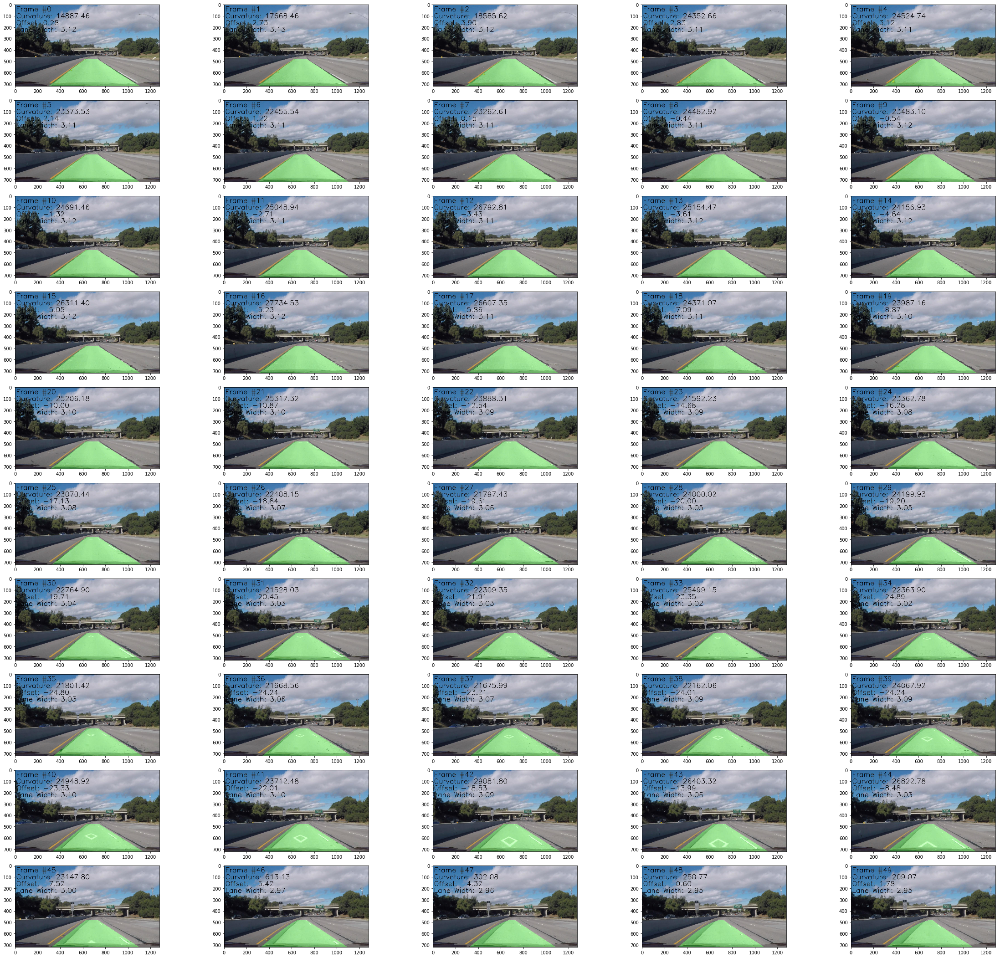

In [985]:
lane_line_image_files = sorted(glob.glob('%s/*.jpg' % lane_line_dir))
lane_line_images = read_imgs(lane_line_image_files)
figsize=(32,32)
display_images(lane_line_images, start_idx=0, end_idx=50, columns=5, figsize=figsize)

In [1049]:
from moviepy.editor import *

In [ ]:
ImageClip('foo').set_duration

In [1065]:
def make_video(img_dir, outfile):
    file_list = sorted(glob.glob('%s/*.jpg' % img_dir))
    img_clips = []
    for file in tqdm(file_list):
        img_clips.append(ImageClip(file).set_duration(0.1)) 
    
    video = concatenate_videoclips(img_clips, method='compose')
    video.write_videofile(outfile, fps=24)

In [1066]:
make_video(lane_line_dir, '%s/lane_lines_harder_challenge.mp4' % data_dir)

100%|██████████| 1259/1259 [01:08<00:00, 18.45it/s]


[MoviePy] >>>> Building video data/lane_lines_harder_challenge.mp4
[MoviePy] Writing video data/lane_lines_harder_challenge.mp4


100%|██████████| 3022/3022 [04:27<00:00, 11.28it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: data/lane_lines_harder_challenge.mp4 

